# Comparison of Predicting Power of Multiple Advanced Neural Networks in a Multivariate Setting

Author: Moritz Ahl 

Date: January 2022

Software: Windows 10, Python 3.9, Jupyter Notebook 6.4.5, Tensorflow 2.7.0

In this notebook, the prediction performance of several advanced neural networks will be compared for a multivariate financial time series forecasting task. The model that will be investigated and compared to a standard FFNN are:

- RNN,
- $\alpha$-RNN,
- $\alpha_t$-RNN,
- LSTM,
- GRU, 
- CNN,
- CNN with Dilation, and 
- Transformer.

This code is in parts inspired by the code provided by Dixon et al. on https://github.com/mfrdixon/ML_Finance_Codes/blob/master/Chapter8-Advanced-NNs.

In [1]:
# load standard packages 
import numpy as np
import math
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
import datetime
from datetime import timedelta, date
import time 
from tqdm import tqdm
import os

# load statistical packages 
from sklearn.metrics import mean_squared_error
import statsmodels.api as sm

# load scalers 
from sklearn.preprocessing import StandardScaler, MinMaxScaler

# load basic Keras functions for neural networks
import tensorflow.keras.initializers
from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.models import load_model
from tensorflow.keras.regularizers import l1, l2
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler, ModelCheckpoint
from tensorflow.keras.wrappers.scikit_learn import KerasRegressor


# load Yahoo!Finance for download of market data
import yfinance as yf

# note that the directory containing these two .py's must be in the path variable:
from alphaRNN import AlphaRNN
from alphatRNN import AlphatRNN

# to display dataframes
from IPython.display import display

# sound option
import winsound

## Data Import and Preparation 

The data set has been downloaded in advance into an .xlsx file using the plug-in Barchart. It consists of the minutely close price of 100 US stocks and 58 US industry indices over a one year period starting 1 January 2021 and ending 31 December 2021.

In [2]:
# import data to a Pandas dataframe
df = pd.read_excel(open('Market_Data.xlsx', 'rb'), sheet_name='Data', index_col = 0)
df.head(5)

,AAPL,ADBE,ADI,ADP,ADSK,AEP,ALGN,AMAT,AMD,AMGN,...,$U8HF,$U9BD,$U9BF,$U9DB,$U9DD,$U9DF,$U9FB,$UYBB,$UYBF,$UYBJ
Date,,,,,,,,,,,,,,,,,,,,,
2021-12-31 15:59:00,177.5700,567.06,175.770,246.58,281.19,88.9700,657.18,157.360,143.90,224.97,...,367.64,655.09,5621.12,652.72,7897.63,371.42,2629.30,417.27,44.34,138.76
2021-12-31 15:58:00,177.6100,567.45,175.885,246.78,281.33,88.9600,658.04,157.300,143.87,225.01,...,368.11,655.42,5625.49,653.11,7897.50,371.59,2630.35,417.22,44.35,138.78
2021-12-31 15:57:00,177.5600,567.36,175.850,246.68,281.25,88.9384,657.98,157.270,143.87,225.12,...,368.01,655.51,5627.15,653.26,7893.52,371.56,2630.49,417.25,44.35,138.70
2021-12-31 15:56:00,177.5000,567.18,175.810,246.71,281.03,88.9300,657.04,157.235,143.90,224.98,...,367.74,655.23,5625.24,653.06,7890.14,371.35,2629.82,417.09,44.33,138.78
2021-12-31 15:55:00,177.5294,567.21,175.841,246.74,281.12,88.8900,657.62,157.235,143.84,224.94,...,367.84,655.14,5626.19,653.15,7894.21,371.43,2629.58,417.05,44.33,138.73


In [3]:
# create a copy of data set for further processing 
df_large = df.copy()

Since the data contains NaNs, we will take care of them now by replacing them with the last close price available before.

In [4]:
# find number of NaNs in each time series
for column in df_large.columns:
    print(column,df_large[column].isna().sum())

AAPL 0
ADBE 1044
ADI 191
ADP 2695
ADSK 4447
AEP 272
ALGN 21172
AMAT 2
AMD 0
AMGN 571
AMZN 672
ANSS 32606
ASML 12973
ATVI 3
AVGO 2552
BIDU 161
BIIB 6841
BKNG 38160
CDNS 3268
CDW 10676
CERN 1253
CHKP 6701
CHTR 11022
CMCSA 2
COST 942
CPRT 8817
CSCO 0
CSX 29
CTAS 32388
CTSH 528
DLTR 1159
DOCU 970
DXCM 17477
EA 936
EBAY 29
EXC 136
FAST 671
FB 0
FISV 87
FOX 7861
FOXA 761
GILD 17
GOOG 8253
GOOGL 6749
IDXX 32824
ILMN 11964
INCY 4744
INTC 0
INTU 4782
ISRG 18092
JD 3
KDP 580
KHC 148
KLAC 6903
LRCX 4713
LULU 7140
MAR 1059
MCHP 1217
MDLZ 50
MELI 27634
MNST 1546
MRNA 5
MRVL 12
MSFT 0
MTCH 1365
MU 0
NFLX 438
NTES 1243
NVDA 5
NXPI 961
OKTA 4156
ORLY 24703
PAYX 2648
PCAR 2300
PDD 26
PEP 29
PTON 15
PYPL 1
QCOM 1
REGN 12260
ROST 1520
SBUX 11
SGEN 12941
SIRI 21
SNPS 12147
SPLK 1478
SWKS 1981
TCOM 336
TEAM 6624
TMUS 137
TSLA 0
TXN 51
VRSK 13806
VRSN 20709
VRTX 2074
WBA 47
WDAY 3779
XEL 365
XLNX 2283
ZM 269
$SCMX 0
$U0BB 1
$U0BD 2
$U2BB 1
$U2BD 1
$U3BD 1
$U3BF 2
$U3BH 1
$U4BB 1
$U4BD 1
$U4BF 1
$U4BH 1
$U4B

In [5]:
# data is listed in descending order -> backfill
df_large = df_large.fillna(method="backfill")

In [6]:
# sort data chronologically 
df_large.sort_values('Date', inplace=True)
df_large.head(5)

,AAPL,ADBE,ADI,ADP,ADSK,AEP,ALGN,AMAT,AMD,AMGN,...,$U8HF,$U9BD,$U9BF,$U9DB,$U9DD,$U9DF,$U9FB,$UYBB,$UYBF,$UYBJ
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-04 09:30:00,133.1500,499.62,149.135,176.2300,305.110,83.4000,545.69,87.30,92.0600,230.0000,...,212.04,632.05,3999.87,438.66,5896.29,281.81,1777.37,361.12,40.06,136.62
2021-01-04 09:31:00,133.3350,499.59,149.230,175.5801,305.200,83.4000,547.74,87.41,92.0500,229.3700,...,212.50,631.82,3994.29,437.46,5900.55,282.10,1779.98,360.95,40.08,136.64
2021-01-04 09:32:00,133.1100,499.55,149.250,175.4314,307.730,83.4400,548.13,87.35,92.1100,229.0600,...,212.48,631.09,3987.92,437.02,5895.75,282.16,1779.27,361.02,40.08,136.36
2021-01-04 09:33:00,132.7462,499.37,149.250,175.1000,305.805,83.1700,546.62,87.53,91.7100,229.0199,...,212.56,630.27,3981.84,436.90,5877.59,281.92,1778.50,360.61,40.04,136.04
2021-01-04 09:34:00,132.8100,499.09,149.045,174.7850,306.672,82.9593,549.77,87.77,92.1249,229.0400,...,211.56,629.54,3979.70,436.28,5875.18,282.00,1781.24,359.73,39.92,134.93


In [7]:
# compute log returns 
df_ret = df_large.copy()

for column in df_ret.columns:
    # extract the close prices and reshape them into 2d-array
    data = np.array(df_ret[column].values)
    data = data.reshape((len(data),1))
    data = data.astype('float32')

    # compute log returns
    z = np.array([0])
    z = z.reshape((1,1))
    ret = np.concatenate((z, np.log(data[1:] / data[:-1])))
    
    # store in dataframe
    df_ret[column] = ret

# drop first row which has return 0 
df_ret.drop(index=df_ret.index[0], axis=0, inplace=True)

As Jan Schmitz argues in a blog post (https://towardsdatascience.com/stock-predictions-with-state-of-the-art-transformer-and-time-embeddings-3a4485237de6, accessed 11 January 2022), even very advanced neural networks are incapable of identifying more than a linear trend from standard return data and this would also be the case in this setting since the data set is not big enough. Thus, we will focus on forecasting the 10-time step moving average.

In [8]:
# compute moving average  
df_ret = df_ret.rolling(10).mean()
df_ret.dropna(how='any', axis=0, inplace=True) 
df_ret.head()

,AAPL,ADBE,ADI,ADP,ADSK,AEP,ALGN,AMAT,AMD,AMGN,...,$U8HF,$U9BD,$U9BF,$U9DB,$U9DD,$U9DF,$U9FB,$UYBB,$UYBF,$UYBJ
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-04 09:40:00,-0.001075,-0.001180,0.000027,-0.001308,-0.000872,-0.000650,0.001780,0.001050,0.000033,-0.000255,...,-0.000691,-0.001032,-0.001191,-0.000016,-0.001082,0.000074,0.000439,-0.000561,-0.000350,-0.001452
2021-01-04 09:41:00,-0.000900,-0.001156,-0.000013,-0.001059,-0.000865,-0.000613,0.001328,0.001081,0.000141,-0.000013,...,-0.001455,-0.000954,-0.000950,0.000190,-0.000879,-0.000053,0.000384,-0.000570,-0.000500,-0.001512
2021-01-04 09:42:00,-0.000675,-0.001196,-0.000080,-0.001009,-0.001757,-0.000637,0.001428,0.001370,0.000206,0.000004,...,-0.001107,-0.001000,-0.000871,0.000098,-0.000800,-0.000082,0.000371,-0.000567,-0.000450,-0.001545
2021-01-04 09:43:00,-0.000427,-0.001241,0.000203,-0.000800,-0.000958,-0.000461,0.002418,0.001463,0.000897,-0.000002,...,-0.001259,-0.000788,-0.000584,0.000117,-0.000427,0.000035,0.000756,-0.000553,-0.000375,-0.001116
2021-01-04 09:44:00,-0.000566,-0.001114,0.000475,-0.000634,-0.001162,-0.000055,0.001418,0.001435,0.000967,0.000081,...,-0.000545,-0.000689,-0.000502,0.000327,-0.000442,0.000082,0.000864,-0.000170,-0.000025,-0.000297


In the next step, the moving average returns will be scaled. It is important to scale the data only with regard to what is going to be the training data set, in this case the first 85% of the total data.

In [9]:
# determine end of traning data 
# since data set is very large, 15% is enough
cutoff = int(0.85 * len(df_ret))

# fit scaler to training set 
x = df_ret[:cutoff].values
scaler = MinMaxScaler()
x_scaled = scaler.fit(x)

# scale all data with fitted scaler 
x_scaled_comp = scaler.transform(df_ret.values)

# transform to data frame 
df_scaled = pd.DataFrame(x_scaled_comp, columns=df_ret.columns, index=df_ret.index)
df_scaled.head()

,AAPL,ADBE,ADI,ADP,ADSK,AEP,ALGN,AMAT,AMD,AMGN,...,$U8HF,$U9BD,$U9BF,$U9DB,$U9DD,$U9DF,$U9FB,$UYBB,$UYBF,$UYBJ
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-04 09:40:00,0.345590,0.382810,0.498226,0.462022,0.651292,0.471726,0.389188,0.471797,0.630980,0.464845,...,0.230488,0.400012,0.276498,0.499705,0.354481,0.669195,0.567615,0.265225,0.349763,0.370896
2021-01-04 09:41:00,0.367773,0.385302,0.492799,0.495566,0.651770,0.478449,0.367006,0.473798,0.639086,0.479833,...,0.150690,0.414038,0.321291,0.527636,0.381393,0.644765,0.560651,0.262846,0.299706,0.363752
2021-01-04 09:42:00,0.396382,0.381125,0.483900,0.502335,0.589737,0.474025,0.371945,0.492220,0.643936,0.480915,...,0.187007,0.405777,0.336011,0.515241,0.391884,0.639338,0.559053,0.263648,0.316420,0.359781
2021-01-04 09:43:00,0.427727,0.376494,0.521512,0.530561,0.645347,0.506759,0.420488,0.498143,0.695527,0.480511,...,0.171147,0.443849,0.389314,0.517731,0.441426,0.661727,0.607441,0.267310,0.341349,0.411471
2021-01-04 09:44:00,0.410117,0.389559,0.557672,0.552910,0.631162,0.582158,0.371430,0.496330,0.700759,0.485653,...,0.245716,0.461823,0.404470,0.546348,0.439494,0.670543,0.620998,0.373005,0.458121,0.510327


Next, the data will be prepared for the supervised learning task by generating the input tensors and the labels.

In [10]:
def rolling_windows(df, n_steps=1, n_steps_ahead=1):
    ''' 
    Function to create rolling windows of observations which will be used
    as input data for the neural network. n_steps is the amount of days
    we look back into the past to use previous closing prices, while n_steps_ahead 
    determines the forecasting horizon. df is a dataframe with scaled values.
    '''
    counter = 0 
    for column in tqdm(df.columns):
        counter += 1
        # create empty lists to store data 
        x = []
        y = []

        data = df[column].values    

        # create rolling windows (input) of last n_steps observations
        # and list with current observatiosn (output)
        for i in range(len(data)-(n_steps+n_steps_ahead-1)):
            window = data[i:(i+n_steps)]
            x.append(window)
            y.append(data[i+n_steps+n_steps_ahead-1])

        # transform lists to array for better handling
        x, y = np.array(x), np.array(y)
        x = x.reshape(x.shape[0], x.shape[1], 1)
        y = y.reshape(y.shape[0], 1)
        
        if counter == 1:
            x_total = x
            y_total = y
        else:
            x_total = np.concatenate((x_total,x),axis=2)
            y_total = np.concatenate((y_total,y),axis=1)
    
    return x_total, y_total

In [11]:
# fix length of reference period
n_steps = 30

# prepare supervised data 
# takes a long time to be completed!
x_total1, y_total1 = rolling_windows(df_scaled,n_steps=n_steps)

100%|██████████| 158/158 [06:51<00:00,  2.61s/it]


In [12]:
# print shapes of tensors 
print(x_total1.shape,y_total1.shape)

(98061, 30, 158) (98061, 158)


Split data into training and test data sets.

In [13]:
# split data into training and test sets
x_train, y_train = x_total1[:cutoff,:,:], y_total1[:cutoff,:] 
x_test, y_test = x_total1[cutoff:,:,:], y_total1[cutoff:,:]

print(x_train.shape, y_train.shape, x_test.shape, y_test.shape)

(83377, 30, 158) (83377, 158) (14684, 30, 158) (14684, 158)


## Plot of Normalized Returns of Apple Stock

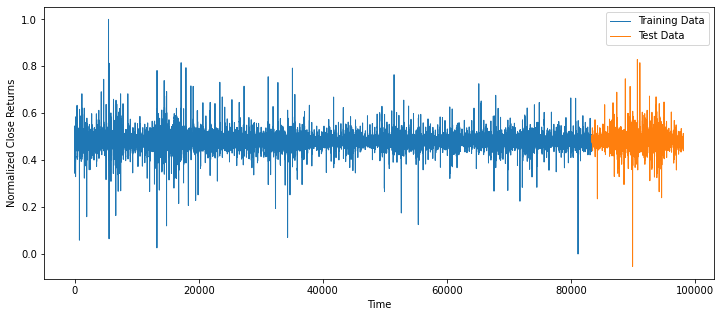

In [14]:
fig = plt.figure(figsize=(12,5))
plt.plot(np.arange(0,cutoff), df_scaled['AAPL'][:cutoff], label='Training Data', lw=1)
plt.plot(np.arange(cutoff+1, len(df_scaled)+1), df_scaled['AAPL'][cutoff:], label='Test Data',  lw=1)
plt.legend()
plt.xlabel('Time')
plt.ylabel('Normalized Close Returns')
plt.savefig('C:/Users/morit/Documents/Studium/Master-Arbeit 2021/Master Thesis TeX/figures/AAPL.pdf')
plt.show()

## Creation of Models 

The advanced neural networks will be compared to a deep FFNN which has already proven to outperform other econometrical methods such as ARIMA-GARCH or exponential smoothing. All networks use the same activation function, ReLU, which helps to avoid exploding gradients. Moreover, Dropout ($10\%$) and Initalization is included in the models. Regulariaztion will not be applied since this caused even the most advanced models to produce constant forecasts. The optimizer of choice is the well-studied Adam algorithm and the optimization will take place with regard to the MSE.

The $\alpha$-RNN and $\alpha_t$-RNN layers are the ones coded by Dixon et al. and can be found here: https://github.com/mfrdixon/ML_Finance_Codes/tree/master/Chapter8-Advanced-NNs (accessed 12 January 2022).

In addition, the other models' architecture also builds on the models presented by Dixon et al. but have been extended by more hidden layers and dropout.

The models can now be designed.

In [15]:
# feedforward neural network
def FFNN_(n_units = 30, l1_reg=0, seed=0):
    model = Sequential()
    model.add(Flatten())
    model.add(Dense(n_units, input_shape=(x_train.shape[1], x_train.shape[-1]), activation = 'relu', 
                    kernel_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.add(Dropout(0.1))
    model.add(Dense(n_units,  activation = 'relu', kernel_initializer=tensorflow.keras.initializers.glorot_normal(seed),
                    bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), kernel_regularizer=l1(l1_reg)))
    model.add(Dropout(0.1))
    model.add(Dense(n_units,  activation = 'relu', kernel_initializer=tensorflow.keras.initializers.glorot_normal(seed),
                    bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), kernel_regularizer=l1(l1_reg)))
    model.add(Dropout(0.1))
    model.add(Dense(n_units,  activation = 'relu', kernel_initializer=tensorflow.keras.initializers.glorot_normal(seed),
                    bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), kernel_regularizer=l1(l1_reg)))
    model.add(Dropout(0.1))
    model.add(Dense(n_units,  activation = 'relu', kernel_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), kernel_regularizer=l1(l1_reg)))
    model.add(Dropout(0.1))
    model.add(Dense(y_train.shape[1], kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_uniform(seed), kernel_regularizer=l1(l1_reg)))
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model

# recurrent neural network
def SimpleRNN_(n_units = 20, l1_reg=0, seed=0):
    model = Sequential()
    model.add(SimpleRNN(n_units, activation='relu', kernel_initializer=tensorflow.keras.initializers.glorot_normal(seed),
                        bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                        recurrent_initializer=tensorflow.keras.initializers.orthogonal(seed), 
                        kernel_regularizer=l1(l1_reg), input_shape=(x_train.shape[1], x_train.shape[-1]), 
                        unroll=True, return_sequences=True,stateful=False))  
    model.add(Dropout(0.1))
    model.add(SimpleRNN(n_units, activation='relu', kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                        bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                        recurrent_initializer=tensorflow.keras.initializers.orthogonal(seed), 
                        kernel_regularizer=l1(l1_reg), unroll=True, stateful=False, return_sequences=True))  
    model.add(Dropout(0.1))
    model.add(SimpleRNN(n_units, activation='relu', kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                        bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                        recurrent_initializer=tensorflow.keras.initializers.orthogonal(seed), 
                        kernel_regularizer=l1(l1_reg), unroll=True, stateful=False))  
    model.add(Dropout(0.1))
    model.add(Dense(y_train.shape[1], kernel_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model

# alpha-RNN
def AlphaRNN_(n_units = 50, l1_reg=0, seed=0):
    model = Sequential()
    model.add(AlphaRNN(n_units, activation='tanh', kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                       bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                       recurrent_initializer=tensorflow.keras.initializers.orthogonal(seed), 
                       kernel_regularizer=l1(l1_reg), input_shape=(x_train.shape[1], x_train.shape[-1]), 
                       unroll=True))
    model.add(Dropout(0.1))
    model.add(Dense(y_train.shape[1], kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model

# alpha_t-RNN
def AlphatRNN_(n_units = 50, l1_reg=0, seed=0):
    model = Sequential()
    model.add(AlphatRNN(n_units, activation='tanh', recurrent_activation='sigmoid', 
                        kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                        bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                        recurrent_initializer=tensorflow.keras.initializers.orthogonal(seed), 
                        kernel_regularizer=l1(l1_reg), input_shape=(x_train.shape[1], x_train.shape[-1]), 
                        unroll=True))  
    model.add(Dropout(0.1))
    model.add(Dense(y_train.shape[1], kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model

# long short-term memory
def LSTM_(n_units = 20, l1_reg=0, seed=0):
    model = Sequential()
    model.add(LSTM(n_units, activation='relu', kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                   bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                   recurrent_initializer=tensorflow.keras.initializers.orthogonal(seed), 
                   kernel_regularizer=l1(l1_reg), input_shape=(x_train.shape[1], x_train.shape[-1]), 
                   return_sequences=True, unroll=True)) 
    model.add(Dropout(0.1))
    model.add(LSTM(n_units, activation='relu', kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed),
                   bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                   recurrent_initializer=tensorflow.keras.initializers.orthogonal(seed), 
                   kernel_regularizer=l1(l1_reg), return_sequences=True, unroll=True)) 
    model.add(Dropout(0.1))
    model.add(LSTM(n_units, activation='relu', kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                   bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                   recurrent_initializer=tensorflow.keras.initializers.orthogonal(seed), 
                   kernel_regularizer=l1(l1_reg), unroll=True)) 
    model.add(Dropout(0.1))
    model.add(Dense(y_train.shape[1], kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model
    
# gated recurrent units 
def GRU_(n_units = 20, l1_reg=0, seed=0):
    model = Sequential()
    model.add(GRU(n_units, activation='relu', kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                  bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                  recurrent_initializer=tensorflow.keras.initializers.orthogonal(seed), 
                  kernel_regularizer=l1(l1_reg), input_shape=(x_train.shape[1], x_train.shape[-1]), 
                  return_sequences=True, unroll=True))  
    model.add(Dropout(0.1))
    model.add(GRU(n_units, activation='relu', kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                  bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                  recurrent_initializer=tensorflow.keras.initializers.orthogonal(seed), 
                  kernel_regularizer=l1(l1_reg), return_sequences=True, unroll=True))  
    model.add(Dropout(0.1))
    model.add(GRU(n_units, activation='relu', kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                  bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                  recurrent_initializer=tensorflow.keras.initializers.orthogonal(seed), 
                  kernel_regularizer=l1(l1_reg), unroll=True))  
    model.add(Dropout(0.1))    
    model.add(Dense(y_train.shape[1], kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model

# convolutional neural network 
def CNN_(n_units = 20, filter_length=5, nb_filter=32, l1_reg=0, seed=0):
    model = Sequential()
    model.add(Conv1D(filters=nb_filter, kernel_size=filter_length, activation='relu',
                     input_shape=(x_train.shape[1], x_train.shape[-1])))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Dropout(0.1))
    model.add(Flatten())
    model.add(Dense(n_units, activation = 'relu', kernel_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.add(Dropout(0.1))
    model.add(Dense(n_units,  activation = 'relu', kernel_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.add(Dropout(0.1))
    model.add(Dense(y_train.shape[1], kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model

# convolutional neural network with dilation 
def DilCNN_(n_units = 20, filter_length=5, nb_filter=32, l1_reg=0, seed=0):
    model = Sequential()
    model.add(Conv1D(filters=nb_filter, kernel_size=filter_length, activation='relu', 
                     input_shape=(x_train.shape[1], x_train.shape[-1]), dilation_rate=2))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Dropout(0.1))
    model.add(Flatten())
    model.add(Dense(n_units, activation = 'relu', kernel_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.add(Dropout(0.1))
    model.add(Dense(n_units,  activation = 'relu', kernel_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_normal(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.add(Dropout(0.1))
    model.add(Dense(y_train.shape[1], kernel_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    bias_initializer=tensorflow.keras.initializers.glorot_uniform(seed), 
                    kernel_regularizer=l1(l1_reg)))
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model

In addition to these well known models, the performance of a Transformer network design should also be evaluated. Since there exists no pre-built implementation of the transformer architecture in Tensorflow and Keras, we will use the architectrure created by Theodoros Ntakouris which can be found here: https://keras.io/examples/timeseries/timeseries_transformer_classification/ (accessed on 12 January 2022). 

Ntakouris' design is an adaption of the original Transformer design for natural language processing and has been modified for time series. While Ntakouris' code is designed to perform classification tasks, we can easily adapt it by removing the activation function and by increasing the number of neurons in the final layer. 

In [16]:
# first build a crucial part of the Transformer: the encoder
# use of layer normalization, dropout and multi-head attention incldued 
# by Theodoros Ntakouris

def transformer_encoder(inputs, head_size, num_heads, ff_dim, dropout=0):
    # encoder part
    x = LayerNormalization(epsilon=1e-6)(inputs)
    x = MultiHeadAttention(
        key_dim=head_size, num_heads=num_heads, dropout=dropout
    )(x, x)
    x = Dropout(dropout)(x)
    res = x + inputs

    # Feed Forward Part
    x = LayerNormalization(epsilon=1e-6)(res)
    x = Conv1D(filters=ff_dim, kernel_size=1, activation='relu')(x)
    x = Dropout(dropout)(x)
    x = Conv1D(filters=inputs.shape[-1], kernel_size=1)(x)
    return x + res

To enable the network to take the causality / the order of the data into account, we add a Time2Vector layer. The implementation builds on Jan Schmitz' blog post (https://towardsdatascience.com/stock-predictions-with-state-of-the-art-transformer-and-time-embeddings-3a4485237de6, accessed on 11 January 2022) and can be found here: https://gist.github.com/JanSchm/b7986ed4809ec768af0a264a162760a8#file-time2vec-py.

In [17]:
# Time2Vector layer by Jan Schmitz
class Time2Vector(Layer):
    def __init__(self, seq_len, **kwargs):
        super(Time2Vector, self).__init__()
        self.seq_len = seq_len

    def build(self, input_shape):
        '''Initialize weights and biases with shape (batch, seq_len)'''
        self.weights_linear = self.add_weight(name='weight_linear',
                                shape=(int(self.seq_len),),
                                initializer='uniform',
                                trainable=True)
    
        self.bias_linear = self.add_weight(name='bias_linear',
                                shape=(int(self.seq_len),),
                                initializer='uniform',
                                trainable=True)
    
        self.weights_periodic = self.add_weight(name='weight_periodic',
                                shape=(int(self.seq_len),),
                                initializer='uniform',
                                trainable=True)

        self.bias_periodic = self.add_weight(name='bias_periodic',
                                shape=(int(self.seq_len),),
                                initializer='uniform',
                                trainable=True)

    def call(self, x):
        '''Calculate linear and periodic time features'''
        x = tf.math.reduce_mean(x[:,:,:4], axis=-1) 
        time_linear = self.weights_linear * x + self.bias_linear # Linear time feature
        time_linear = tf.expand_dims(time_linear, axis=-1) # Add dimension (batch, seq_len, 1)
    
        time_periodic = tf.math.sin(tf.multiply(x, self.weights_periodic) + self.bias_periodic)
        time_periodic = tf.expand_dims(time_periodic, axis=-1) # Add dimension (batch, seq_len, 1)
        return tf.concat([time_linear, time_periodic], axis=-1) # shape = (batch, seq_len, 2)
   
    def get_config(self): # Needed for saving and loading model with custom layer
        config = super().get_config().copy()
        config.update({'seq_len': self.seq_len})
        return config

In [18]:
# function to build model by Theodoros Ntakouris
def build_model(
    input_shape,
    head_size,
    num_heads,
    ff_dim,
    num_transformer_blocks,
    mlp_units,
    dropout=0.1,
    mlp_dropout=0.1,
):
    # Time2Vector added to original code 
    time_embedding = Time2Vector(input_shape[0])
    
    inputs = Input(shape=input_shape)
    x = time_embedding(inputs) 
    x = Concatenate(axis=-1)([inputs,x])
    
    for _ in range(num_transformer_blocks):
        x = transformer_encoder(x, head_size, num_heads, ff_dim, dropout)

    x = GlobalAveragePooling1D(data_format="channels_first")(x)
    for dim in mlp_units:
        x = Dense(dim, activation="relu")(x)
        x = Dropout(mlp_dropout)(x)
    outputs = Dense(y_train.shape[1])(x)
    return tensorflow.keras.Model(inputs, outputs)

In [19]:
# function to build model

def Transformer():
    model = build_model(
        input_shape=(x_train.shape[1], x_train.shape[-1]),
        head_size=256,
        num_heads=8,
        ff_dim=4,
        num_transformer_blocks=4,
        mlp_units=[128],
        mlp_dropout=0.1,
        dropout=0.1,
        )
    
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model

In [20]:
# determine frame for training processes 
max_epochs = 1000
batch_size = 500

# use early stooping w.r.t. validation loss to avoid overfitting
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=100, min_delta=5e-7, restore_best_weights=True)

## Fitting and Evaluation of Every Model

In [40]:
# define function for training 
def train_model(model, model_name):
    '''This function trains a compiled Keras model and 
    returns the time needed for training.'''    
    
    # show model summary 
    model.summary()
    
    # add checkpointing to save only best model
    string = 'best_model_' + str(model_name) +'.h5'
    mc = ModelCheckpoint(string, monitor='val_loss', mode='min', verbose=1, save_best_only=True)
    
    # train model 
    start_time = time.time()
    history = model.fit(x_train, y_train, epochs=max_epochs, 
                    batch_size=batch_size, callbacks=[es,mc], shuffle=False,
                    validation_split=0.2, verbose=1)
    end_time = time.time()
    time_needed = round(end_time - start_time, 2)
    
    # load best model adn add custom layers
    model = load_model(string, custom_objects={'AlphaRNN': AlphaRNN, 'AlphatRNN': AlphatRNN, 'Time2Vector': Time2Vector,
                                               'transformer_encoder': transformer_encoder, 
                                               'MultiHeadAttention': MultiHeadAttention})
    
    # make beeps when completed 
    winsound.Beep(400, 1000)
    winsound.Beep(50, 500)
    winsound.Beep(400, 1000)
    winsound.Beep(50, 500)
    winsound.Beep(400, 1000)
    
    print('The training took', time_needed,'seconds.')
    
    return time_needed, history.history['val_loss']

# define function for evaluation 
def pred_eval(model, model_name):
    ''' This function evaluates the predictive power 
    of a previously trained model and returns the 
    RMSEs and maximum erros.'''
    
    # make forecasts
    pred_train = model.predict(x_train, verbose=1)
    pred_test = model.predict(x_test, verbose=1)
    
    # for every column: compute RMSE train and test 
    i = 0
    rmse_train = []
    rmse_test = []
    for column in df_scaled.columns:

        rmse1 = np.sqrt(mean_squared_error(y_train[:,i], pred_train[:,i]))
        rmse2 = np.sqrt(mean_squared_error(y_test[:,i], pred_test[:,i]))

        rmse_train.append(rmse1)
        rmse_test.append(rmse2)

        print('\nResults for', column,':')
        print('Train Error:',rmse1,'Test Error:',rmse2)
        
        # plot forecasts vs. observations for first 10 stocks and indices
        if i <= 9 or (i>=100 and i<=109):
            fig = plt.figure(figsize=(10,6))
            plt.plot(pred_train[:500,i],label='Prediction Training')
            plt.plot(y_train[:500,i],label='Actual Value')
            plt.legend()
            plt.xlabel('Time')
            plt.ylabel('Scaled Return')
            plt.show()

            fig = plt.figure(figsize=(10,6))
            plt.plot(pred_test[:500,i],label='Prediction Test')
            plt.plot(y_test[:500,i],label='Actual Value')
            plt.legend()
            plt.xlabel('Time')
            plt.ylabel('Scaled Return')
            if i == 0: 
                string = 'C:/Users/morit/Documents/Studium/Master-Arbeit 2021/Master Thesis TeX/figures/' + str(model_name) +'_Plot.pdf'
                plt.savefig(string)
            plt.show()
            
        i += 1

    # compute average and max RMSE
    rmse_train = np.array(rmse_train)
    rmse_test = np.array(rmse_test)
    min_test = np.min(rmse_test)
    max_test = np.max(rmse_test)

    avg_rmse_train = np.mean(rmse_train)
    avg_rmse_test = np.mean(rmse_test)

    print('\nAverage Train Error:',avg_rmse_train,'\nAverage Test Error:',avg_rmse_test)
    
    return avg_rmse_train, avg_rmse_test, max_test

## FFNN 

In [22]:
# build model 
model_FFNN = FFNN_()

# model checkpointing
mc = ModelCheckpoint('best_model_FFNN.h5', monitor='val_loss', mode='min', verbose=1, save_best_only=True)

# fit model 
start_time = time.time()
history = model_FFNN.fit(x_train, y_train, epochs=max_epochs, 
                    batch_size=batch_size, callbacks=[es,mc], shuffle=False,
                    validation_split=0.1, verbose=1)
end_time = time.time()
time_needed_FFNN = round(end_time - start_time, 2)

# show summary 
model_FFNN.summary()

Epoch 1/1000
148/151 [============================>.] - ETA: 0s - loss: 0.0560
Epoch 00001: val_loss improved from inf to 0.00103, saving model to best_model_FFNN.h5
151/151 [==============================] - 5s 26ms/step - loss: 0.0553 - val_loss: 0.0010
Epoch 2/1000
149/151 [============================>.] - ETA: 0s - loss: 0.0051
Epoch 00002: val_loss improved from 0.00103 to 0.00094, saving model to best_model_FFNN.h5
151/151 [==============================] - 3s 19ms/step - loss: 0.0051 - val_loss: 9.4022e-04
Epoch 3/1000
149/151 [============================>.] - ETA: 0s - loss: 0.0038
Epoch 00003: val_loss improved from 0.00094 to 0.00081, saving model to best_model_FFNN.h5
151/151 [==============================] - 3s 19ms/step - loss: 0.0038 - val_loss: 8.0784e-04
Epoch 4/1000
148/151 [============================>.] - ETA: 0s - loss: 0.0032
Epoch 00004: val_loss improved from 0.00081 to 0.00078, saving model to best_model_FFNN.h5
151/151 [==============================] - 3s 

Epoch 35/1000
149/151 [============================>.] - ETA: 0s - loss: 9.2085e-04
Epoch 00035: val_loss did not improve from 0.00071
151/151 [==============================] - 3s 19ms/step - loss: 9.2266e-04 - val_loss: 7.0655e-04
Epoch 36/1000
151/151 [==============================] - ETA: 0s - loss: 9.1056e-04
Epoch 00036: val_loss did not improve from 0.00071
151/151 [==============================] - 3s 18ms/step - loss: 9.1056e-04 - val_loss: 7.0655e-04
Epoch 37/1000
149/151 [============================>.] - ETA: 0s - loss: 8.9666e-04
Epoch 00037: val_loss did not improve from 0.00071
151/151 [==============================] - 3s 17ms/step - loss: 8.9845e-04 - val_loss: 7.0683e-04
Epoch 38/1000
149/151 [============================>.] - ETA: 0s - loss: 8.8857e-04
Epoch 00038: val_loss did not improve from 0.00071
151/151 [==============================] - 3s 18ms/step - loss: 8.9028e-04 - val_loss: 7.0642e-04
Epoch 39/1000
148/151 [============================>.] - ETA: 0s - l

149/151 [============================>.] - ETA: 0s - loss: 8.3202e-04
Epoch 00070: val_loss did not improve from 0.00071
151/151 [==============================] - 3s 19ms/step - loss: 8.3387e-04 - val_loss: 7.0862e-04
Epoch 71/1000
150/151 [============================>.] - ETA: 0s - loss: 8.3408e-04
Epoch 00071: val_loss did not improve from 0.00071
151/151 [==============================] - 3s 19ms/step - loss: 8.3375e-04 - val_loss: 7.0839e-04
Epoch 72/1000
150/151 [============================>.] - ETA: 0s - loss: 8.3409e-04
Epoch 00072: val_loss did not improve from 0.00071
151/151 [==============================] - 3s 19ms/step - loss: 8.3375e-04 - val_loss: 7.0873e-04
Epoch 73/1000
149/151 [============================>.] - ETA: 0s - loss: 8.3171e-04
Epoch 00073: val_loss did not improve from 0.00071
151/151 [==============================] - 3s 20ms/step - loss: 8.3356e-04 - val_loss: 7.0864e-04
Epoch 74/1000
150/151 [============================>.] - ETA: 0s - loss: 8.3378e-0

148/151 [============================>.] - ETA: 0s - loss: 8.3050e-04
Epoch 00105: val_loss did not improve from 0.00071
151/151 [==============================] - 2s 16ms/step - loss: 8.3334e-04 - val_loss: 7.0781e-04
Epoch 106/1000
148/151 [============================>.] - ETA: 0s - loss: 8.3049e-04
Epoch 00106: val_loss did not improve from 0.00071
151/151 [==============================] - 2s 16ms/step - loss: 8.3334e-04 - val_loss: 7.0780e-04
Epoch 107/1000
149/151 [============================>.] - ETA: 0s - loss: 8.3146e-04
Epoch 00107: val_loss did not improve from 0.00071
151/151 [==============================] - 2s 16ms/step - loss: 8.3331e-04 - val_loss: 7.0781e-04
Epoch 108/1000
147/151 [============================>.] - ETA: 0s - loss: 8.3068e-04
Epoch 00108: val_loss did not improve from 0.00071
151/151 [==============================] - 2s 16ms/step - loss: 8.3334e-04 - val_loss: 7.0781e-04
Epoch 109/1000
149/151 [============================>.] - ETA: 0s - loss: 8.315

459/459 [==============================] - 1s 2ms/step

Results for AAPL :
Train Error: 0.03188994484750449 Test Error: 0.03615583904312831


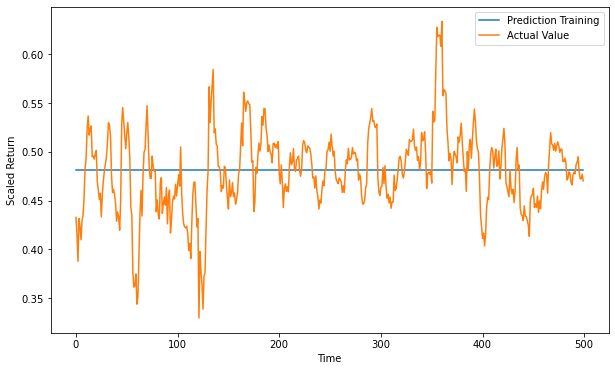

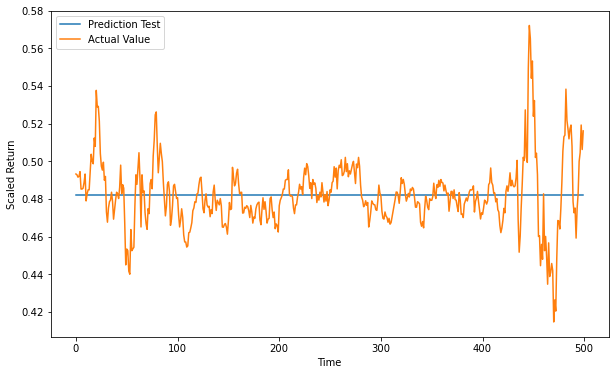


Results for ADBE :
Train Error: 0.026705983415607024 Test Error: 0.04707175995170809


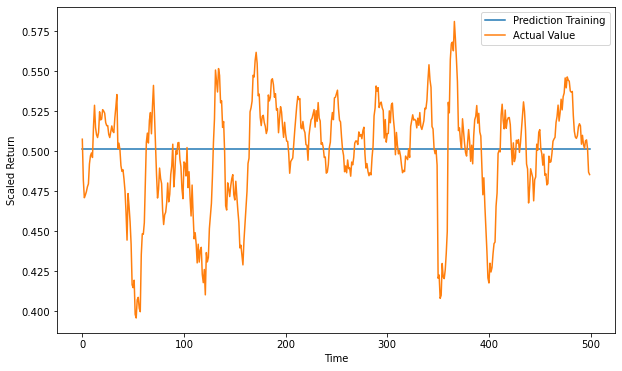

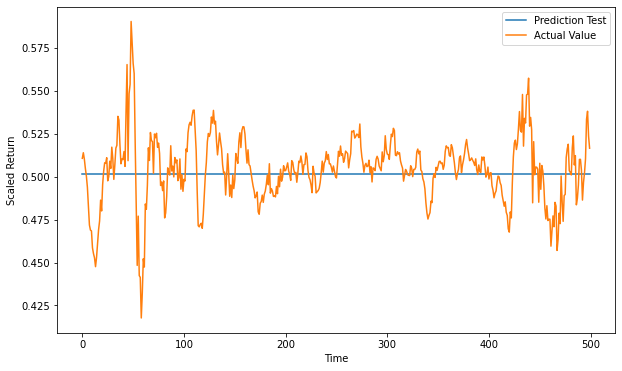


Results for ADI :
Train Error: 0.03680747870071268 Test Error: 0.03472587602683289


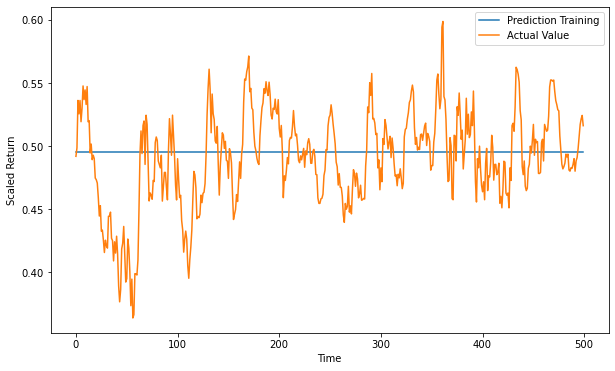

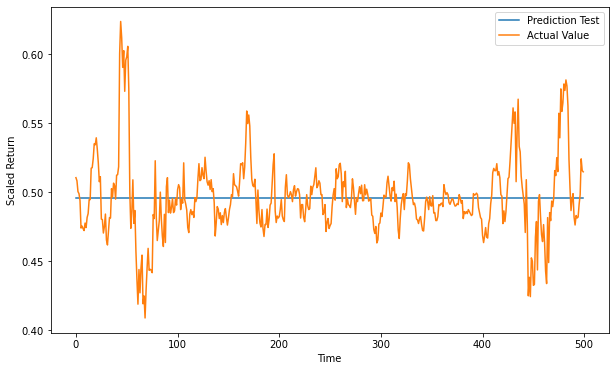


Results for ADP :
Train Error: 0.026048615426663323 Test Error: 0.02680243358360394


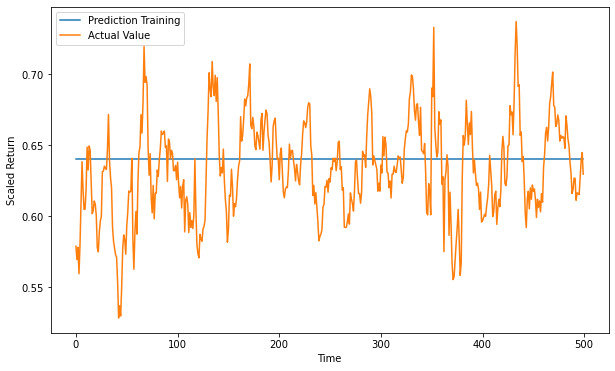

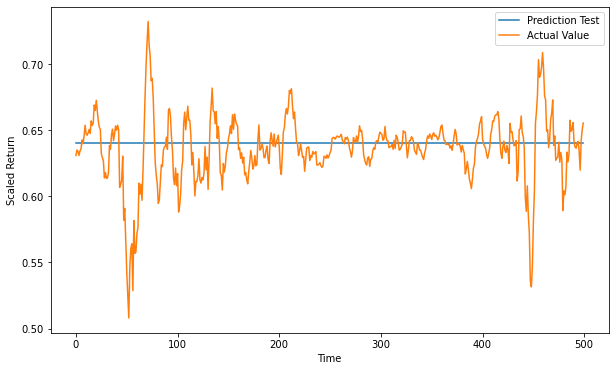


Results for ADSK :
Train Error: 0.02149251242099978 Test Error: 0.03831624858017644


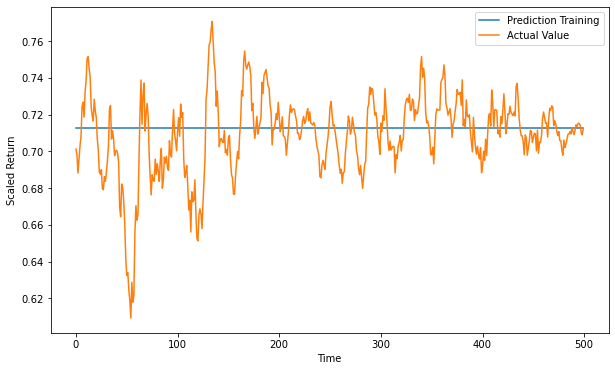

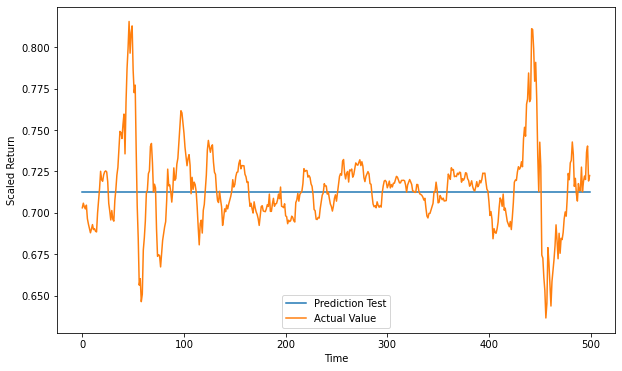


Results for AEP :
Train Error: 0.03388380772882214 Test Error: 0.03210588587381691


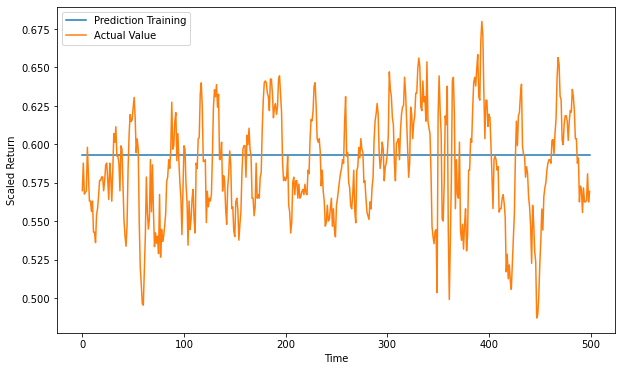

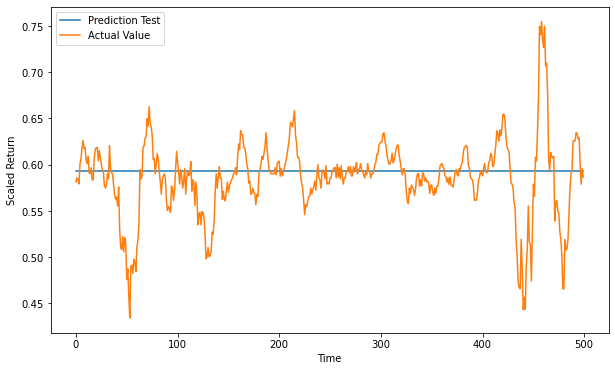


Results for ALGN :
Train Error: 0.019323919793462162 Test Error: 0.01745211220480354


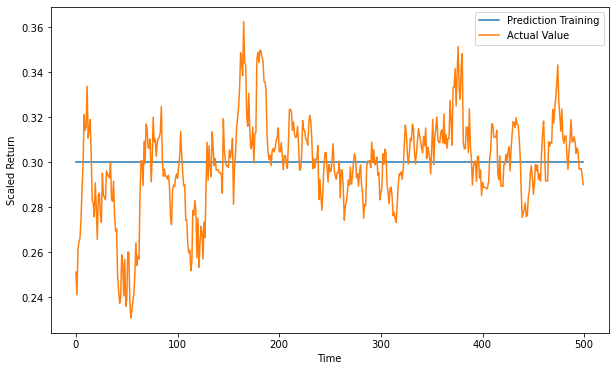

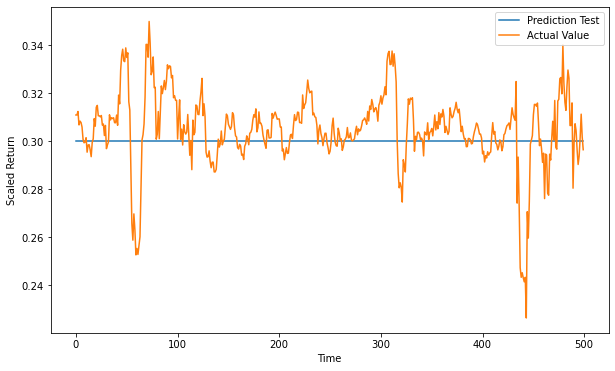


Results for AMAT :
Train Error: 0.026507501998168922 Test Error: 0.025256311934208665


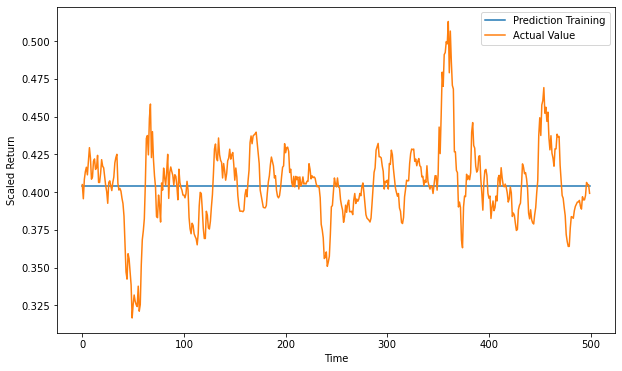

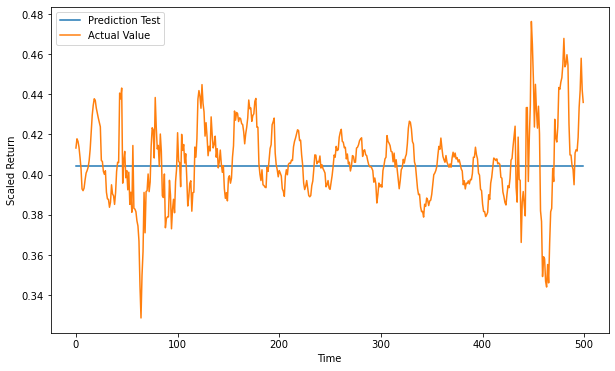


Results for AMD :
Train Error: 0.028507020260164842 Test Error: 0.0387322157252313


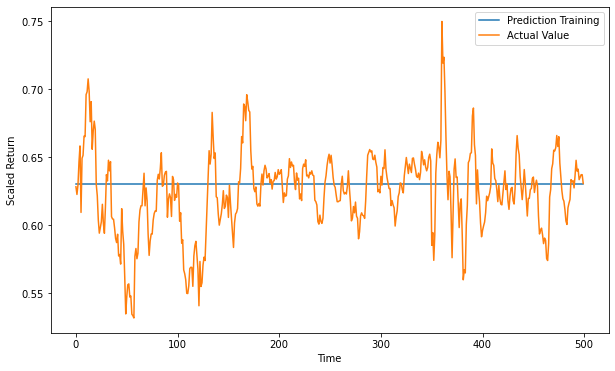

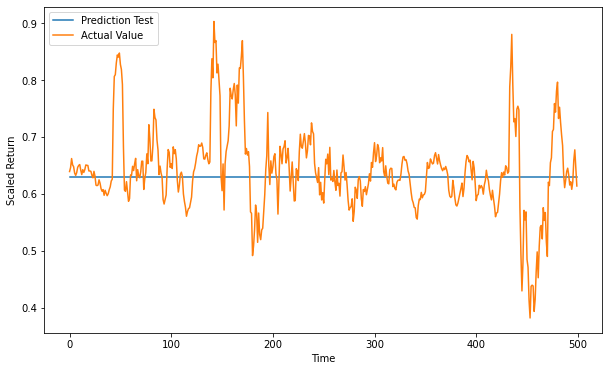


Results for AMGN :
Train Error: 0.014105116826935184 Test Error: 0.014429863107845825


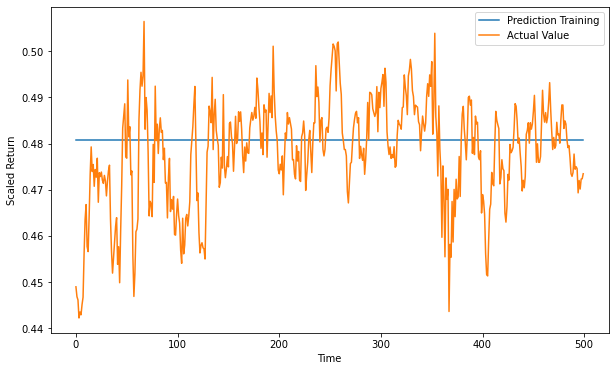

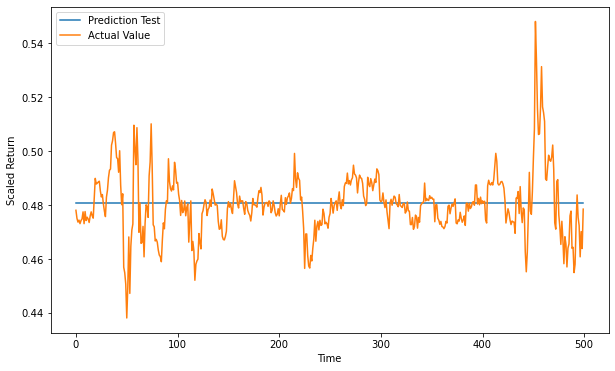


Results for AMZN :
Train Error: 0.02204789184443474 Test Error: 0.023759347623324066

Results for ANSS :
Train Error: 0.024631615114476826 Test Error: 0.025270295136023687

Results for ASML :
Train Error: 0.03196769772709623 Test Error: 0.03372921473671371

Results for ATVI :
Train Error: 0.012221667122055127 Test Error: 0.011629482728950563

Results for AVGO :
Train Error: 0.03625748390210365 Test Error: 0.0446688791575952

Results for BIDU :
Train Error: 0.029968809513750843 Test Error: 0.02479975236002077

Results for BIIB :
Train Error: 0.010065763646216412 Test Error: 0.006783370360615818

Results for BKNG :
Train Error: 0.03154103209167424 Test Error: 0.04400855356123838

Results for CDNS :
Train Error: 0.02469388724324362 Test Error: 0.027448154620653867

Results for CDW :
Train Error: 0.022013137693949452 Test Error: 0.02335516653527285

Results for CERN :
Train Error: 0.019708819730979862 Test Error: 0.03927704728884751

Results for CHKP :
Train Error: 0.0186843786195468 Test

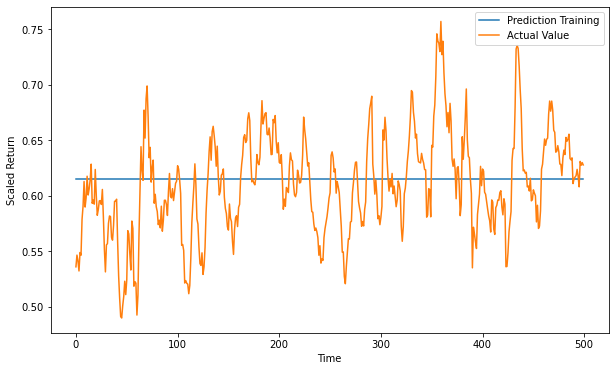

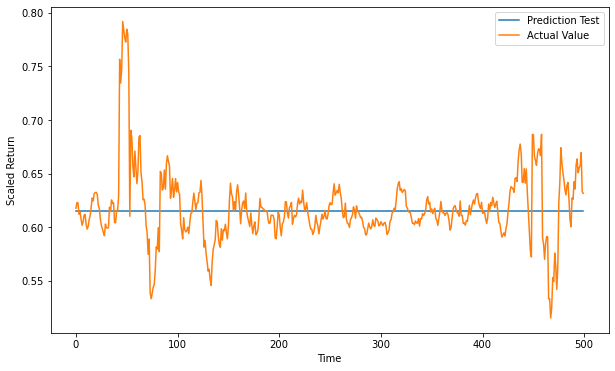


Results for $U0BB :
Train Error: 0.02247102475923204 Test Error: 0.02541558817126892


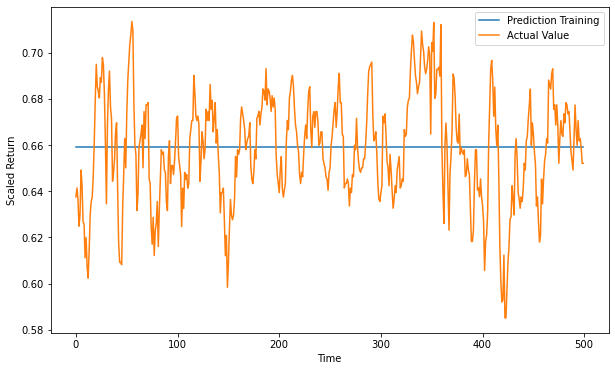

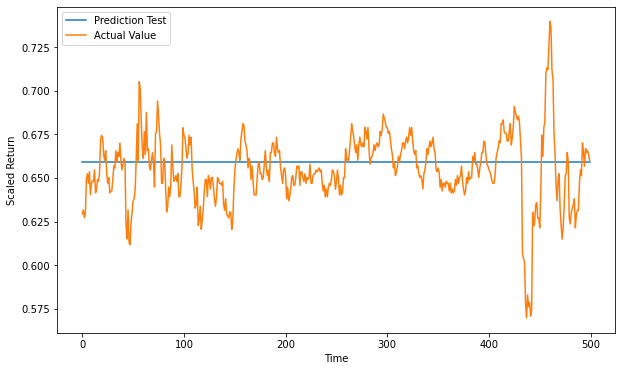


Results for $U0BD :
Train Error: 0.01987737106149718 Test Error: 0.020209694701834705


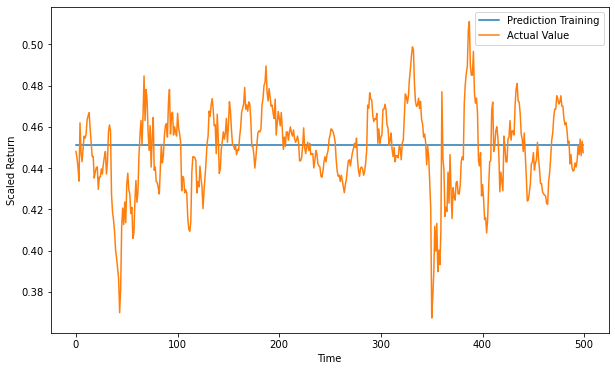

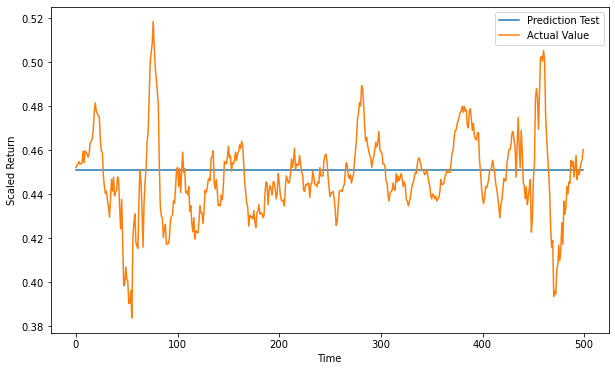


Results for $U2BB :
Train Error: 0.045910615723327955 Test Error: 0.04787578989450411


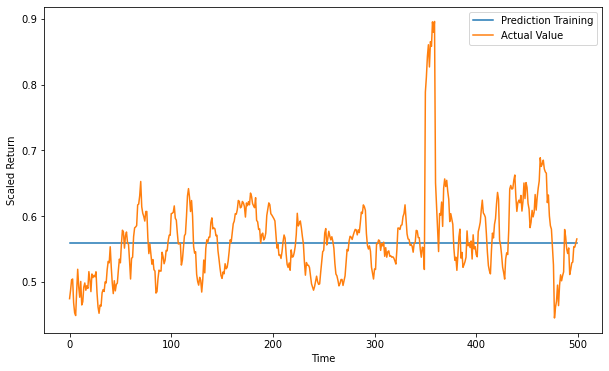

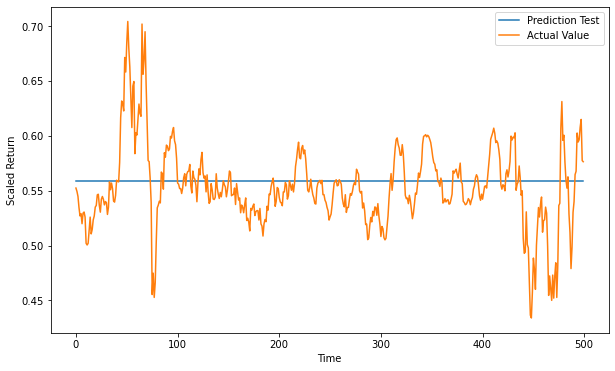


Results for $U2BD :
Train Error: 0.045650799513681485 Test Error: 0.0484556167903728


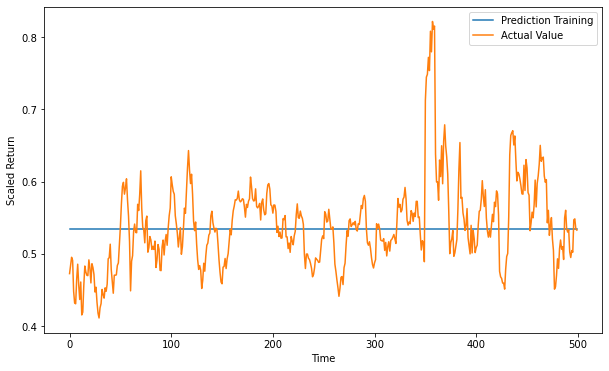

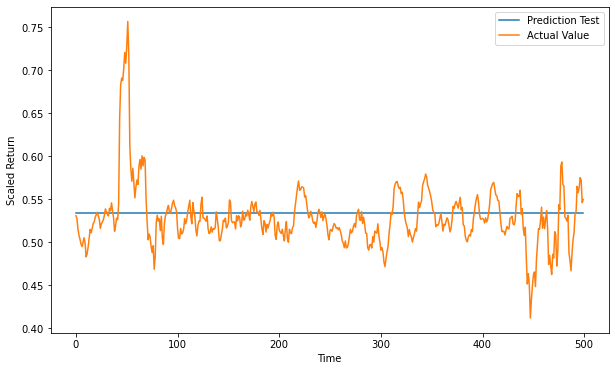


Results for $U3BD :
Train Error: 0.02212891398243739 Test Error: 0.022653435757374878


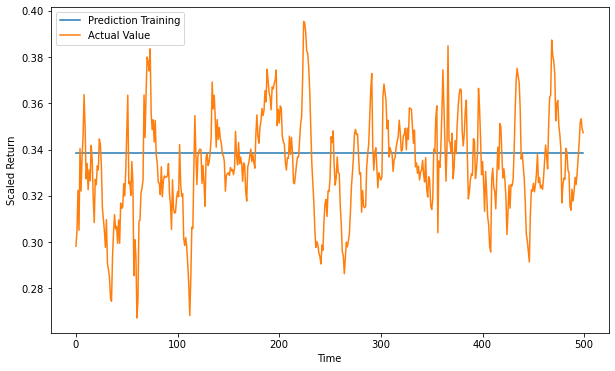

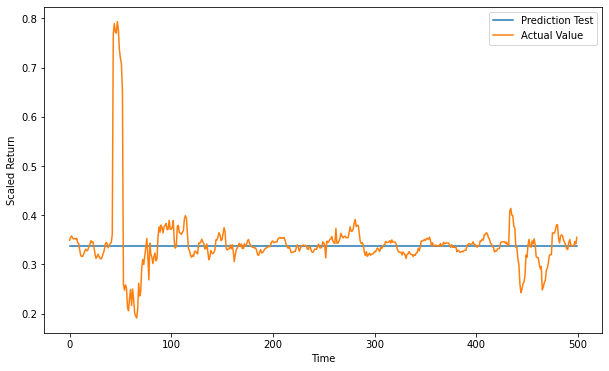


Results for $U3BF :
Train Error: 0.03905409072523861 Test Error: 0.04092087924083845


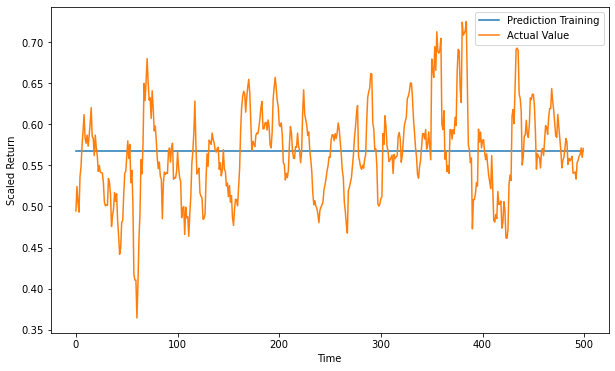

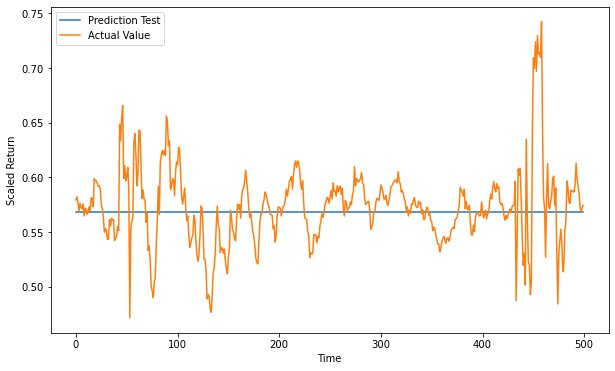


Results for $U3BH :
Train Error: 0.03751005117127661 Test Error: 0.03895808773239213


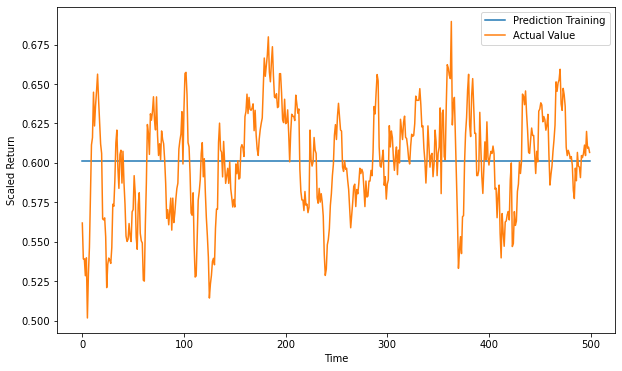

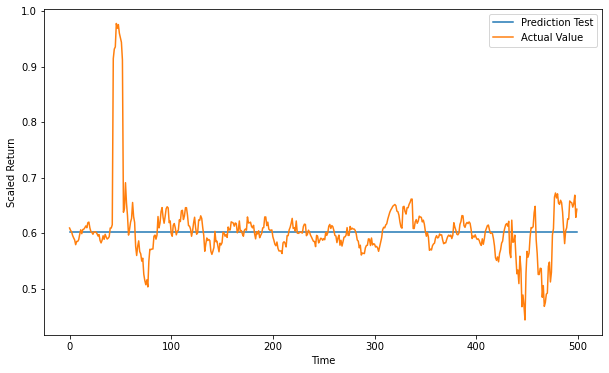


Results for $U4BB :
Train Error: 0.03585523656710796 Test Error: 0.04050160440213149


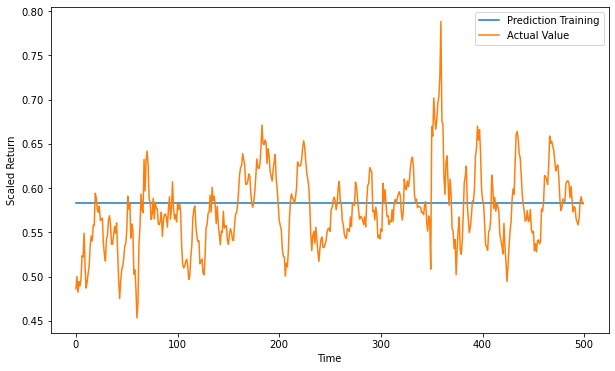

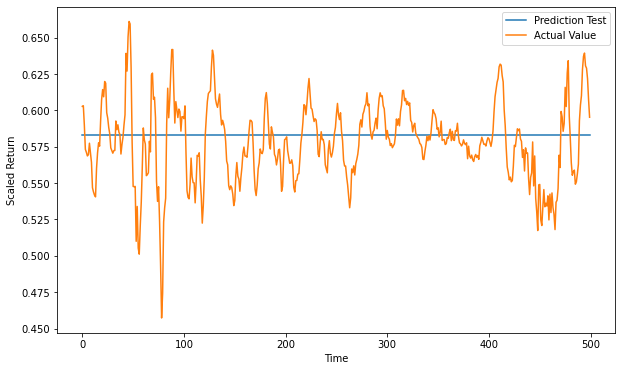


Results for $U4BD :
Train Error: 0.029993159835621886 Test Error: 0.02990380091964178


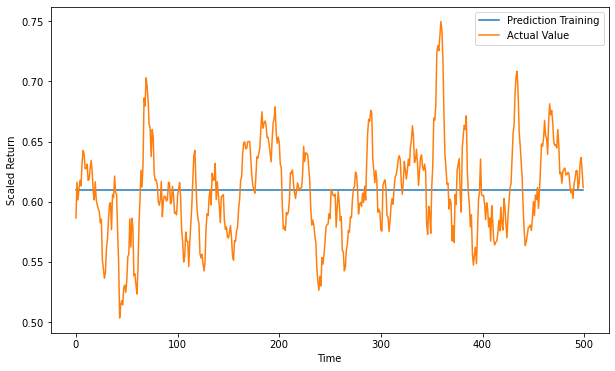

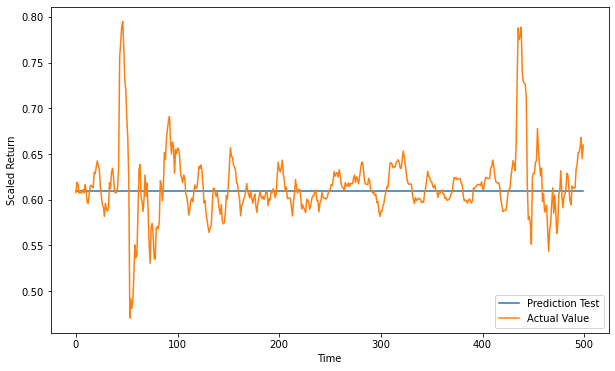


Results for $U4BF :
Train Error: 0.024075787223399044 Test Error: 0.028726857237530604

Results for $U4BH :
Train Error: 0.03265932089614781 Test Error: 0.032484742443399515

Results for $U4BJ :
Train Error: 0.028594981608349723 Test Error: 0.03028976277230017

Results for $U4BL :
Train Error: 0.03321371986987861 Test Error: 0.03421171867554528

Results for $U4BN :
Train Error: 0.03428207936609567 Test Error: 0.033486548458257964

Results for $U4DB :
Train Error: 0.037096851417200594 Test Error: 0.04494631306650256

Results for $U4DD :
Train Error: 0.029020113483148095 Test Error: 0.03398162717236519

Results for $U4FB :
Train Error: 0.016687986235860878 Test Error: 0.015338428905477057

Results for $U4FD :
Train Error: 0.031061695094857678 Test Error: 0.039083575504159355

Results for $U4FH :
Train Error: 0.030291575023201286 Test Error: 0.03088182862956919

Results for $U5BB :
Train Error: 0.03600215165928687 Test Error: 0.03583132152585475

Results for $U5BD :
Train Error: 0.029383

In [38]:
# make predictions and evaluate model 
rmse_train_FFNN, rmse_test_FFNN, rmse_max_FFNN = pred_eval(model_FFNN, 'FFNN')

In [39]:
# manually check for number of parameters and epochs needed 
no_params_FFNN = 150848
epochs_FFNN = 125 # insert manually 

# display results 
FFNN_results = np.array(['{:}'.format(no_params_FFNN), '{:}'.format(epochs_FFNN), round(time_needed_FFNN/60,2), 
                        '{:.3e}'.format(rmse_train_FFNN), '{:.3e}'.format(rmse_test_FFNN), 
                        '{:.3e}'.format(rmse_max_FFNN)])
FFNN_results = FFNN_results.reshape((1,6))
table_FFNN = pd.DataFrame(FFNN_results,index=['FFNN'],
                         columns=['No. Parameters','No. Epochs','Time [m]','RMSE Train','RMSE Test','RMSE Max'])
table_FFNN

,No. Parameters,No. Epochs,Time [m],RMSE Train,RMSE Test,RMSE Max
FFNN,150848,125,5.83,2.755e-02,3.087e-02,6.799e-02


## RNN 

In [25]:
# build model 
model_RNN = SimpleRNN_()

# fit model 
time_needed_RNN, history_RNN = train_model(model_RNN,'RNN')

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn (SimpleRNN)      (None, 30, 20)            3580      
                                                                 
 dropout_5 (Dropout)         (None, 30, 20)            0         
                                                                 
 simple_rnn_1 (SimpleRNN)    (None, 30, 20)            820       
                                                                 
 dropout_6 (Dropout)         (None, 30, 20)            0         
                                                                 
 simple_rnn_2 (SimpleRNN)    (None, 20)                820       
                                                                 
 dropout_7 (Dropout)         (None, 20)                0         
                                                                 
 dense_6 (Dense)             (None, 158)              

133/134 [============================>.] - ETA: 0s - loss: 0.0011
Epoch 00029: val_loss improved from 0.00065 to 0.00065, saving model to best_model_RNN.h5
134/134 [==============================] - 8s 61ms/step - loss: 0.0011 - val_loss: 6.5051e-04
Epoch 30/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0011
Epoch 00030: val_loss improved from 0.00065 to 0.00065, saving model to best_model_RNN.h5
134/134 [==============================] - 8s 60ms/step - loss: 0.0011 - val_loss: 6.4852e-04
Epoch 31/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0010
Epoch 00031: val_loss improved from 0.00065 to 0.00064, saving model to best_model_RNN.h5
134/134 [==============================] - 8s 61ms/step - loss: 0.0010 - val_loss: 6.4371e-04
Epoch 32/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0010
Epoch 00032: val_loss improved from 0.00064 to 0.00064, saving model to best_model_RNN.h5
134/134 [==============================] - 8s 59ms/s

Epoch 61/1000
133/134 [============================>.] - ETA: 0s - loss: 7.1470e-04
Epoch 00061: val_loss improved from 0.00061 to 0.00061, saving model to best_model_RNN.h5
134/134 [==============================] - 8s 58ms/step - loss: 7.1416e-04 - val_loss: 6.1062e-04
Epoch 62/1000
134/134 [==============================] - ETA: 0s - loss: 7.1032e-04
Epoch 00062: val_loss improved from 0.00061 to 0.00060, saving model to best_model_RNN.h5
134/134 [==============================] - 8s 60ms/step - loss: 7.1032e-04 - val_loss: 6.0486e-04
Epoch 63/1000
133/134 [============================>.] - ETA: 0s - loss: 7.0909e-04
Epoch 00063: val_loss improved from 0.00060 to 0.00060, saving model to best_model_RNN.h5
134/134 [==============================] - 8s 59ms/step - loss: 7.0852e-04 - val_loss: 6.0124e-04
Epoch 64/1000
133/134 [============================>.] - ETA: 0s - loss: 7.0546e-04
Epoch 00064: val_loss did not improve from 0.00060
134/134 [==============================] - 8s 58m

Epoch 93/1000
133/134 [============================>.] - ETA: 0s - loss: 6.4062e-04
Epoch 00093: val_loss did not improve from 0.00056
134/134 [==============================] - 8s 58ms/step - loss: 6.4005e-04 - val_loss: 5.6248e-04
Epoch 94/1000
133/134 [============================>.] - ETA: 0s - loss: 6.3842e-04
Epoch 00094: val_loss did not improve from 0.00056
134/134 [==============================] - 8s 61ms/step - loss: 6.3784e-04 - val_loss: 5.6228e-04
Epoch 95/1000
133/134 [============================>.] - ETA: 0s - loss: 6.3657e-04
Epoch 00095: val_loss did not improve from 0.00056
134/134 [==============================] - 8s 58ms/step - loss: 6.3601e-04 - val_loss: 5.6181e-04
Epoch 96/1000
133/134 [============================>.] - ETA: 0s - loss: 6.3616e-04
Epoch 00096: val_loss did not improve from 0.00056
134/134 [==============================] - 8s 61ms/step - loss: 6.3558e-04 - val_loss: 5.6613e-04
Epoch 97/1000
133/134 [============================>.] - ETA: 0s - l

Epoch 128/1000
133/134 [============================>.] - ETA: 0s - loss: 6.1268e-04
Epoch 00128: val_loss improved from 0.00056 to 0.00055, saving model to best_model_RNN.h5
134/134 [==============================] - 8s 57ms/step - loss: 6.1214e-04 - val_loss: 5.5300e-04
Epoch 129/1000
133/134 [============================>.] - ETA: 0s - loss: 6.1059e-04
Epoch 00129: val_loss did not improve from 0.00055
134/134 [==============================] - 8s 59ms/step - loss: 6.1007e-04 - val_loss: 5.5537e-04
Epoch 130/1000
133/134 [============================>.] - ETA: 0s - loss: 6.0680e-04
Epoch 00130: val_loss improved from 0.00055 to 0.00055, saving model to best_model_RNN.h5
134/134 [==============================] - 8s 57ms/step - loss: 6.0628e-04 - val_loss: 5.5059e-04
Epoch 131/1000
133/134 [============================>.] - ETA: 0s - loss: 6.0709e-04
Epoch 00131: val_loss did not improve from 0.00055
134/134 [==============================] - 8s 58ms/step - loss: 6.0659e-04 - val_los

133/134 [============================>.] - ETA: 0s - loss: 5.7499e-04
Epoch 00161: val_loss did not improve from 0.00053
134/134 [==============================] - 8s 59ms/step - loss: 5.7453e-04 - val_loss: 5.3633e-04
Epoch 162/1000
133/134 [============================>.] - ETA: 0s - loss: 5.7347e-04
Epoch 00162: val_loss did not improve from 0.00053
134/134 [==============================] - 8s 57ms/step - loss: 5.7304e-04 - val_loss: 5.3264e-04
Epoch 163/1000
133/134 [============================>.] - ETA: 0s - loss: 5.7304e-04
Epoch 00163: val_loss did not improve from 0.00053
134/134 [==============================] - 8s 58ms/step - loss: 5.7260e-04 - val_loss: 5.3320e-04
Epoch 164/1000
133/134 [============================>.] - ETA: 0s - loss: 5.7423e-04
Epoch 00164: val_loss did not improve from 0.00053
134/134 [==============================] - 8s 58ms/step - loss: 5.7380e-04 - val_loss: 5.3770e-04
Epoch 165/1000
133/134 [============================>.] - ETA: 0s - loss: 5.763

Epoch 195/1000
133/134 [============================>.] - ETA: 0s - loss: 5.6654e-04
Epoch 00195: val_loss did not improve from 0.00053
134/134 [==============================] - 8s 61ms/step - loss: 5.6609e-04 - val_loss: 5.2905e-04
Epoch 196/1000
133/134 [============================>.] - ETA: 0s - loss: 5.6655e-04
Epoch 00196: val_loss did not improve from 0.00053
134/134 [==============================] - 8s 59ms/step - loss: 5.6611e-04 - val_loss: 5.3108e-04
Epoch 197/1000
133/134 [============================>.] - ETA: 0s - loss: 5.6564e-04- ETA: 0s - loss:
Epoch 00197: val_loss did not improve from 0.00053
134/134 [==============================] - 8s 61ms/step - loss: 5.6521e-04 - val_loss: 5.3056e-04
Epoch 198/1000
133/134 [============================>.] - ETA: 0s - loss: 5.6573e-04
Epoch 00198: val_loss did not improve from 0.00053
134/134 [==============================] - 8s 59ms/step - loss: 5.6531e-04 - val_loss: 5.2813e-04
Epoch 199/1000
133/134 [=======================

133/134 [============================>.] - ETA: 0s - loss: 5.6426e-04
Epoch 00229: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 58ms/step - loss: 5.6384e-04 - val_loss: 5.2580e-04
Epoch 230/1000
133/134 [============================>.] - ETA: 0s - loss: 5.6063e-04
Epoch 00230: val_loss improved from 0.00052 to 0.00052, saving model to best_model_RNN.h5
134/134 [==============================] - 8s 61ms/step - loss: 5.6021e-04 - val_loss: 5.2109e-04
Epoch 231/1000
133/134 [============================>.] - ETA: 0s - loss: 5.6482e-04
Epoch 00231: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 60ms/step - loss: 5.6439e-04 - val_loss: 5.2315e-04
Epoch 232/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5897e-04
Epoch 00232: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 59ms/step - loss: 5.5855e-04 - val_loss: 5.2578e-04
Epoch 233/1000
133/134 [================

Epoch 264/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5936e-04
Epoch 00264: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 59ms/step - loss: 5.5894e-04 - val_loss: 5.2132e-04
Epoch 265/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5859e-04- ETA: 0s - loss: 5.70
Epoch 00265: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 60ms/step - loss: 5.5817e-04 - val_loss: 5.2510e-04
Epoch 266/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5803e-04
Epoch 00266: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 57ms/step - loss: 5.5765e-04 - val_loss: 5.2164e-04
Epoch 267/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5888e-04
Epoch 00267: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 58ms/step - loss: 5.5848e-04 - val_loss: 5.2522e-04
Epoch 268/1000
133/134 [==================

Epoch 299/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5658e-04
Epoch 00299: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 60ms/step - loss: 5.5620e-04 - val_loss: 5.2036e-04
Epoch 300/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5909e-04
Epoch 00300: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 62ms/step - loss: 5.5868e-04 - val_loss: 5.2025e-04
Epoch 301/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5526e-04
Epoch 00301: val_loss did not improve from 0.00052
134/134 [==============================] - 9s 70ms/step - loss: 5.5488e-04 - val_loss: 5.2112e-04
Epoch 302/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5591e-04
Epoch 00302: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 62ms/step - loss: 5.5551e-04 - val_loss: 5.2485e-04
Epoch 303/1000
133/134 [============================>.] - ETA: 0

Epoch 334/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5406e-04
Epoch 00334: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 62ms/step - loss: 5.5367e-04 - val_loss: 5.2457e-04
Epoch 335/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5626e-04
Epoch 00335: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 62ms/step - loss: 5.5587e-04 - val_loss: 5.2341e-04
Epoch 336/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5335e-04
Epoch 00336: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 60ms/step - loss: 5.5294e-04 - val_loss: 5.2178e-04
Epoch 337/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5335e-04
Epoch 00337: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 62ms/step - loss: 5.5294e-04 - val_loss: 5.2771e-04
Epoch 338/1000
133/134 [============================>.] - ETA: 0

Epoch 369/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5539e-04
Epoch 00369: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 58ms/step - loss: 5.5500e-04 - val_loss: 5.1891e-04
Epoch 370/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5231e-04
Epoch 00370: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 60ms/step - loss: 5.5192e-04 - val_loss: 5.1867e-04
Epoch 371/1000
133/134 [============================>.] - ETA: 0s - loss: 5.6335e-04
Epoch 00371: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 59ms/step - loss: 5.6293e-04 - val_loss: 5.2728e-04
Epoch 372/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5469e-04
Epoch 00372: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 61ms/step - loss: 5.5427e-04 - val_loss: 5.1803e-04
Epoch 373/1000
133/134 [============================>.] - ETA: 0

Epoch 404/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5312e-04
Epoch 00404: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 63ms/step - loss: 5.5273e-04 - val_loss: 5.2197e-04
Epoch 405/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5235e-04
Epoch 00405: val_loss did not improve from 0.00052
134/134 [==============================] - 9s 64ms/step - loss: 5.5199e-04 - val_loss: 5.2017e-04
Epoch 406/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5287e-04
Epoch 00406: val_loss did not improve from 0.00052
134/134 [==============================] - 9s 64ms/step - loss: 5.5248e-04 - val_loss: 5.1675e-04
Epoch 407/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5102e-04
Epoch 00407: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 62ms/step - loss: 5.5062e-04 - val_loss: 5.1664e-04
Epoch 408/1000
133/134 [============================>.] - ETA: 0

133/134 [============================>.] - ETA: 0s - loss: 5.5220e-04
Epoch 00438: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 60ms/step - loss: 5.5178e-04 - val_loss: 5.1897e-04
Epoch 439/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5312e-04
Epoch 00439: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 62ms/step - loss: 5.5272e-04 - val_loss: 5.1734e-04
Epoch 440/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5204e-04
Epoch 00440: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 60ms/step - loss: 5.5165e-04 - val_loss: 5.1889e-04
Epoch 441/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5254e-04
Epoch 00441: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 61ms/step - loss: 5.5213e-04 - val_loss: 5.1815e-04
Epoch 442/1000
133/134 [============================>.] - ETA: 0s - loss: 5.502

133/134 [============================>.] - ETA: 0s - loss: 5.5023e-04
Epoch 00473: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 60ms/step - loss: 5.4984e-04 - val_loss: 5.1811e-04
Epoch 474/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5061e-04
Epoch 00474: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 61ms/step - loss: 5.5024e-04 - val_loss: 5.1641e-04
Epoch 475/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5101e-04
Epoch 00475: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 60ms/step - loss: 5.5060e-04 - val_loss: 5.1947e-04
Epoch 476/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5123e-04
Epoch 00476: val_loss did not improve from 0.00052
134/134 [==============================] - 8s 61ms/step - loss: 5.5083e-04 - val_loss: 5.2123e-04
Epoch 477/1000
133/134 [============================>.] - ETA: 0s - loss: 5.500

Epoch 508/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4895e-04
Epoch 00508: val_loss did not improve from 0.00051
134/134 [==============================] - 8s 62ms/step - loss: 5.4857e-04 - val_loss: 5.2136e-04
Epoch 509/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4886e-04
Epoch 00509: val_loss did not improve from 0.00051
134/134 [==============================] - 9s 69ms/step - loss: 5.4846e-04 - val_loss: 5.1809e-04
Epoch 510/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4783e-04
Epoch 00510: val_loss did not improve from 0.00051
134/134 [==============================] - 10s 72ms/step - loss: 5.4744e-04 - val_loss: 5.1743e-04
Epoch 511/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4800e-04
Epoch 00511: val_loss did not improve from 0.00051
134/134 [==============================] - 10s 71ms/step - loss: 5.4760e-04 - val_loss: 5.1962e-04
Epoch 512/1000
133/134 [============================>.] - ETA:

Epoch 543/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5034e-04
Epoch 00543: val_loss did not improve from 0.00051
134/134 [==============================] - 8s 60ms/step - loss: 5.4995e-04 - val_loss: 5.2006e-04
Epoch 544/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4925e-04
Epoch 00544: val_loss did not improve from 0.00051
134/134 [==============================] - 8s 62ms/step - loss: 5.4885e-04 - val_loss: 5.2025e-04
Epoch 545/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4937e-04
Epoch 00545: val_loss did not improve from 0.00051
134/134 [==============================] - 8s 60ms/step - loss: 5.4897e-04 - val_loss: 5.2282e-04
Epoch 546/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4813e-04
Epoch 00546: val_loss did not improve from 0.00051
134/134 [==============================] - 8s 62ms/step - loss: 5.4776e-04 - val_loss: 5.2140e-04
Epoch 547/1000
133/134 [============================>.] - ETA: 0

Epoch 578/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4802e-04
Epoch 00578: val_loss did not improve from 0.00051
134/134 [==============================] - 8s 59ms/step - loss: 5.4762e-04 - val_loss: 5.1957e-04
Epoch 579/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4931e-04
Epoch 00579: val_loss did not improve from 0.00051
134/134 [==============================] - 8s 61ms/step - loss: 5.4890e-04 - val_loss: 5.1734e-04
Epoch 580/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4736e-04
Epoch 00580: val_loss did not improve from 0.00051
134/134 [==============================] - 8s 59ms/step - loss: 5.4696e-04 - val_loss: 5.2036e-04
Epoch 581/1000
133/134 [============================>.] - ETA: 0s - loss: 5.5135e-04
Epoch 00581: val_loss did not improve from 0.00051
134/134 [==============================] - 8s 62ms/step - loss: 5.5095e-04 - val_loss: 5.1822e-04
Epoch 582/1000
133/134 [============================>.] - ETA: 0

459/459 [==============================] - 2s 4ms/step

Results for AAPL :
Train Error: 0.0252608040846645 Test Error: 0.032042002566116494


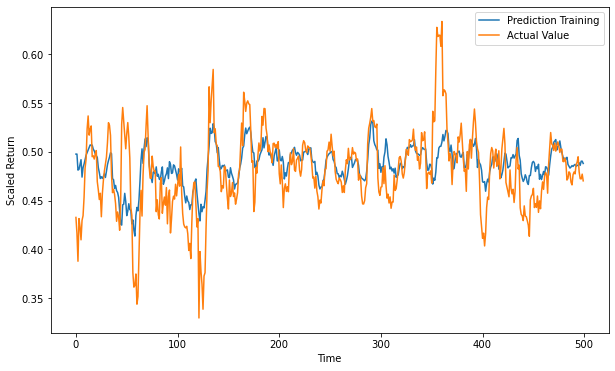

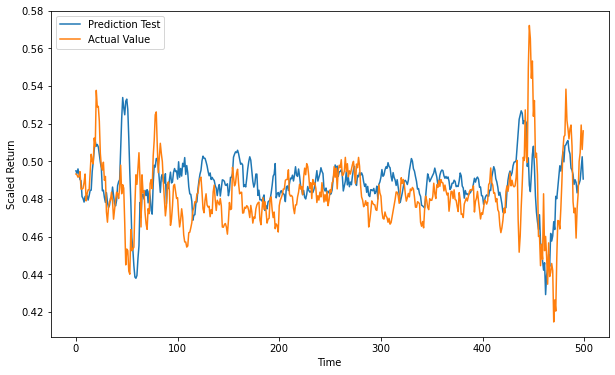


Results for ADBE :
Train Error: 0.019409423797062897 Test Error: 0.040873018722509716


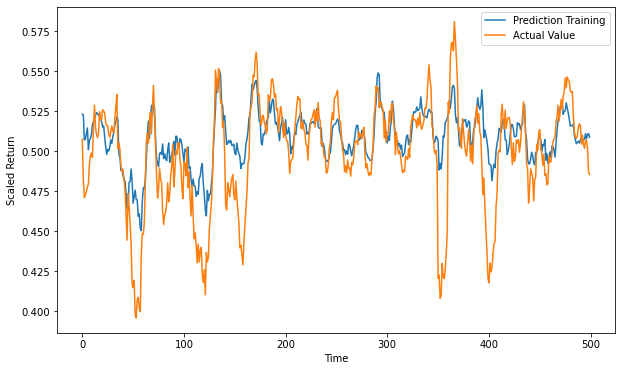

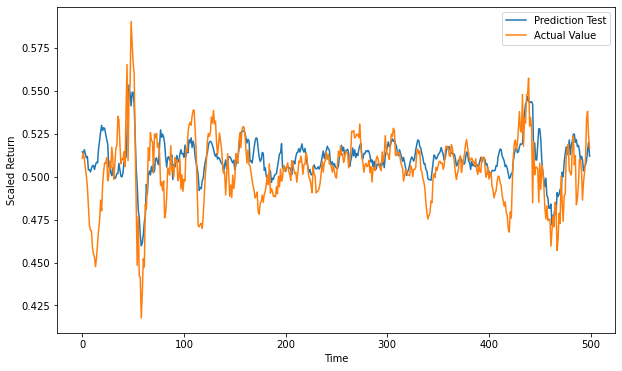


Results for ADI :
Train Error: 0.02774881784974138 Test Error: 0.026980655418027764


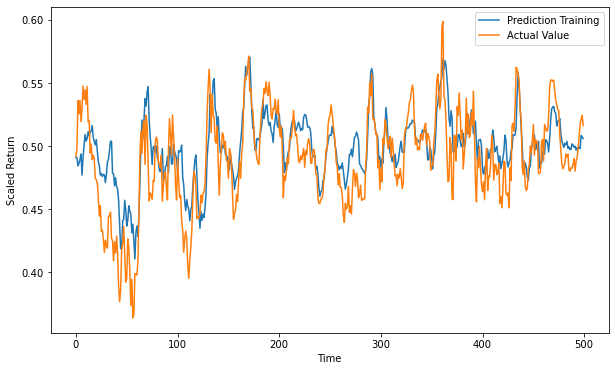

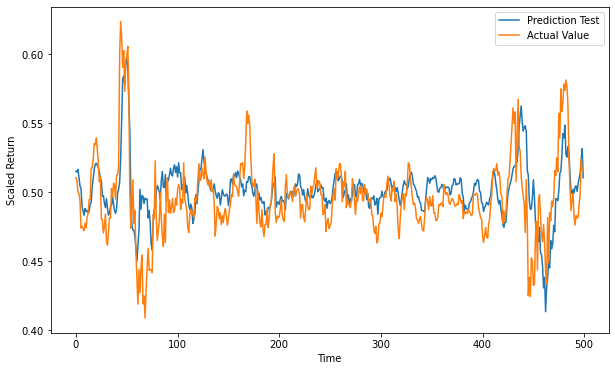


Results for ADP :
Train Error: 0.022425493154441322 Test Error: 0.0228580787997633


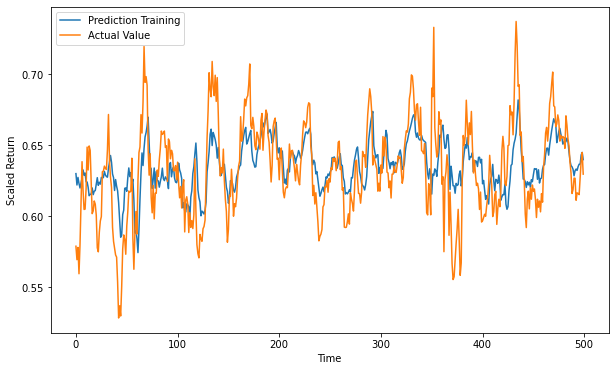

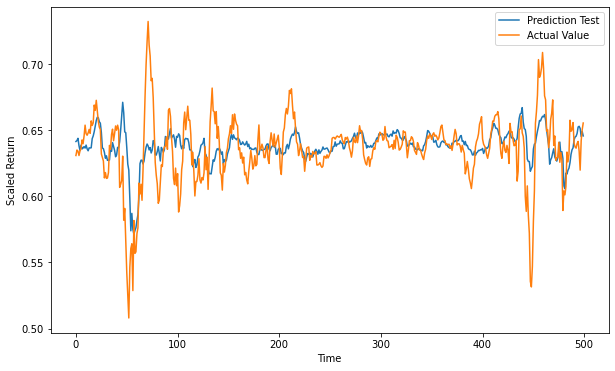


Results for ADSK :
Train Error: 0.016706510201474876 Test Error: 0.03507948248676255


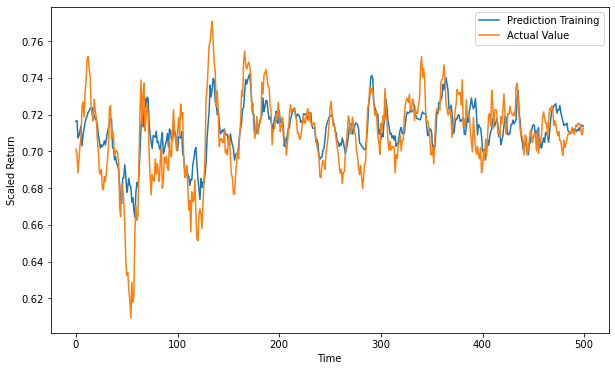

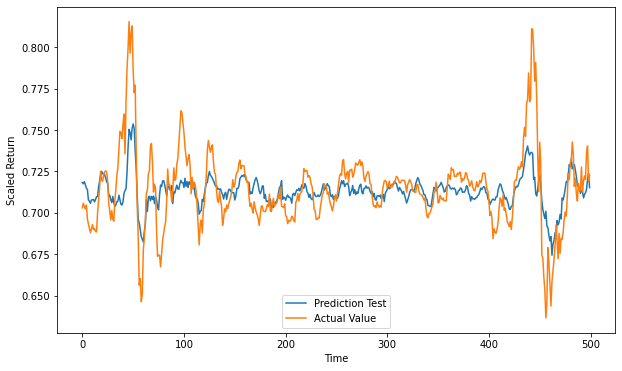


Results for AEP :
Train Error: 0.02551070487547666 Test Error: 0.02392089975327587


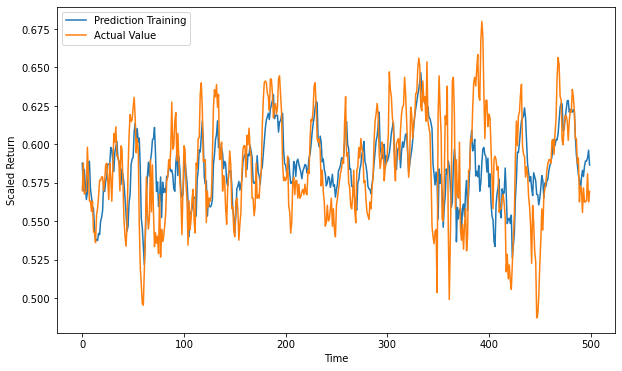

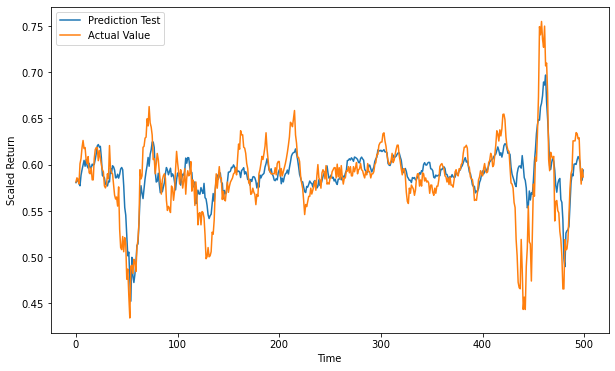


Results for ALGN :
Train Error: 0.016898683799430655 Test Error: 0.015385921604121089


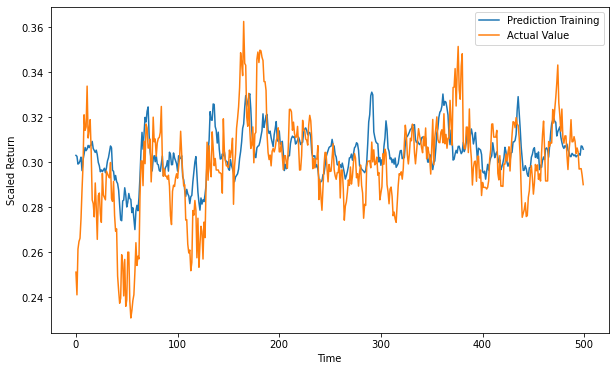

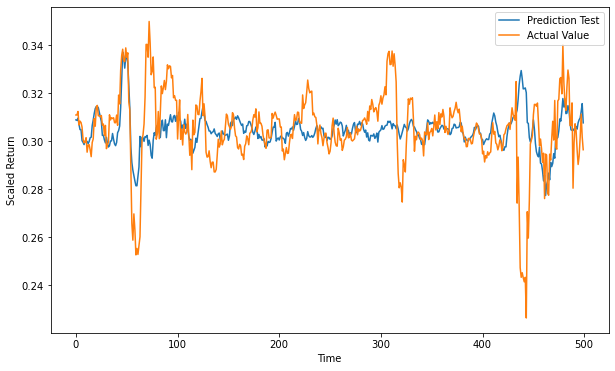


Results for AMAT :
Train Error: 0.02029251990800047 Test Error: 0.0202137766225382


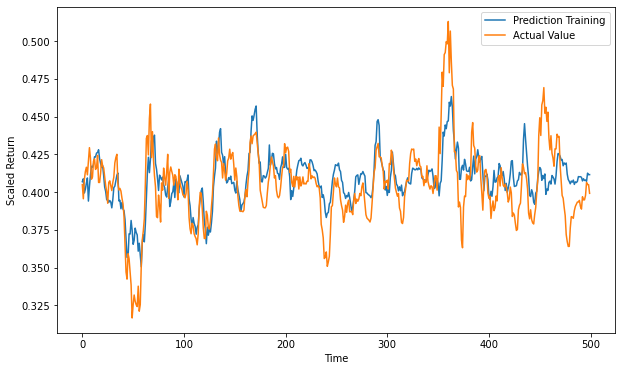

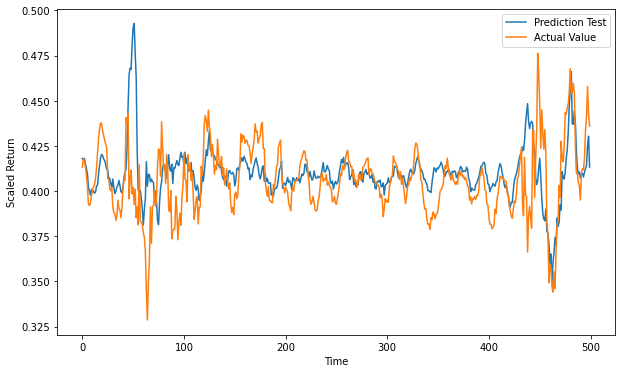


Results for AMD :
Train Error: 0.02267967521004497 Test Error: 0.03244211120268478


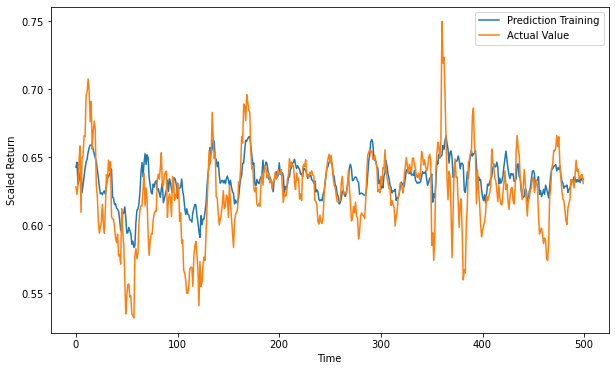

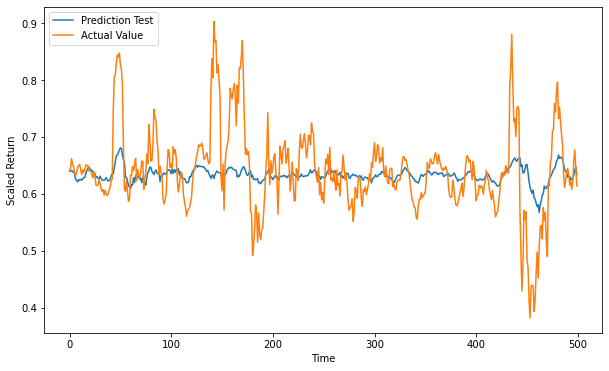


Results for AMGN :
Train Error: 0.013018667088443093 Test Error: 0.013963409560100308


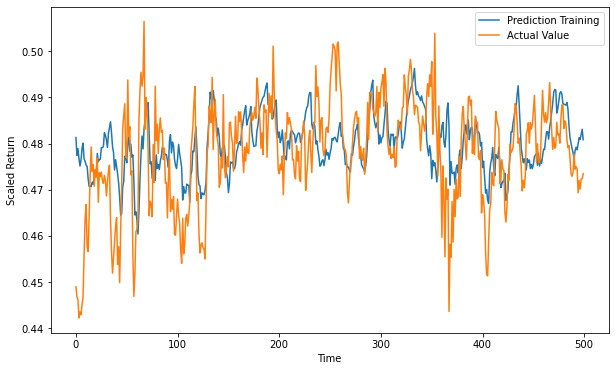

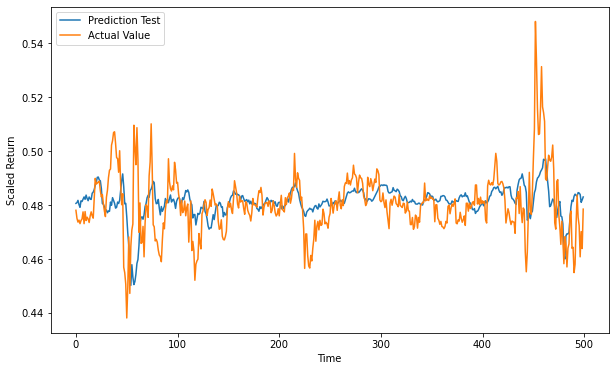


Results for AMZN :
Train Error: 0.01905711249797318 Test Error: 0.020474845794583755

Results for ANSS :
Train Error: 0.01953108462585309 Test Error: 0.02098441385951232

Results for ASML :
Train Error: 0.024445579812472362 Test Error: 0.027349436584544567

Results for ATVI :
Train Error: 0.011309107350770769 Test Error: 0.01157382845878045

Results for AVGO :
Train Error: 0.027120258931974017 Test Error: 0.03757524445227635

Results for BIDU :
Train Error: 0.026384807484297324 Test Error: 0.02362422564833015

Results for BIIB :
Train Error: 0.009961479916382009 Test Error: 0.006737454043554659

Results for BKNG :
Train Error: 0.02772992608040599 Test Error: 0.03754395607736709

Results for CDNS :
Train Error: 0.01896459107508505 Test Error: 0.02127831414914052

Results for CDW :
Train Error: 0.018879649938094694 Test Error: 0.019223233540452175

Results for CERN :
Train Error: 0.01804267604240721 Test Error: 0.03901593821420455

Results for CHKP :
Train Error: 0.01740248913692916 Tes

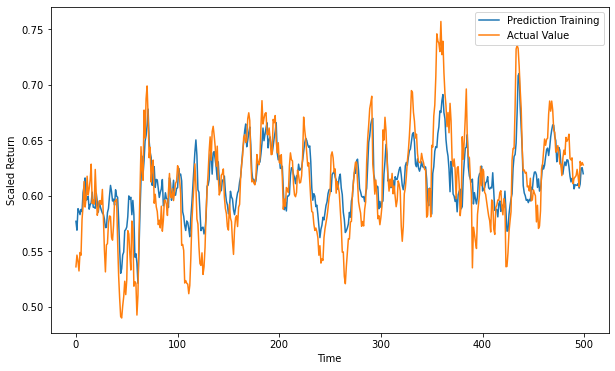

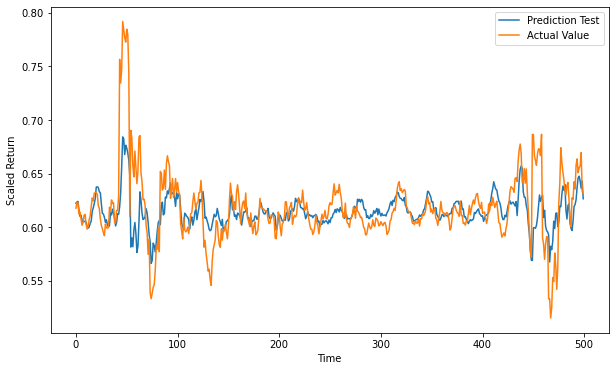


Results for $U0BB :
Train Error: 0.019529682283830743 Test Error: 0.022410295241016013


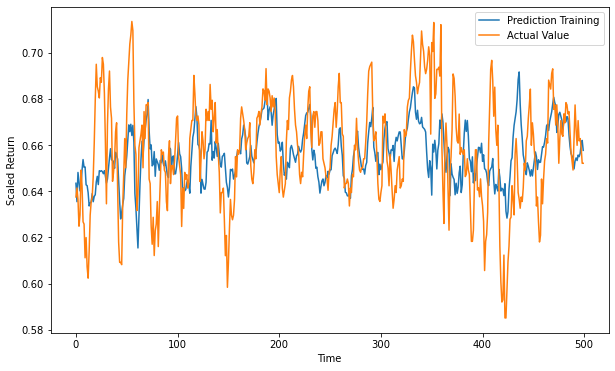

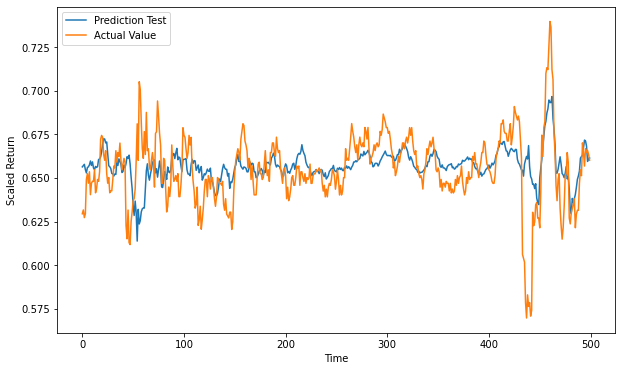


Results for $U0BD :
Train Error: 0.01800909443988757 Test Error: 0.020792185515970247


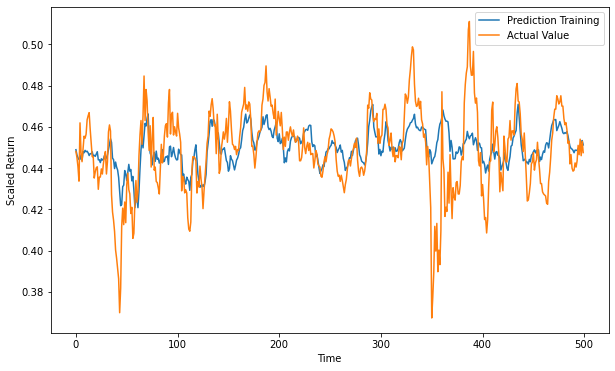

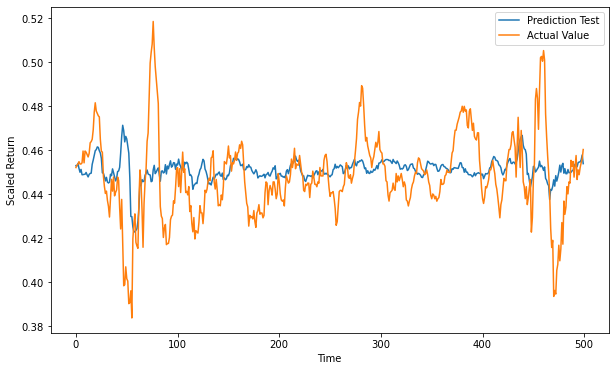


Results for $U2BB :
Train Error: 0.0350847536095095 Test Error: 0.034440293967699286


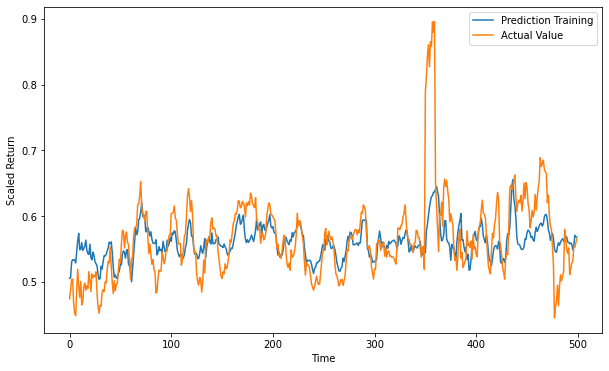

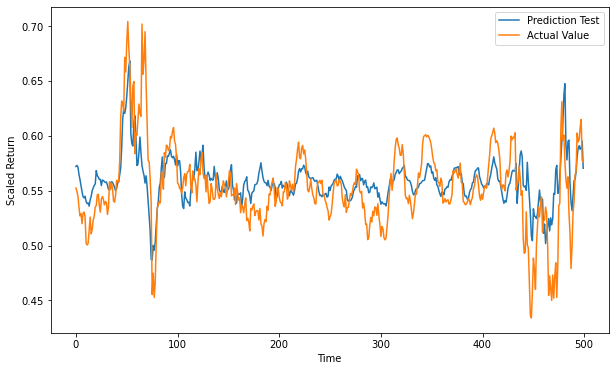


Results for $U2BD :
Train Error: 0.035184874508125456 Test Error: 0.0341955742745866


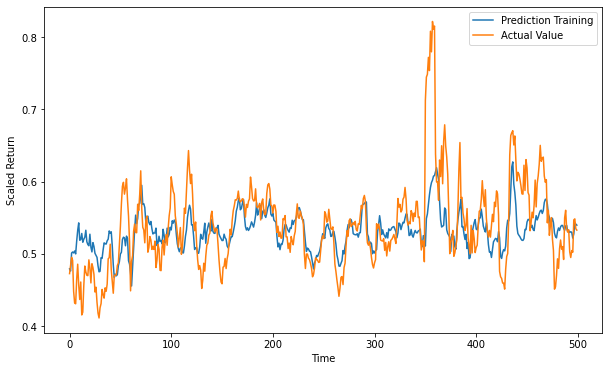

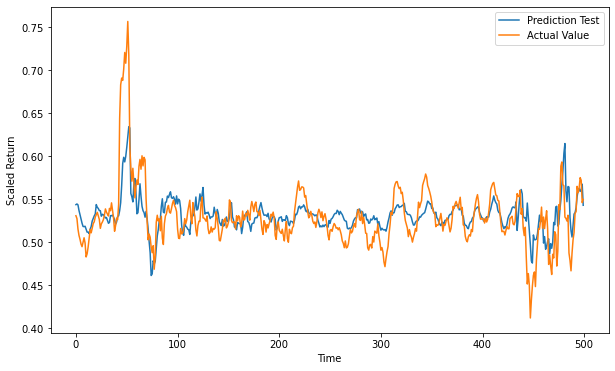


Results for $U3BD :
Train Error: 0.018474377662164785 Test Error: 0.018516200901946552


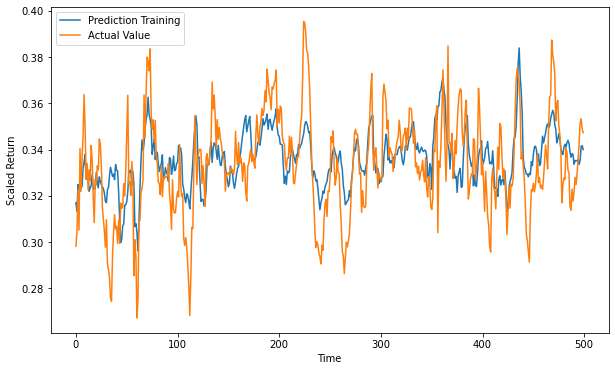

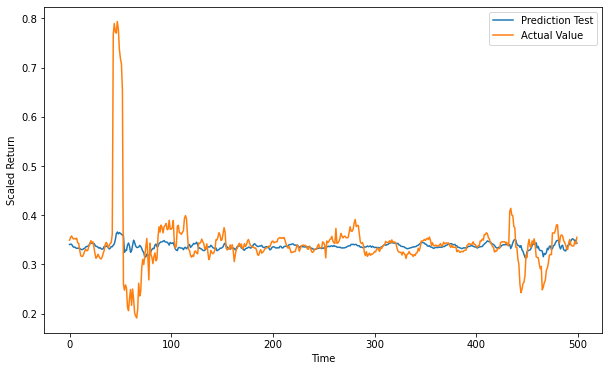


Results for $U3BF :
Train Error: 0.03070842189180564 Test Error: 0.031397692992926524


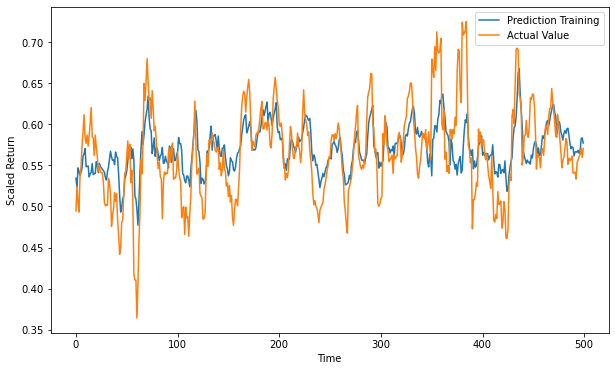

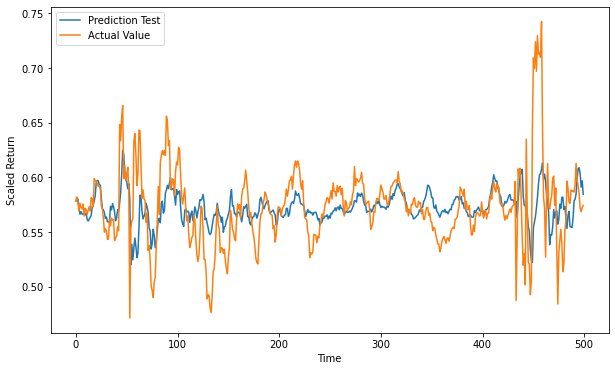


Results for $U3BH :
Train Error: 0.030483338964534794 Test Error: 0.03194807286328263


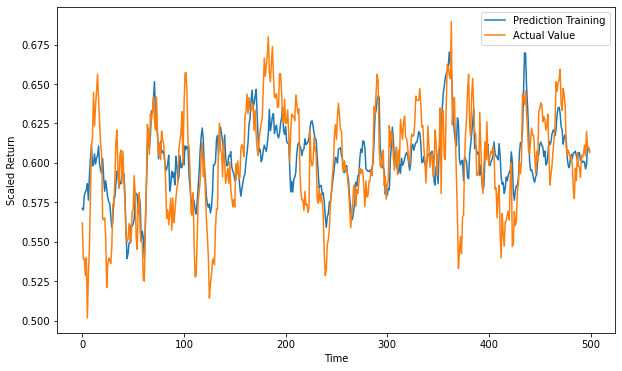

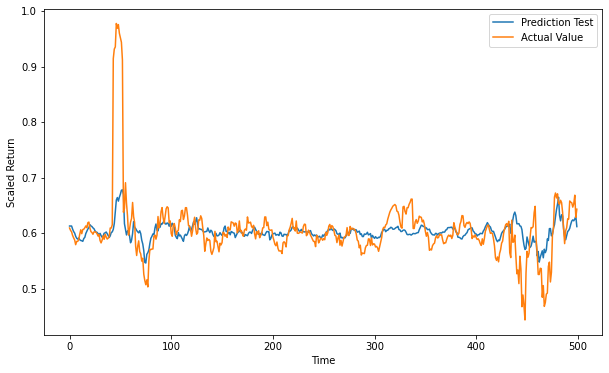


Results for $U4BB :
Train Error: 0.025814621403899164 Test Error: 0.028676496401188287


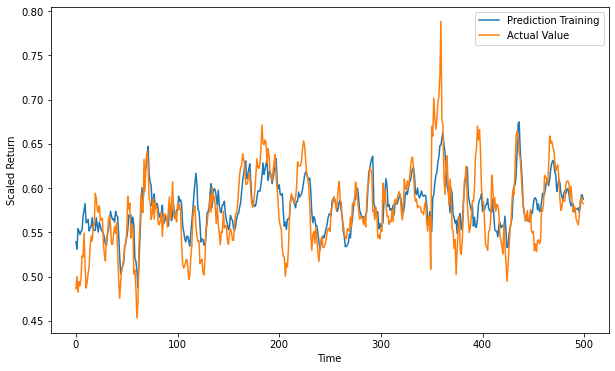

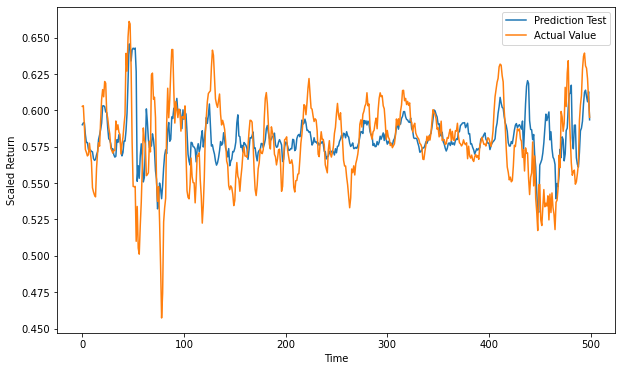


Results for $U4BD :
Train Error: 0.021734998013493503 Test Error: 0.023240493064940363


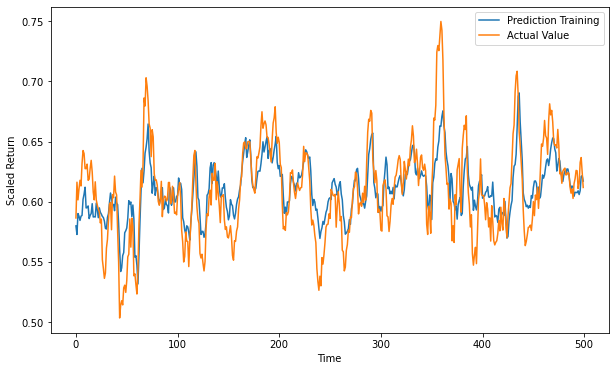

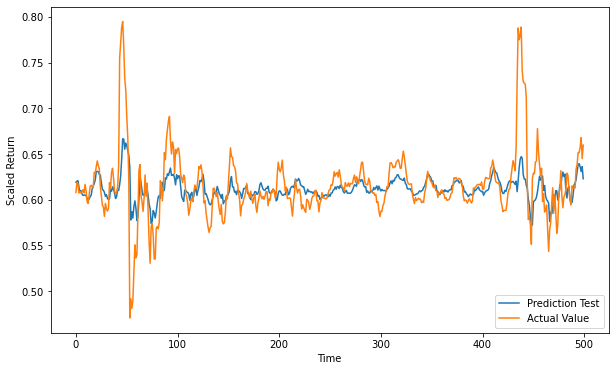


Results for $U4BF :
Train Error: 0.019911112252443845 Test Error: 0.023819579409174528

Results for $U4BH :
Train Error: 0.023188366041740648 Test Error: 0.02335635902990013

Results for $U4BJ :
Train Error: 0.021152970122907563 Test Error: 0.021667732816665484

Results for $U4BL :
Train Error: 0.021874747353809874 Test Error: 0.022124106003062156

Results for $U4BN :
Train Error: 0.025164489193192974 Test Error: 0.023363036204657708

Results for $U4DB :
Train Error: 0.02722327752741607 Test Error: 0.03386146000312064

Results for $U4DD :
Train Error: 0.022444577264996057 Test Error: 0.024936242058033648

Results for $U4FB :
Train Error: 0.014884422184388032 Test Error: 0.014079875811334375

Results for $U4FD :
Train Error: 0.02477028652220202 Test Error: 0.032704642546959636

Results for $U4FH :
Train Error: 0.02364025003324207 Test Error: 0.021871728607393778

Results for $U5BB :
Train Error: 0.027497571862822687 Test Error: 0.026642770265837952

Results for $U5BD :
Train Error: 0.0

In [41]:
# make predictions and evaluate model 
rmse_train_RNN, rmse_test_RNN, rmse_max_RNN = pred_eval(model_RNN, 'RNN')

In [42]:
# manually check for number of parameters and epochs needed 
no_params_RNN = 8538
epochs_RNN = 605 #manually 

# display results 
RNN_results = np.array(['{:}'.format(no_params_RNN), '{:}'.format(epochs_RNN), round(time_needed_RNN/60,2), 
                        '{:.3e}'.format(rmse_train_RNN), '{:.3e}'.format(rmse_test_RNN), 
                        '{:.3e}'.format(rmse_max_RNN)])
RNN_results = RNN_results.reshape((1,6))
table_RNN = pd.DataFrame(RNN_results,index=['RNN'],
                         columns=['No. Parameters','No. Epochs','Time [m]','RMSE Train','RMSE Test','RMSE Max'])
table_RNN

,No. Parameters,No. Epochs,Time [m],RMSE Train,RMSE Test,RMSE Max
RNN,8538,605,83.45,2.244e-02,2.599e-02,6.646e-02


## $\alpha$-RNN

In [28]:
# build model 
model_aRNN = AlphaRNN_()

# fit model 
time_needed_aRNN, history_aRNN = train_model(model_aRNN,'aRNN')

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 alpha_rnn (AlphaRNN)        (None, 50)                10451     
                                                                 
 dropout_8 (Dropout)         (None, 50)                0         
                                                                 
 dense_7 (Dense)             (None, 158)               8058      
                                                                 
Total params: 18,509
Trainable params: 18,509
Non-trainable params: 0
_________________________________________________________________
Epoch 1/1000
134/134 [==============================] - ETA: 0s - loss: 0.0373
Epoch 00001: val_loss improved from inf to 0.00106, saving model to best_model_aRNN.h5
134/134 [==============================] - 11s 50ms/step - loss: 0.0373 - val_loss: 0.0011
Epoch 2/1000
133/134 [============================>.] - E

Epoch 31/1000
133/134 [============================>.] - ETA: 0s - loss: 7.0549e-04- ETA: 1s - 
Epoch 00031: val_loss improved from 0.00048 to 0.00046, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 43ms/step - loss: 7.0504e-04 - val_loss: 4.6424e-04
Epoch 32/1000
133/134 [============================>.] - ETA: 0s - loss: 6.7944e-04
Epoch 00032: val_loss improved from 0.00046 to 0.00046, saving model to best_model_aRNN.h5
134/134 [==============================] - 5s 40ms/step - loss: 6.7916e-04 - val_loss: 4.5795e-04
Epoch 33/1000
133/134 [============================>.] - ETA: 0s - loss: 6.7103e-04
Epoch 00033: val_loss did not improve from 0.00046
134/134 [==============================] - 5s 39ms/step - loss: 6.7061e-04 - val_loss: 4.6247e-04
Epoch 34/1000
133/134 [============================>.] - ETA: 0s - loss: 6.3928e-04
Epoch 00034: val_loss improved from 0.00046 to 0.00045, saving model to best_model_aRNN.h5
134/134 [=========================

Epoch 62/1000
134/134 [==============================] - ETA: 0s - loss: 3.9184e-04
Epoch 00062: val_loss improved from 0.00035 to 0.00035, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 46ms/step - loss: 3.9184e-04 - val_loss: 3.4816e-04
Epoch 63/1000
133/134 [============================>.] - ETA: 0s - loss: 3.8841e-04
Epoch 00063: val_loss did not improve from 0.00035
134/134 [==============================] - 6s 47ms/step - loss: 3.8807e-04 - val_loss: 3.5054e-04
Epoch 64/1000
134/134 [==============================] - ETA: 0s - loss: 3.8597e-04
Epoch 00064: val_loss did not improve from 0.00035
134/134 [==============================] - 6s 47ms/step - loss: 3.8597e-04 - val_loss: 3.4892e-04
Epoch 65/1000
133/134 [============================>.] - ETA: 0s - loss: 3.8207e-04
Epoch 00065: val_loss improved from 0.00035 to 0.00034, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 46ms/step - loss: 3.8174e-04 - val_loss:

Epoch 95/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4730e-04
Epoch 00095: val_loss did not improve from 0.00032
134/134 [==============================] - 7s 49ms/step - loss: 3.4699e-04 - val_loss: 3.1822e-04
Epoch 96/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4764e-04
Epoch 00096: val_loss did not improve from 0.00032
134/134 [==============================] - 7s 52ms/step - loss: 3.4734e-04 - val_loss: 3.2105e-04
Epoch 97/1000
134/134 [==============================] - ETA: 0s - loss: 3.4801e-04
Epoch 00097: val_loss did not improve from 0.00032
134/134 [==============================] - 7s 50ms/step - loss: 3.4801e-04 - val_loss: 3.2073e-04
Epoch 98/1000
134/134 [==============================] - ETA: 0s - loss: 3.4768e-04
Epoch 00098: val_loss did not improve from 0.00032
134/134 [==============================] - 8s 59ms/step - loss: 3.4768e-04 - val_loss: 3.1817e-04
Epoch 99/1000
134/134 [==============================] - ETA: 0s - l

133/134 [============================>.] - ETA: 0s - loss: 3.3359e-04
Epoch 00127: val_loss improved from 0.00030 to 0.00030, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 46ms/step - loss: 3.3330e-04 - val_loss: 3.0394e-04
Epoch 128/1000
134/134 [==============================] - ETA: 0s - loss: 3.3350e-04
Epoch 00128: val_loss did not improve from 0.00030
134/134 [==============================] - 6s 47ms/step - loss: 3.3350e-04 - val_loss: 3.0541e-04
Epoch 129/1000
134/134 [==============================] - ETA: 0s - loss: 3.3383e-04
Epoch 00129: val_loss improved from 0.00030 to 0.00030, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 49ms/step - loss: 3.3383e-04 - val_loss: 3.0337e-04
Epoch 130/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3351e-04
Epoch 00130: val_loss did not improve from 0.00030
134/134 [==============================] - 6s 45ms/step - loss: 3.3321e-04 - val_loss: 3.0354e-04

Epoch 160/1000
134/134 [==============================] - ETA: 0s - loss: 3.2571e-04
Epoch 00160: val_loss improved from 0.00030 to 0.00030, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 46ms/step - loss: 3.2571e-04 - val_loss: 2.9781e-04
Epoch 161/1000
134/134 [==============================] - ETA: 0s - loss: 3.2543e-04
Epoch 00161: val_loss did not improve from 0.00030
134/134 [==============================] - 6s 47ms/step - loss: 3.2543e-04 - val_loss: 2.9916e-04
Epoch 162/1000
133/134 [============================>.] - ETA: 0s - loss: 3.2682e-04
Epoch 00162: val_loss did not improve from 0.00030
134/134 [==============================] - 6s 47ms/step - loss: 3.2652e-04 - val_loss: 2.9954e-04
Epoch 163/1000
133/134 [============================>.] - ETA: 0s - loss: 3.2687e-04
Epoch 00163: val_loss improved from 0.00030 to 0.00030, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 46ms/step - loss: 3.2658e-04 - val_l

Epoch 194/1000
134/134 [==============================] - ETA: 0s - loss: 3.2213e-04
Epoch 00194: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 47ms/step - loss: 3.2213e-04 - val_loss: 2.9429e-04
Epoch 195/1000
133/134 [============================>.] - ETA: 0s - loss: 3.2153e-04
Epoch 00195: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 45ms/step - loss: 3.2124e-04 - val_loss: 2.9466e-04
Epoch 196/1000
133/134 [============================>.] - ETA: 0s - loss: 3.2285e-04
Epoch 00196: val_loss improved from 0.00029 to 0.00029, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 46ms/step - loss: 3.2255e-04 - val_loss: 2.9413e-04
Epoch 197/1000
133/134 [============================>.] - ETA: 0s - loss: 3.2022e-04
Epoch 00197: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 46ms/step - loss: 3.1995e-04 - val_loss: 2.9430e-04
Epoch 198/1000
133/134 [

Epoch 228/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1800e-04
Epoch 00228: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 46ms/step - loss: 3.1771e-04 - val_loss: 2.9296e-04
Epoch 229/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1799e-04
Epoch 00229: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 45ms/step - loss: 3.1770e-04 - val_loss: 2.9214e-04
Epoch 230/1000
134/134 [==============================] - ETA: 0s - loss: 3.1728e-04
Epoch 00230: val_loss improved from 0.00029 to 0.00029, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 47ms/step - loss: 3.1728e-04 - val_loss: 2.9066e-04
Epoch 231/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1804e-04
Epoch 00231: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 45ms/step - loss: 3.1773e-04 - val_loss: 2.9123e-04
Epoch 232/1000
134/134 [

Epoch 262/1000
134/134 [==============================] - ETA: 0s - loss: 3.1575e-04
Epoch 00262: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 48ms/step - loss: 3.1575e-04 - val_loss: 2.8970e-04
Epoch 263/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1525e-04
Epoch 00263: val_loss did not improve from 0.00029
134/134 [==============================] - 7s 51ms/step - loss: 3.1498e-04 - val_loss: 2.9034e-04
Epoch 264/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1559e-04
Epoch 00264: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 46ms/step - loss: 3.1529e-04 - val_loss: 2.9142e-04
Epoch 265/1000
134/134 [==============================] - ETA: 0s - loss: 3.1510e-04
Epoch 00265: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 46ms/step - loss: 3.1510e-04 - val_loss: 2.9133e-04
Epoch 266/1000
134/134 [==============================] - ETA: 0

134/134 [==============================] - ETA: 0s - loss: 3.1388e-04
Epoch 00296: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 45ms/step - loss: 3.1388e-04 - val_loss: 2.9126e-04
Epoch 297/1000
134/134 [==============================] - ETA: 0s - loss: 3.1302e-04
Epoch 00297: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 45ms/step - loss: 3.1302e-04 - val_loss: 2.8954e-04
Epoch 298/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1405e-04
Epoch 00298: val_loss did not improve from 0.00029
134/134 [==============================] - 6s 44ms/step - loss: 3.1377e-04 - val_loss: 2.8774e-04
Epoch 299/1000
134/134 [==============================] - ETA: 0s - loss: 3.1377e-04
Epoch 00299: val_loss improved from 0.00029 to 0.00029, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 46ms/step - loss: 3.1377e-04 - val_loss: 2.8639e-04
Epoch 300/1000
134/134 [===============

Epoch 331/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1301e-04
Epoch 00331: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 47ms/step - loss: 3.1272e-04 - val_loss: 2.8690e-04
Epoch 332/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1246e-04
Epoch 00332: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.1216e-04 - val_loss: 2.8905e-04
Epoch 333/1000
134/134 [==============================] - ETA: 0s - loss: 3.1246e-04
Epoch 00333: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.1246e-04 - val_loss: 2.8737e-04
Epoch 334/1000
134/134 [==============================] - ETA: 0s - loss: 3.1312e-04
Epoch 00334: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.1312e-04 - val_loss: 2.8980e-04
Epoch 335/1000
133/134 [============================>.] - ETA: 0

Epoch 366/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1096e-04
Epoch 00366: val_loss improved from 0.00028 to 0.00028, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 44ms/step - loss: 3.1067e-04 - val_loss: 2.8415e-04
Epoch 367/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1147e-04
Epoch 00367: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.1117e-04 - val_loss: 2.8507e-04
Epoch 368/1000
134/134 [==============================] - ETA: 0s - loss: 3.1071e-04
Epoch 00368: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 46ms/step - loss: 3.1071e-04 - val_loss: 2.8601e-04
Epoch 369/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1176e-04
Epoch 00369: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.1147e-04 - val_loss: 2.8463e-04
Epoch 370/1000
133/134 [

134/134 [==============================] - ETA: 0s - loss: 3.1008e-04
Epoch 00400: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.1008e-04 - val_loss: 2.8568e-04
Epoch 401/1000
134/134 [==============================] - ETA: 0s - loss: 3.1040e-04
Epoch 00401: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.1040e-04 - val_loss: 2.8628e-04
Epoch 402/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1087e-04
Epoch 00402: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 46ms/step - loss: 3.1058e-04 - val_loss: 2.8376e-04
Epoch 403/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0956e-04
Epoch 00403: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0929e-04 - val_loss: 2.8364e-04
Epoch 404/1000
133/134 [============================>.] - ETA: 0s - loss: 3.096

Epoch 435/1000
133/134 [============================>.] - ETA: 0s - loss: 3.1026e-04
Epoch 00435: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0996e-04 - val_loss: 2.8437e-04
Epoch 436/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0924e-04
Epoch 00436: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0897e-04 - val_loss: 2.8339e-04
Epoch 437/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0908e-04
Epoch 00437: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0880e-04 - val_loss: 2.8279e-04
Epoch 438/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0919e-04
Epoch 00438: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0890e-04 - val_loss: 2.8406e-04
Epoch 439/1000
134/134 [==============================] - ETA: 0

Epoch 470/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0885e-04
Epoch 00470: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0858e-04 - val_loss: 2.8349e-04
Epoch 471/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0814e-04
Epoch 00471: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 46ms/step - loss: 3.0786e-04 - val_loss: 2.8267e-04
Epoch 472/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0950e-04
Epoch 00472: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0922e-04 - val_loss: 2.8273e-04
Epoch 473/1000
134/134 [==============================] - ETA: 0s - loss: 3.0738e-04
Epoch 00473: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0738e-04 - val_loss: 2.8228e-04
Epoch 474/1000
133/134 [============================>.] - ETA: 0

133/134 [============================>.] - ETA: 0s - loss: 3.0766e-04
Epoch 00504: val_loss improved from 0.00028 to 0.00028, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 46ms/step - loss: 3.0738e-04 - val_loss: 2.8075e-04
Epoch 505/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0861e-04
Epoch 00505: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0833e-04 - val_loss: 2.8297e-04
Epoch 506/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0973e-04
Epoch 00506: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0945e-04 - val_loss: 2.8557e-04
Epoch 507/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0745e-04
Epoch 00507: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0718e-04 - val_loss: 2.8386e-04
Epoch 508/1000
134/134 [===============

Epoch 539/1000
134/134 [==============================] - ETA: 0s - loss: 3.0766e-04
Epoch 00539: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 48ms/step - loss: 3.0766e-04 - val_loss: 2.8270e-04
Epoch 540/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0821e-04
Epoch 00540: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 48ms/step - loss: 3.0794e-04 - val_loss: 2.8083e-04
Epoch 541/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0843e-04
Epoch 00541: val_loss improved from 0.00028 to 0.00028, saving model to best_model_aRNN.h5
134/134 [==============================] - 7s 49ms/step - loss: 3.0815e-04 - val_loss: 2.8047e-04
Epoch 542/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0735e-04
Epoch 00542: val_loss did not improve from 0.00028
134/134 [==============================] - 7s 49ms/step - loss: 3.0708e-04 - val_loss: 2.8105e-04
Epoch 543/1000
134/134 [

Epoch 574/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0763e-04
Epoch 00574: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 46ms/step - loss: 3.0734e-04 - val_loss: 2.7991e-04
Epoch 575/1000
134/134 [==============================] - ETA: 0s - loss: 3.0746e-04
Epoch 00575: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 46ms/step - loss: 3.0746e-04 - val_loss: 2.8181e-04
Epoch 576/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0732e-04
Epoch 00576: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 46ms/step - loss: 3.0702e-04 - val_loss: 2.8136e-04
Epoch 577/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0748e-04
Epoch 00577: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0718e-04 - val_loss: 2.8071e-04
Epoch 578/1000
134/134 [==============================] - ETA: 0

Epoch 609/1000
134/134 [==============================] - ETA: 0s - loss: 3.0678e-04
Epoch 00609: val_loss did not improve from 0.00028
134/134 [==============================] - 7s 49ms/step - loss: 3.0678e-04 - val_loss: 2.8140e-04
Epoch 610/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0637e-04
Epoch 00610: val_loss did not improve from 0.00028
134/134 [==============================] - 7s 49ms/step - loss: 3.0607e-04 - val_loss: 2.8180e-04
Epoch 611/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0541e-04
Epoch 00611: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 48ms/step - loss: 3.0517e-04 - val_loss: 2.7945e-04
Epoch 612/1000
134/134 [==============================] - ETA: 0s - loss: 3.0676e-04
Epoch 00612: val_loss improved from 0.00028 to 0.00028, saving model to best_model_aRNN.h5
134/134 [==============================] - 7s 50ms/step - loss: 3.0676e-04 - val_loss: 2.7936e-04
Epoch 613/1000
133/134 [

Epoch 644/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0605e-04
Epoch 00644: val_loss improved from 0.00028 to 0.00028, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 45ms/step - loss: 3.0577e-04 - val_loss: 2.7886e-04
Epoch 645/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0661e-04
Epoch 00645: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0633e-04 - val_loss: 2.7944e-04
Epoch 646/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0708e-04
Epoch 00646: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0679e-04 - val_loss: 2.8157e-04
Epoch 647/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0559e-04
Epoch 00647: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 47ms/step - loss: 3.0531e-04 - val_loss: 2.8238e-04
Epoch 648/1000
133/134 [

Epoch 679/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0570e-04
Epoch 00679: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0543e-04 - val_loss: 2.7888e-04
Epoch 680/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0597e-04
Epoch 00680: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0570e-04 - val_loss: 2.7954e-04
Epoch 681/1000
134/134 [==============================] - ETA: 0s - loss: 3.0591e-04
Epoch 00681: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 46ms/step - loss: 3.0591e-04 - val_loss: 2.8027e-04
Epoch 682/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0678e-04
Epoch 00682: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0647e-04 - val_loss: 2.8269e-04
Epoch 683/1000
133/134 [============================>.] - ETA: 0

Epoch 714/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0637e-04
Epoch 00714: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0610e-04 - val_loss: 2.7870e-04
Epoch 715/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0573e-04
Epoch 00715: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 46ms/step - loss: 3.0544e-04 - val_loss: 2.7848e-04
Epoch 716/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0527e-04
Epoch 00716: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0497e-04 - val_loss: 2.8060e-04
Epoch 717/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0562e-04
Epoch 00717: val_loss did not improve from 0.00028
134/134 [==============================] - 7s 51ms/step - loss: 3.0532e-04 - val_loss: 2.7954e-04
Epoch 718/1000
133/134 [============================>.] - ETA: 0

133/134 [============================>.] - ETA: 0s - loss: 3.0585e-04
Epoch 00749: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 47ms/step - loss: 3.0554e-04 - val_loss: 2.8030e-04
Epoch 750/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0640e-04
Epoch 00750: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0611e-04 - val_loss: 2.8213e-04
Epoch 751/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0472e-04
Epoch 00751: val_loss improved from 0.00028 to 0.00028, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 45ms/step - loss: 3.0441e-04 - val_loss: 2.7807e-04
Epoch 752/1000
134/134 [==============================] - ETA: 0s - loss: 3.0560e-04
Epoch 00752: val_loss improved from 0.00028 to 0.00028, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 46ms/step - loss: 3.0560e-04 - val_loss: 2.7778e-04

Epoch 784/1000
134/134 [==============================] - ETA: 0s - loss: 3.0470e-04
Epoch 00784: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0470e-04 - val_loss: 2.7969e-04
Epoch 785/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0442e-04
Epoch 00785: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 47ms/step - loss: 3.0413e-04 - val_loss: 2.7914e-04
Epoch 786/1000
134/134 [==============================] - ETA: 0s - loss: 3.0465e-04
Epoch 00786: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0465e-04 - val_loss: 2.7916e-04
Epoch 787/1000
134/134 [==============================] - ETA: 0s - loss: 3.0428e-04
Epoch 00787: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0428e-04 - val_loss: 2.7814e-04
Epoch 788/1000
134/134 [==============================] - ETA: 0

Epoch 819/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0502e-04- ETA: 0s - loss: 3.13
Epoch 00819: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 46ms/step - loss: 3.0475e-04 - val_loss: 2.7787e-04
Epoch 820/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0622e-04
Epoch 00820: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0593e-04 - val_loss: 2.7866e-04
Epoch 821/1000
134/134 [==============================] - ETA: 0s - loss: 3.0476e-04
Epoch 00821: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0476e-04 - val_loss: 2.7841e-04
Epoch 822/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0473e-04
Epoch 00822: val_loss improved from 0.00028 to 0.00028, saving model to best_model_aRNN.h5
134/134 [==============================] - 6s 48ms/step - loss: 3.0446e-04 - val_loss: 2.7718e-04
Ep

Epoch 854/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0453e-04
Epoch 00854: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0425e-04 - val_loss: 2.7840e-04
Epoch 855/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0486e-04
Epoch 00855: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0457e-04 - val_loss: 2.7765e-04
Epoch 856/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0478e-04
Epoch 00856: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 45ms/step - loss: 3.0449e-04 - val_loss: 2.7895e-04
Epoch 857/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0488e-04
Epoch 00857: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 44ms/step - loss: 3.0459e-04 - val_loss: 2.7967e-04
Epoch 858/1000
133/134 [============================>.] - ETA: 0

Epoch 889/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0435e-04
Epoch 00889: val_loss did not improve from 0.00028
134/134 [==============================] - 7s 49ms/step - loss: 3.0410e-04 - val_loss: 2.7739e-04
Epoch 890/1000
134/134 [==============================] - ETA: 0s - loss: 3.0367e-04
Epoch 00890: val_loss did not improve from 0.00028
134/134 [==============================] - 7s 55ms/step - loss: 3.0367e-04 - val_loss: 2.7853e-04
Epoch 891/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0472e-04
Epoch 00891: val_loss did not improve from 0.00028
134/134 [==============================] - 7s 52ms/step - loss: 3.0443e-04 - val_loss: 2.7738e-04
Epoch 892/1000
133/134 [============================>.] - ETA: 0s - loss: 3.0472e-04
Epoch 00892: val_loss did not improve from 0.00028
134/134 [==============================] - 6s 47ms/step - loss: 3.0444e-04 - val_loss: 2.7787e-04
Epoch 893/1000
133/134 [============================>.] - ETA: 0

459/459 [==============================] - 2s 4ms/step

Results for AAPL :
Train Error: 0.014369955685677428 Test Error: 0.01705157448712391


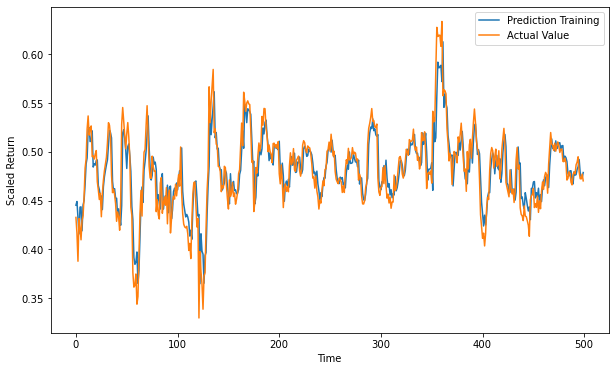

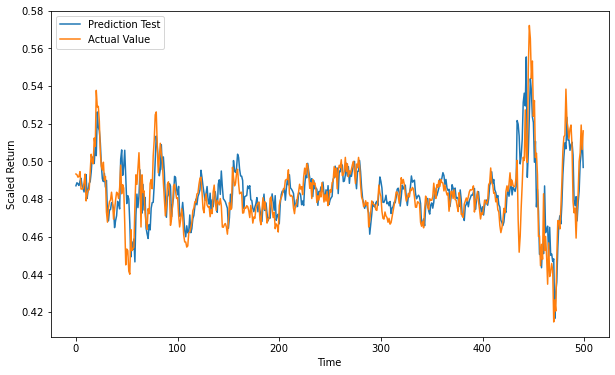


Results for ADBE :
Train Error: 0.016153174369504385 Test Error: 0.03604091992770613


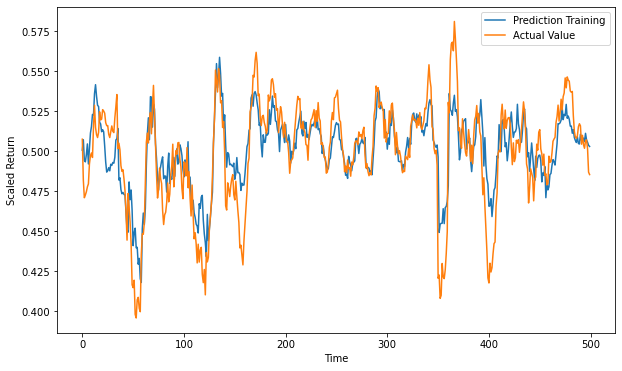

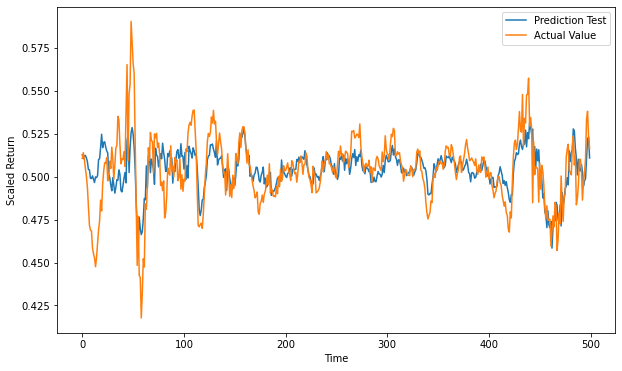


Results for ADI :
Train Error: 0.020500928302694503 Test Error: 0.0217076940799272


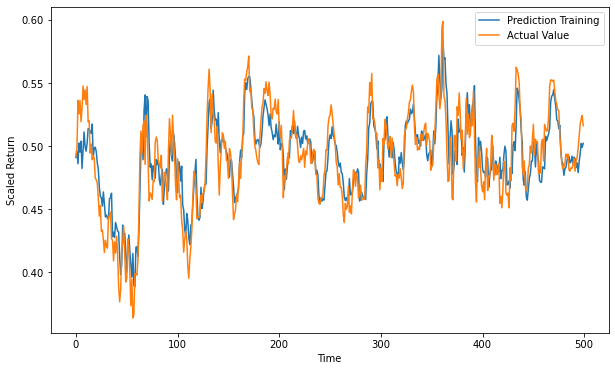

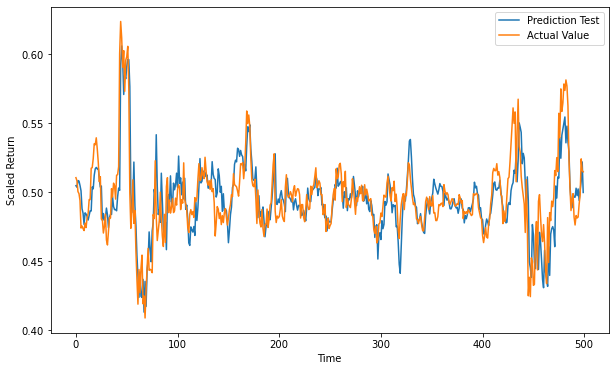


Results for ADP :
Train Error: 0.017230945714360808 Test Error: 0.019722541950536864


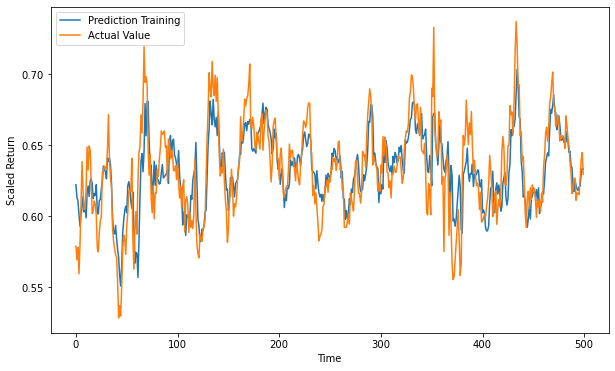

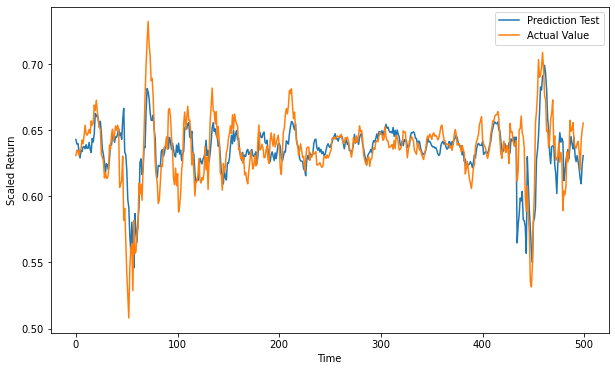


Results for ADSK :
Train Error: 0.015215604769430582 Test Error: 0.03291433858349669


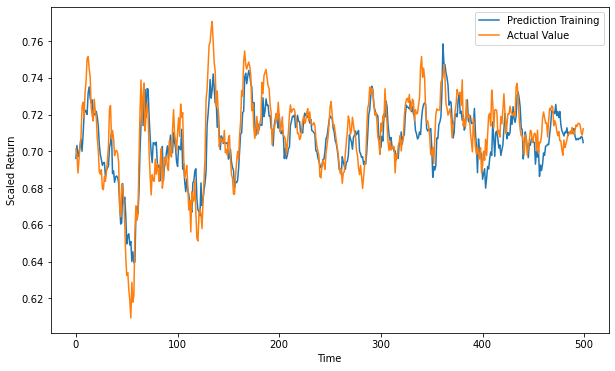

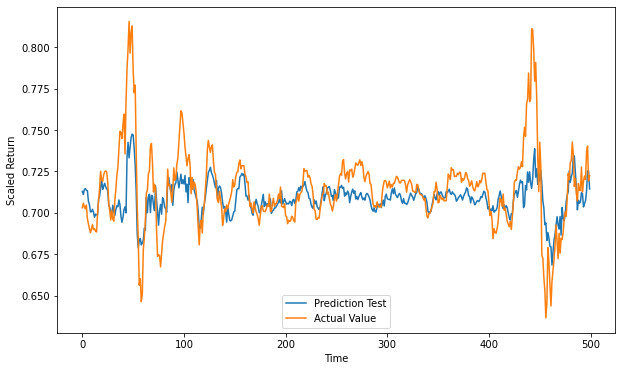


Results for AEP :
Train Error: 0.019822978992126126 Test Error: 0.018276491751549405


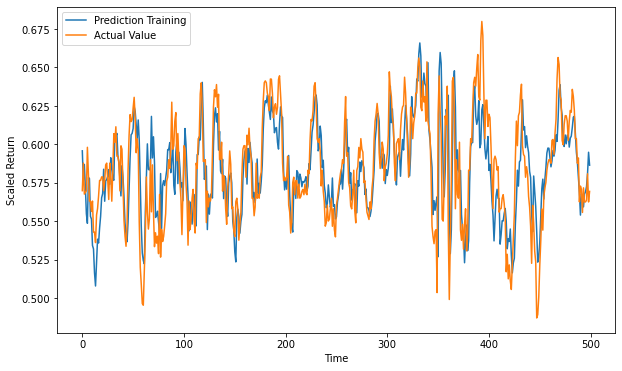

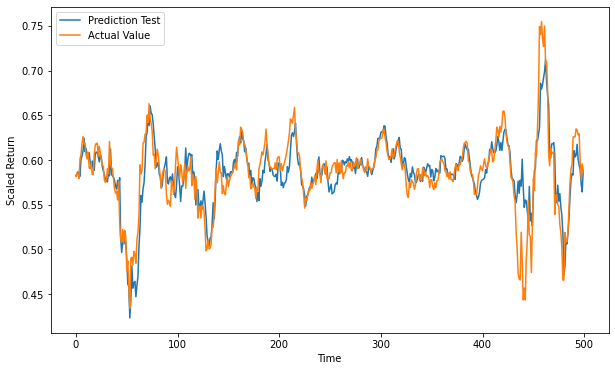


Results for ALGN :
Train Error: 0.014805207858683627 Test Error: 0.01359306021021209


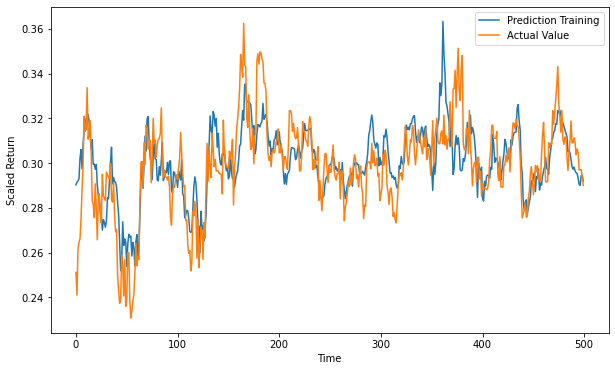

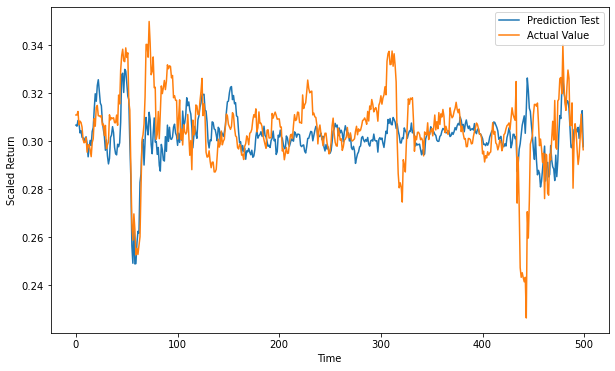


Results for AMAT :
Train Error: 0.014420661067880706 Test Error: 0.014993174476749518


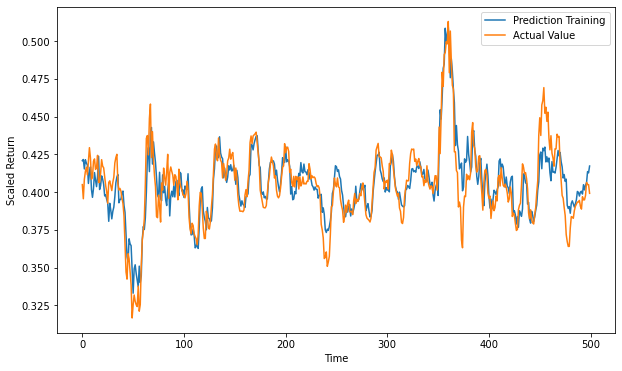

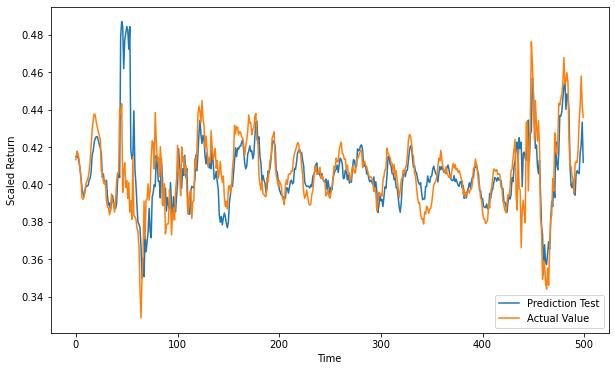


Results for AMD :
Train Error: 0.015360988235222289 Test Error: 0.02132994489386414


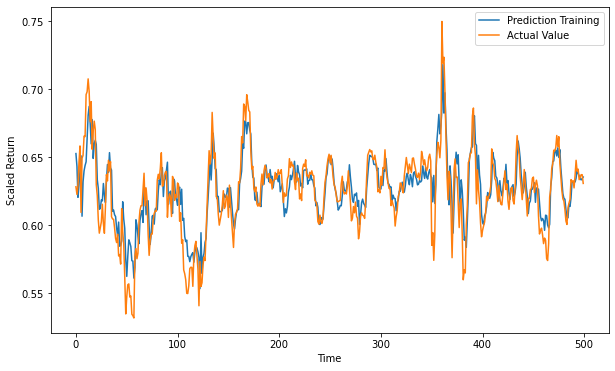

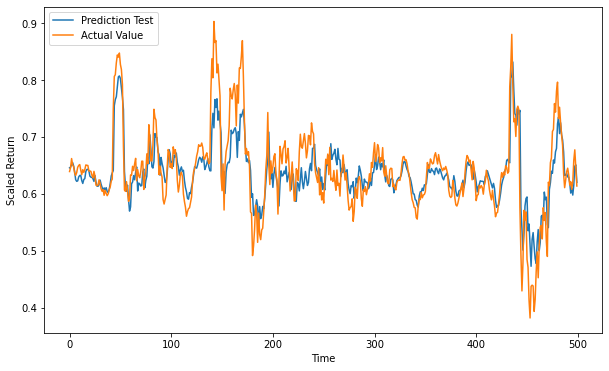


Results for AMGN :
Train Error: 0.010856144395170186 Test Error: 0.012034030956717892


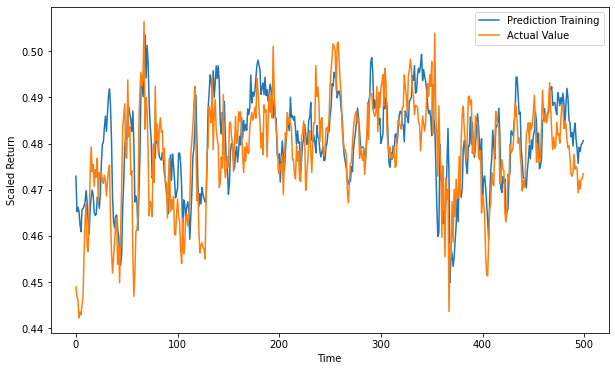

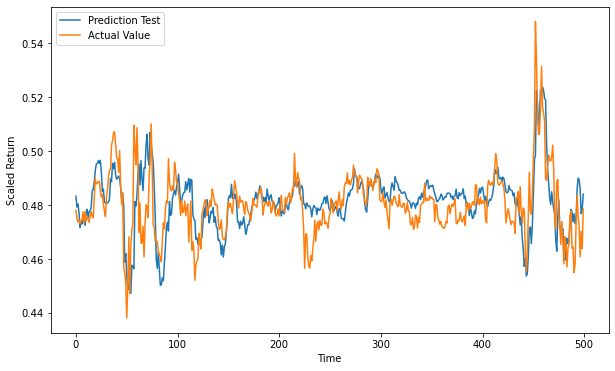


Results for AMZN :
Train Error: 0.01307869816323336 Test Error: 0.0150947389284207

Results for ANSS :
Train Error: 0.01631292838416226 Test Error: 0.017021149097621747

Results for ASML :
Train Error: 0.019165839374494353 Test Error: 0.02122086549934078

Results for ATVI :
Train Error: 0.010491530548983047 Test Error: 0.011215175445616945

Results for AVGO :
Train Error: 0.020950785433238233 Test Error: 0.029857084360547282

Results for BIDU :
Train Error: 0.017195934467269698 Test Error: 0.016303788865753607

Results for BIIB :
Train Error: 0.009581145844747662 Test Error: 0.006617581168632984

Results for BKNG :
Train Error: 0.01779530701391073 Test Error: 0.02429949678516719

Results for CDNS :
Train Error: 0.015568002178016127 Test Error: 0.016600830575837673

Results for CDW :
Train Error: 0.01649454863907714 Test Error: 0.016863666871338563

Results for CERN :
Train Error: 0.011754261369738077 Test Error: 0.024727850543135383

Results for CHKP :
Train Error: 0.01576621490577134

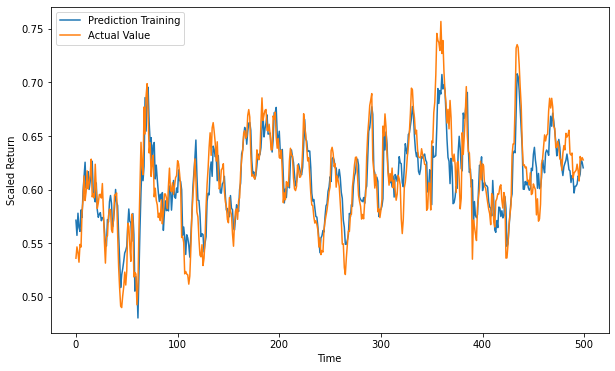

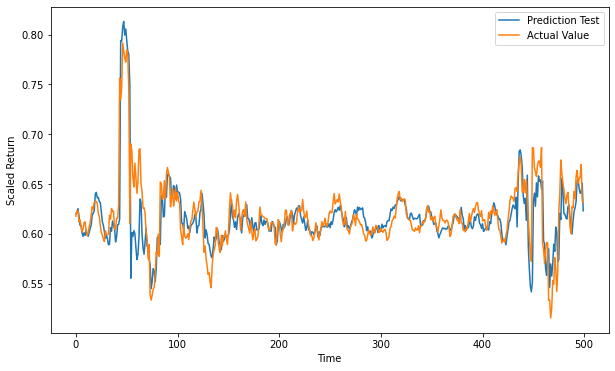


Results for $U0BB :
Train Error: 0.016505320046317322 Test Error: 0.0197511236295845


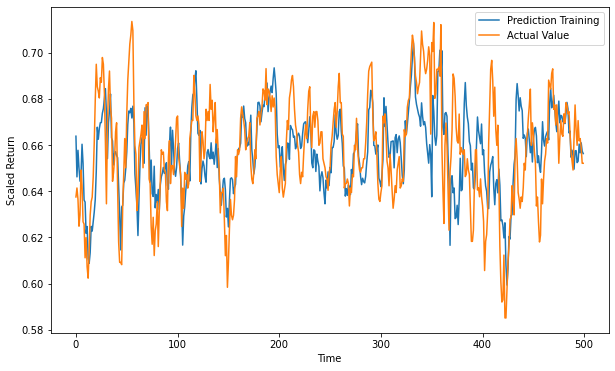

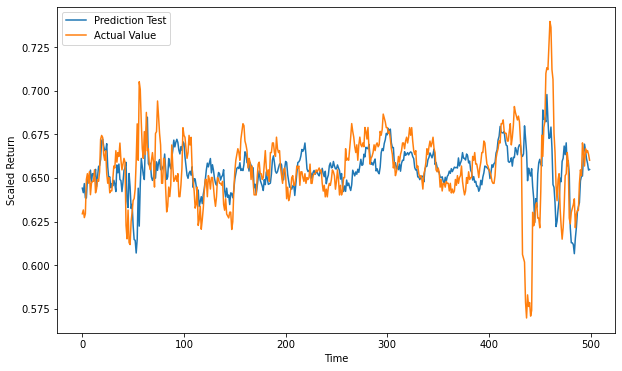


Results for $U0BD :
Train Error: 0.011658857342646949 Test Error: 0.011450736138261107


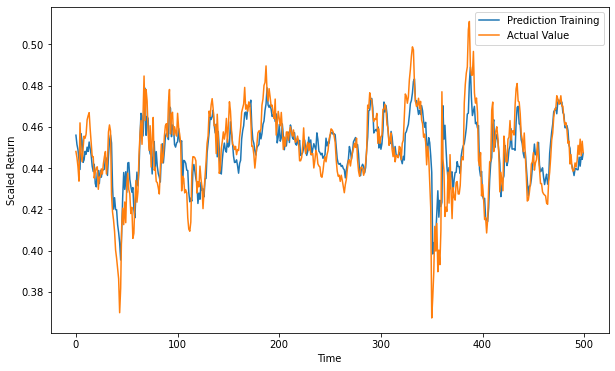

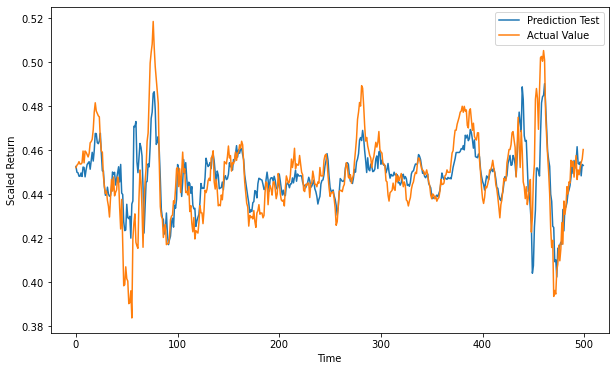


Results for $U2BB :
Train Error: 0.022368955800974626 Test Error: 0.02303426587159663


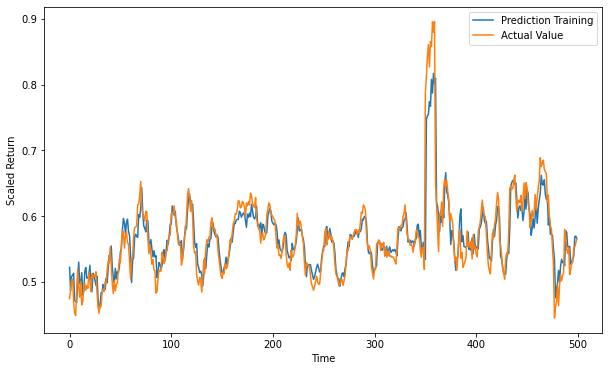

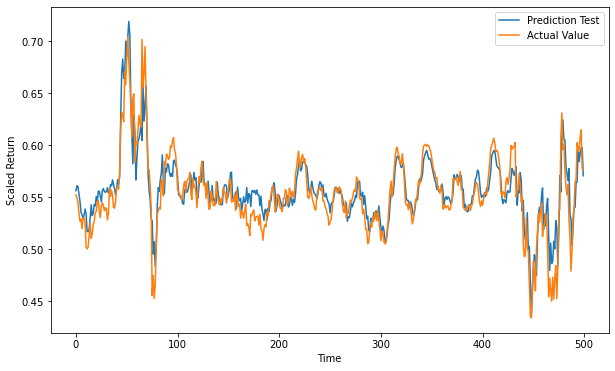


Results for $U2BD :
Train Error: 0.02206135426435433 Test Error: 0.022935550142284426


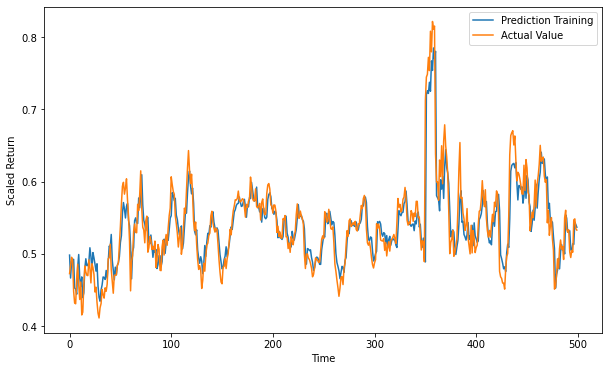

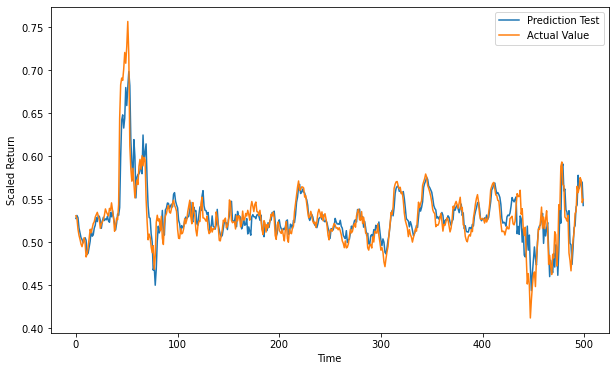


Results for $U3BD :
Train Error: 0.016528195091890085 Test Error: 0.016771583314674394


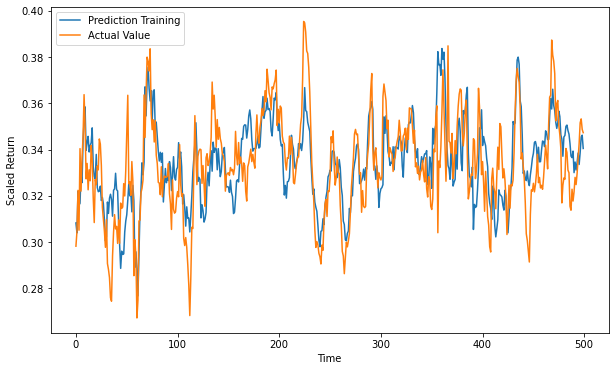

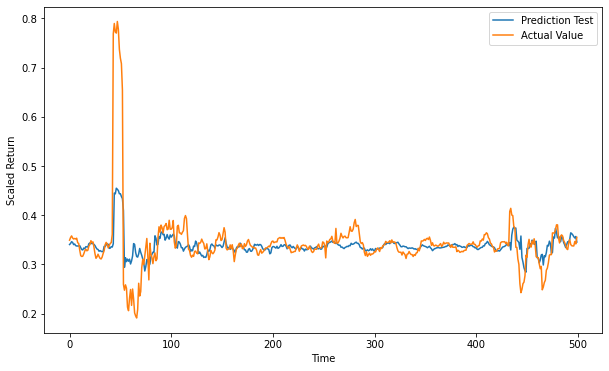


Results for $U3BF :
Train Error: 0.01828689260339067 Test Error: 0.019140117613246486


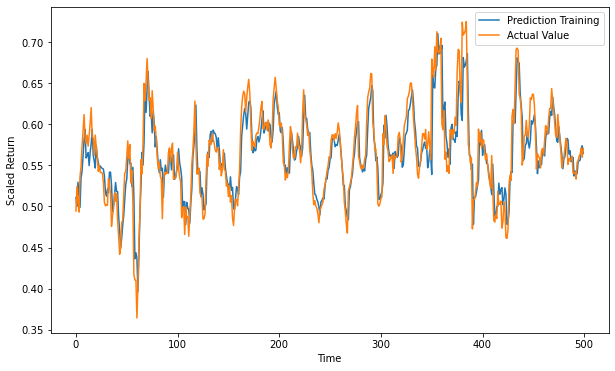

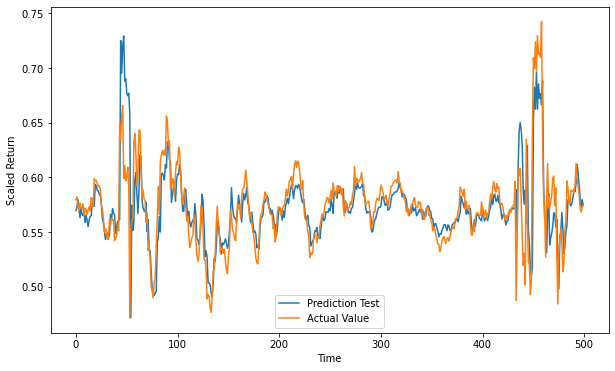


Results for $U3BH :
Train Error: 0.018111328151039528 Test Error: 0.018836286792337176


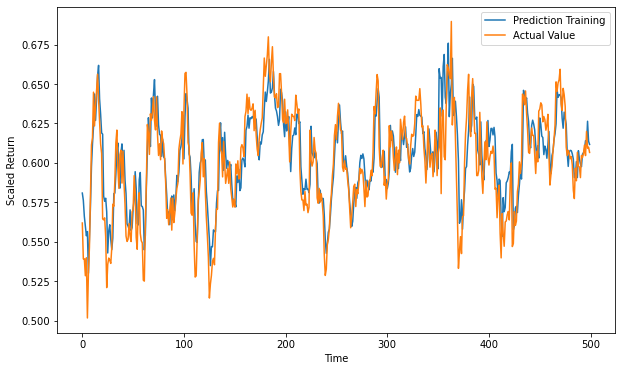

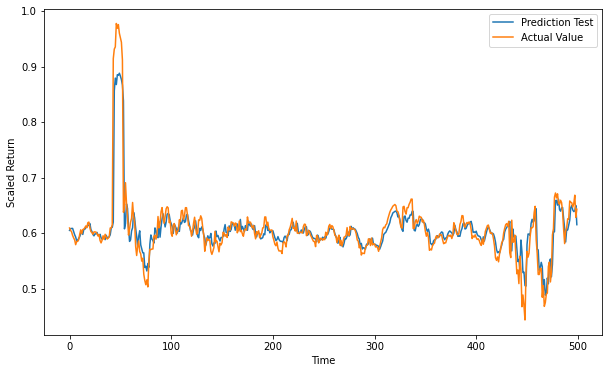


Results for $U4BB :
Train Error: 0.01837243889504338 Test Error: 0.021166379193929014


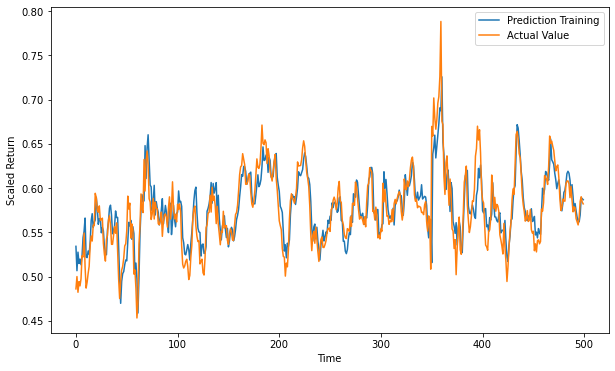

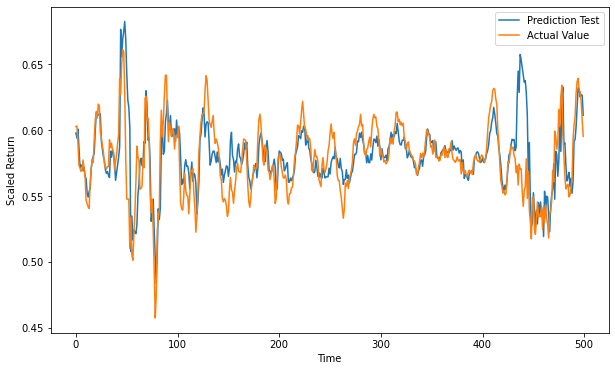


Results for $U4BD :
Train Error: 0.017653536787012813 Test Error: 0.018124192504288174


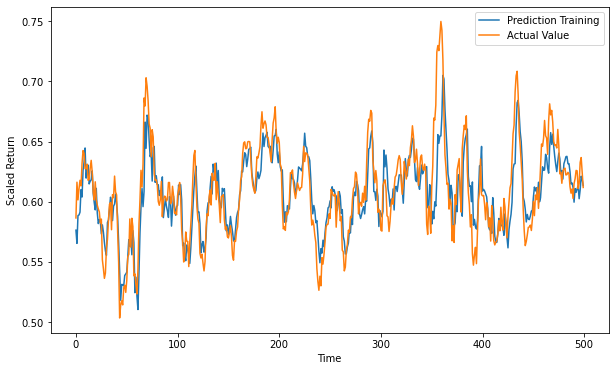

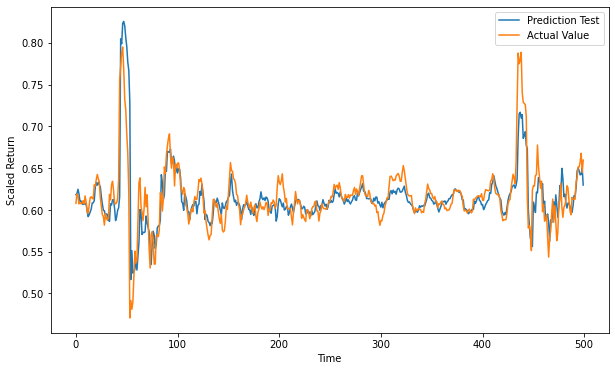


Results for $U4BF :
Train Error: 0.017981743595318834 Test Error: 0.021249617295761664

Results for $U4BH :
Train Error: 0.01835047584030001 Test Error: 0.01860286758288717

Results for $U4BJ :
Train Error: 0.017095478564651972 Test Error: 0.01779715159964672

Results for $U4BL :
Train Error: 0.01662755426306014 Test Error: 0.017566978895036965

Results for $U4BN :
Train Error: 0.01693797125781605 Test Error: 0.016663501872215963

Results for $U4DB :
Train Error: 0.019026682811792265 Test Error: 0.023261772300597672

Results for $U4DD :
Train Error: 0.015921447590678282 Test Error: 0.018374168395180458

Results for $U4FB :
Train Error: 0.013854017424210286 Test Error: 0.013319210381601899

Results for $U4FD :
Train Error: 0.01844340055474574 Test Error: 0.022121004212197166

Results for $U4FH :
Train Error: 0.014677807840113322 Test Error: 0.014427360584815474

Results for $U5BB :
Train Error: 0.01910048995508542 Test Error: 0.019594870718735044

Results for $U5BD :
Train Error: 0.013

In [43]:
# make predictions and evaluate model 
rmse_train_aRNN, rmse_test_aRNN, rmse_max_aRNN = pred_eval(model_aRNN, 'aRNN')

In [44]:
# manually check for number of parameters and epochs needed 
no_params_aRNN = 18509
epochs_aRNN = 915 #manually 

# display results 
aRNN_results = np.array(['{:}'.format(no_params_aRNN), '{:}'.format(epochs_aRNN), round(time_needed_aRNN/60,2), 
                        '{:.3e}'.format(rmse_train_aRNN), '{:.3e}'.format(rmse_test_aRNN), 
                        '{:.3e}'.format(rmse_max_aRNN)])
aRNN_results = aRNN_results.reshape((1,6))
table_aRNN = pd.DataFrame(aRNN_results,index=['Alpha RNN'],
                         columns=['No. Parameters','No. Epochs','Time [m]','RMSE Train','RMSE Test','RMSE Max'])
table_aRNN

,No. Parameters,No. Epochs,Time [m],RMSE Train,RMSE Test,RMSE Max
Alpha RNN,18509,915,95.5,1.621e-02,1.901e-02,5.750e-02


The upcoming models will require more complex training and we will thus add an additional callback, which guarantees that the best model will be saved at the end of the fitting. Moreover, the early stopping criterion is adapted and less sensible. 

## $\alpha_t$-RNN

In [31]:
# build model 
model_atRNN = AlphatRNN_()

# fit model 
time_needed_atRNN, history_atRNN = train_model(model_atRNN,'atRNN')

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 alphat_rnn (AlphatRNN)      (None, 50)                21000     
                                                                 
 dropout_9 (Dropout)         (None, 50)                0         
                                                                 
 dense_8 (Dense)             (None, 158)               8058      
                                                                 
Total params: 29,058
Trainable params: 29,058
Non-trainable params: 0
_________________________________________________________________
Epoch 1/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0421
Epoch 00001: val_loss improved from inf to 0.00102, saving model to best_model_atRNN.h5
134/134 [==============================] - 18s 83ms/step - loss: 0.0420 - val_loss: 0.0010
Epoch 2/1000
133/134 [============================>.] - 

Epoch 29/1000
133/134 [============================>.] - ETA: 0s - loss: 7.7667e-04
Epoch 00029: val_loss did not improve from 0.00051
134/134 [==============================] - 11s 83ms/step - loss: 7.7617e-04 - val_loss: 5.1023e-04
Epoch 30/1000
133/134 [============================>.] - ETA: 0s - loss: 7.6040e-04
Epoch 00030: val_loss improved from 0.00051 to 0.00050, saving model to best_model_atRNN.h5
134/134 [==============================] - 12s 87ms/step - loss: 7.5994e-04 - val_loss: 4.9926e-04
Epoch 31/1000
133/134 [============================>.] - ETA: 0s - loss: 7.3460e-04
Epoch 00031: val_loss improved from 0.00050 to 0.00050, saving model to best_model_atRNN.h5
134/134 [==============================] - 12s 86ms/step - loss: 7.3411e-04 - val_loss: 4.9646e-04
Epoch 32/1000
133/134 [============================>.] - ETA: 0s - loss: 7.1188e-04
Epoch 00032: val_loss improved from 0.00050 to 0.00049, saving model to best_model_atRNN.h5
134/134 [==============================]

133/134 [============================>.] - ETA: 0s - loss: 4.8652e-04
Epoch 00060: val_loss improved from 0.00043 to 0.00043, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 86ms/step - loss: 4.8617e-04 - val_loss: 4.3264e-04
Epoch 61/1000
133/134 [============================>.] - ETA: 0s - loss: 4.8368e-04
Epoch 00061: val_loss improved from 0.00043 to 0.00043, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 85ms/step - loss: 4.8333e-04 - val_loss: 4.3058e-04
Epoch 62/1000
133/134 [============================>.] - ETA: 0s - loss: 4.8085e-04
Epoch 00062: val_loss improved from 0.00043 to 0.00043, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 84ms/step - loss: 4.8049e-04 - val_loss: 4.2995e-04
Epoch 63/1000
133/134 [============================>.] - ETA: 0s - loss: 4.8281e-04
Epoch 00063: val_loss improved from 0.00043 to 0.00043, saving model to best_model_atRNN.h5
134/134 [====

Epoch 91/1000
133/134 [============================>.] - ETA: 0s - loss: 4.4702e-04
Epoch 00091: val_loss improved from 0.00040 to 0.00040, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 82ms/step - loss: 4.4669e-04 - val_loss: 4.0131e-04
Epoch 92/1000
133/134 [============================>.] - ETA: 0s - loss: 4.4667e-04
Epoch 00092: val_loss improved from 0.00040 to 0.00040, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 85ms/step - loss: 4.4634e-04 - val_loss: 4.0062e-04
Epoch 93/1000
133/134 [============================>.] - ETA: 0s - loss: 4.4550e-04
Epoch 00093: val_loss improved from 0.00040 to 0.00040, saving model to best_model_atRNN.h5
134/134 [==============================] - 12s 87ms/step - loss: 4.4514e-04 - val_loss: 3.9995e-04
Epoch 94/1000
133/134 [============================>.] - ETA: 0s - loss: 4.4312e-04
Epoch 00094: val_loss improved from 0.00040 to 0.00040, saving model to best_model_atRNN.h5

Epoch 122/1000
133/134 [============================>.] - ETA: 0s - loss: 4.2235e-04
Epoch 00122: val_loss did not improve from 0.00038
134/134 [==============================] - 11s 82ms/step - loss: 4.2202e-04 - val_loss: 3.8427e-04
Epoch 123/1000
133/134 [============================>.] - ETA: 0s - loss: 4.2257e-04
Epoch 00123: val_loss improved from 0.00038 to 0.00038, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 85ms/step - loss: 4.2224e-04 - val_loss: 3.8279e-04
Epoch 124/1000
133/134 [============================>.] - ETA: 0s - loss: 4.2239e-04
Epoch 00124: val_loss did not improve from 0.00038
134/134 [==============================] - 11s 84ms/step - loss: 4.2206e-04 - val_loss: 3.8284e-04
Epoch 125/1000
133/134 [============================>.] - ETA: 0s - loss: 4.2209e-04
Epoch 00125: val_loss did not improve from 0.00038
134/134 [==============================] - 11s 83ms/step - loss: 4.2175e-04 - val_loss: 3.8366e-04
Epoch 126/1000
133/

Epoch 154/1000
133/134 [============================>.] - ETA: 0s - loss: 4.0739e-04
Epoch 00154: val_loss improved from 0.00037 to 0.00037, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 83ms/step - loss: 4.0706e-04 - val_loss: 3.7165e-04
Epoch 155/1000
133/134 [============================>.] - ETA: 0s - loss: 4.0727e-04
Epoch 00155: val_loss improved from 0.00037 to 0.00037, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 85ms/step - loss: 4.0692e-04 - val_loss: 3.7070e-04
Epoch 156/1000
133/134 [============================>.] - ETA: 0s - loss: 4.0605e-04
Epoch 00156: val_loss improved from 0.00037 to 0.00037, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 86ms/step - loss: 4.0570e-04 - val_loss: 3.7037e-04
Epoch 157/1000
133/134 [============================>.] - ETA: 0s - loss: 4.0747e-04
Epoch 00157: val_loss did not improve from 0.00037
134/134 [===========================

Epoch 185/1000
133/134 [============================>.] - ETA: 0s - loss: 3.9213e-04
Epoch 00185: val_loss improved from 0.00036 to 0.00036, saving model to best_model_atRNN.h5
134/134 [==============================] - 12s 89ms/step - loss: 3.9181e-04 - val_loss: 3.5812e-04
Epoch 186/1000
133/134 [============================>.] - ETA: 0s - loss: 3.9182e-04
Epoch 00186: val_loss improved from 0.00036 to 0.00036, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 86ms/step - loss: 3.9153e-04 - val_loss: 3.5801e-04
Epoch 187/1000
133/134 [============================>.] - ETA: 0s - loss: 3.9156e-04
Epoch 00187: val_loss improved from 0.00036 to 0.00036, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 84ms/step - loss: 3.9124e-04 - val_loss: 3.5793e-04
Epoch 188/1000
133/134 [============================>.] - ETA: 0s - loss: 3.8957e-04
Epoch 00188: val_loss improved from 0.00036 to 0.00036, saving model to best_model_atRN

Epoch 216/1000
133/134 [============================>.] - ETA: 0s - loss: 3.7762e-04
Epoch 00216: val_loss improved from 0.00034 to 0.00034, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 82ms/step - loss: 3.7732e-04 - val_loss: 3.4472e-04
Epoch 217/1000
133/134 [============================>.] - ETA: 0s - loss: 3.7732e-04
Epoch 00217: val_loss improved from 0.00034 to 0.00034, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 85ms/step - loss: 3.7704e-04 - val_loss: 3.4455e-04
Epoch 218/1000
133/134 [============================>.] - ETA: 0s - loss: 3.7799e-04
Epoch 00218: val_loss did not improve from 0.00034
134/134 [==============================] - 11s 85ms/step - loss: 3.7768e-04 - val_loss: 3.4462e-04
Epoch 219/1000
133/134 [============================>.] - ETA: 0s - loss: 3.7666e-04
Epoch 00219: val_loss improved from 0.00034 to 0.00034, saving model to best_model_atRNN.h5
134/134 [===========================

Epoch 248/1000
133/134 [============================>.] - ETA: 0s - loss: 3.7016e-04
Epoch 00248: val_loss did not improve from 0.00034
134/134 [==============================] - 11s 84ms/step - loss: 3.6984e-04 - val_loss: 3.4079e-04
Epoch 249/1000
133/134 [============================>.] - ETA: 0s - loss: 3.6967e-04
Epoch 00249: val_loss improved from 0.00034 to 0.00034, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 83ms/step - loss: 3.6937e-04 - val_loss: 3.4039e-04
Epoch 250/1000
133/134 [============================>.] - ETA: 0s - loss: 3.6922e-04
Epoch 00250: val_loss improved from 0.00034 to 0.00034, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 82ms/step - loss: 3.6891e-04 - val_loss: 3.3996e-04
Epoch 251/1000
133/134 [============================>.] - ETA: 0s - loss: 3.6997e-04
Epoch 00251: val_loss improved from 0.00034 to 0.00034, saving model to best_model_atRNN.h5
134/134 [===========================

Epoch 281/1000
133/134 [============================>.] - ETA: 0s - loss: 3.6350e-04
Epoch 00281: val_loss did not improve from 0.00034
134/134 [==============================] - 11s 85ms/step - loss: 3.6319e-04 - val_loss: 3.3757e-04
Epoch 282/1000
133/134 [============================>.] - ETA: 0s - loss: 3.6417e-04
Epoch 00282: val_loss did not improve from 0.00034
134/134 [==============================] - 11s 83ms/step - loss: 3.6388e-04 - val_loss: 3.3658e-04
Epoch 283/1000
133/134 [============================>.] - ETA: 0s - loss: 3.6270e-04
Epoch 00283: val_loss improved from 0.00034 to 0.00034, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 85ms/step - loss: 3.6238e-04 - val_loss: 3.3617e-04
Epoch 284/1000
133/134 [============================>.] - ETA: 0s - loss: 3.6341e-04
Epoch 00284: val_loss improved from 0.00034 to 0.00034, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 84ms/step - loss: 3.6311e-04 -

Epoch 313/1000
133/134 [============================>.] - ETA: 0s - loss: 3.5522e-04
Epoch 00313: val_loss improved from 0.00033 to 0.00033, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 84ms/step - loss: 3.5491e-04 - val_loss: 3.2893e-04
Epoch 314/1000
133/134 [============================>.] - ETA: 0s - loss: 3.5471e-04
Epoch 00314: val_loss did not improve from 0.00033
134/134 [==============================] - 11s 84ms/step - loss: 3.5440e-04 - val_loss: 3.2921e-04
Epoch 315/1000
133/134 [============================>.] - ETA: 0s - loss: 3.5371e-04
Epoch 00315: val_loss improved from 0.00033 to 0.00033, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 82ms/step - loss: 3.5339e-04 - val_loss: 3.2875e-04
Epoch 316/1000
133/134 [============================>.] - ETA: 0s - loss: 3.5561e-04
Epoch 00316: val_loss did not improve from 0.00033
134/134 [==============================] - 11s 83ms/step - loss: 3.5530e-04 -

133/134 [============================>.] - ETA: 0s - loss: 3.5186e-04
Epoch 00346: val_loss improved from 0.00033 to 0.00033, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 82ms/step - loss: 3.5156e-04 - val_loss: 3.2559e-04
Epoch 347/1000
133/134 [============================>.] - ETA: 0s - loss: 3.5296e-04
Epoch 00347: val_loss did not improve from 0.00033
134/134 [==============================] - 11s 85ms/step - loss: 3.5267e-04 - val_loss: 3.2648e-04
Epoch 348/1000
133/134 [============================>.] - ETA: 0s - loss: 3.5124e-04
Epoch 00348: val_loss did not improve from 0.00033
134/134 [==============================] - 11s 83ms/step - loss: 3.5094e-04 - val_loss: 3.2580e-04
Epoch 349/1000
133/134 [============================>.] - ETA: 0s - loss: 3.5120e-04
Epoch 00349: val_loss improved from 0.00033 to 0.00033, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 82ms/step - loss: 3.5090e-04 - val_loss: 3.25

Epoch 379/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4640e-04
Epoch 00379: val_loss did not improve from 0.00032
134/134 [==============================] - 11s 82ms/step - loss: 3.4608e-04 - val_loss: 3.2099e-04
Epoch 380/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4569e-04
Epoch 00380: val_loss did not improve from 0.00032
134/134 [==============================] - 11s 83ms/step - loss: 3.4541e-04 - val_loss: 3.2124e-04
Epoch 381/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4654e-04
Epoch 00381: val_loss improved from 0.00032 to 0.00032, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 84ms/step - loss: 3.4626e-04 - val_loss: 3.2091e-04
Epoch 382/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4541e-04
Epoch 00382: val_loss did not improve from 0.00032
134/134 [==============================] - 11s 83ms/step - loss: 3.4513e-04 - val_loss: 3.2132e-04
Epoch 383/1000
133/

133/134 [============================>.] - ETA: 0s - loss: 3.4360e-04
Epoch 00412: val_loss did not improve from 0.00032
134/134 [==============================] - 11s 83ms/step - loss: 3.4332e-04 - val_loss: 3.1823e-04
Epoch 413/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4295e-04
Epoch 00413: val_loss did not improve from 0.00032
134/134 [==============================] - 11s 82ms/step - loss: 3.4266e-04 - val_loss: 3.1870e-04
Epoch 414/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4245e-04
Epoch 00414: val_loss did not improve from 0.00032
134/134 [==============================] - 11s 84ms/step - loss: 3.4217e-04 - val_loss: 3.1925e-04
Epoch 415/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4416e-04
Epoch 00415: val_loss did not improve from 0.00032
134/134 [==============================] - 11s 83ms/step - loss: 3.4384e-04 - val_loss: 3.1937e-04
Epoch 416/1000
133/134 [============================>.] - ETA: 0s - loss: 3

Epoch 446/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4130e-04
Epoch 00446: val_loss did not improve from 0.00032
134/134 [==============================] - 11s 84ms/step - loss: 3.4100e-04 - val_loss: 3.1636e-04
Epoch 447/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4118e-04
Epoch 00447: val_loss did not improve from 0.00032
134/134 [==============================] - 11s 85ms/step - loss: 3.4092e-04 - val_loss: 3.1755e-04
Epoch 448/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4135e-04
Epoch 00448: val_loss did not improve from 0.00032
134/134 [==============================] - 11s 85ms/step - loss: 3.4106e-04 - val_loss: 3.1680e-04
Epoch 449/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4037e-04
Epoch 00449: val_loss improved from 0.00032 to 0.00032, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 84ms/step - loss: 3.4008e-04 - val_loss: 3.1556e-04
Epoch 450/1000
133/

Epoch 480/1000
133/134 [============================>.] - ETA: 0s - loss: 3.4004e-04
Epoch 00480: val_loss improved from 0.00031 to 0.00031, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 82ms/step - loss: 3.3977e-04 - val_loss: 3.1468e-04
Epoch 481/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3948e-04
Epoch 00481: val_loss improved from 0.00031 to 0.00031, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 83ms/step - loss: 3.3918e-04 - val_loss: 3.1461e-04
Epoch 482/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3991e-04
Epoch 00482: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 84ms/step - loss: 3.3960e-04 - val_loss: 3.1464e-04
Epoch 483/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3883e-04
Epoch 00483: val_loss improved from 0.00031 to 0.00031, saving model to best_model_atRNN.h5
134/134 [===========================

133/134 [============================>.] - ETA: 0s - loss: 3.3738e-04
Epoch 00513: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 85ms/step - loss: 3.3707e-04 - val_loss: 3.1238e-04
Epoch 514/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3642e-04
Epoch 00514: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 84ms/step - loss: 3.3611e-04 - val_loss: 3.1260e-04
Epoch 515/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3605e-04
Epoch 00515: val_loss improved from 0.00031 to 0.00031, saving model to best_model_atRNN.h5
134/134 [==============================] - 12s 88ms/step - loss: 3.3579e-04 - val_loss: 3.1209e-04
Epoch 516/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3707e-04
Epoch 00516: val_loss improved from 0.00031 to 0.00031, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 84ms/step - loss: 3.3677e-04 - val_loss: 3.12

Epoch 547/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3536e-04
Epoch 00547: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 83ms/step - loss: 3.3505e-04 - val_loss: 3.1153e-04
Epoch 548/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3542e-04
Epoch 00548: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 83ms/step - loss: 3.3509e-04 - val_loss: 3.1203e-04
Epoch 549/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3655e-04
Epoch 00549: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 84ms/step - loss: 3.3627e-04 - val_loss: 3.1152e-04
Epoch 550/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3472e-04
Epoch 00550: val_loss improved from 0.00031 to 0.00031, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 83ms/step - loss: 3.3445e-04 - val_loss: 3.1087e-04
Epoch 551/1000
133/

Epoch 581/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3290e-04
Epoch 00581: val_loss improved from 0.00031 to 0.00031, saving model to best_model_atRNN.h5
134/134 [==============================] - 11s 82ms/step - loss: 3.3262e-04 - val_loss: 3.0972e-04
Epoch 582/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3303e-04
Epoch 00582: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 85ms/step - loss: 3.3276e-04 - val_loss: 3.1096e-04
Epoch 583/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3247e-04
Epoch 00583: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 85ms/step - loss: 3.3218e-04 - val_loss: 3.1039e-04
Epoch 584/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3486e-04
Epoch 00584: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 82ms/step - loss: 3.3458e-04 - val_loss: 3.1076e-04
Epoch 585/1000
133/

133/134 [============================>.] - ETA: 0s - loss: 3.3397e-04
Epoch 00615: val_loss did not improve from 0.00031
134/134 [==============================] - 12s 88ms/step - loss: 3.3366e-04 - val_loss: 3.0953e-04
Epoch 616/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3324e-04
Epoch 00616: val_loss did not improve from 0.00031
134/134 [==============================] - 12s 87ms/step - loss: 3.3294e-04 - val_loss: 3.1016e-04
Epoch 617/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3286e-04
Epoch 00617: val_loss did not improve from 0.00031
134/134 [==============================] - 12s 89ms/step - loss: 3.3258e-04 - val_loss: 3.1097e-04
Epoch 618/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3458e-04
Epoch 00618: val_loss did not improve from 0.00031
134/134 [==============================] - 12s 89ms/step - loss: 3.3427e-04 - val_loss: 3.1033e-04
Epoch 619/1000
133/134 [============================>.] - ETA: 0s - loss: 3

133/134 [============================>.] - ETA: 0s - loss: 3.3288e-04
Epoch 00649: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 84ms/step - loss: 3.3259e-04 - val_loss: 3.0986e-04
Epoch 650/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3293e-04
Epoch 00650: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 84ms/step - loss: 3.3262e-04 - val_loss: 3.0971e-04
Epoch 651/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3082e-04
Epoch 00651: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 82ms/step - loss: 3.3055e-04 - val_loss: 3.1063e-04
Epoch 652/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3187e-04
Epoch 00652: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 84ms/step - loss: 3.3161e-04 - val_loss: 3.0925e-04
Epoch 653/1000
133/134 [============================>.] - ETA: 0s - loss: 3

Epoch 684/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3332e-04
Epoch 00684: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 86ms/step - loss: 3.3303e-04 - val_loss: 3.0978e-04
Epoch 685/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3230e-04
Epoch 00685: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 85ms/step - loss: 3.3201e-04 - val_loss: 3.1052e-04
Epoch 686/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3222e-04- ETA: 1s - 
Epoch 00686: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 83ms/step - loss: 3.3192e-04 - val_loss: 3.0924e-04
Epoch 687/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3206e-04
Epoch 00687: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 85ms/step - loss: 3.3176e-04 - val_loss: 3.0965e-04
Epoch 688/1000
133/134 [========================

133/134 [============================>.] - ETA: 0s - loss: 3.3139e-04
Epoch 00718: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 84ms/step - loss: 3.3111e-04 - val_loss: 3.0885e-04
Epoch 719/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3117e-04
Epoch 00719: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 85ms/step - loss: 3.3088e-04 - val_loss: 3.0929e-04
Epoch 720/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3083e-04
Epoch 00720: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 84ms/step - loss: 3.3055e-04 - val_loss: 3.0916e-04
Epoch 721/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3194e-04
Epoch 00721: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 84ms/step - loss: 3.3164e-04 - val_loss: 3.0916e-04
Epoch 722/1000
133/134 [============================>.] - ETA: 0s - loss: 3

Epoch 753/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3107e-04
Epoch 00753: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 83ms/step - loss: 3.3078e-04 - val_loss: 3.0938e-04
Epoch 754/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3120e-04
Epoch 00754: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 84ms/step - loss: 3.3092e-04 - val_loss: 3.0942e-04
Epoch 755/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3127e-04
Epoch 00755: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 83ms/step - loss: 3.3096e-04 - val_loss: 3.1028e-04
Epoch 756/1000
133/134 [============================>.] - ETA: 0s - loss: 3.3062e-04
Epoch 00756: val_loss did not improve from 0.00031
134/134 [==============================] - 11s 83ms/step - loss: 3.3035e-04 - val_loss: 3.0995e-04
Epoch 757/1000
133/134 [============================>.] - ET

459/459 [==============================] - 2s 4ms/step

Results for AAPL :
Train Error: 0.015388199533517907 Test Error: 0.019172755546626202


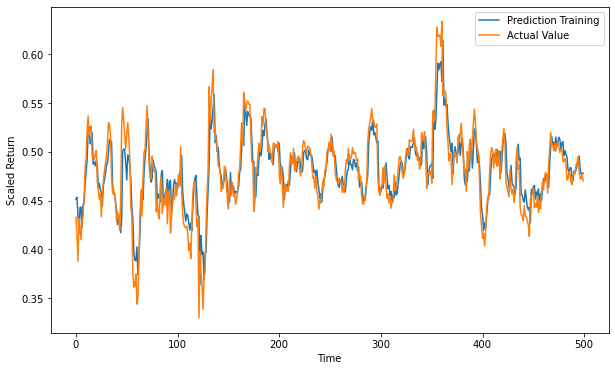

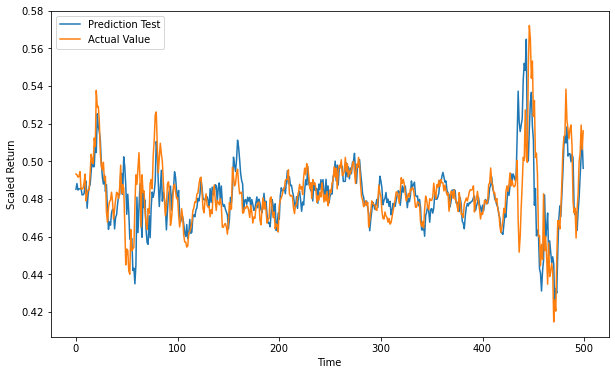


Results for ADBE :
Train Error: 0.016038937052388753 Test Error: 0.0360131599625964


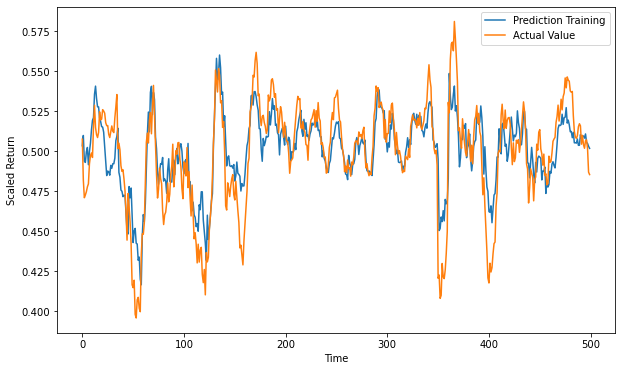

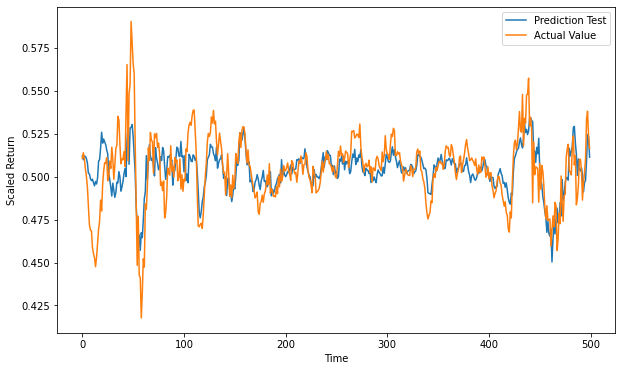


Results for ADI :
Train Error: 0.021054768547224663 Test Error: 0.022741945996665687


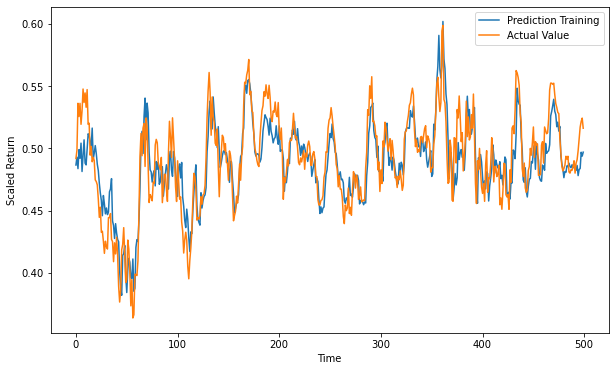

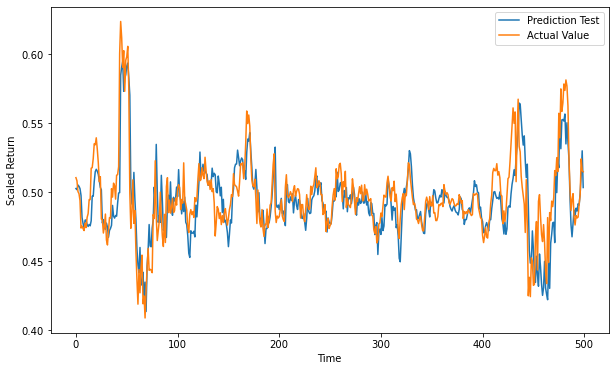


Results for ADP :
Train Error: 0.018296019239454456 Test Error: 0.02065892011826554


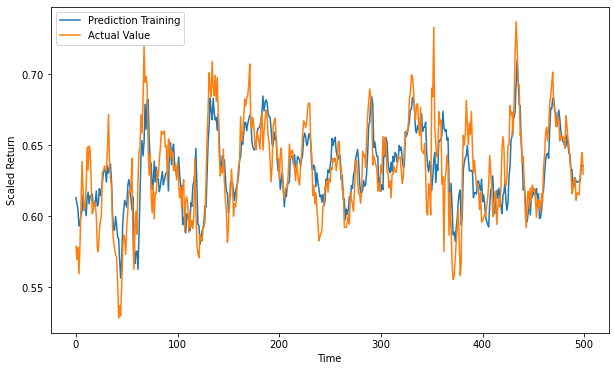

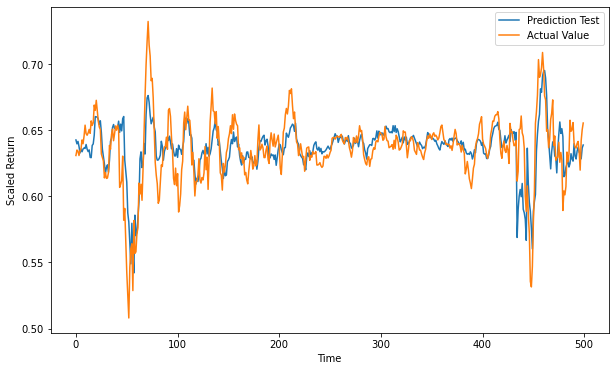


Results for ADSK :
Train Error: 0.01567714567641114 Test Error: 0.033500080048425064


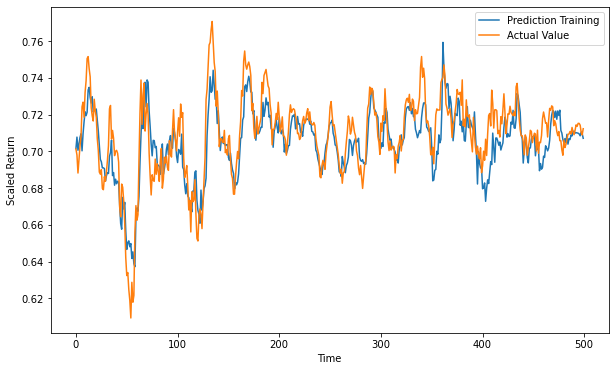

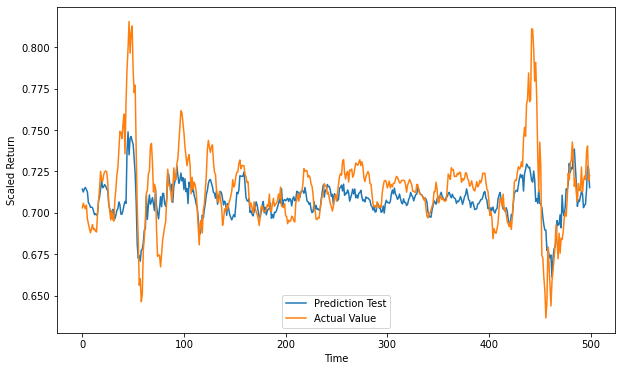


Results for AEP :
Train Error: 0.019988914122838233 Test Error: 0.018099939854679722


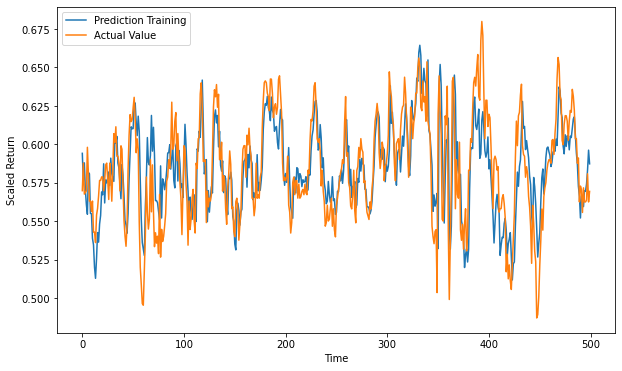

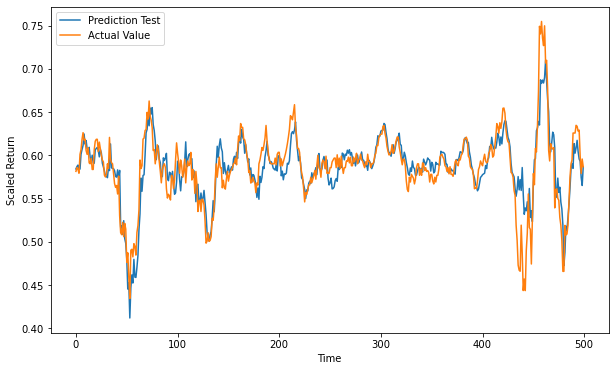


Results for ALGN :
Train Error: 0.014938693319668397 Test Error: 0.01356137017285458


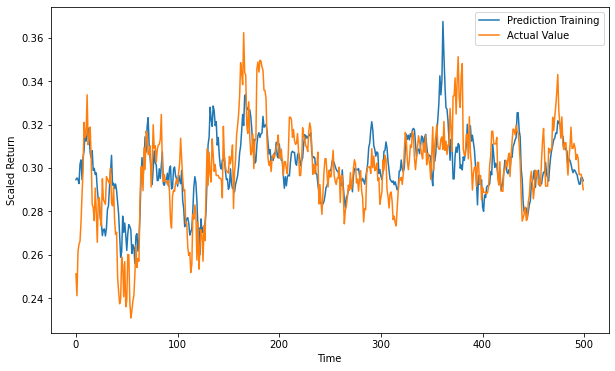

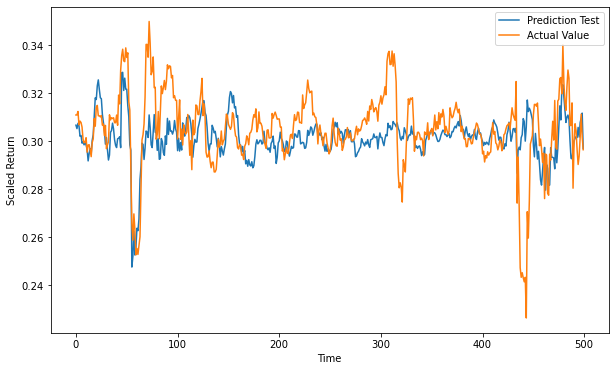


Results for AMAT :
Train Error: 0.014917918823810685 Test Error: 0.01565774024835165


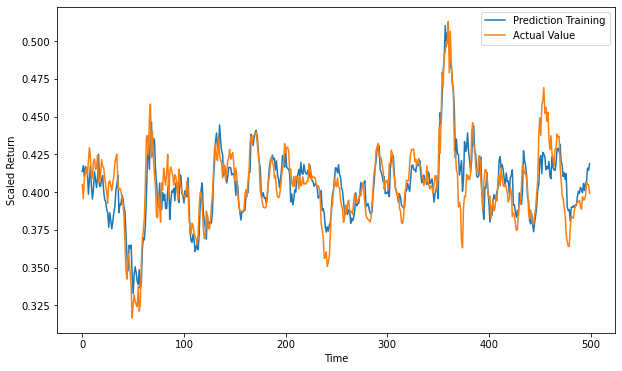

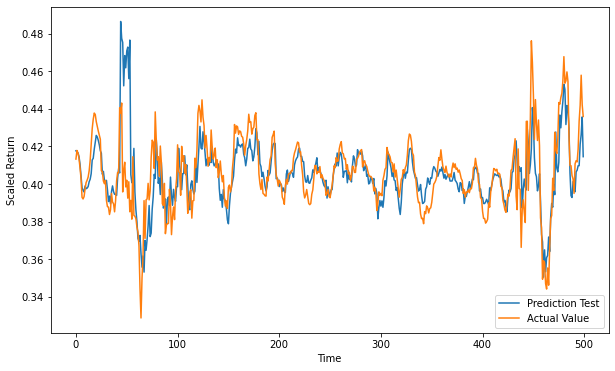


Results for AMD :
Train Error: 0.016852905892983976 Test Error: 0.02344592844284135


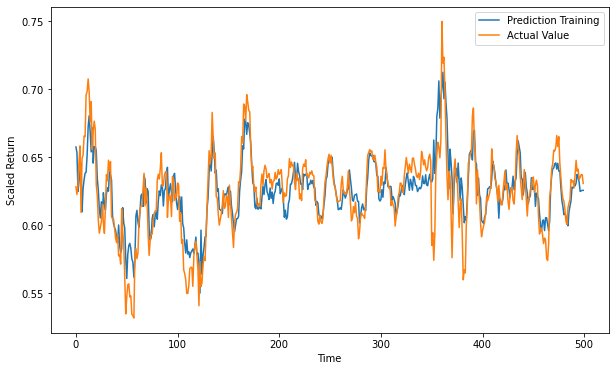

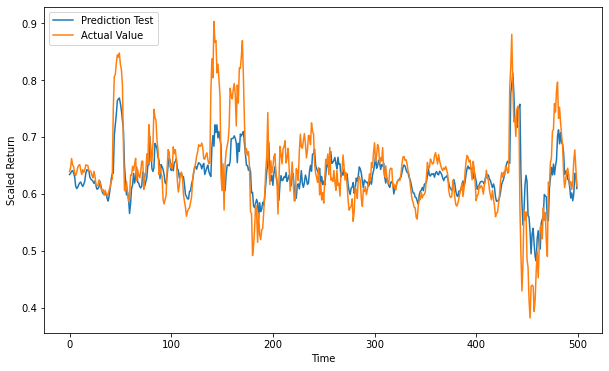


Results for AMGN :
Train Error: 0.010884506270613862 Test Error: 0.0122140754767072


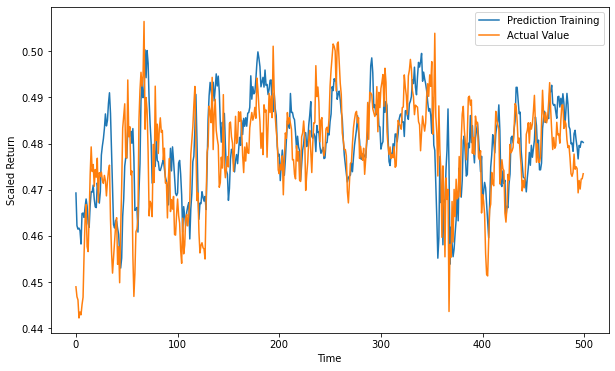

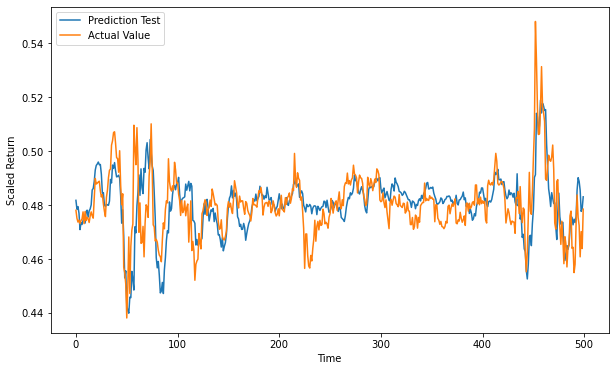


Results for AMZN :
Train Error: 0.01363827410714524 Test Error: 0.016185116312356047

Results for ANSS :
Train Error: 0.016418047684113434 Test Error: 0.017140121544924926

Results for ASML :
Train Error: 0.01958555809119944 Test Error: 0.02214724608656495

Results for ATVI :
Train Error: 0.010833962160255643 Test Error: 0.011072653234400636

Results for AVGO :
Train Error: 0.021377627277473343 Test Error: 0.03200133338218182

Results for BIDU :
Train Error: 0.019498806657990045 Test Error: 0.01875128362263937

Results for BIIB :
Train Error: 0.009611484811924335 Test Error: 0.006622631930706123

Results for BKNG :
Train Error: 0.021101824041210446 Test Error: 0.027836504893465997

Results for CDNS :
Train Error: 0.015480237177654796 Test Error: 0.016809421027709028

Results for CDW :
Train Error: 0.017300977365882663 Test Error: 0.017944519464441103

Results for CERN :
Train Error: 0.013574956073517155 Test Error: 0.02902364048827141

Results for CHKP :
Train Error: 0.015587098056968

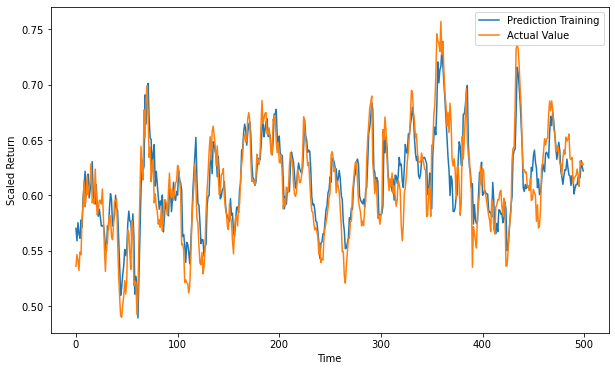

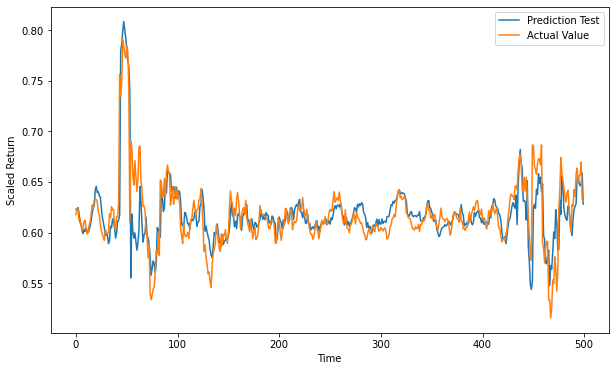


Results for $U0BB :
Train Error: 0.017393839726452066 Test Error: 0.020949012633176303


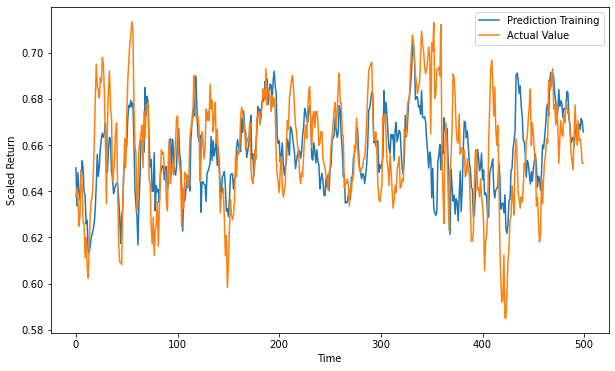

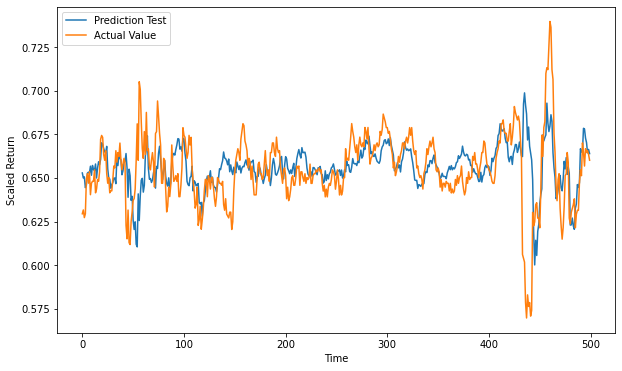


Results for $U0BD :
Train Error: 0.014435651118538183 Test Error: 0.01622965799156643


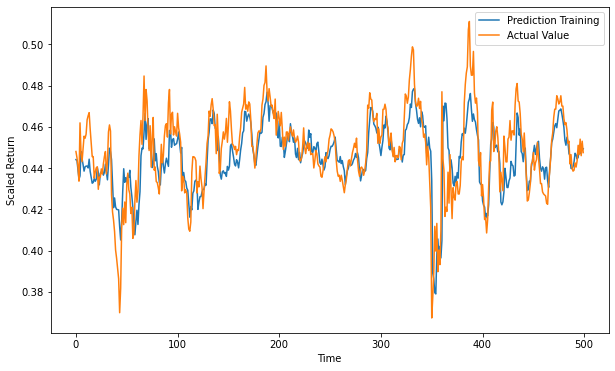

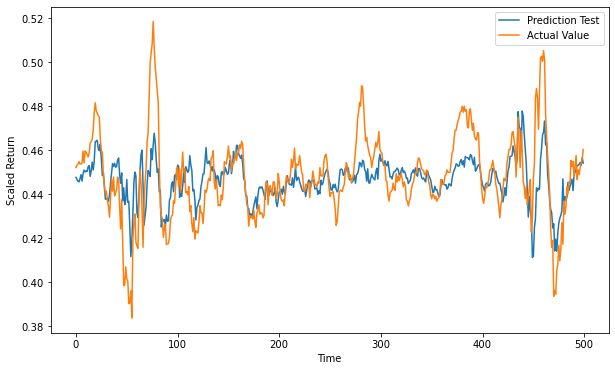


Results for $U2BB :
Train Error: 0.022375311038404355 Test Error: 0.0234055937714187


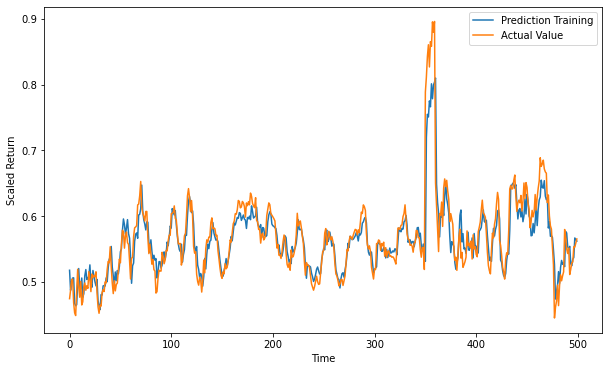

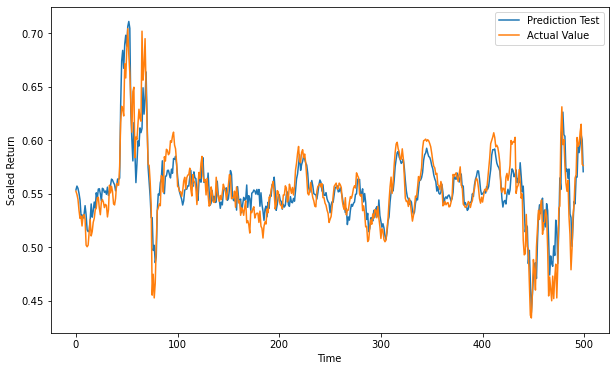


Results for $U2BD :
Train Error: 0.022214068842533206 Test Error: 0.023892745954970273


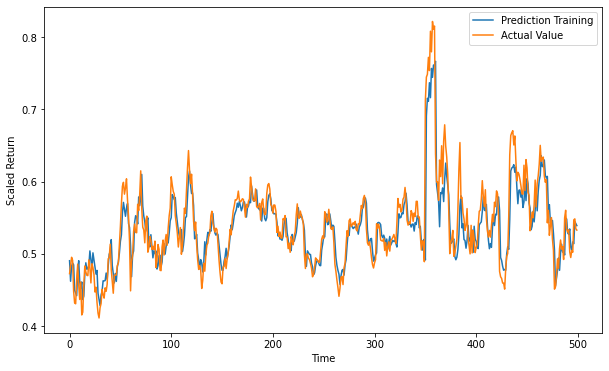

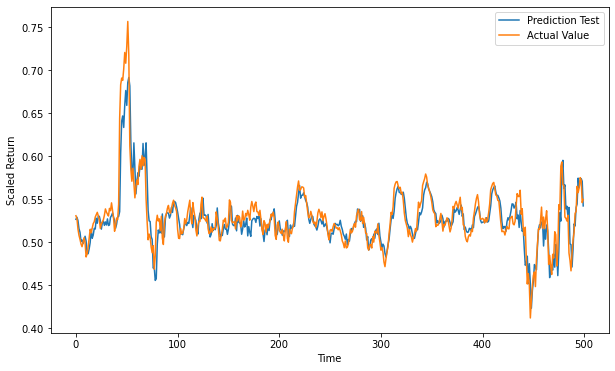


Results for $U3BD :
Train Error: 0.016760253530061886 Test Error: 0.017284877543913082


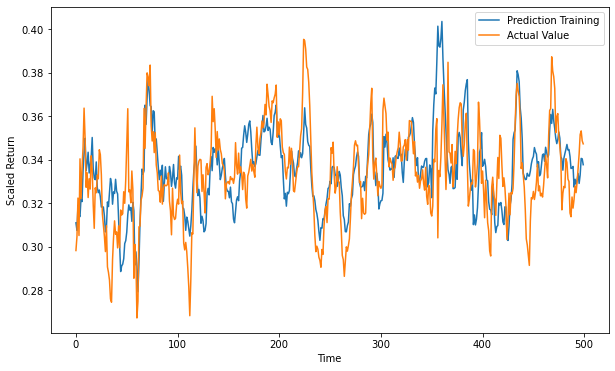

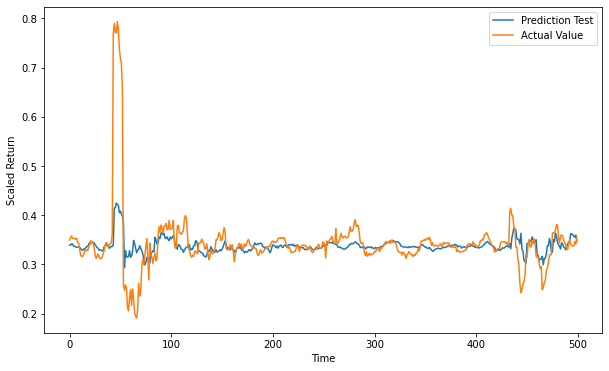


Results for $U3BF :
Train Error: 0.019793959770232447 Test Error: 0.021847579520290268


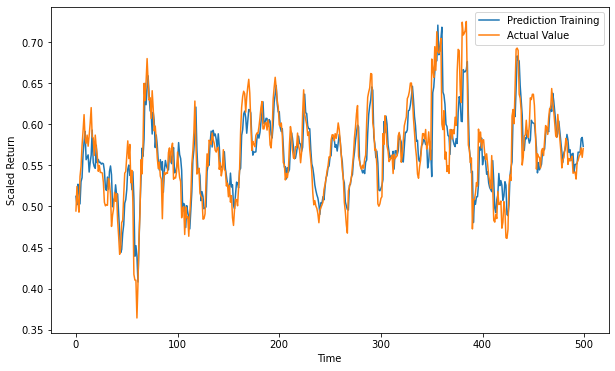

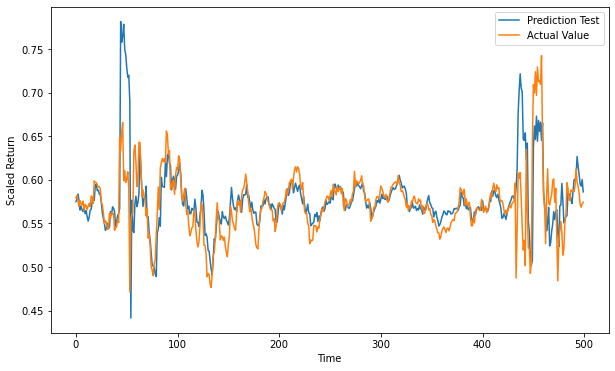


Results for $U3BH :
Train Error: 0.01957115546195814 Test Error: 0.02097037635747447


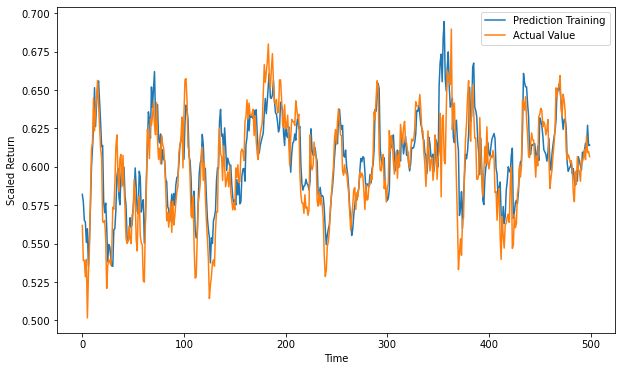

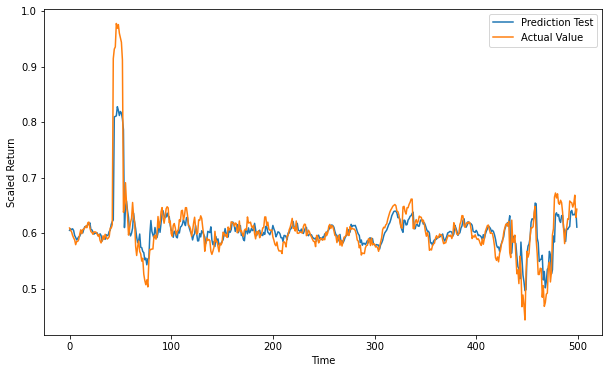


Results for $U4BB :
Train Error: 0.020213467445804194 Test Error: 0.02337344852840911


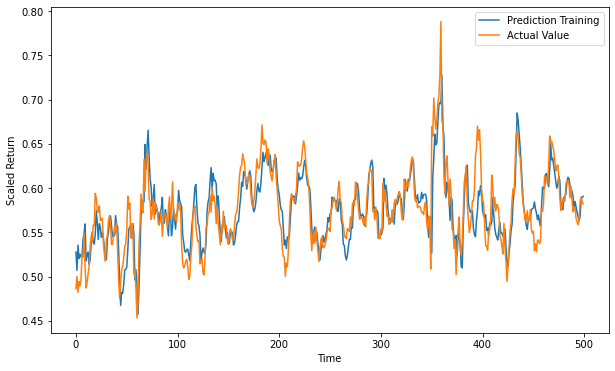

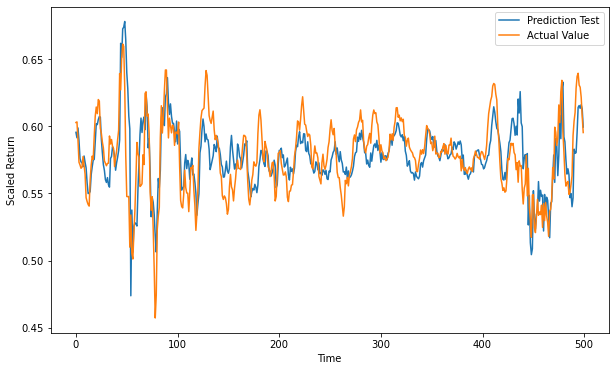


Results for $U4BD :
Train Error: 0.018280746556708607 Test Error: 0.018898979677909367


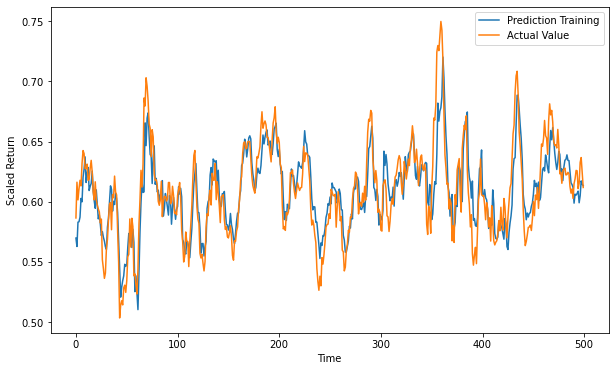

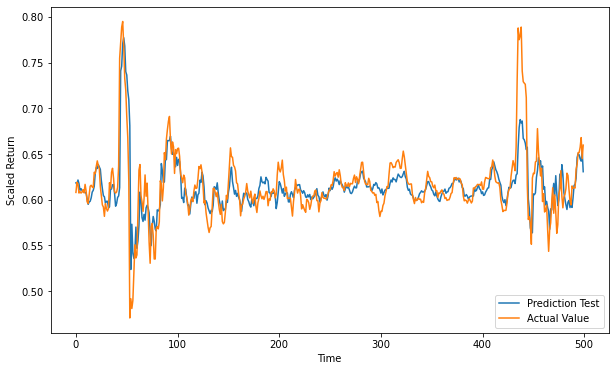


Results for $U4BF :
Train Error: 0.018245837570187867 Test Error: 0.021664279852245658

Results for $U4BH :
Train Error: 0.01898334643142656 Test Error: 0.019573930204813916

Results for $U4BJ :
Train Error: 0.01774252371850214 Test Error: 0.019351343301869425

Results for $U4BL :
Train Error: 0.016779182847008283 Test Error: 0.018212778198840384

Results for $U4BN :
Train Error: 0.01708684469904159 Test Error: 0.017308789598159086

Results for $U4DB :
Train Error: 0.01920374475673796 Test Error: 0.02385647563220691

Results for $U4DD :
Train Error: 0.01760726995318661 Test Error: 0.020266357157448102

Results for $U4FB :
Train Error: 0.013947265433633 Test Error: 0.013005893594938133

Results for $U4FD :
Train Error: 0.018515515759567086 Test Error: 0.022409365684631546

Results for $U4FH :
Train Error: 0.015314707917236043 Test Error: 0.015279343878105518

Results for $U5BB :
Train Error: 0.02288205907189248 Test Error: 0.023792942168562578

Results for $U5BD :
Train Error: 0.013495

In [45]:
# make predictions and evaluate model 
rmse_train_atRNN, rmse_test_atRNN, rmse_max_atRNN = pred_eval(model_atRNN, 'atRNN')

In [46]:
# manually check for number of parameters and epochs needed 
no_params_atRNN = 29058
epochs_atRNN = 766 #manually 

# display results 
atRNN_results = np.array(['{:}'.format(no_params_atRNN), '{:}'.format(epochs_atRNN), round(time_needed_atRNN/60,2), 
                        '{:.3e}'.format(rmse_train_atRNN), '{:.3e}'.format(rmse_test_atRNN), 
                        '{:.3e}'.format(rmse_max_atRNN)])
atRNN_results = atRNN_results.reshape((1,6))
table_atRNN = pd.DataFrame(atRNN_results,index=['Alpha-t RNN'],
                         columns=['No. Parameters','No. Epochs','Time [m]','RMSE Train','RMSE Test','RMSE Max'])
table_atRNN

,No. Parameters,No. Epochs,Time [m],RMSE Train,RMSE Test,RMSE Max
Alpha-t RNN,29058,766,146.41,1.704e-02,2.026e-02,6.034e-02


## LSTM

In [34]:
# build model 
model_LSTM = LSTM_()

# fit model 
time_needed_LSTM, history_LSTM = train_model(model_LSTM,'LSTM')

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 30, 20)            14320     
                                                                 
 dropout_10 (Dropout)        (None, 30, 20)            0         
                                                                 
 lstm_1 (LSTM)               (None, 30, 20)            3280      
                                                                 
 dropout_11 (Dropout)        (None, 30, 20)            0         
                                                                 
 lstm_2 (LSTM)               (None, 20)                3280      
                                                                 
 dropout_12 (Dropout)        (None, 20)                0         
                                                                 
 dense_9 (Dense)             (None, 158)              

Epoch 29/1000
134/134 [==============================] - ETA: 0s - loss: 0.0011
Epoch 00029: val_loss improved from 0.00072 to 0.00070, saving model to best_model_LSTM.h5
134/134 [==============================] - 19s 139ms/step - loss: 0.0011 - val_loss: 6.9870e-04
Epoch 30/1000
134/134 [==============================] - ETA: 0s - loss: 0.0011
Epoch 00030: val_loss improved from 0.00070 to 0.00068, saving model to best_model_LSTM.h5
134/134 [==============================] - 18s 131ms/step - loss: 0.0011 - val_loss: 6.8021e-04
Epoch 31/1000
134/134 [==============================] - ETA: 0s - loss: 0.0010
Epoch 00031: val_loss improved from 0.00068 to 0.00067, saving model to best_model_LSTM.h5
134/134 [==============================] - 18s 135ms/step - loss: 0.0010 - val_loss: 6.7178e-04
Epoch 32/1000
134/134 [==============================] - ETA: 0s - loss: 0.0011
Epoch 00032: val_loss did not improve from 0.00067
134/134 [==============================] - 18s 131ms/step - loss: 0.

Epoch 61/1000
134/134 [==============================] - ETA: 0s - loss: 6.9755e-04
Epoch 00061: val_loss did not improve from 0.00061
134/134 [==============================] - 17s 130ms/step - loss: 6.9755e-04 - val_loss: 6.1288e-04
Epoch 62/1000
134/134 [==============================] - ETA: 0s - loss: 6.9422e-04
Epoch 00062: val_loss improved from 0.00061 to 0.00061, saving model to best_model_LSTM.h5
134/134 [==============================] - 17s 130ms/step - loss: 6.9422e-04 - val_loss: 6.0767e-04
Epoch 63/1000
134/134 [==============================] - ETA: 0s - loss: 6.9319e-04
Epoch 00063: val_loss improved from 0.00061 to 0.00061, saving model to best_model_LSTM.h5
134/134 [==============================] - 18s 134ms/step - loss: 6.9319e-04 - val_loss: 6.0673e-04
Epoch 64/1000
134/134 [==============================] - ETA: 0s - loss: 6.9022e-04
Epoch 00064: val_loss did not improve from 0.00061
134/134 [==============================] - 18s 131ms/step - loss: 6.9022e-04 - v

134/134 [==============================] - ETA: 0s - loss: 6.2019e-04
Epoch 00095: val_loss did not improve from 0.00060
134/134 [==============================] - 17s 130ms/step - loss: 6.2019e-04 - val_loss: 6.6277e-04
Epoch 96/1000
134/134 [==============================] - ETA: 0s - loss: 6.1936e-04
Epoch 00096: val_loss did not improve from 0.00060
134/134 [==============================] - 17s 130ms/step - loss: 6.1936e-04 - val_loss: 6.4256e-04
Epoch 97/1000
134/134 [==============================] - ETA: 0s - loss: 6.1819e-04
Epoch 00097: val_loss did not improve from 0.00060
134/134 [==============================] - 18s 134ms/step - loss: 6.1819e-04 - val_loss: 6.4160e-04
Epoch 98/1000
134/134 [==============================] - ETA: 0s - loss: 6.1706e-04
Epoch 00098: val_loss did not improve from 0.00060
134/134 [==============================] - 18s 138ms/step - loss: 6.1706e-04 - val_loss: 6.6336e-04
Epoch 99/1000
134/134 [==============================] - ETA: 0s - loss: 6

Epoch 129/1000
134/134 [==============================] - ETA: 0s - loss: 5.6223e-04
Epoch 00129: val_loss did not improve from 0.00057
134/134 [==============================] - 17s 130ms/step - loss: 5.6223e-04 - val_loss: 5.7321e-04
Epoch 130/1000
134/134 [==============================] - ETA: 0s - loss: 5.6133e-04
Epoch 00130: val_loss did not improve from 0.00057
134/134 [==============================] - 17s 130ms/step - loss: 5.6133e-04 - val_loss: 5.7802e-04
Epoch 131/1000
134/134 [==============================] - ETA: 0s - loss: 5.6125e-04
Epoch 00131: val_loss did not improve from 0.00057
134/134 [==============================] - 17s 130ms/step - loss: 5.6125e-04 - val_loss: 5.6918e-04
Epoch 132/1000
134/134 [==============================] - ETA: 0s - loss: 5.5857e-04
Epoch 00132: val_loss did not improve from 0.00057
134/134 [==============================] - 17s 129ms/step - loss: 5.5857e-04 - val_loss: 5.8104e-04
Epoch 133/1000
134/134 [==============================] 

Epoch 163/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4335e-04
Epoch 00163: val_loss did not improve from 0.00054
134/134 [==============================] - 17s 128ms/step - loss: 5.4297e-04 - val_loss: 5.5722e-04
Epoch 164/1000
134/134 [==============================] - ETA: 0s - loss: 5.4424e-04
Epoch 00164: val_loss did not improve from 0.00054
134/134 [==============================] - 17s 129ms/step - loss: 5.4424e-04 - val_loss: 5.5728e-04
Epoch 165/1000
133/134 [============================>.] - ETA: 0s - loss: 5.4397e-04
Epoch 00165: val_loss did not improve from 0.00054
134/134 [==============================] - 18s 134ms/step - loss: 5.4355e-04 - val_loss: 5.5963e-04
Epoch 166/1000
134/134 [==============================] - ETA: 0s - loss: 5.4222e-04
Epoch 00166: val_loss did not improve from 0.00054
134/134 [==============================] - 17s 130ms/step - loss: 5.4222e-04 - val_loss: 5.4978e-04
Epoch 167/1000
134/134 [==============================] 

Epoch 198/1000
134/134 [==============================] - ETA: 0s - loss: 5.3096e-04
Epoch 00198: val_loss did not improve from 0.00054
134/134 [==============================] - 19s 138ms/step - loss: 5.3096e-04 - val_loss: 5.5336e-04
Epoch 199/1000
134/134 [==============================] - ETA: 0s - loss: 5.3097e-04
Epoch 00199: val_loss did not improve from 0.00054
134/134 [==============================] - 17s 130ms/step - loss: 5.3097e-04 - val_loss: 5.4948e-04
Epoch 200/1000
134/134 [==============================] - ETA: 0s - loss: 5.3029e-04
Epoch 00200: val_loss did not improve from 0.00054
134/134 [==============================] - 18s 132ms/step - loss: 5.3029e-04 - val_loss: 5.5349e-04
Epoch 201/1000
134/134 [==============================] - ETA: 0s - loss: 5.3115e-04
Epoch 00201: val_loss did not improve from 0.00054
134/134 [==============================] - 18s 131ms/step - loss: 5.3115e-04 - val_loss: 5.5029e-04
Epoch 202/1000
134/134 [==============================] 

Epoch 233/1000
133/134 [============================>.] - ETA: 0s - loss: 5.2665e-04
Epoch 00233: val_loss did not improve from 0.00054
134/134 [==============================] - 18s 134ms/step - loss: 5.2628e-04 - val_loss: 5.4324e-04
Epoch 234/1000
134/134 [==============================] - ETA: 0s - loss: 5.2612e-04
Epoch 00234: val_loss improved from 0.00054 to 0.00054, saving model to best_model_LSTM.h5
134/134 [==============================] - 18s 132ms/step - loss: 5.2612e-04 - val_loss: 5.3911e-04
Epoch 235/1000
134/134 [==============================] - ETA: 0s - loss: 5.2518e-04
Epoch 00235: val_loss did not improve from 0.00054
134/134 [==============================] - 18s 131ms/step - loss: 5.2518e-04 - val_loss: 5.4234e-04
Epoch 236/1000
134/134 [==============================] - ETA: 0s - loss: 5.2679e-04
Epoch 00236: val_loss did not improve from 0.00054
134/134 [==============================] - 17s 131ms/step - loss: 5.2679e-04 - val_loss: 5.4410e-04
Epoch 237/1000
1

134/134 [==============================] - ETA: 0s - loss: 5.2363e-04
Epoch 00267: val_loss did not improve from 0.00054
134/134 [==============================] - 17s 129ms/step - loss: 5.2363e-04 - val_loss: 5.4285e-04
Epoch 268/1000
134/134 [==============================] - ETA: 0s - loss: 5.2288e-04
Epoch 00268: val_loss did not improve from 0.00054
134/134 [==============================] - 17s 130ms/step - loss: 5.2288e-04 - val_loss: 5.4327e-04
Epoch 269/1000
134/134 [==============================] - ETA: 0s - loss: 5.2220e-04
Epoch 00269: val_loss did not improve from 0.00054
134/134 [==============================] - 17s 130ms/step - loss: 5.2220e-04 - val_loss: 5.3967e-04
Epoch 270/1000
134/134 [==============================] - ETA: 0s - loss: 5.2152e-04
Epoch 00270: val_loss did not improve from 0.00054
134/134 [==============================] - 18s 135ms/step - loss: 5.2152e-04 - val_loss: 5.3895e-04
Epoch 271/1000
134/134 [==============================] - ETA: 0s - los

134/134 [==============================] - ETA: 0s - loss: 5.1856e-04
Epoch 00301: val_loss did not improve from 0.00053
134/134 [==============================] - 18s 135ms/step - loss: 5.1856e-04 - val_loss: 5.3572e-04
Epoch 302/1000
134/134 [==============================] - ETA: 0s - loss: 5.2018e-04
Epoch 00302: val_loss did not improve from 0.00053
134/134 [==============================] - 18s 137ms/step - loss: 5.2018e-04 - val_loss: 5.3711e-04
Epoch 303/1000
134/134 [==============================] - ETA: 0s - loss: 5.2074e-04
Epoch 00303: val_loss did not improve from 0.00053
134/134 [==============================] - 19s 142ms/step - loss: 5.2074e-04 - val_loss: 5.3901e-04
Epoch 304/1000
134/134 [==============================] - ETA: 0s - loss: 5.1871e-04
Epoch 00304: val_loss did not improve from 0.00053
134/134 [==============================] - 19s 145ms/step - loss: 5.1871e-04 - val_loss: 5.3880e-04
Epoch 305/1000
134/134 [==============================] - ETA: 0s - los

Epoch 336/1000
134/134 [==============================] - ETA: 0s - loss: 5.1854e-04
Epoch 00336: val_loss did not improve from 0.00053
134/134 [==============================] - 17s 130ms/step - loss: 5.1854e-04 - val_loss: 5.3723e-04
Epoch 337/1000
133/134 [============================>.] - ETA: 0s - loss: 5.1821e-04
Epoch 00337: val_loss did not improve from 0.00053
134/134 [==============================] - 18s 136ms/step - loss: 5.1787e-04 - val_loss: 5.3077e-04
Epoch 338/1000
134/134 [==============================] - ETA: 0s - loss: 5.1649e-04
Epoch 00338: val_loss did not improve from 0.00053
134/134 [==============================] - 17s 130ms/step - loss: 5.1649e-04 - val_loss: 5.3219e-04
Epoch 339/1000
134/134 [==============================] - ETA: 0s - loss: 5.1652e-04
Epoch 00339: val_loss did not improve from 0.00053
134/134 [==============================] - 17s 130ms/step - loss: 5.1652e-04 - val_loss: 5.3218e-04
Epoch 340/1000
134/134 [==============================] 

Epoch 371/1000
134/134 [==============================] - ETA: 0s - loss: 5.1186e-04
Epoch 00371: val_loss did not improve from 0.00053
134/134 [==============================] - 17s 131ms/step - loss: 5.1186e-04 - val_loss: 5.3226e-04
Epoch 372/1000
134/134 [==============================] - ETA: 0s - loss: 5.1321e-04
Epoch 00372: val_loss did not improve from 0.00053
134/134 [==============================] - 19s 138ms/step - loss: 5.1321e-04 - val_loss: 5.3241e-04
Epoch 373/1000
134/134 [==============================] - ETA: 0s - loss: 5.1308e-04
Epoch 00373: val_loss did not improve from 0.00053
134/134 [==============================] - 18s 136ms/step - loss: 5.1308e-04 - val_loss: 5.3297e-04
Epoch 374/1000
133/134 [============================>.] - ETA: 0s - loss: 5.1241e-04
Epoch 00374: val_loss did not improve from 0.00053
134/134 [==============================] - 17s 130ms/step - loss: 5.1206e-04 - val_loss: 5.3599e-04
Epoch 375/1000
133/134 [============================>.] 

Epoch 406/1000
134/134 [==============================] - ETA: 0s - loss: 5.1191e-04
Epoch 00406: val_loss did not improve from 0.00053
134/134 [==============================] - 18s 134ms/step - loss: 5.1191e-04 - val_loss: 5.3281e-04
Epoch 407/1000
134/134 [==============================] - ETA: 0s - loss: 5.1101e-04
Epoch 00407: val_loss did not improve from 0.00053
134/134 [==============================] - 18s 132ms/step - loss: 5.1101e-04 - val_loss: 5.3757e-04
Epoch 408/1000
134/134 [==============================] - ETA: 0s - loss: 5.0954e-04
Epoch 00408: val_loss did not improve from 0.00053
134/134 [==============================] - 18s 131ms/step - loss: 5.0954e-04 - val_loss: 5.3474e-04
Epoch 409/1000
134/134 [==============================] - ETA: 0s - loss: 5.1201e-04
Epoch 00409: val_loss did not improve from 0.00053
134/134 [==============================] - 18s 131ms/step - loss: 5.1201e-04 - val_loss: 5.3080e-04
Epoch 410/1000
134/134 [==============================] 

134/134 [==============================] - ETA: 0s - loss: 5.0988e-04
Epoch 00440: val_loss did not improve from 0.00052
134/134 [==============================] - 18s 134ms/step - loss: 5.0988e-04 - val_loss: 5.3296e-04
Epoch 441/1000
134/134 [==============================] - ETA: 0s - loss: 5.0696e-04
Epoch 00441: val_loss did not improve from 0.00052
134/134 [==============================] - 18s 133ms/step - loss: 5.0696e-04 - val_loss: 5.3101e-04
Epoch 442/1000
133/134 [============================>.] - ETA: 0s - loss: 5.0982e-04
Epoch 00442: val_loss did not improve from 0.00052
134/134 [==============================] - 18s 135ms/step - loss: 5.0948e-04 - val_loss: 5.3372e-04
Epoch 443/1000
134/134 [==============================] - ETA: 0s - loss: 5.0825e-04
Epoch 00443: val_loss did not improve from 0.00052
134/134 [==============================] - 18s 132ms/step - loss: 5.0825e-04 - val_loss: 5.2699e-04
Epoch 444/1000
134/134 [==============================] - ETA: 0s - los

Epoch 475/1000
134/134 [==============================] - ETA: 0s - loss: 5.0580e-04
Epoch 00475: val_loss did not improve from 0.00052
134/134 [==============================] - 17s 130ms/step - loss: 5.0580e-04 - val_loss: 5.2455e-04
Epoch 476/1000
133/134 [============================>.] - ETA: 0s - loss: 5.0572e-04
Epoch 00476: val_loss did not improve from 0.00052
134/134 [==============================] - 17s 129ms/step - loss: 5.0540e-04 - val_loss: 5.2617e-04
Epoch 477/1000
134/134 [==============================] - ETA: 0s - loss: 5.0815e-04
Epoch 00477: val_loss did not improve from 0.00052
134/134 [==============================] - 17s 131ms/step - loss: 5.0815e-04 - val_loss: 5.2796e-04
Epoch 478/1000
134/134 [==============================] - ETA: 0s - loss: 5.0590e-04
Epoch 00478: val_loss did not improve from 0.00052
134/134 [==============================] - 17s 130ms/step - loss: 5.0590e-04 - val_loss: 5.2514e-04
Epoch 479/1000
134/134 [==============================] 

Epoch 510/1000
134/134 [==============================] - ETA: 0s - loss: 5.0207e-04
Epoch 00510: val_loss did not improve from 0.00052
134/134 [==============================] - 18s 134ms/step - loss: 5.0207e-04 - val_loss: 5.2353e-04
Epoch 511/1000
134/134 [==============================] - ETA: 0s - loss: 5.0226e-04
Epoch 00511: val_loss did not improve from 0.00052
134/134 [==============================] - 18s 132ms/step - loss: 5.0226e-04 - val_loss: 5.2880e-04
Epoch 512/1000
134/134 [==============================] - ETA: 0s - loss: 5.0113e-04
Epoch 00512: val_loss did not improve from 0.00052
134/134 [==============================] - 18s 131ms/step - loss: 5.0113e-04 - val_loss: 5.2304e-04
Epoch 513/1000
134/134 [==============================] - ETA: 0s - loss: 5.0354e-04
Epoch 00513: val_loss did not improve from 0.00052
134/134 [==============================] - 18s 131ms/step - loss: 5.0354e-04 - val_loss: 5.3053e-04
Epoch 514/1000
134/134 [==============================] 

Epoch 545/1000
134/134 [==============================] - ETA: 0s - loss: 5.1032e-04
Epoch 00545: val_loss did not improve from 0.00051
134/134 [==============================] - 17s 130ms/step - loss: 5.1032e-04 - val_loss: 5.2794e-04
Epoch 546/1000
134/134 [==============================] - ETA: 0s - loss: 5.0339e-04
Epoch 00546: val_loss did not improve from 0.00051
134/134 [==============================] - 17s 131ms/step - loss: 5.0339e-04 - val_loss: 5.2475e-04
Epoch 547/1000
134/134 [==============================] - ETA: 0s - loss: 5.0157e-04
Epoch 00547: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 134ms/step - loss: 5.0157e-04 - val_loss: 5.2424e-04
Epoch 548/1000
134/134 [==============================] - ETA: 0s - loss: 5.0075e-04
Epoch 00548: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 132ms/step - loss: 5.0075e-04 - val_loss: 5.2188e-04
Epoch 549/1000
134/134 [==============================] 

Epoch 580/1000
134/134 [==============================] - ETA: 0s - loss: 5.0013e-04
Epoch 00580: val_loss did not improve from 0.00051
134/134 [==============================] - 17s 130ms/step - loss: 5.0013e-04 - val_loss: 5.1831e-04
Epoch 581/1000
134/134 [==============================] - ETA: 0s - loss: 4.9796e-04
Epoch 00581: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 131ms/step - loss: 4.9796e-04 - val_loss: 5.1809e-04
Epoch 582/1000
134/134 [==============================] - ETA: 0s - loss: 4.9835e-04
Epoch 00582: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 131ms/step - loss: 4.9835e-04 - val_loss: 5.1957e-04
Epoch 583/1000
134/134 [==============================] - ETA: 0s - loss: 4.9920e-04
Epoch 00583: val_loss did not improve from 0.00051
134/134 [==============================] - 17s 130ms/step - loss: 4.9920e-04 - val_loss: 5.1852e-04
Epoch 584/1000
134/134 [==============================] 

Epoch 615/1000
134/134 [==============================] - ETA: 0s - loss: 4.9819e-04
Epoch 00615: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 133ms/step - loss: 4.9819e-04 - val_loss: 5.1518e-04
Epoch 616/1000
134/134 [==============================] - ETA: 0s - loss: 4.9914e-04
Epoch 00616: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 131ms/step - loss: 4.9914e-04 - val_loss: 5.1401e-04
Epoch 617/1000
134/134 [==============================] - ETA: 0s - loss: 4.9761e-04
Epoch 00617: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 132ms/step - loss: 4.9761e-04 - val_loss: 5.1607e-04
Epoch 618/1000
134/134 [==============================] - ETA: 0s - loss: 5.0058e-04
Epoch 00618: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 133ms/step - loss: 5.0058e-04 - val_loss: 5.1924e-04
Epoch 619/1000
134/134 [==============================] 

Epoch 650/1000
134/134 [==============================] - ETA: 0s - loss: 4.9749e-04
Epoch 00650: val_loss did not improve from 0.00051
134/134 [==============================] - 17s 130ms/step - loss: 4.9749e-04 - val_loss: 5.1636e-04
Epoch 651/1000
134/134 [==============================] - ETA: 0s - loss: 4.9872e-04
Epoch 00651: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 132ms/step - loss: 4.9872e-04 - val_loss: 5.1819e-04
Epoch 652/1000
134/134 [==============================] - ETA: 0s - loss: 4.9972e-04
Epoch 00652: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 133ms/step - loss: 4.9972e-04 - val_loss: 5.1598e-04
Epoch 653/1000
134/134 [==============================] - ETA: 0s - loss: 4.9627e-04
Epoch 00653: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 133ms/step - loss: 4.9627e-04 - val_loss: 5.2152e-04
Epoch 654/1000
134/134 [==============================] 

Epoch 685/1000
133/134 [============================>.] - ETA: 0s - loss: 4.9508e-04
Epoch 00685: val_loss did not improve from 0.00051
134/134 [==============================] - 17s 130ms/step - loss: 4.9475e-04 - val_loss: 5.1631e-04
Epoch 686/1000
134/134 [==============================] - ETA: 0s - loss: 4.9655e-04
Epoch 00686: val_loss did not improve from 0.00051
134/134 [==============================] - 18s 131ms/step - loss: 4.9655e-04 - val_loss: 5.1483e-04
Epoch 687/1000
133/134 [============================>.] - ETA: 0s - loss: 4.9705e-04
Epoch 00687: val_loss did not improve from 0.00051
134/134 [==============================] - 17s 130ms/step - loss: 4.9674e-04 - val_loss: 5.1571e-04
Epoch 688/1000
134/134 [==============================] - ETA: 0s - loss: 4.9368e-04
Epoch 00688: val_loss did not improve from 0.00051
134/134 [==============================] - 17s 130ms/step - loss: 4.9368e-04 - val_loss: 5.1578e-04
Epoch 689/1000
134/134 [==============================] 

459/459 [==============================] - 3s 7ms/step

Results for AAPL :
Train Error: 0.024538429290119956 Test Error: 0.03243362160836782


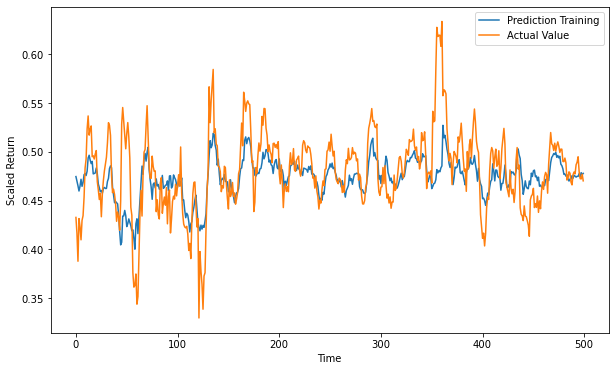

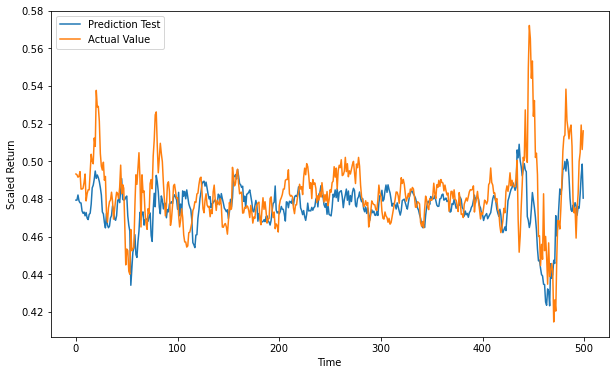


Results for ADBE :
Train Error: 0.018372420287118843 Test Error: 0.04053629478120461


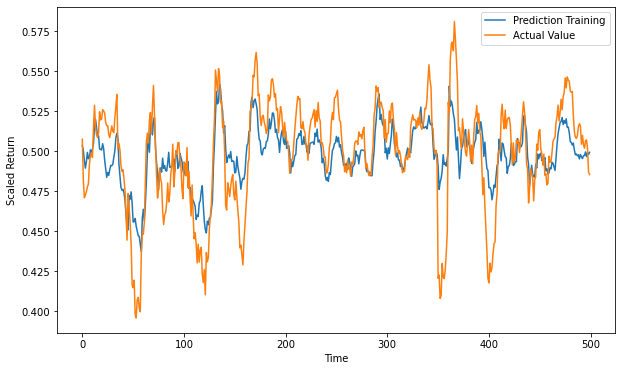

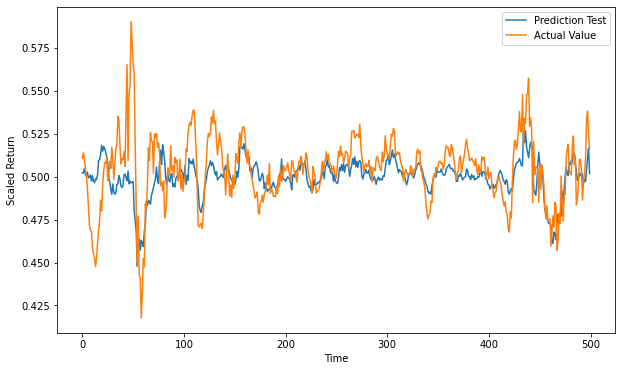


Results for ADI :
Train Error: 0.027237075867873804 Test Error: 0.02765057318831288


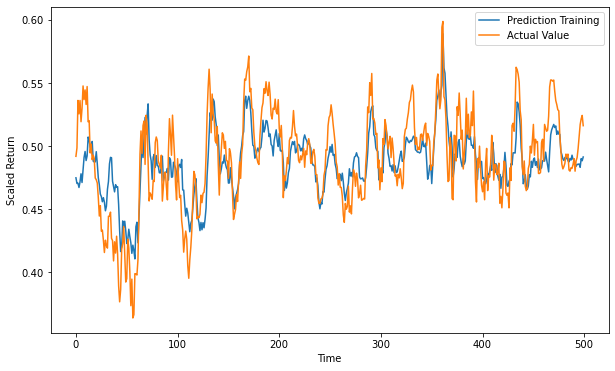

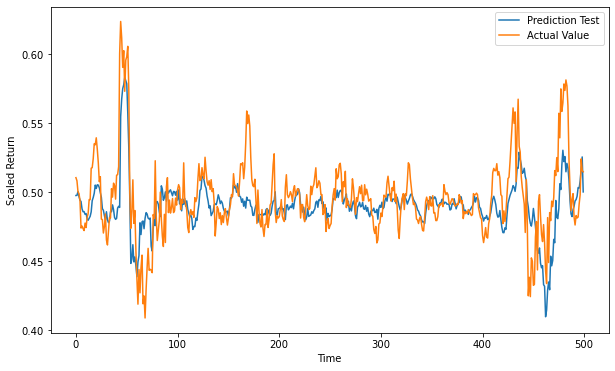


Results for ADP :
Train Error: 0.02162348714642555 Test Error: 0.022989591098196312


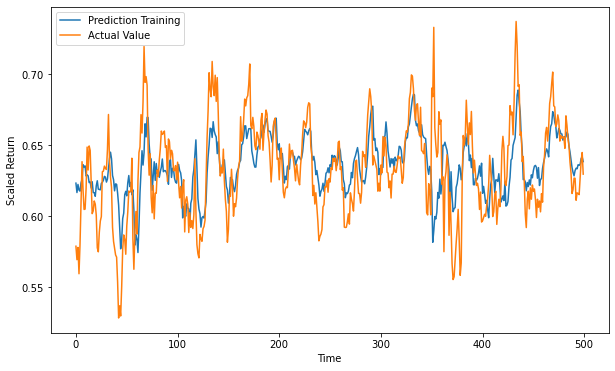

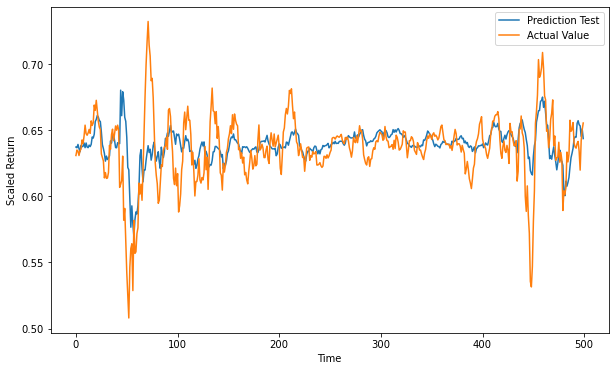


Results for ADSK :
Train Error: 0.017443324072185375 Test Error: 0.03568577132097401


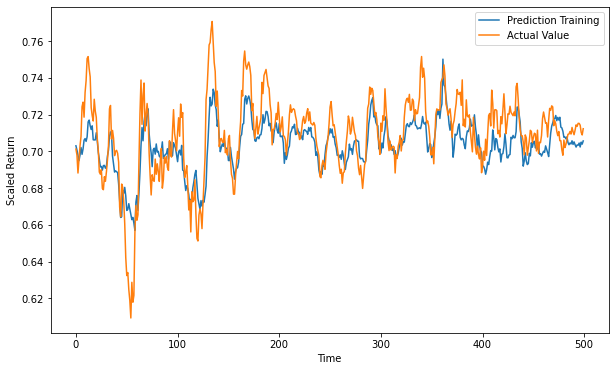

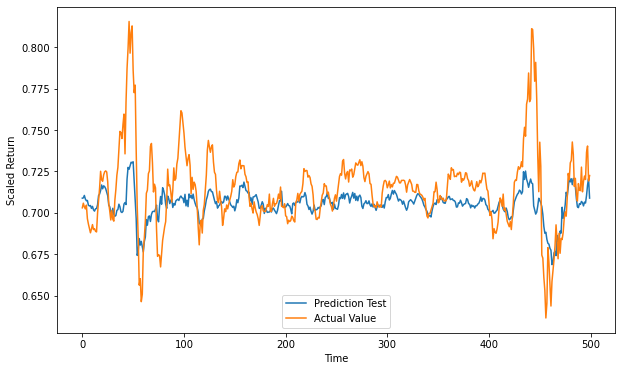


Results for AEP :
Train Error: 0.032761735413945316 Test Error: 0.03184246880709669


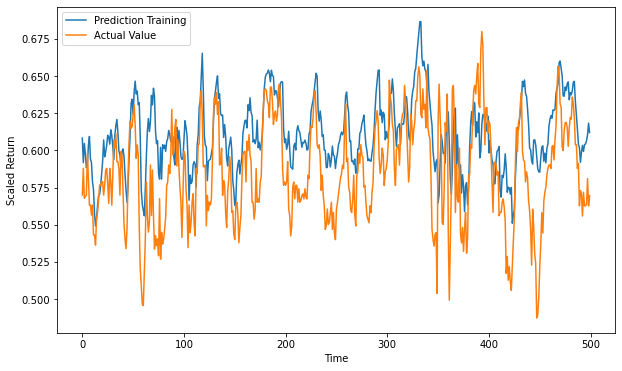

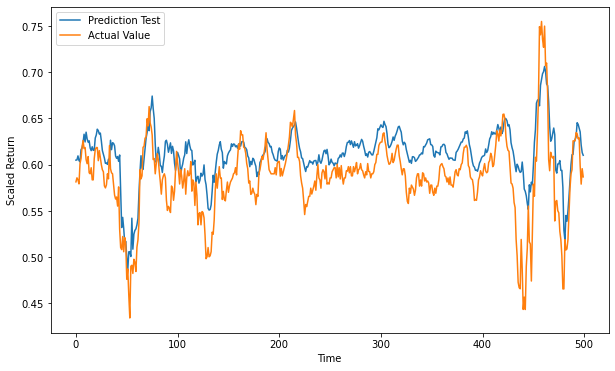


Results for ALGN :
Train Error: 0.016556149012666825 Test Error: 0.015102160944786336


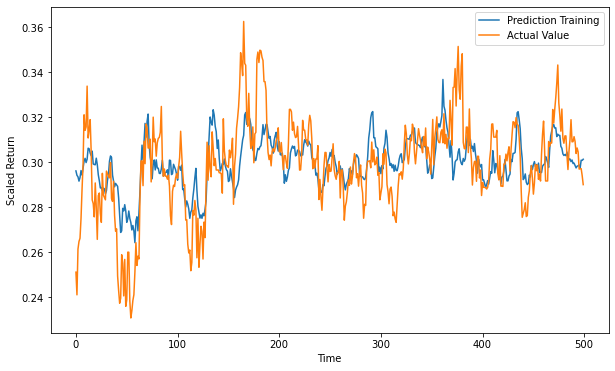

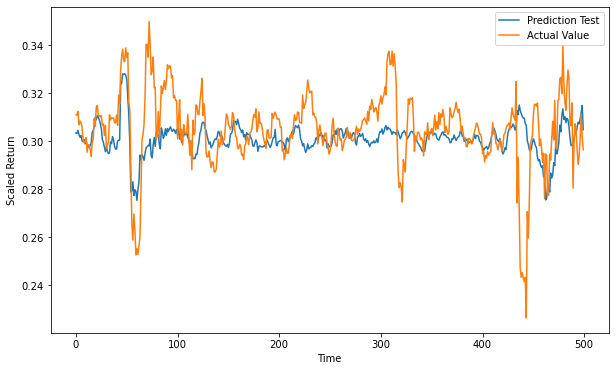


Results for AMAT :
Train Error: 0.01973570451510263 Test Error: 0.02047866928176717


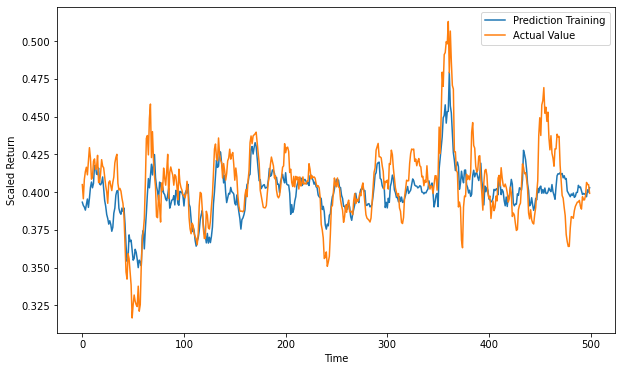

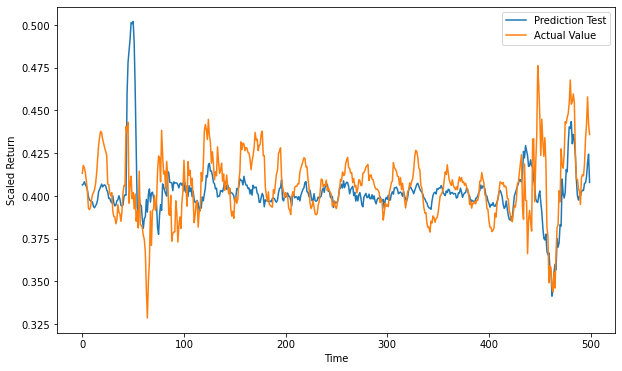


Results for AMD :
Train Error: 0.02362446588351473 Test Error: 0.03301281267306317


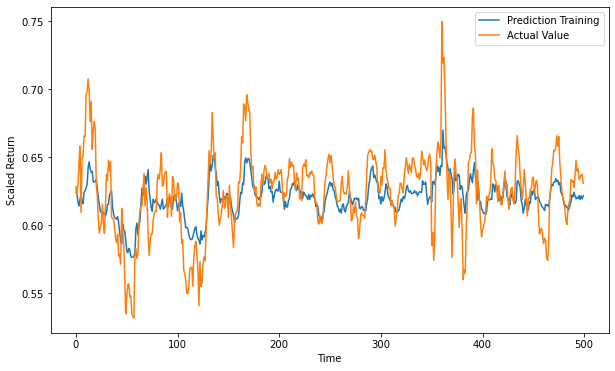

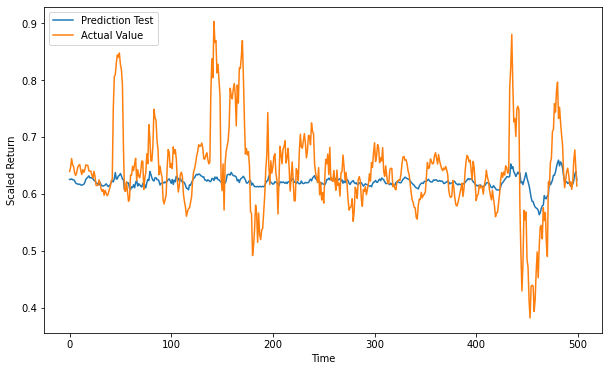


Results for AMGN :
Train Error: 0.012928453932278304 Test Error: 0.014220953407279574


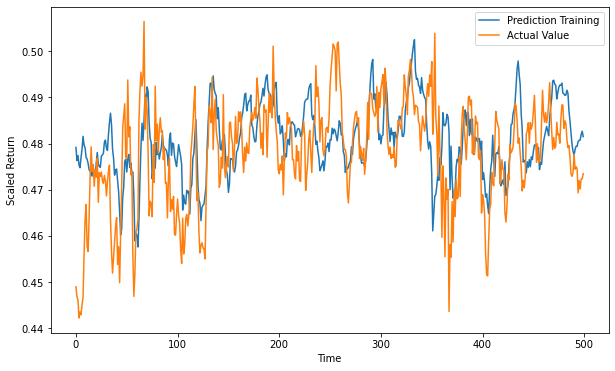

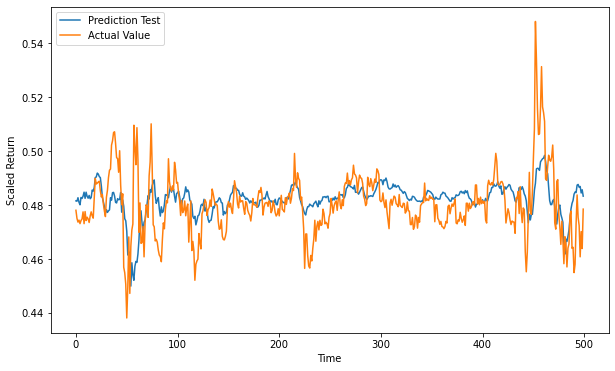


Results for AMZN :
Train Error: 0.017868620761895056 Test Error: 0.019692151335300497

Results for ANSS :
Train Error: 0.018532530840370924 Test Error: 0.020289240598921794

Results for ASML :
Train Error: 0.02404353726493544 Test Error: 0.026234473590492368

Results for ATVI :
Train Error: 0.011247251463397686 Test Error: 0.011552578242605263

Results for AVGO :
Train Error: 0.026428159618962443 Test Error: 0.03867383451185223

Results for BIDU :
Train Error: 0.02540690609802577 Test Error: 0.023321707186768976

Results for BIIB :
Train Error: 0.009947379398870825 Test Error: 0.006717383943055658

Results for BKNG :
Train Error: 0.026596603002266114 Test Error: 0.037905923959720485

Results for CDNS :
Train Error: 0.01780991764419035 Test Error: 0.02073703433597963

Results for CDW :
Train Error: 0.01849243295583124 Test Error: 0.01872418553308909

Results for CERN :
Train Error: 0.017944772034681058 Test Error: 0.03901508901619664

Results for CHKP :
Train Error: 0.01705908834804965

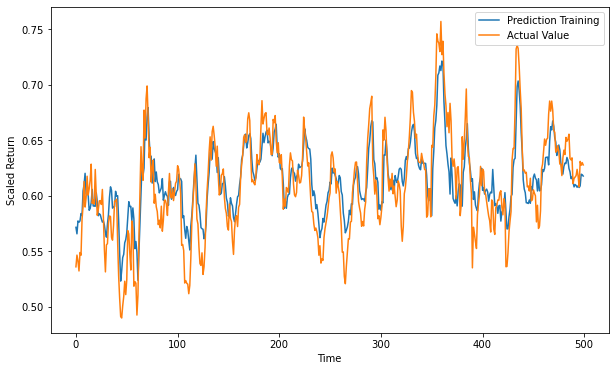

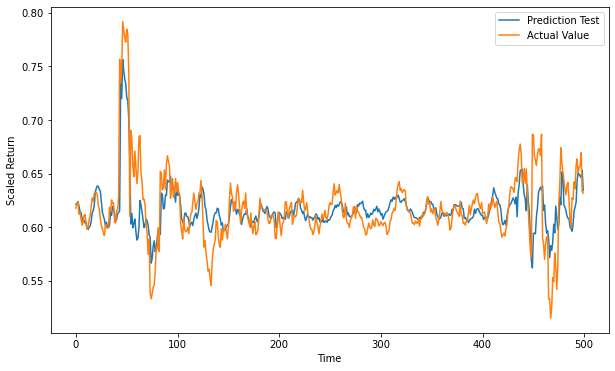


Results for $U0BB :
Train Error: 0.019663576708982652 Test Error: 0.022430594341996783


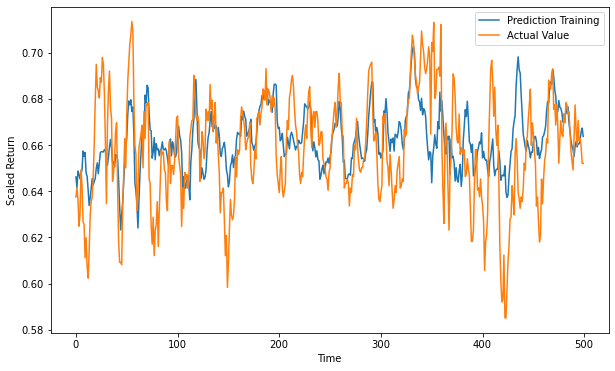

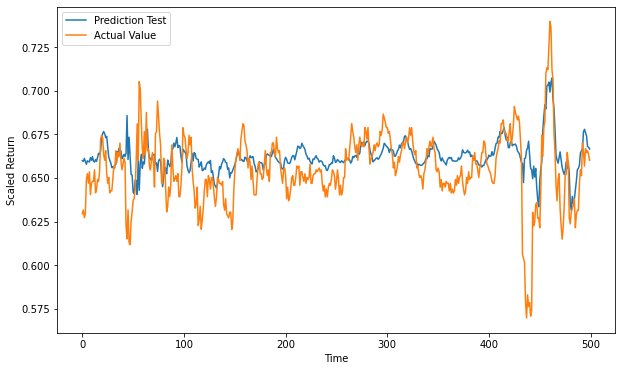


Results for $U0BD :
Train Error: 0.017718018446577274 Test Error: 0.01895279513910557


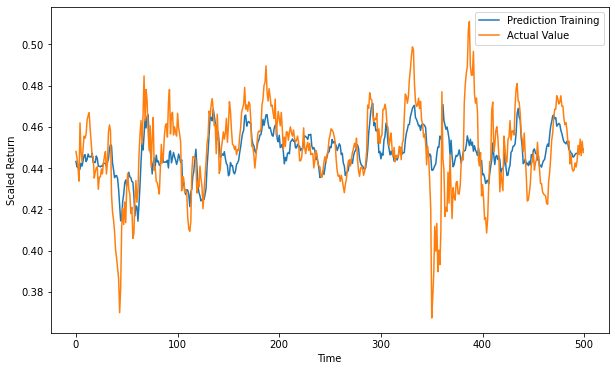

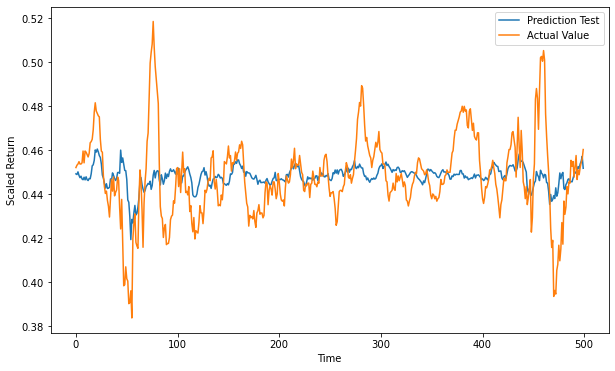


Results for $U2BB :
Train Error: 0.03077594230748259 Test Error: 0.034462064208400034


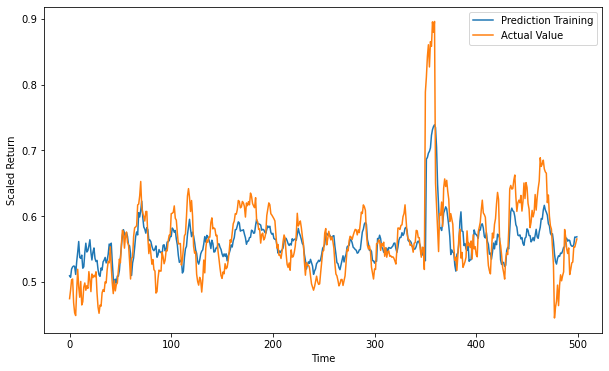

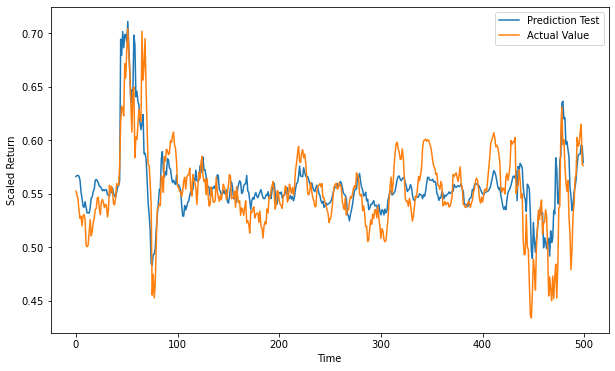


Results for $U2BD :
Train Error: 0.03005520517730084 Test Error: 0.03410350951648871


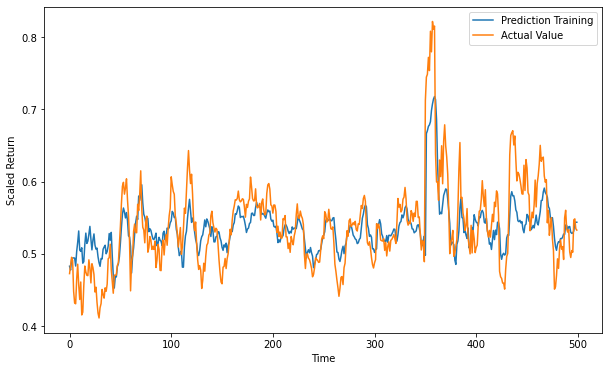

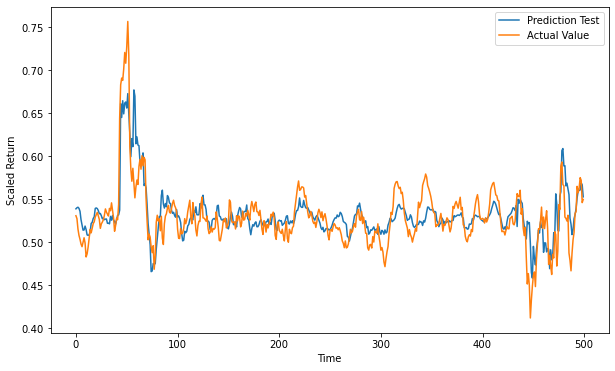


Results for $U3BD :
Train Error: 0.01777335562610939 Test Error: 0.01828743121442782


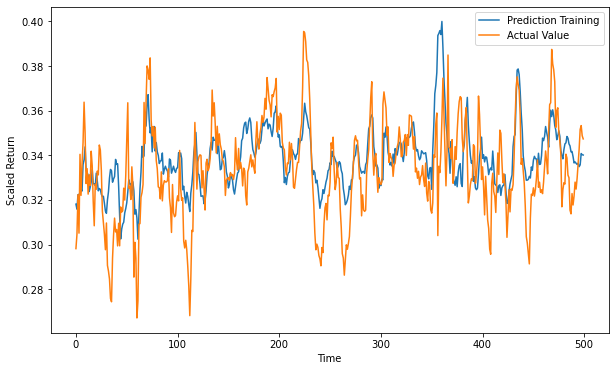

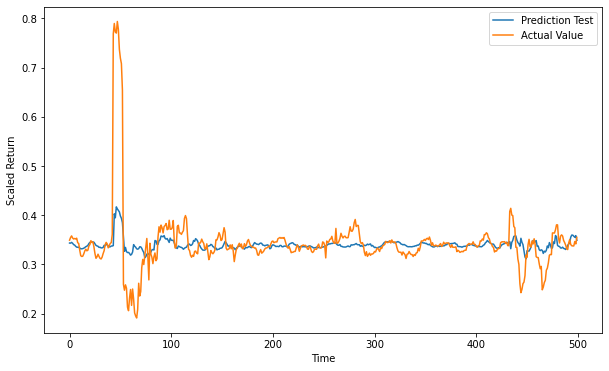


Results for $U3BF :
Train Error: 0.030932746446236923 Test Error: 0.03048336412453598


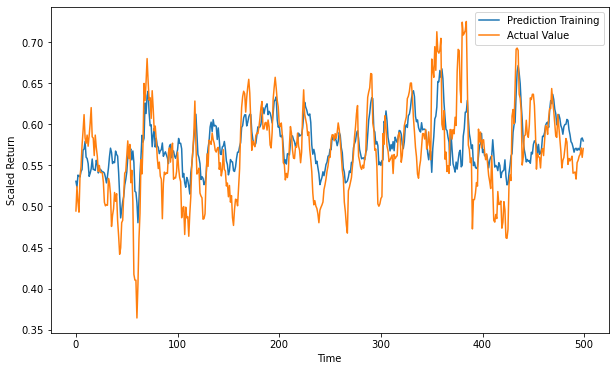

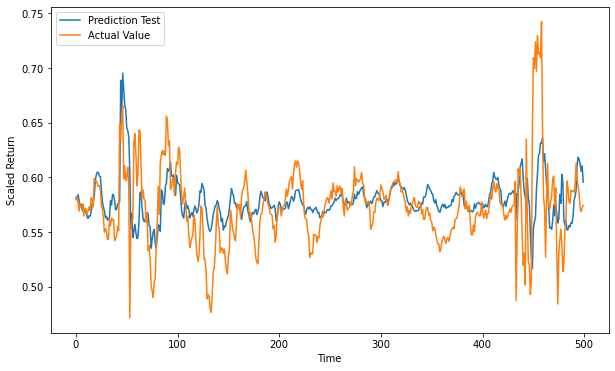


Results for $U3BH :
Train Error: 0.02965269711609816 Test Error: 0.031766153937104656


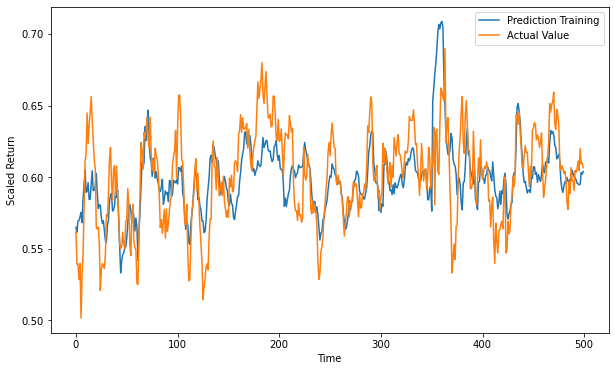

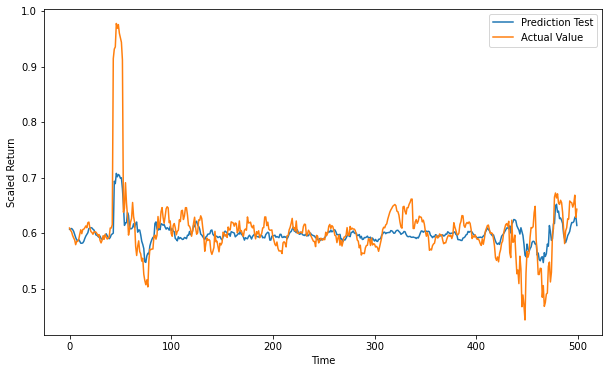


Results for $U4BB :
Train Error: 0.02511706499939818 Test Error: 0.032199973969187154


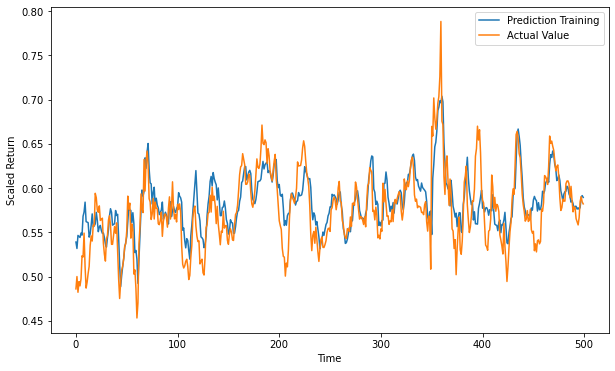

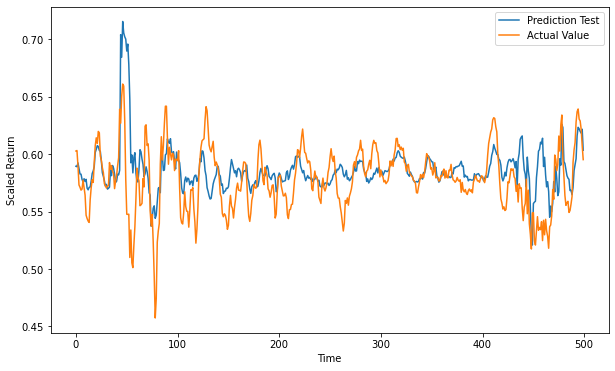


Results for $U4BD :
Train Error: 0.020619985491967748 Test Error: 0.0211818603934396


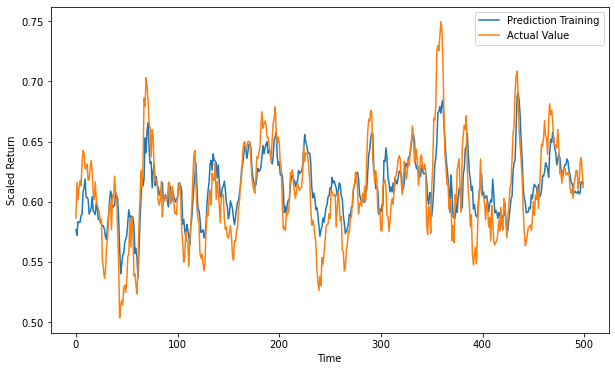

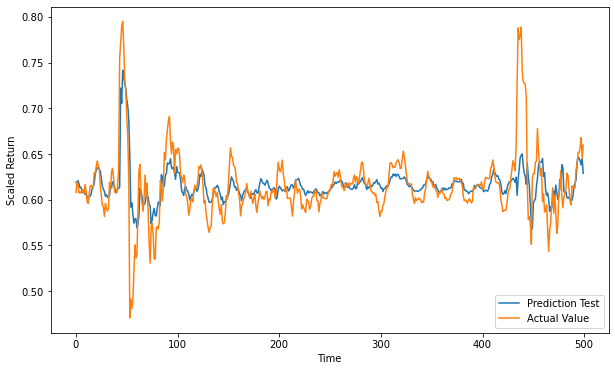


Results for $U4BF :
Train Error: 0.019528967772401387 Test Error: 0.02327778101594788

Results for $U4BH :
Train Error: 0.021742768950264908 Test Error: 0.022501192782855162

Results for $U4BJ :
Train Error: 0.02044648116069437 Test Error: 0.022993115129555635

Results for $U4BL :
Train Error: 0.020453649616270792 Test Error: 0.022280568492785743

Results for $U4BN :
Train Error: 0.023579196735887546 Test Error: 0.022236933818591844

Results for $U4DB :
Train Error: 0.026032220865905252 Test Error: 0.03215527944505694

Results for $U4DD :
Train Error: 0.0221382677648107 Test Error: 0.02565303800993454

Results for $U4FB :
Train Error: 0.014686022345295494 Test Error: 0.013459272383543776

Results for $U4FD :
Train Error: 0.023312299212131408 Test Error: 0.03230612886128673

Results for $U4FH :
Train Error: 0.02267180171976132 Test Error: 0.0216918572897997

Results for $U5BB :
Train Error: 0.026881687686993547 Test Error: 0.027151441530427783

Results for $U5BD :
Train Error: 0.023417

In [47]:
# make predictions and evaluate model 
rmse_train_LSTM, rmse_test_LSTM, rmse_max_LSTM = pred_eval(model_LSTM, 'LSTM')

In [48]:
# manually check for number of parameters and epochs needed 
no_params_LSTM = 24198
epochs_LSTM = 699 #manually 

# display results 
LSTM_results = np.array(['{:}'.format(no_params_LSTM), '{:}'.format(epochs_LSTM), round(time_needed_LSTM/60,2), 
                        '{:.3e}'.format(rmse_train_LSTM), '{:.3e}'.format(rmse_test_LSTM), 
                        '{:.3e}'.format(rmse_max_LSTM)])
LSTM_results = LSTM_results.reshape((1,6))
table_LSTM = pd.DataFrame(LSTM_results,index=['LSTM'],
                         columns=['No. Parameters','No. Epochs','Time [m]','RMSE Train','RMSE Test','RMSE Max'])
table_LSTM

,No. Parameters,No. Epochs,Time [m],RMSE Train,RMSE Test,RMSE Max
LSTM,24198,699,206.97,2.210e-02,2.602e-02,6.597e-02


## GRU

In [49]:
# build model 
model_GRU = GRU_()

# fit model 
time_needed_GRU, history_GRU = train_model(model_GRU,'GRU')

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 30, 20)            10800     
                                                                 
 dropout_13 (Dropout)        (None, 30, 20)            0         
                                                                 
 gru_1 (GRU)                 (None, 30, 20)            2520      
                                                                 
 dropout_14 (Dropout)        (None, 30, 20)            0         
                                                                 
 gru_2 (GRU)                 (None, 20)                2520      
                                                                 
 dropout_15 (Dropout)        (None, 20)                0         
                                                                 
 dense_10 (Dense)            (None, 158)              

Epoch 29/1000
134/134 [==============================] - ETA: 0s - loss: 0.0011
Epoch 00029: val_loss did not improve from 0.00069
134/134 [==============================] - 17s 123ms/step - loss: 0.0011 - val_loss: 7.1607e-04
Epoch 30/1000
134/134 [==============================] - ETA: 0s - loss: 0.0011
Epoch 00030: val_loss did not improve from 0.00069
134/134 [==============================] - 17s 124ms/step - loss: 0.0011 - val_loss: 6.8874e-04
Epoch 31/1000
134/134 [==============================] - ETA: 0s - loss: 0.0010
Epoch 00031: val_loss improved from 0.00069 to 0.00068, saving model to best_model_GRU.h5
134/134 [==============================] - 17s 124ms/step - loss: 0.0010 - val_loss: 6.8032e-04
Epoch 32/1000
134/134 [==============================] - ETA: 0s - loss: 9.9849e-04
Epoch 00032: val_loss improved from 0.00068 to 0.00068, saving model to best_model_GRU.h5
134/134 [==============================] - 17s 124ms/step - loss: 9.9849e-04 - val_loss: 6.7853e-04
Epoch 

Epoch 63/1000
134/134 [==============================] - ETA: 0s - loss: 7.0523e-04
Epoch 00063: val_loss did not improve from 0.00063
134/134 [==============================] - 17s 129ms/step - loss: 7.0523e-04 - val_loss: 6.7502e-04
Epoch 64/1000
134/134 [==============================] - ETA: 0s - loss: 7.0333e-04
Epoch 00064: val_loss did not improve from 0.00063
134/134 [==============================] - 17s 126ms/step - loss: 7.0333e-04 - val_loss: 6.6137e-04
Epoch 65/1000
134/134 [==============================] - ETA: 0s - loss: 7.0129e-04
Epoch 00065: val_loss did not improve from 0.00063
134/134 [==============================] - 16s 123ms/step - loss: 7.0129e-04 - val_loss: 6.7177e-04
Epoch 66/1000
134/134 [==============================] - ETA: 0s - loss: 6.9880e-04
Epoch 00066: val_loss did not improve from 0.00063
134/134 [==============================] - 16s 123ms/step - loss: 6.9880e-04 - val_loss: 6.6625e-04
Epoch 67/1000
134/134 [==============================] - ETA

Epoch 98/1000
134/134 [==============================] - ETA: 0s - loss: 5.8801e-04
Epoch 00098: val_loss did not improve from 0.00062
134/134 [==============================] - 17s 125ms/step - loss: 5.8801e-04 - val_loss: 7.0146e-04
Epoch 99/1000
134/134 [==============================] - ETA: 0s - loss: 5.8933e-04
Epoch 00099: val_loss did not improve from 0.00062
134/134 [==============================] - 17s 125ms/step - loss: 5.8933e-04 - val_loss: 7.1243e-04
Epoch 100/1000
134/134 [==============================] - ETA: 0s - loss: 5.8333e-04
Epoch 00100: val_loss did not improve from 0.00062
134/134 [==============================] - 17s 125ms/step - loss: 5.8333e-04 - val_loss: 7.1831e-04
Epoch 101/1000
134/134 [==============================] - ETA: 0s - loss: 5.8252e-04
Epoch 00101: val_loss did not improve from 0.00062
134/134 [==============================] - 17s 125ms/step - loss: 5.8252e-04 - val_loss: 7.0452e-04
Epoch 102/1000
134/134 [==============================] - 

Epoch 133/1000
134/134 [==============================] - ETA: 0s - loss: 5.5815e-04
Epoch 00133: val_loss did not improve from 0.00062
134/134 [==============================] - 19s 143ms/step - loss: 5.5815e-04 - val_loss: 7.8722e-04
Epoch 134/1000
134/134 [==============================] - ETA: 0s - loss: 5.6032e-04
Epoch 00134: val_loss did not improve from 0.00062
134/134 [==============================] - 17s 128ms/step - loss: 5.6032e-04 - val_loss: 7.5616e-04
Epoch 135/1000
134/134 [==============================] - ETA: 0s - loss: 5.5733e-04
Epoch 00135: val_loss did not improve from 0.00062
134/134 [==============================] - 17s 126ms/step - loss: 5.5733e-04 - val_loss: 7.7172e-04
Epoch 136/1000
134/134 [==============================] - ETA: 0s - loss: 5.5493e-04
Epoch 00136: val_loss did not improve from 0.00062
134/134 [==============================] - 17s 125ms/step - loss: 5.5493e-04 - val_loss: 7.7925e-04
Epoch 137/1000
134/134 [==============================] 

Epoch 168/1000
134/134 [==============================] - ETA: 0s - loss: 5.4567e-04
Epoch 00168: val_loss did not improve from 0.00062
134/134 [==============================] - 17s 125ms/step - loss: 5.4567e-04 - val_loss: 8.1691e-04
Epoch 169/1000
134/134 [==============================] - ETA: 0s - loss: 5.4719e-04
Epoch 00169: val_loss did not improve from 0.00062
134/134 [==============================] - 17s 123ms/step - loss: 5.4719e-04 - val_loss: 8.3590e-04
Epoch 170/1000
134/134 [==============================] - ETA: 0s - loss: 5.4564e-04
Epoch 00170: val_loss did not improve from 0.00062
134/134 [==============================] - 17s 124ms/step - loss: 5.4564e-04 - val_loss: 8.3205e-04
Epoch 171/1000
134/134 [==============================] - ETA: 0s - loss: 5.4491e-04
Epoch 00171: val_loss did not improve from 0.00062
134/134 [==============================] - 17s 123ms/step - loss: 5.4491e-04 - val_loss: 8.1012e-04
Epoch 172/1000
134/134 [==============================] 

459/459 [==============================] - 3s 5ms/step

Results for AAPL :
Train Error: 0.029462570115915965 Test Error: 0.03226937138038638


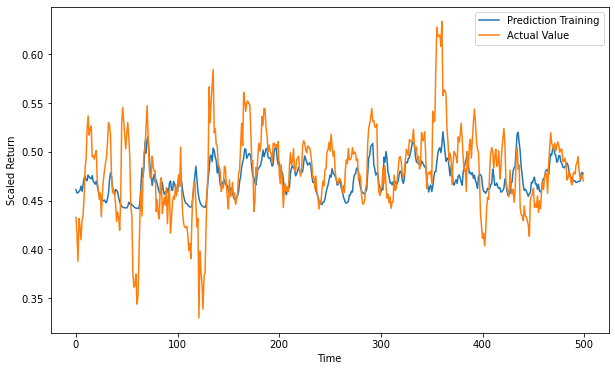

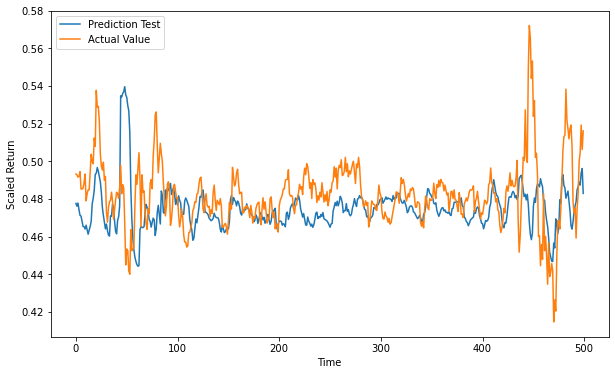


Results for ADBE :
Train Error: 0.024293763014649198 Test Error: 0.04443433075385974


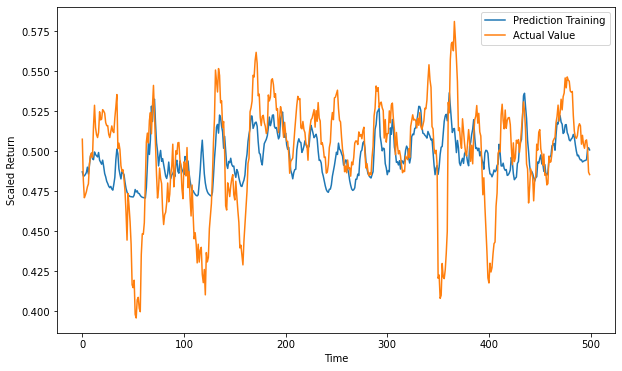

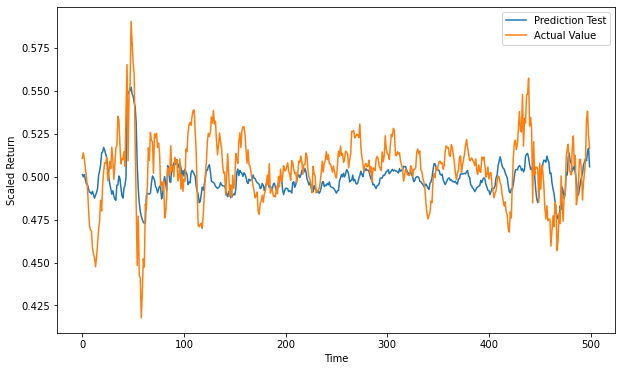


Results for ADI :
Train Error: 0.03261339428093529 Test Error: 0.030491463124968615


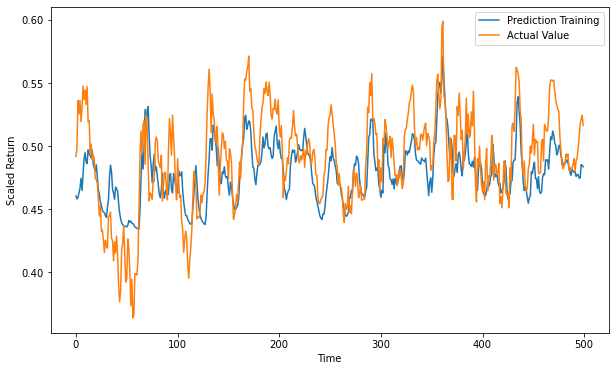

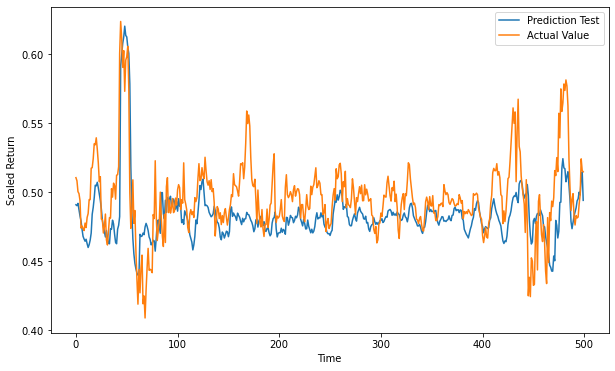


Results for ADP :
Train Error: 0.02456258226836889 Test Error: 0.02550256088800152


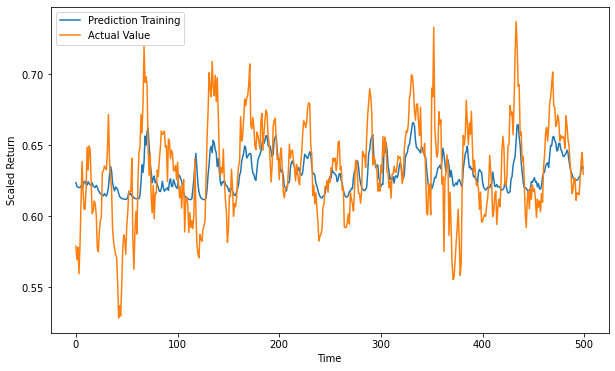

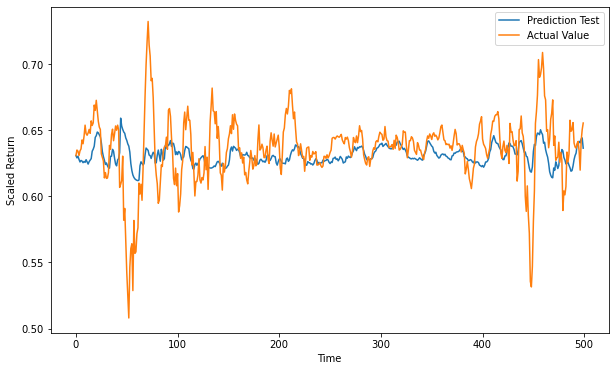


Results for ADSK :
Train Error: 0.020972667564642337 Test Error: 0.03729185150720817


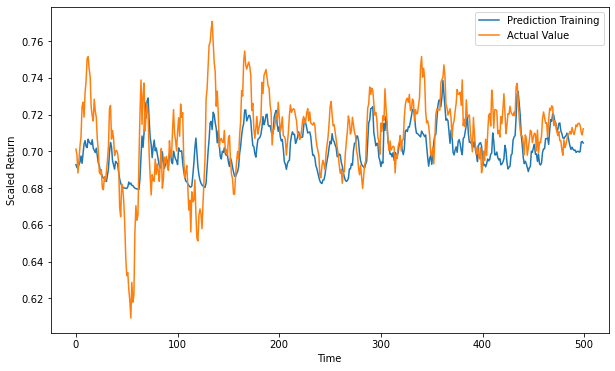

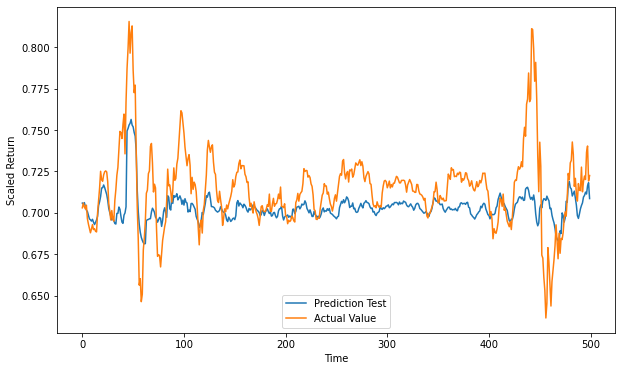


Results for AEP :
Train Error: 0.029403356755836527 Test Error: 0.026946845227092005


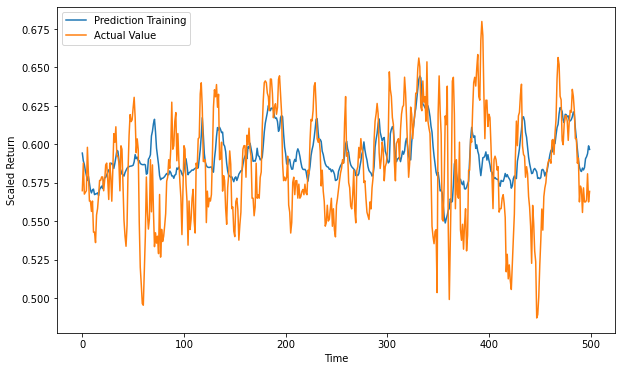

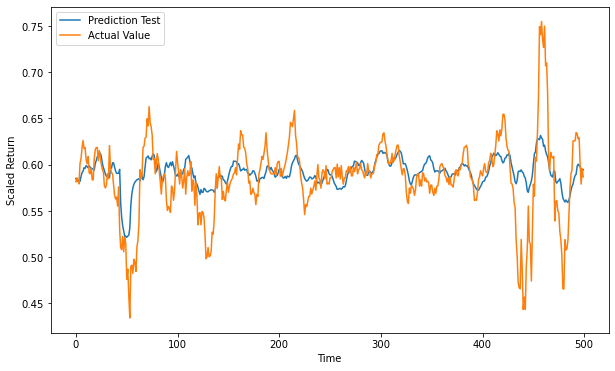


Results for ALGN :
Train Error: 0.018077027966869306 Test Error: 0.015874042694778163


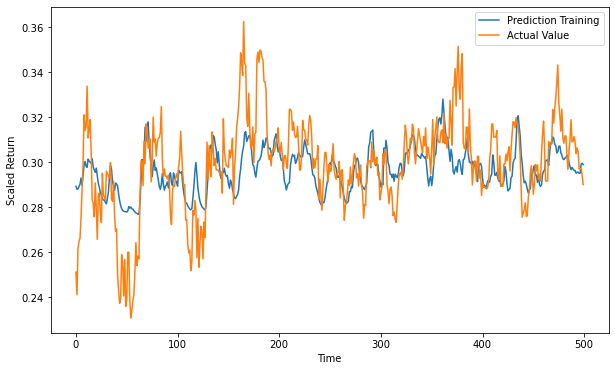

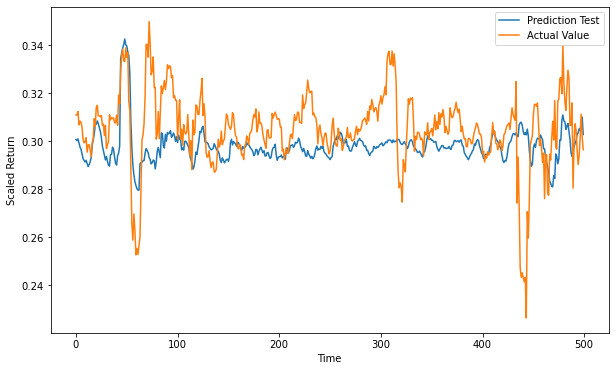


Results for AMAT :
Train Error: 0.023317829323374107 Test Error: 0.02205563921035597


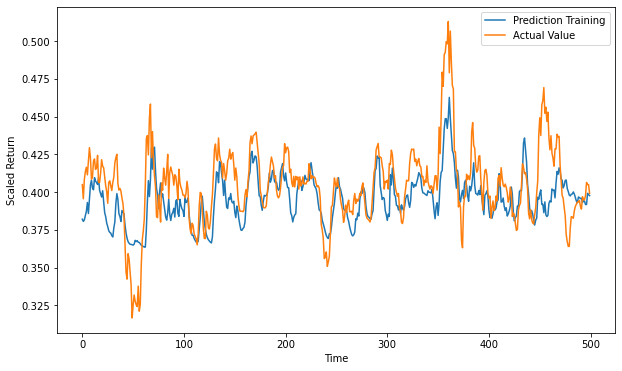

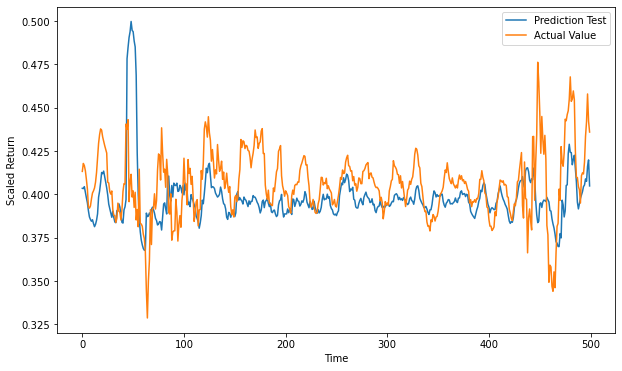


Results for AMD :
Train Error: 0.027018681095764375 Test Error: 0.035617403758320176


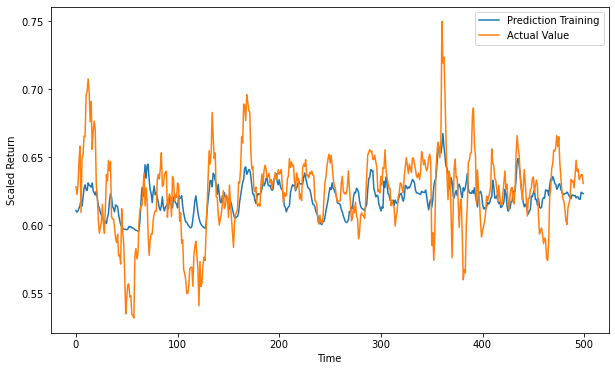

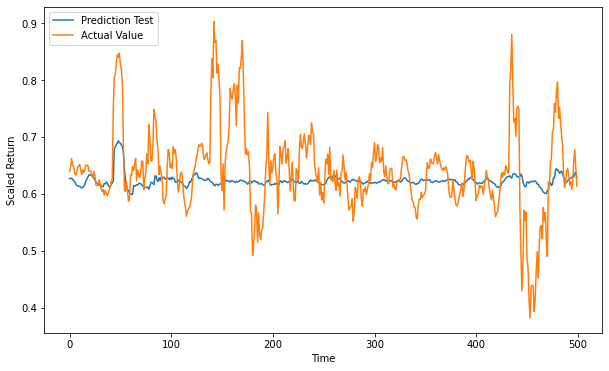


Results for AMGN :
Train Error: 0.013447706489521547 Test Error: 0.013776202818800468


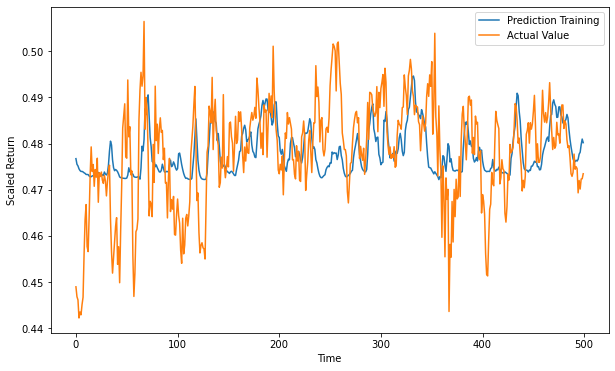

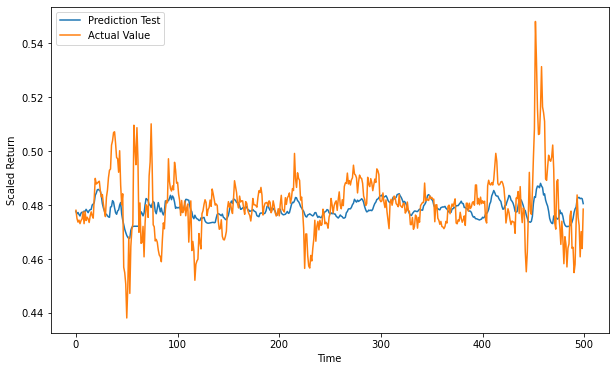


Results for AMZN :
Train Error: 0.020647358151374782 Test Error: 0.0212953267614507

Results for ANSS :
Train Error: 0.023407071794844365 Test Error: 0.023198997803912862

Results for ASML :
Train Error: 0.02813696397761147 Test Error: 0.0289550353340399

Results for ATVI :
Train Error: 0.012090112819998966 Test Error: 0.012029514845203261

Results for AVGO :
Train Error: 0.0316690785605634 Test Error: 0.04013210883687032

Results for BIDU :
Train Error: 0.028884514356119266 Test Error: 0.025035702744782076

Results for BIIB :
Train Error: 0.010034864023647682 Test Error: 0.0067602706128401845

Results for BKNG :
Train Error: 0.0286897785802952 Test Error: 0.04108609525180767

Results for CDNS :
Train Error: 0.022692334479281262 Test Error: 0.024468699482603086

Results for CDW :
Train Error: 0.020174428240189345 Test Error: 0.020385796309097384

Results for CERN :
Train Error: 0.018871437181040496 Test Error: 0.039072100421434906

Results for CHKP :
Train Error: 0.018133013448484146 

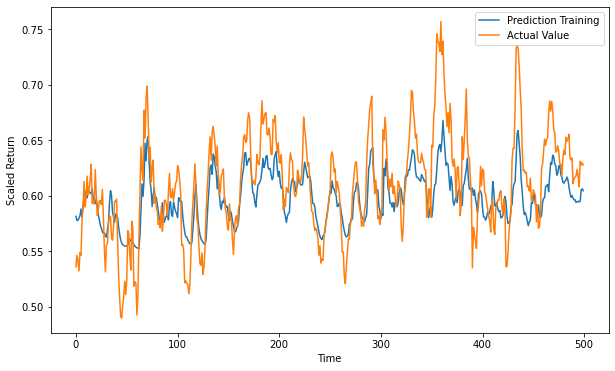

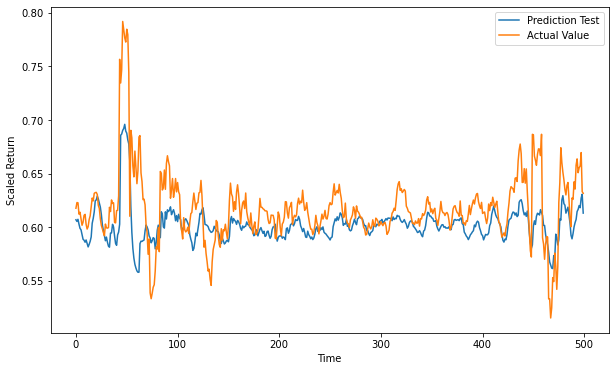


Results for $U0BB :
Train Error: 0.021345272070994525 Test Error: 0.0245012974868755


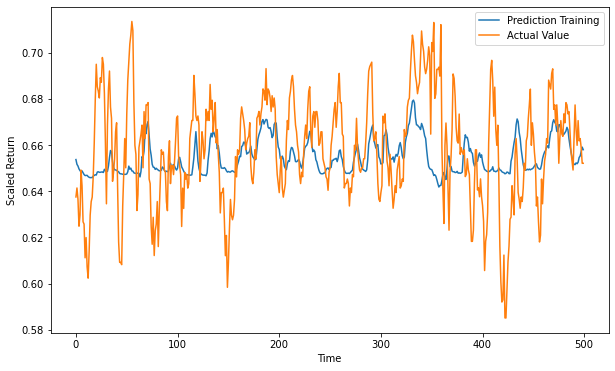

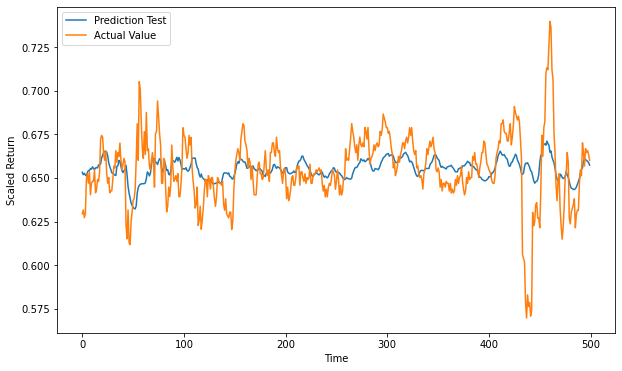


Results for $U0BD :
Train Error: 0.019464372059514543 Test Error: 0.020109810071854112


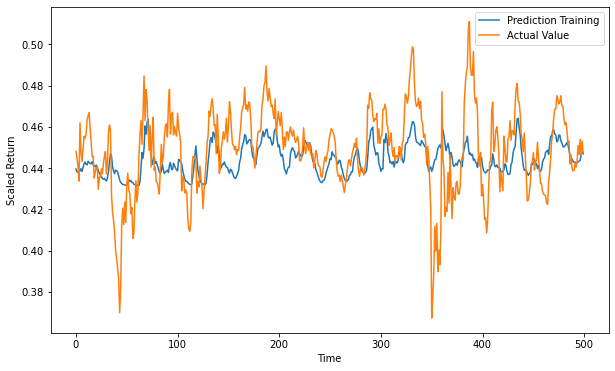

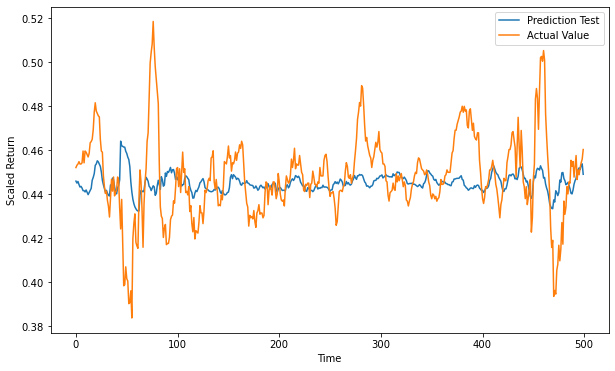


Results for $U2BB :
Train Error: 0.04351492091426695 Test Error: 0.04518252954500683


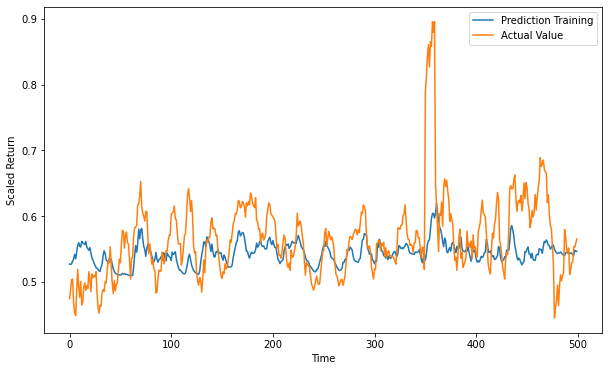

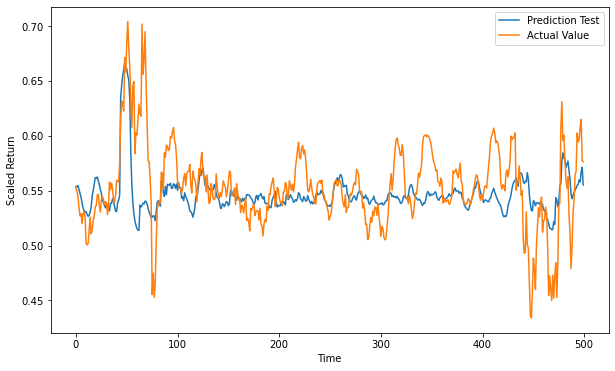


Results for $U2BD :
Train Error: 0.04331808529746922 Test Error: 0.04473588684404322


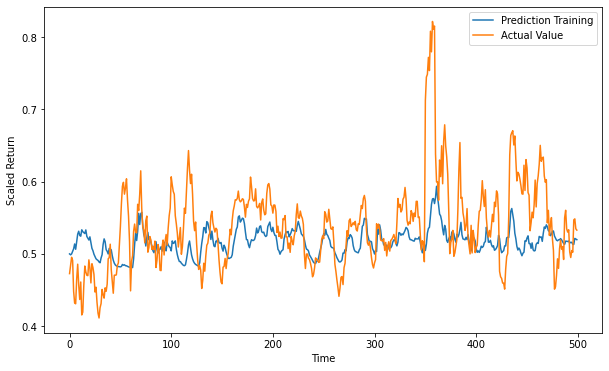

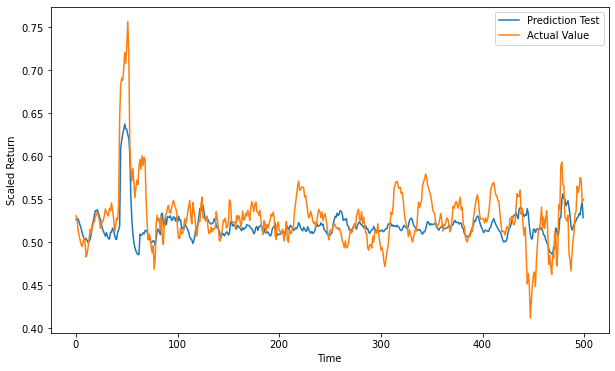


Results for $U3BD :
Train Error: 0.021370149103612242 Test Error: 0.020583689049938333


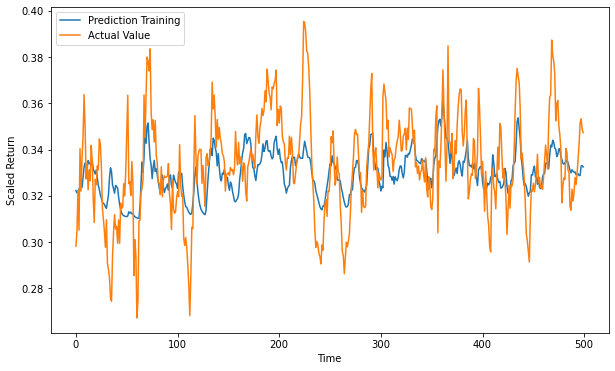

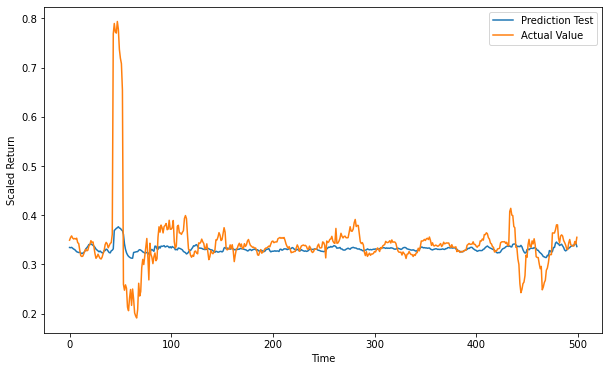


Results for $U3BF :
Train Error: 0.035614716795882004 Test Error: 0.035637961903088586


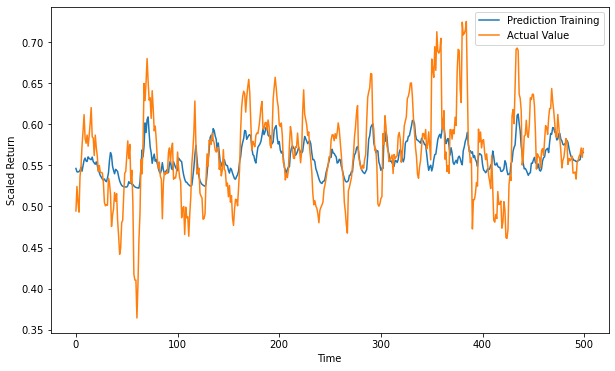

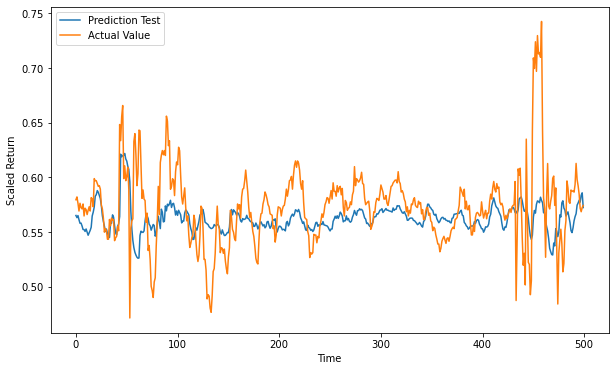


Results for $U3BH :
Train Error: 0.03551439358160714 Test Error: 0.03680270674482867


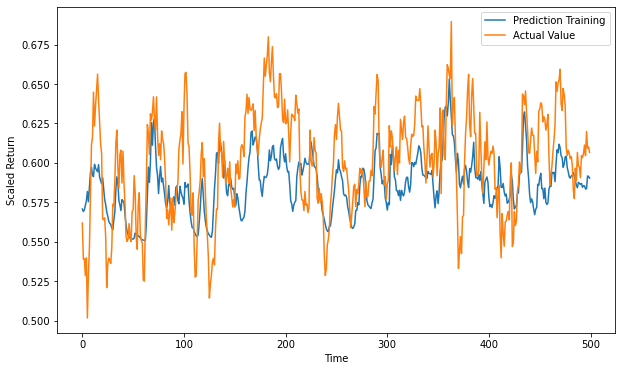

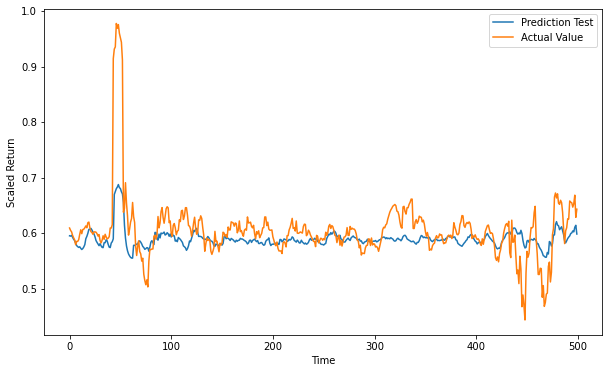


Results for $U4BB :
Train Error: 0.03297047831513288 Test Error: 0.038259049577778155


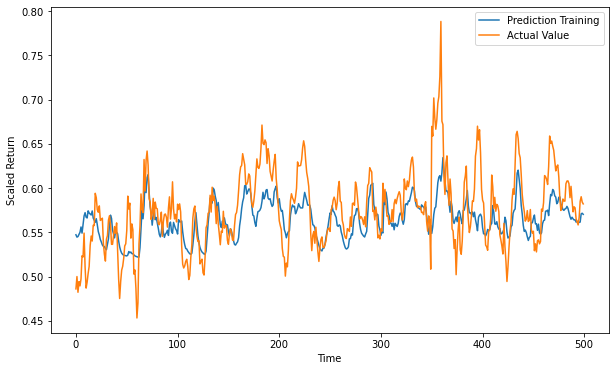

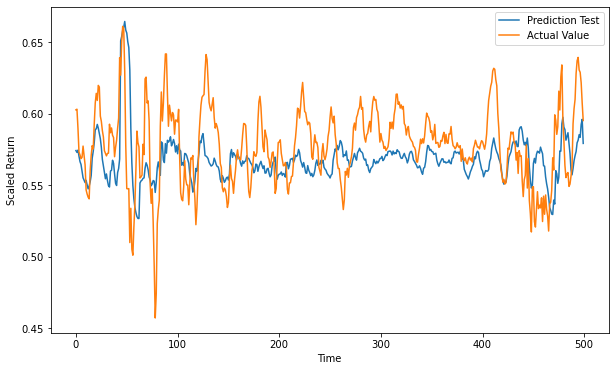


Results for $U4BD :
Train Error: 0.02737666215959403 Test Error: 0.02554043826912346


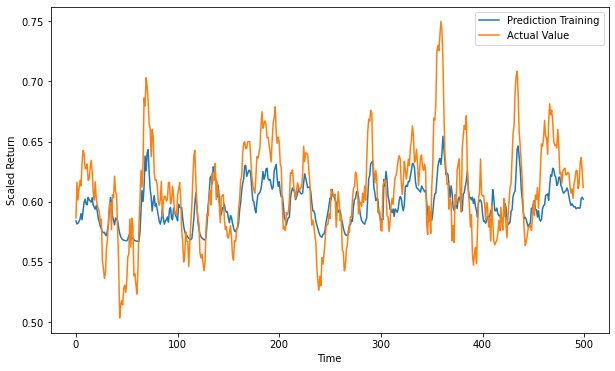

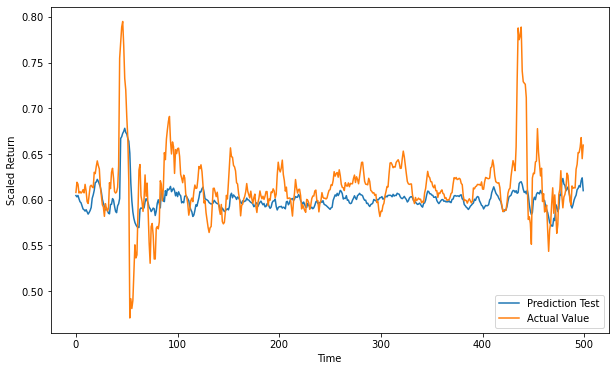


Results for $U4BF :
Train Error: 0.021734097759693302 Test Error: 0.024119854279252326

Results for $U4BH :
Train Error: 0.02892088386958819 Test Error: 0.026419425655573092

Results for $U4BJ :
Train Error: 0.02673245653306156 Test Error: 0.027512562722912203

Results for $U4BL :
Train Error: 0.029856546404379278 Test Error: 0.02941457175272498

Results for $U4BN :
Train Error: 0.030975444772172806 Test Error: 0.02828778838787997

Results for $U4DB :
Train Error: 0.03145824760708743 Test Error: 0.036063517422352934

Results for $U4DD :
Train Error: 0.02444335957045116 Test Error: 0.026964436001941188

Results for $U4FB :
Train Error: 0.015657452450261015 Test Error: 0.014033010431358383

Results for $U4FD :
Train Error: 0.028965723572591067 Test Error: 0.03715495703148151

Results for $U4FH :
Train Error: 0.028049776136409396 Test Error: 0.027239994684096776

Results for $U5BB :
Train Error: 0.03383813371274222 Test Error: 0.032883998218071385

Results for $U5BD :
Train Error: 0.0278

In [50]:
# make predictions and evaluate model 
rmse_train_GRU, rmse_test_GRU, rmse_max_GRU = pred_eval(model_GRU, 'GRU')

In [51]:
# manually check for number of parameters and epochs needed 
no_params_GRU = 19158
epochs_GRU = 172 #manually 

# display results 
GRU_results = np.array(['{:}'.format(no_params_GRU), '{:}'.format(epochs_GRU), round(time_needed_GRU/60,2), 
                        '{:.3e}'.format(rmse_train_GRU), '{:.3e}'.format(rmse_test_GRU), 
                        '{:.3e}'.format(rmse_max_GRU)])
GRU_results = GRU_results.reshape((1,6))
table_GRU = pd.DataFrame(GRU_results,index=['GRU'],
                         columns=['No. Parameters','No. Epochs','Time [m]','RMSE Train','RMSE Test','RMSE Max'])
table_GRU

,No. Parameters,No. Epochs,Time [m],RMSE Train,RMSE Test,RMSE Max
GRU,19158,172,48.59,2.533e-02,2.810e-02,6.799e-02


## CNN

In [52]:
# build model 
model_CNN = CNN_()

# fit model 
time_needed_CNN, history_CNN = train_model(model_CNN,'CNN')

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 26, 32)            25312     
                                                                 
 max_pooling1d (MaxPooling1D  (None, 13, 32)           0         
 )                                                               
                                                                 
 dropout_16 (Dropout)        (None, 13, 32)            0         
                                                                 
 flatten_1 (Flatten)         (None, 416)               0         
                                                                 
 dense_11 (Dense)            (None, 20)                8340      
                                                                 
 dropout_17 (Dropout)        (None, 20)                0         
                                                      

Epoch 28/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0011
Epoch 00028: val_loss improved from 0.00072 to 0.00070, saving model to best_model_CNN.h5
134/134 [==============================] - 7s 51ms/step - loss: 0.0011 - val_loss: 7.0400e-04
Epoch 29/1000
134/134 [==============================] - ETA: 0s - loss: 0.0011
Epoch 00029: val_loss did not improve from 0.00070
134/134 [==============================] - 7s 56ms/step - loss: 0.0011 - val_loss: 7.1613e-04
Epoch 30/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0011
Epoch 00030: val_loss improved from 0.00070 to 0.00070, saving model to best_model_CNN.h5
134/134 [==============================] - 7s 52ms/step - loss: 0.0011 - val_loss: 6.9835e-04
Epoch 31/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0010
Epoch 00031: val_loss did not improve from 0.00070
134/134 [==============================] - 7s 55ms/step - loss: 0.0010 - val_loss: 7.0401e-04
Epoch 32/1000
133/134 

Epoch 61/1000
133/134 [============================>.] - ETA: 0s - loss: 7.4838e-04
Epoch 00061: val_loss did not improve from 0.00063
134/134 [==============================] - 8s 62ms/step - loss: 7.4778e-04 - val_loss: 6.3677e-04
Epoch 62/1000
133/134 [============================>.] - ETA: 0s - loss: 7.4492e-04
Epoch 00062: val_loss did not improve from 0.00063
134/134 [==============================] - 9s 68ms/step - loss: 7.4433e-04 - val_loss: 6.4104e-04
Epoch 63/1000
133/134 [============================>.] - ETA: 0s - loss: 7.3665e-04
Epoch 00063: val_loss improved from 0.00063 to 0.00063, saving model to best_model_CNN.h5
134/134 [==============================] - 8s 63ms/step - loss: 7.3609e-04 - val_loss: 6.2516e-04
Epoch 64/1000
133/134 [============================>.] - ETA: 0s - loss: 7.4210e-04
Epoch 00064: val_loss did not improve from 0.00063
134/134 [==============================] - 9s 66ms/step - loss: 7.4152e-04 - val_loss: 6.3050e-04
Epoch 65/1000
133/134 [======

133/134 [============================>.] - ETA: 0s - loss: 7.1607e-04
Epoch 00095: val_loss did not improve from 0.00062
134/134 [==============================] - 8s 63ms/step - loss: 7.1554e-04 - val_loss: 6.2781e-04
Epoch 96/1000
133/134 [============================>.] - ETA: 0s - loss: 7.1980e-04
Epoch 00096: val_loss did not improve from 0.00062
134/134 [==============================] - 8s 61ms/step - loss: 7.1927e-04 - val_loss: 6.2575e-04
Epoch 97/1000
133/134 [============================>.] - ETA: 0s - loss: 7.1788e-04
Epoch 00097: val_loss did not improve from 0.00062
134/134 [==============================] - 9s 65ms/step - loss: 7.1736e-04 - val_loss: 6.2674e-04
Epoch 98/1000
133/134 [============================>.] - ETA: 0s - loss: 7.1666e-04
Epoch 00098: val_loss did not improve from 0.00062
134/134 [==============================] - 8s 62ms/step - loss: 7.1615e-04 - val_loss: 6.2505e-04
Epoch 99/1000
133/134 [============================>.] - ETA: 0s - loss: 7.1656e-0

133/134 [============================>.] - ETA: 0s - loss: 7.0968e-04
Epoch 00130: val_loss did not improve from 0.00062
134/134 [==============================] - 8s 60ms/step - loss: 7.0922e-04 - val_loss: 6.3196e-04
Epoch 131/1000
133/134 [============================>.] - ETA: 0s - loss: 7.1103e-04
Epoch 00131: val_loss did not improve from 0.00062
134/134 [==============================] - 10s 71ms/step - loss: 7.1050e-04 - val_loss: 6.2674e-04
Epoch 132/1000
133/134 [============================>.] - ETA: 0s - loss: 7.0722e-04
Epoch 00132: val_loss did not improve from 0.00062
134/134 [==============================] - 10s 75ms/step - loss: 7.0669e-04 - val_loss: 6.3121e-04
Epoch 133/1000
133/134 [============================>.] - ETA: 0s - loss: 7.1204e-04
Epoch 00133: val_loss did not improve from 0.00062
134/134 [==============================] - 9s 67ms/step - loss: 7.1148e-04 - val_loss: 6.2756e-04
Epoch 134/1000
133/134 [============================>.] - ETA: 0s - loss: 7.0

Epoch 165/1000
133/134 [============================>.] - ETA: 0s - loss: 7.0667e-04
Epoch 00165: val_loss did not improve from 0.00062
134/134 [==============================] - 9s 64ms/step - loss: 7.0613e-04 - val_loss: 6.2714e-04
Epoch 166/1000
133/134 [============================>.] - ETA: 0s - loss: 7.0331e-04
Epoch 00166: val_loss did not improve from 0.00062
134/134 [==============================] - 9s 65ms/step - loss: 7.0277e-04 - val_loss: 6.3000e-04
Epoch 167/1000
133/134 [============================>.] - ETA: 0s - loss: 7.0696e-04
Epoch 00167: val_loss did not improve from 0.00062
134/134 [==============================] - 9s 70ms/step - loss: 7.0642e-04 - val_loss: 6.2661e-04
Epoch 168/1000
133/134 [============================>.] - ETA: 0s - loss: 7.0458e-04
Epoch 00168: val_loss did not improve from 0.00062
134/134 [==============================] - 9s 65ms/step - loss: 7.0404e-04 - val_loss: 6.2456e-04
Epoch 169/1000
133/134 [============================>.] - ETA: 0

459/459 [==============================] - 3s 6ms/step

Results for AAPL :
Train Error: 0.028864773717502696 Test Error: 0.03172935644207781


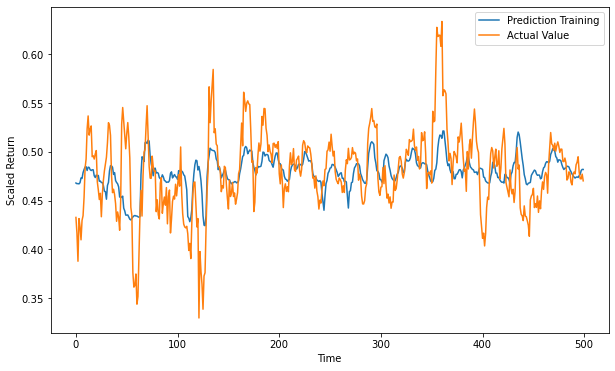

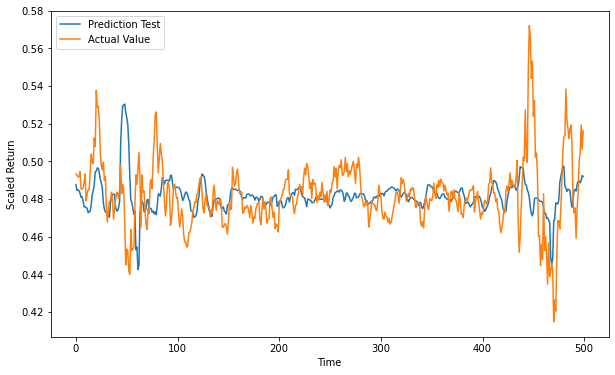


Results for ADBE :
Train Error: 0.024002794646948315 Test Error: 0.04482890069594884


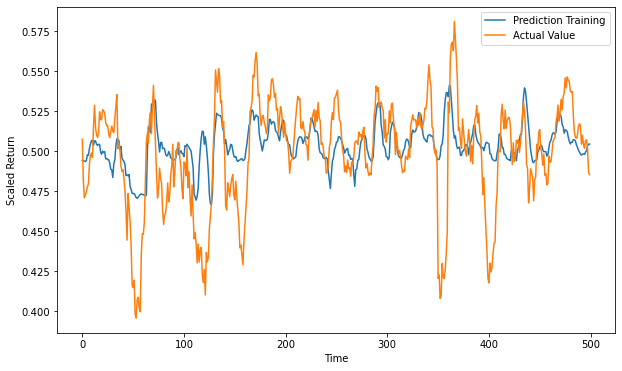

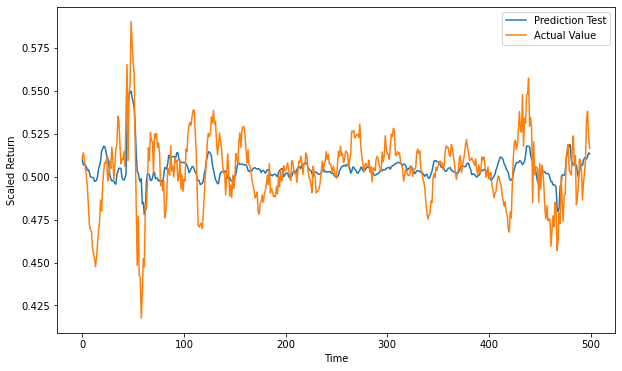


Results for ADI :
Train Error: 0.030857670370601584 Test Error: 0.02876775205846545


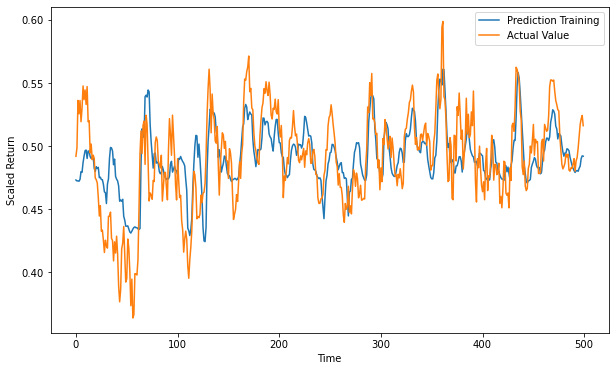

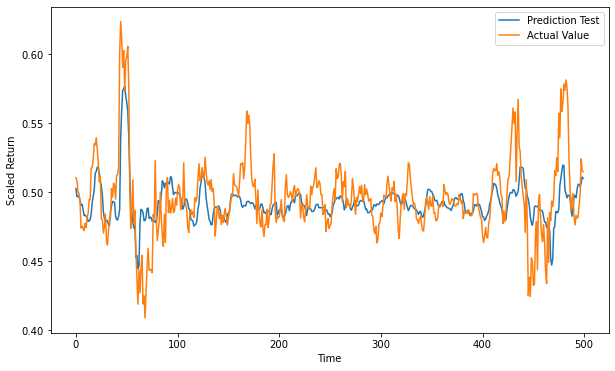


Results for ADP :
Train Error: 0.024353859138721713 Test Error: 0.025350170621402723


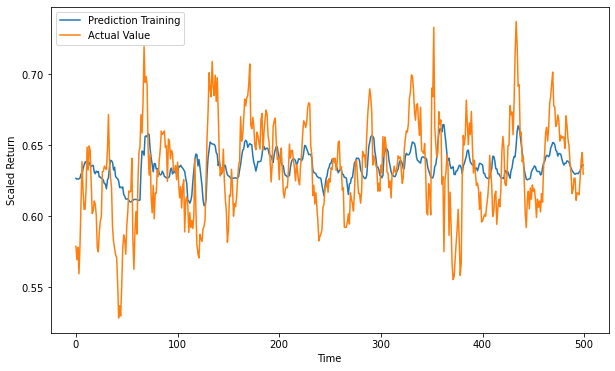

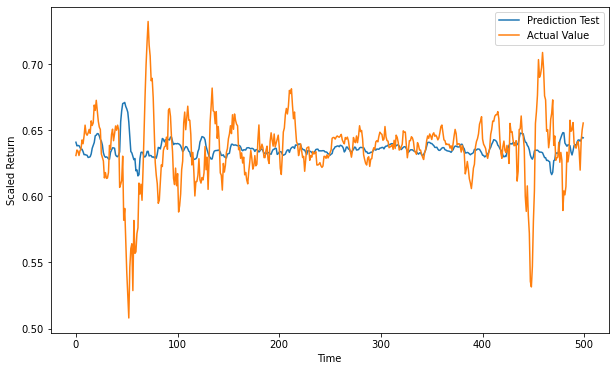


Results for ADSK :
Train Error: 0.019417136550300133 Test Error: 0.03657959091274447


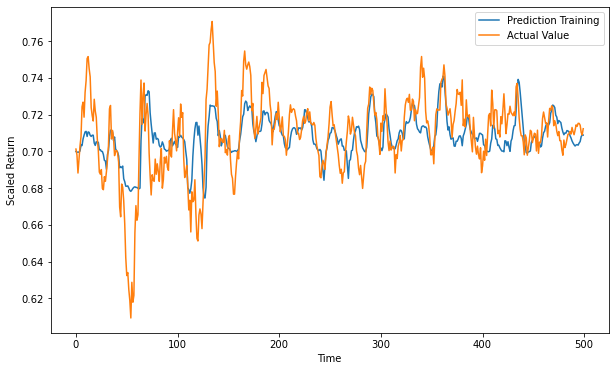

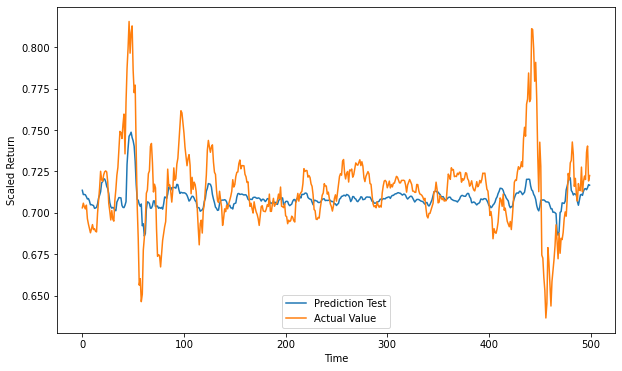


Results for AEP :
Train Error: 0.03368976037105273 Test Error: 0.031821356698296395


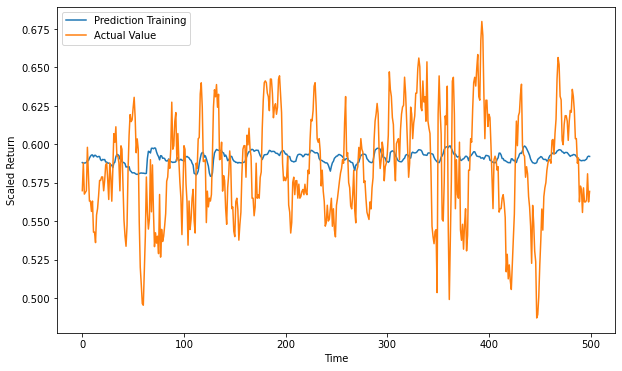

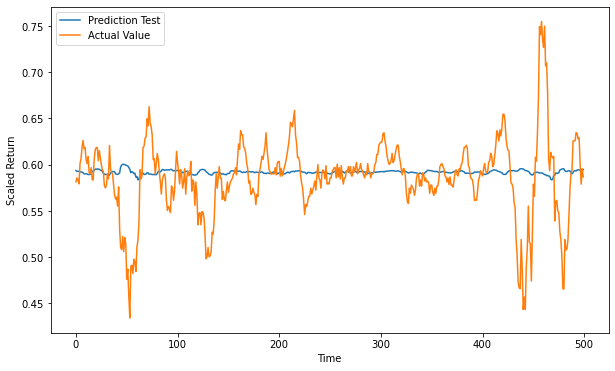


Results for ALGN :
Train Error: 0.01770940791644476 Test Error: 0.015578573301246658


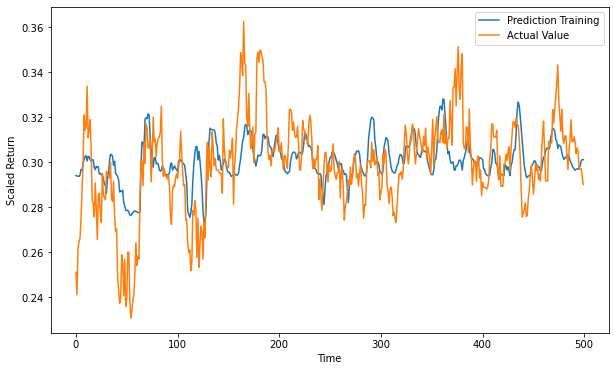

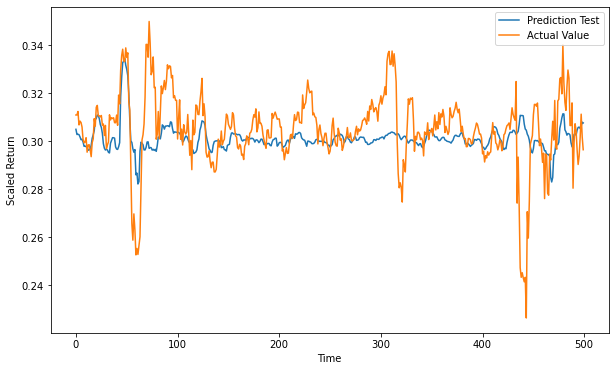


Results for AMAT :
Train Error: 0.022832236675094993 Test Error: 0.021055251843438184


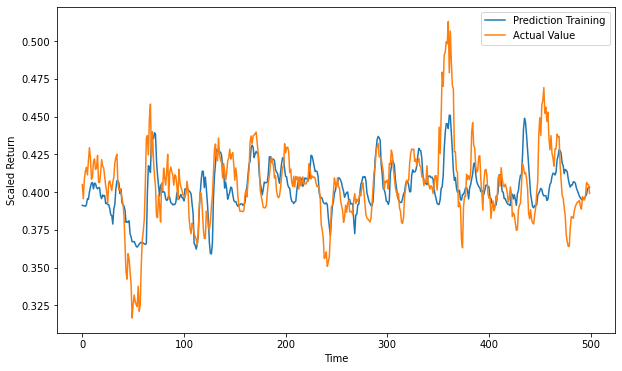

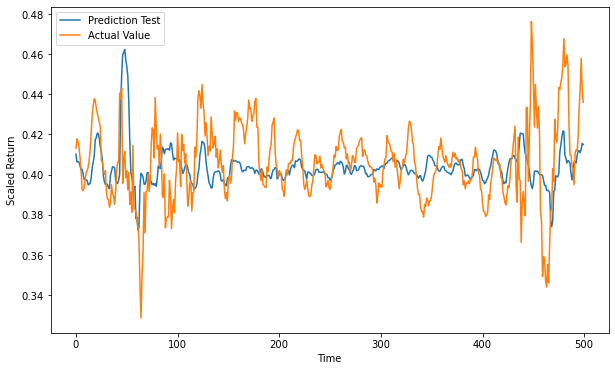


Results for AMD :
Train Error: 0.026708983711561062 Test Error: 0.03578309412904055


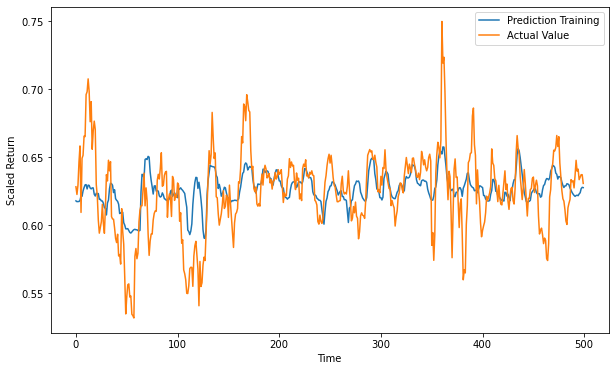

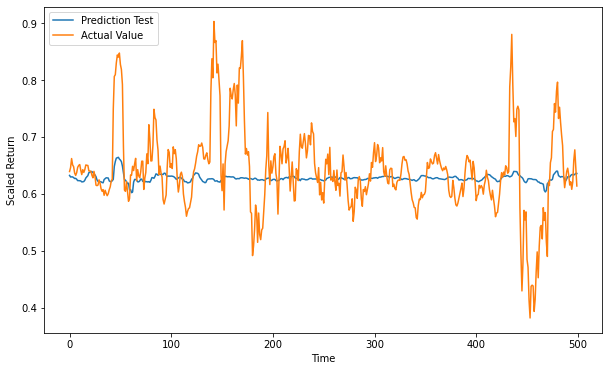


Results for AMGN :
Train Error: 0.013841993132556005 Test Error: 0.014225319787158224


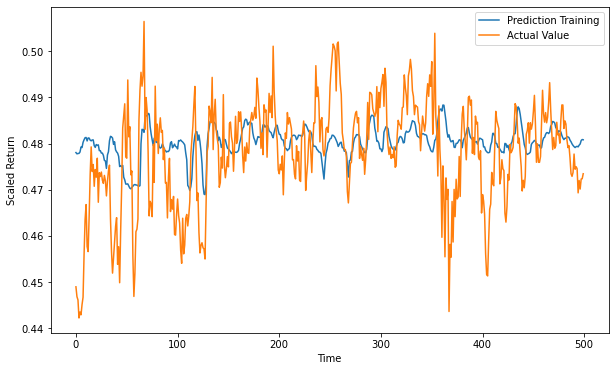

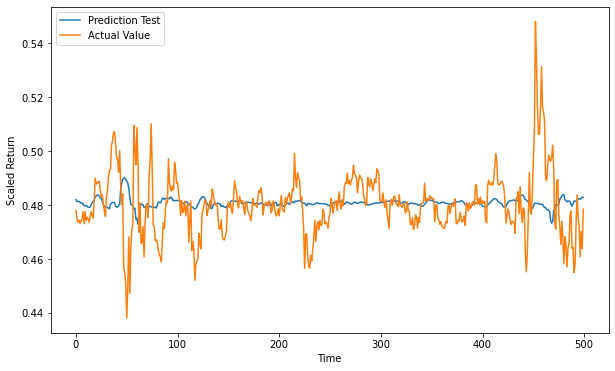


Results for AMZN :
Train Error: 0.020578226151949708 Test Error: 0.02148022424529215

Results for ANSS :
Train Error: 0.022027690199025656 Test Error: 0.02201694986001864

Results for ASML :
Train Error: 0.027398472563814134 Test Error: 0.02844017331963176

Results for ATVI :
Train Error: 0.011689643623425935 Test Error: 0.011498315144612744

Results for AVGO :
Train Error: 0.030535167775323616 Test Error: 0.03874540479418732

Results for BIDU :
Train Error: 0.028729617627705224 Test Error: 0.024756187760168163

Results for BIIB :
Train Error: 0.010044909721794972 Test Error: 0.006757263347367976

Results for BKNG :
Train Error: 0.02866457922407635 Test Error: 0.041045881502571144

Results for CDNS :
Train Error: 0.02198641422437036 Test Error: 0.023975271432744263

Results for CDW :
Train Error: 0.019654679966950327 Test Error: 0.02009676186262055

Results for CERN :
Train Error: 0.019381439994371055 Test Error: 0.039251032590550475

Results for CHKP :
Train Error: 0.0180536632830065

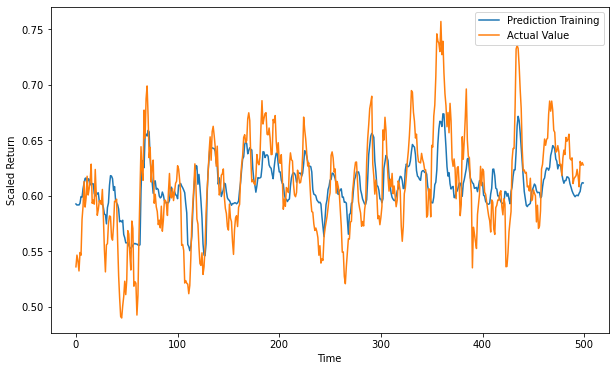

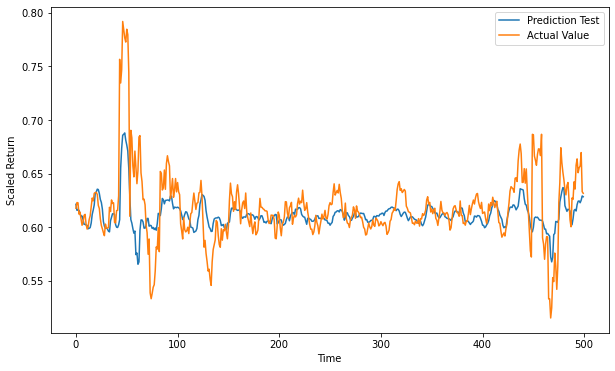


Results for $U0BB :
Train Error: 0.02224260907087841 Test Error: 0.025343198835807698


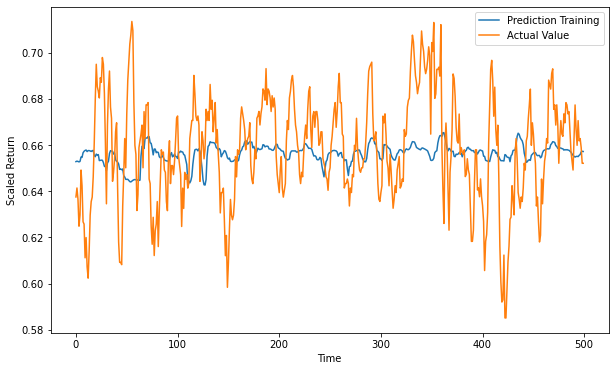

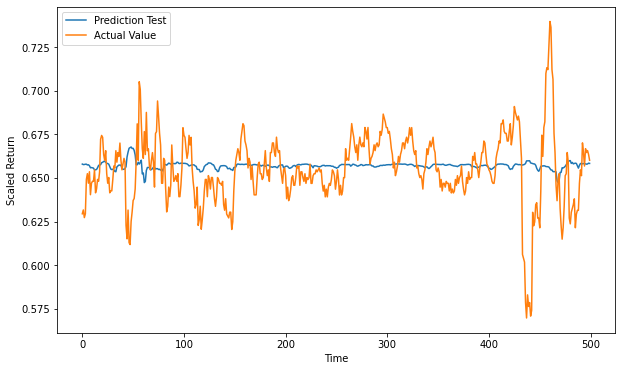


Results for $U0BD :
Train Error: 0.019059165738842424 Test Error: 0.019814585103813148


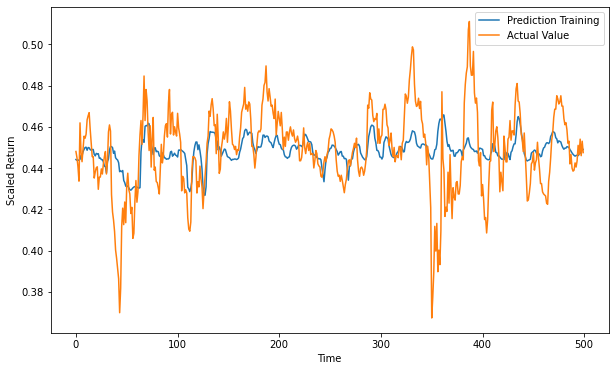

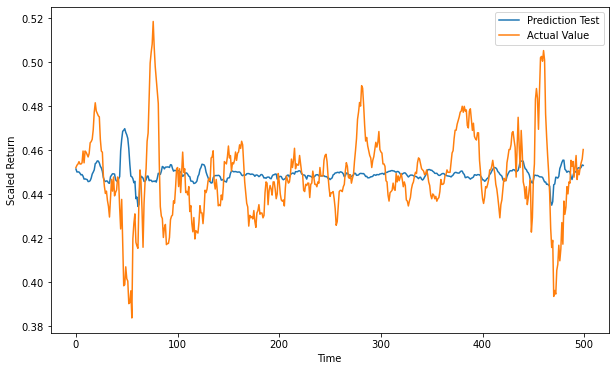


Results for $U2BB :
Train Error: 0.043322585469884344 Test Error: 0.044377822097449296


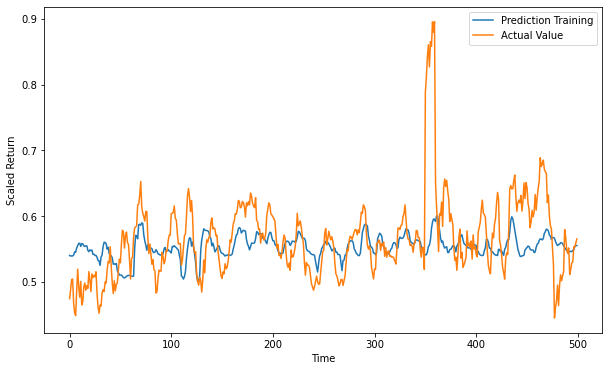

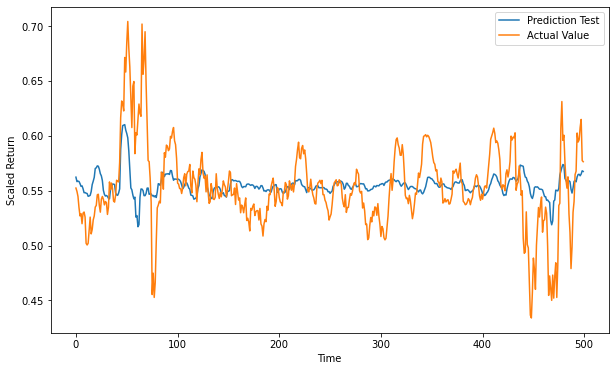


Results for $U2BD :
Train Error: 0.04271696716881017 Test Error: 0.04389270683908241


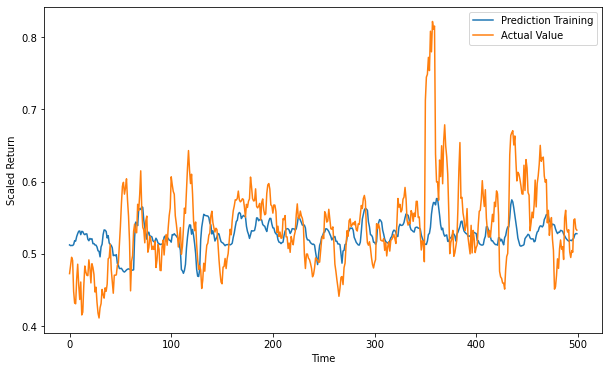

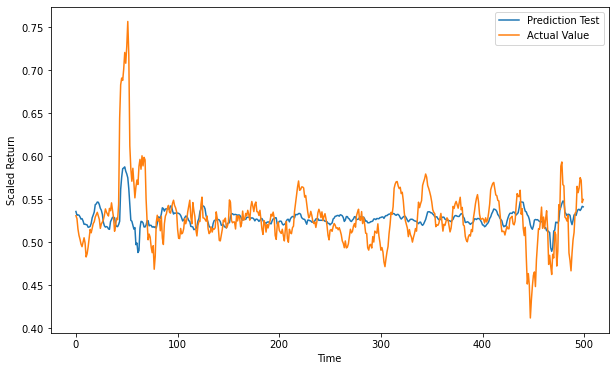


Results for $U3BD :
Train Error: 0.020716811745519013 Test Error: 0.02003444644805321


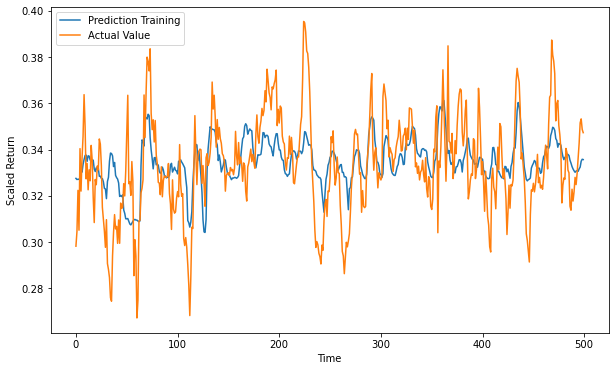

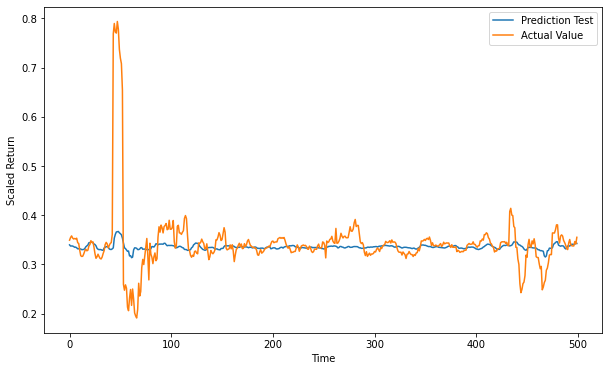


Results for $U3BF :
Train Error: 0.035433644865846825 Test Error: 0.03628446059055248


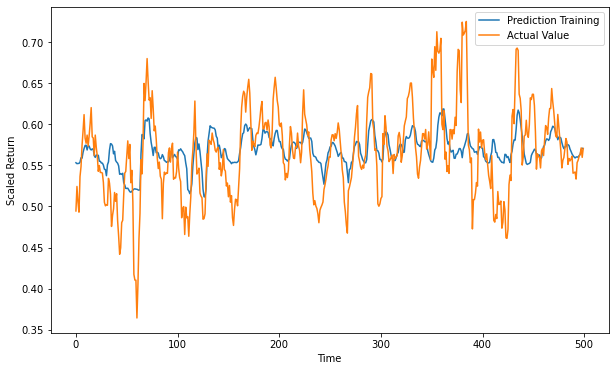

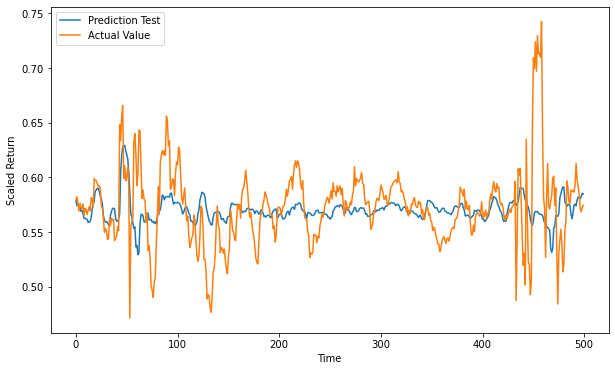


Results for $U3BH :
Train Error: 0.034206414783920794 Test Error: 0.035428436076290475


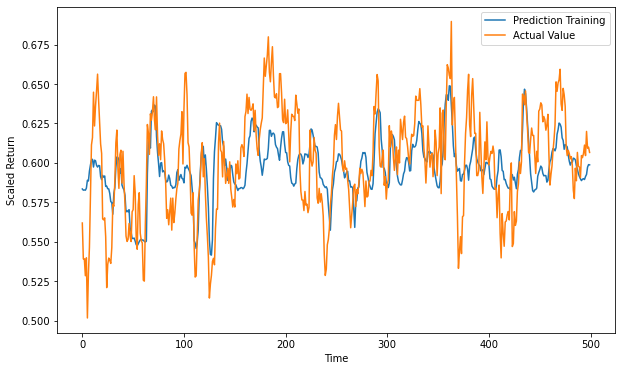

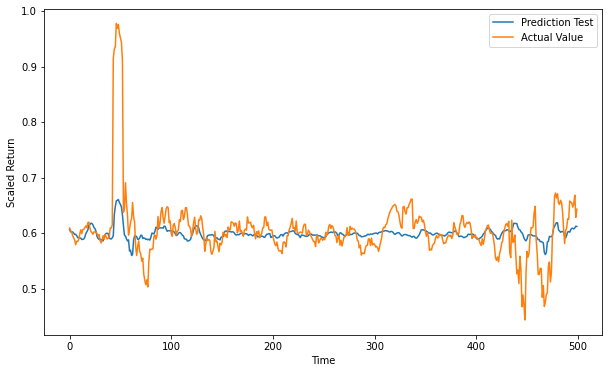


Results for $U4BB :
Train Error: 0.03119526163497884 Test Error: 0.0367921014970156


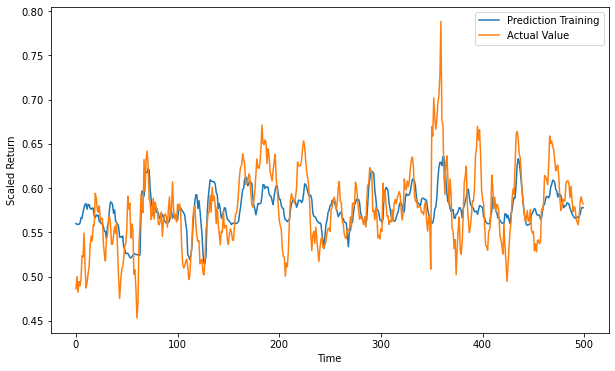

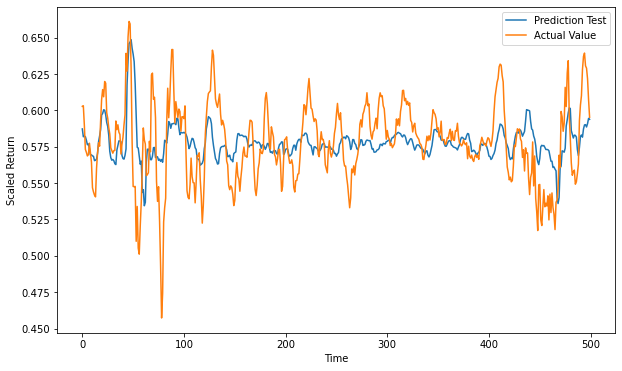


Results for $U4BD :
Train Error: 0.02570818217610068 Test Error: 0.02383928860634009


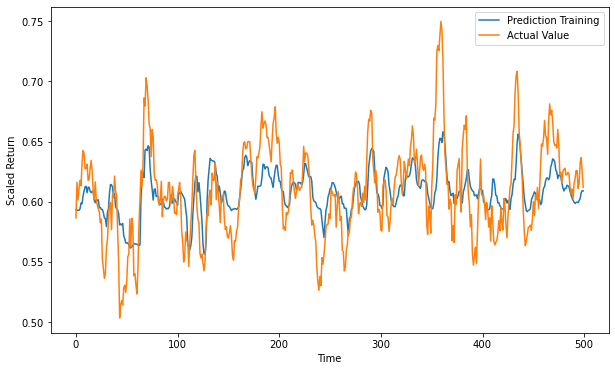

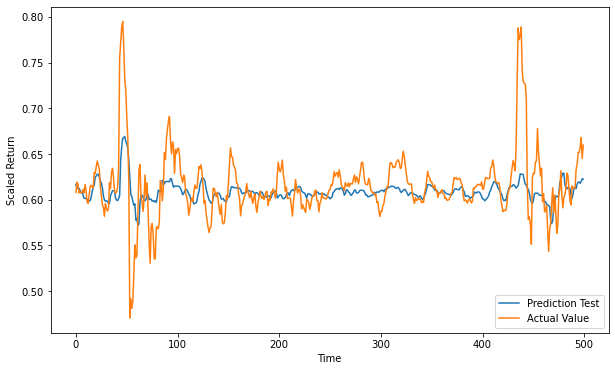


Results for $U4BF :
Train Error: 0.021967759879120252 Test Error: 0.024729805334049698

Results for $U4BH :
Train Error: 0.027624925405552146 Test Error: 0.025160744216387382

Results for $U4BJ :
Train Error: 0.02575429586365408 Test Error: 0.02693445563495381

Results for $U4BL :
Train Error: 0.02824653838070407 Test Error: 0.02784950452884326

Results for $U4BN :
Train Error: 0.029369878835976297 Test Error: 0.02672028212889592

Results for $U4DB :
Train Error: 0.03169129345396445 Test Error: 0.036943185361795916

Results for $U4DD :
Train Error: 0.024626144493008265 Test Error: 0.027221385318016166

Results for $U4FB :
Train Error: 0.015534500329233642 Test Error: 0.013876600641909589

Results for $U4FD :
Train Error: 0.028680983729598535 Test Error: 0.03710020084865279

Results for $U4FH :
Train Error: 0.026676267553979394 Test Error: 0.02597409186793479

Results for $U5BB :
Train Error: 0.032079478857194615 Test Error: 0.0303903015225735

Results for $U5BD :
Train Error: 0.027105

In [53]:
# make predictions and evaluate model 
rmse_train_CNN, rmse_test_CNN, rmse_max_CNN = pred_eval(model_CNN, 'CNN')

In [55]:
# manually check for number of parameters and epochs needed 
no_params_CNN = 43790
epochs_CNN = 186 #manually 

# display results 
CNN_results = np.array(['{:}'.format(no_params_CNN), '{:}'.format(epochs_CNN), round(time_needed_CNN/60,2), 
                        '{:.3e}'.format(rmse_train_CNN), '{:.3e}'.format(rmse_test_CNN), 
                        '{:.3e}'.format(rmse_max_CNN)])
CNN_results = CNN_results.reshape((1,6))
table_CNN = pd.DataFrame(CNN_results,index=['CNN'],
                         columns=['No. Parameters','No. Epochs','Time [m]','RMSE Train','RMSE Test','RMSE Max'])
table_CNN

,No. Parameters,No. Epochs,Time [m],RMSE Train,RMSE Test,RMSE Max
CNN,43790,186,26.5,2.531e-02,2.822e-02,6.853e-02


## CNN mit Dilation

In [56]:
# build model 
model_DilCNN = DilCNN_()

# fit model 
time_needed_DilCNN, history_DilCNN = train_model(model_DilCNN,'DilCNN')

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_1 (Conv1D)           (None, 22, 32)            25312     
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 11, 32)           0         
 1D)                                                             
                                                                 
 dropout_19 (Dropout)        (None, 11, 32)            0         
                                                                 
 flatten_2 (Flatten)         (None, 352)               0         
                                                                 
 dense_14 (Dense)            (None, 20)                7060      
                                                                 
 dropout_20 (Dropout)        (None, 20)                0         
                                                      

Epoch 28/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0012
Epoch 00028: val_loss did not improve from 0.00074
134/134 [==============================] - 9s 68ms/step - loss: 0.0012 - val_loss: 7.5045e-04
Epoch 29/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0012
Epoch 00029: val_loss did not improve from 0.00074
134/134 [==============================] - 9s 70ms/step - loss: 0.0012 - val_loss: 7.4649e-04
Epoch 30/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0011
Epoch 00030: val_loss did not improve from 0.00074
134/134 [==============================] - 10s 75ms/step - loss: 0.0011 - val_loss: 7.4704e-04
Epoch 31/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0011
Epoch 00031: val_loss did not improve from 0.00074
134/134 [==============================] - 9s 70ms/step - loss: 0.0011 - val_loss: 7.4586e-04
Epoch 32/1000
133/134 [============================>.] - ETA: 0s - loss: 0.0011
Epoch 00032: val_lo

133/134 [============================>.] - ETA: 0s - loss: 8.4131e-04
Epoch 00063: val_loss did not improve from 0.00074
134/134 [==============================] - 9s 67ms/step - loss: 8.4053e-04 - val_loss: 7.4452e-04
Epoch 64/1000
133/134 [============================>.] - ETA: 0s - loss: 8.4111e-04
Epoch 00064: val_loss did not improve from 0.00074
134/134 [==============================] - 10s 73ms/step - loss: 8.4033e-04 - val_loss: 7.4466e-04
Epoch 65/1000
133/134 [============================>.] - ETA: 0s - loss: 8.4114e-04
Epoch 00065: val_loss did not improve from 0.00074
134/134 [==============================] - 9s 68ms/step - loss: 8.4036e-04 - val_loss: 7.4468e-04
Epoch 66/1000
133/134 [============================>.] - ETA: 0s - loss: 8.4093e-04
Epoch 00066: val_loss did not improve from 0.00074
134/134 [==============================] - 10s 75ms/step - loss: 8.4015e-04 - val_loss: 7.4464e-04
Epoch 67/1000
133/134 [============================>.] - ETA: 0s - loss: 8.4086e

133/134 [============================>.] - ETA: 0s - loss: 8.4003e-04
Epoch 00098: val_loss did not improve from 0.00074
134/134 [==============================] - 8s 60ms/step - loss: 8.3925e-04 - val_loss: 7.4452e-04
Epoch 99/1000
133/134 [============================>.] - ETA: 0s - loss: 8.4003e-04
Epoch 00099: val_loss did not improve from 0.00074
134/134 [==============================] - 8s 61ms/step - loss: 8.3925e-04 - val_loss: 7.4452e-04
Epoch 100/1000
133/134 [============================>.] - ETA: 0s - loss: 8.4003e-04
Epoch 00100: val_loss did not improve from 0.00074
134/134 [==============================] - 9s 67ms/step - loss: 8.3925e-04 - val_loss: 7.4452e-04
Epoch 101/1000
133/134 [============================>.] - ETA: 0s - loss: 8.4003e-04
Epoch 00101: val_loss did not improve from 0.00074
134/134 [==============================] - 9s 66ms/step - loss: 8.3925e-04 - val_loss: 7.4452e-04
Epoch 102/1000
133/134 [============================>.] - ETA: 0s - loss: 8.4003

459/459 [==============================] - 2s 3ms/step

Results for AAPL :
Train Error: 0.03168777897256429 Test Error: 0.03571920173507288


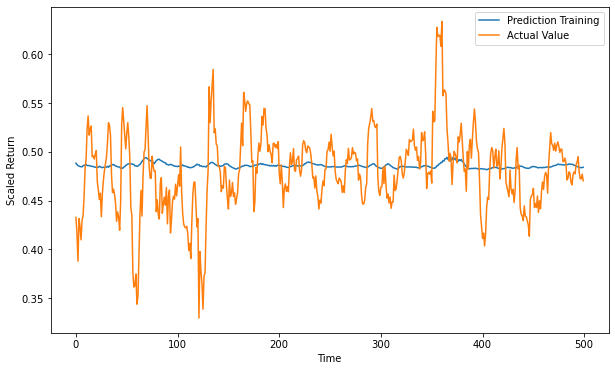

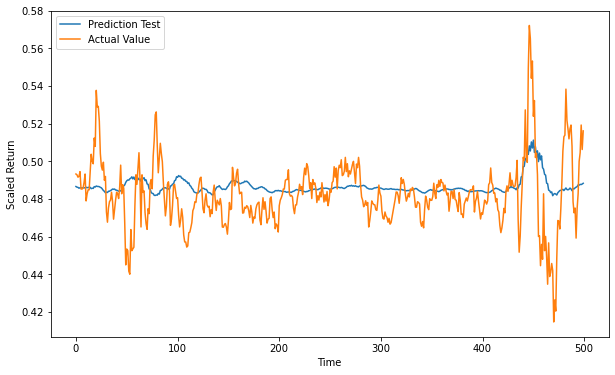


Results for ADBE :
Train Error: 0.02617991817860778 Test Error: 0.0468448421284895


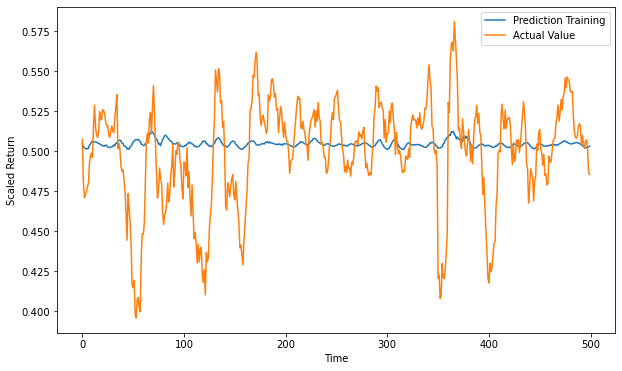

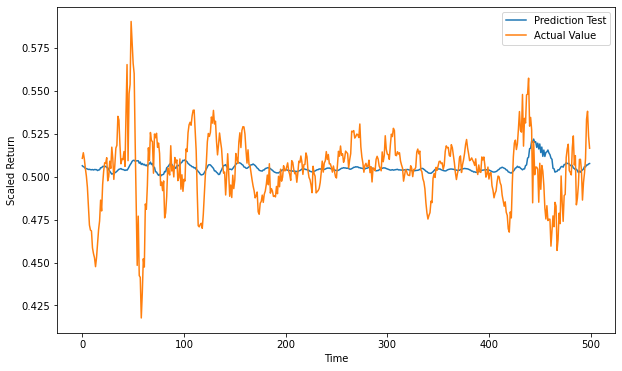


Results for ADI :
Train Error: 0.036461126211485756 Test Error: 0.03429885879947666


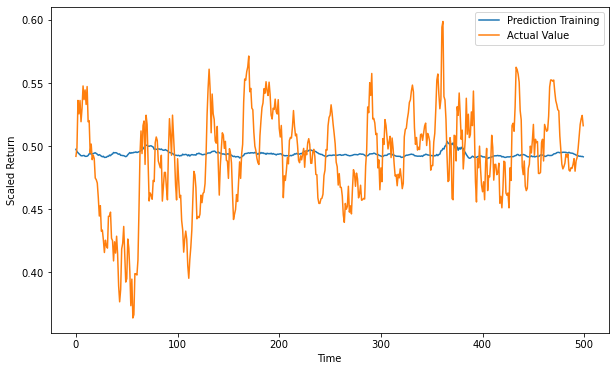

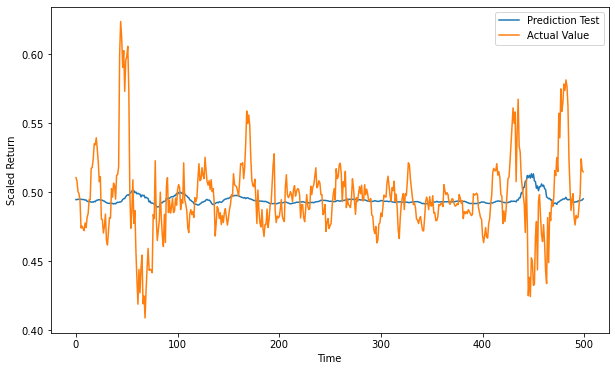


Results for ADP :
Train Error: 0.02598803808809338 Test Error: 0.02691653209365043


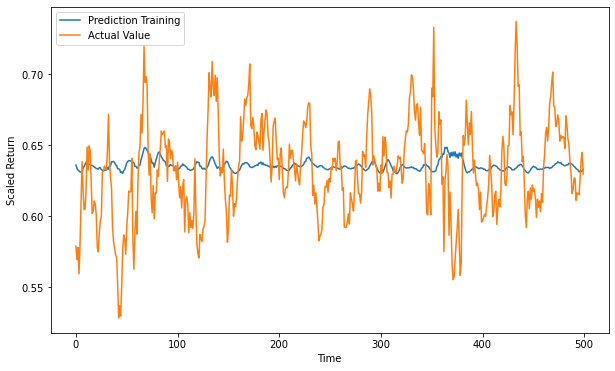

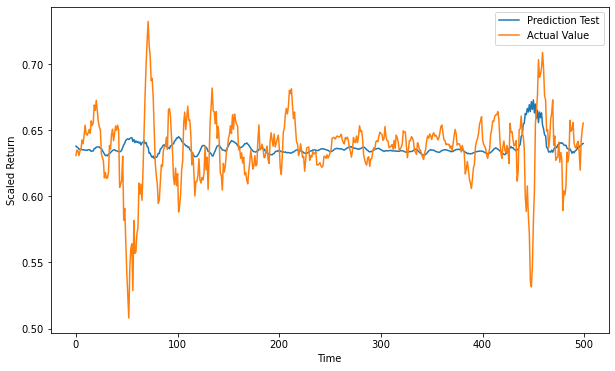


Results for ADSK :
Train Error: 0.020940427640055343 Test Error: 0.0380531659750108


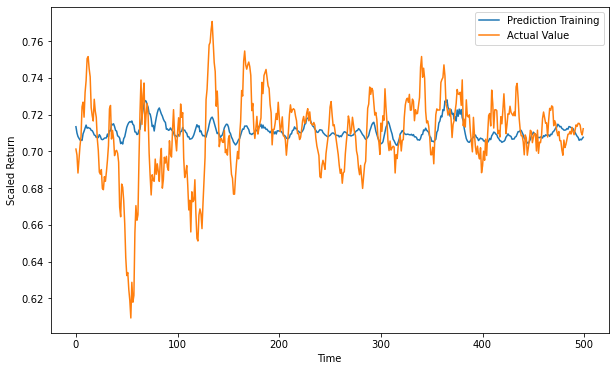

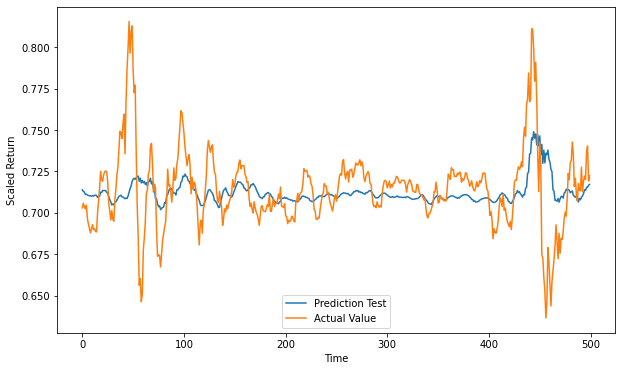


Results for AEP :
Train Error: 0.034773926374553156 Test Error: 0.03332046771966557


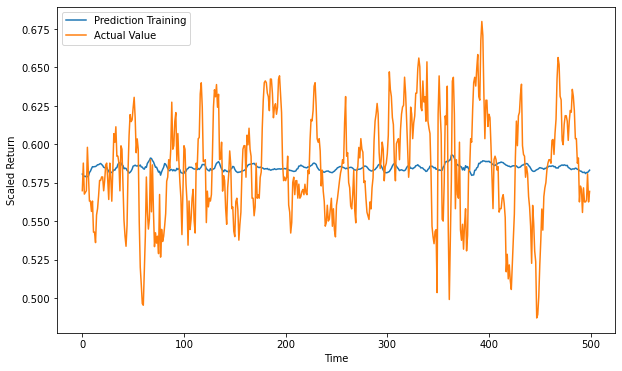

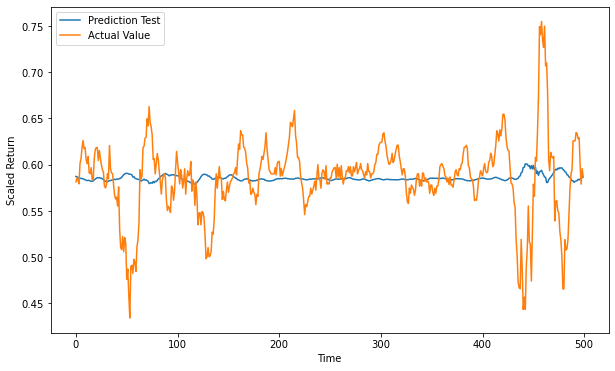


Results for ALGN :
Train Error: 0.01904010640771413 Test Error: 0.017106838575948084


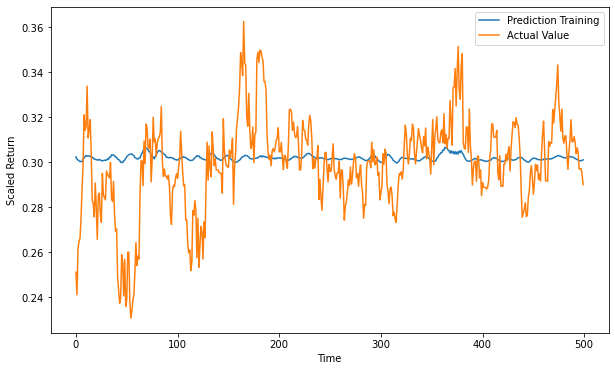

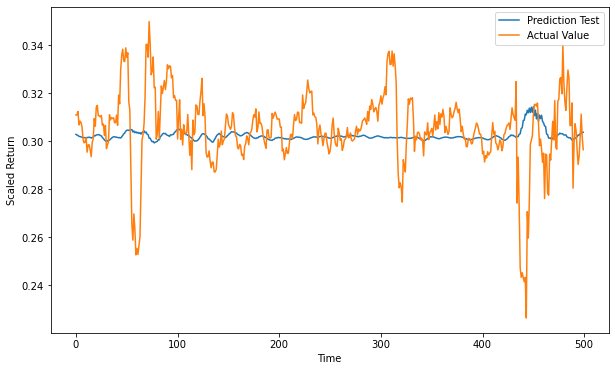


Results for AMAT :
Train Error: 0.026228286801123973 Test Error: 0.024807798823375173


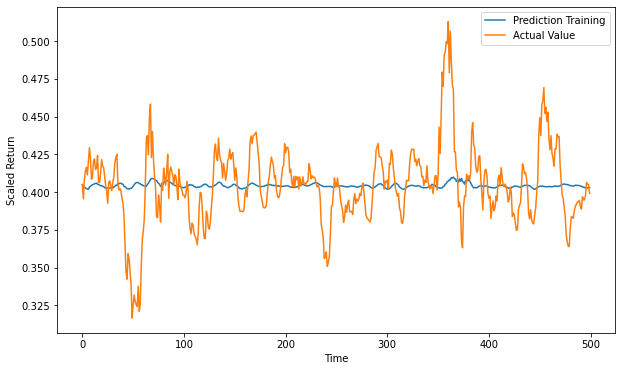

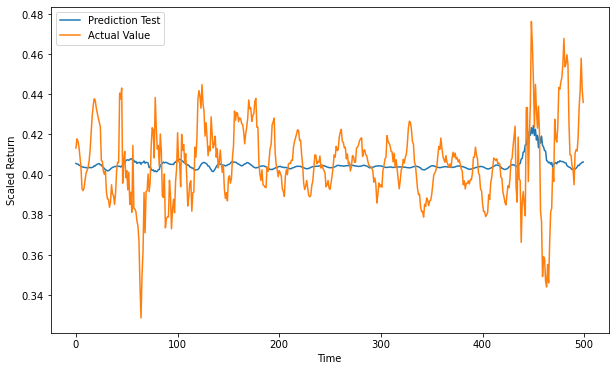


Results for AMD :
Train Error: 0.027957240329103624 Test Error: 0.037763594220206254


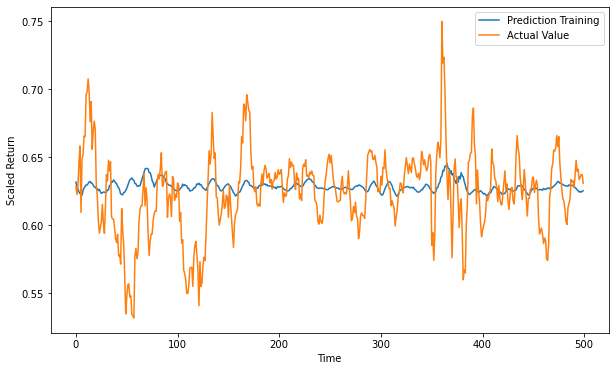

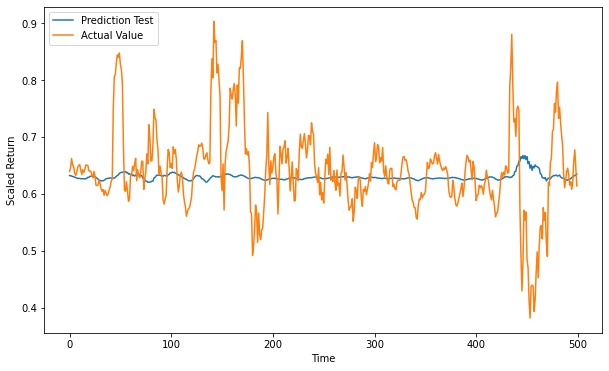


Results for AMGN :
Train Error: 0.014411069676771991 Test Error: 0.01477314122693641


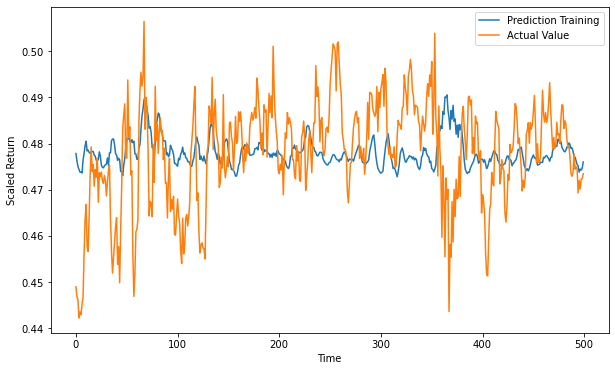

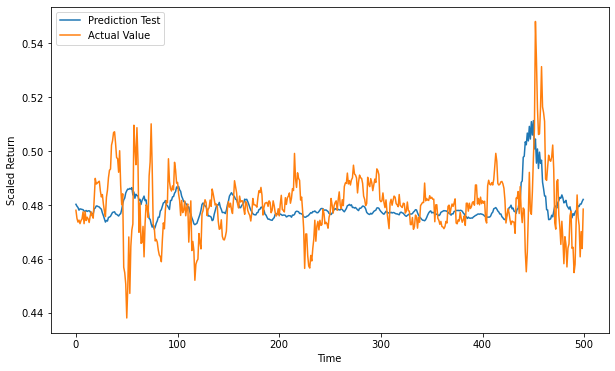


Results for AMZN :
Train Error: 0.021518460425987596 Test Error: 0.023081291655097636

Results for ANSS :
Train Error: 0.02427260247523999 Test Error: 0.024812243850258403

Results for ASML :
Train Error: 0.030939106588525493 Test Error: 0.032625576271220987

Results for ATVI :
Train Error: 0.012261797549850665 Test Error: 0.012303221038667923

Results for AVGO :
Train Error: 0.03564889759171938 Test Error: 0.04421360037716339

Results for BIDU :
Train Error: 0.029763019478363437 Test Error: 0.02486779986268051

Results for BIIB :
Train Error: 0.010060709586870508 Test Error: 0.006772044829179264

Results for BKNG :
Train Error: 0.03121292314239946 Test Error: 0.043598171701695526

Results for CDNS :
Train Error: 0.024282357418726926 Test Error: 0.026963002728453696

Results for CDW :
Train Error: 0.02173010696605234 Test Error: 0.02291483708738926

Results for CERN :
Train Error: 0.019716326548477933 Test Error: 0.03936613849067074

Results for CHKP :
Train Error: 0.01873957644096283

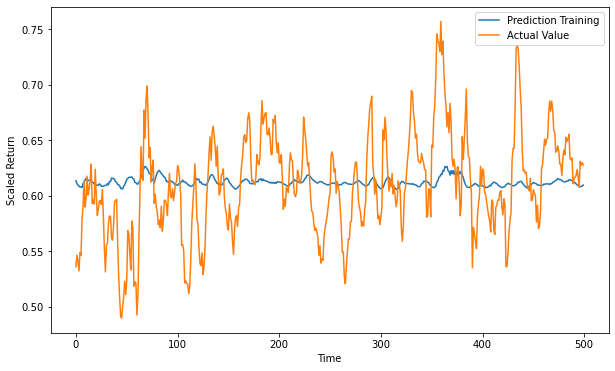

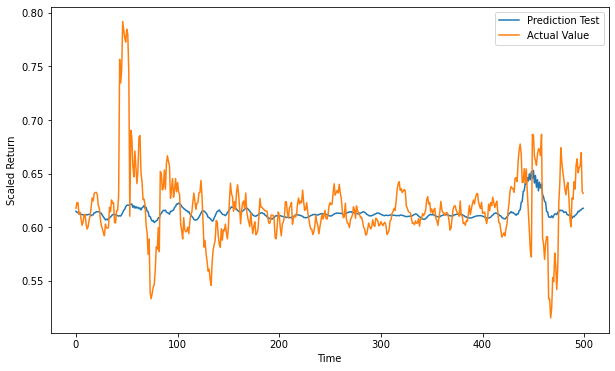


Results for $U0BB :
Train Error: 0.023328533219242508 Test Error: 0.026249066641457038


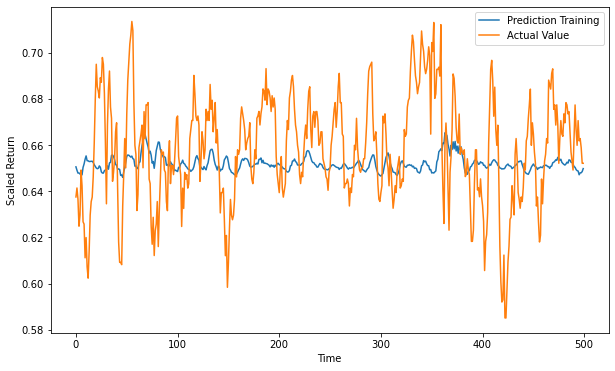

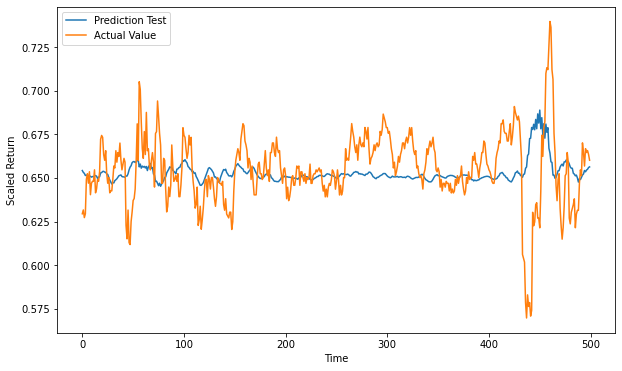


Results for $U0BD :
Train Error: 0.019944383358356105 Test Error: 0.02031767675963499


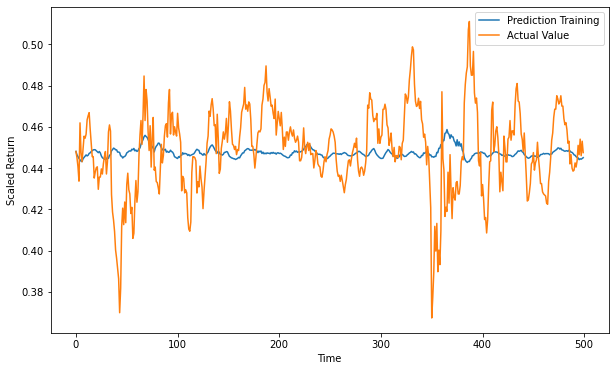

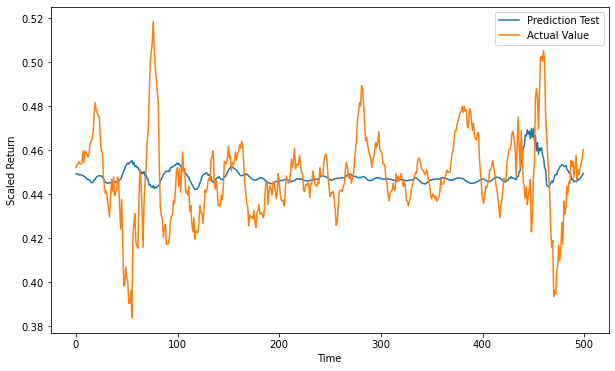


Results for $U2BB :
Train Error: 0.045424983947724144 Test Error: 0.04698492696037392


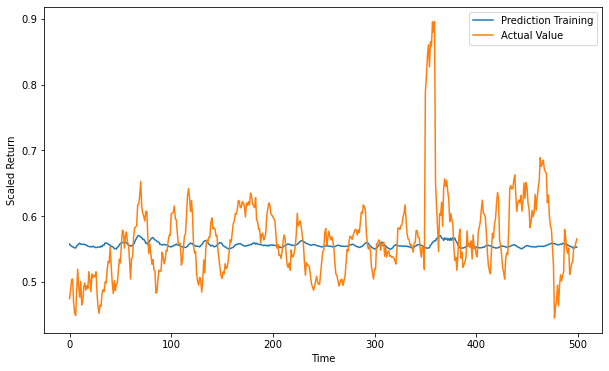

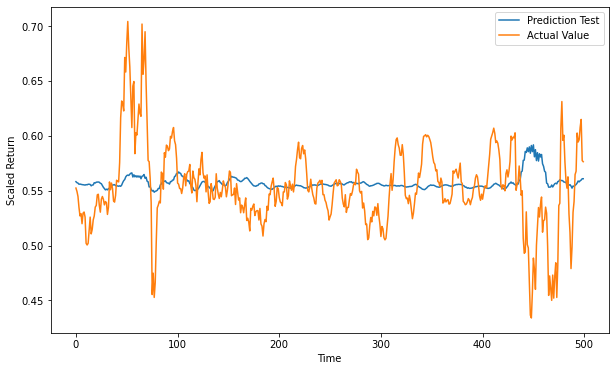


Results for $U2BD :
Train Error: 0.045133555180557366 Test Error: 0.047479571628085256


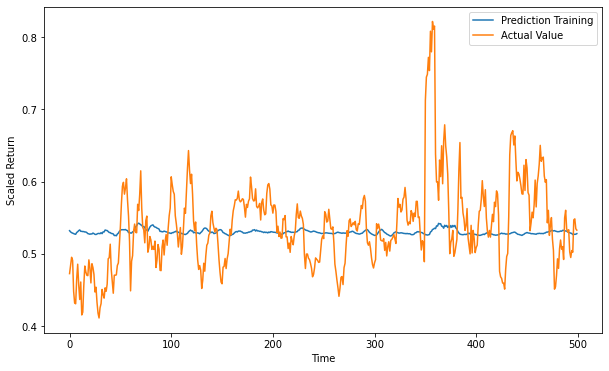

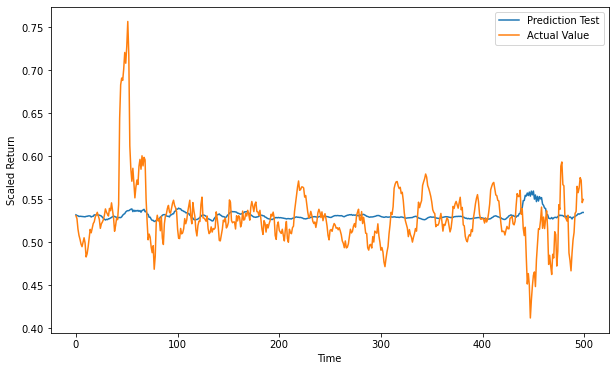


Results for $U3BD :
Train Error: 0.02246854389230515 Test Error: 0.022841643931394127


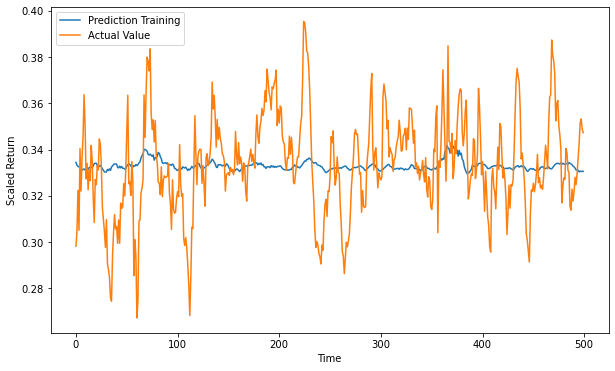

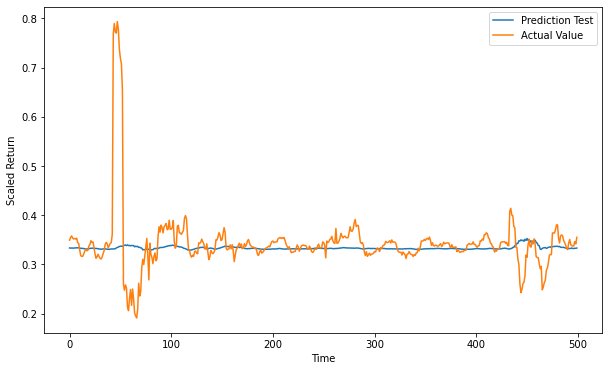


Results for $U3BF :
Train Error: 0.039074226821919786 Test Error: 0.04083605255732587


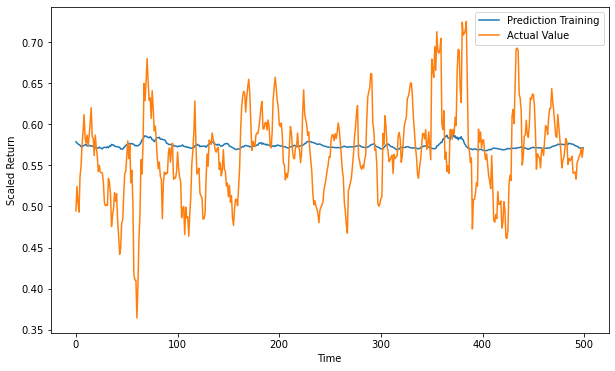

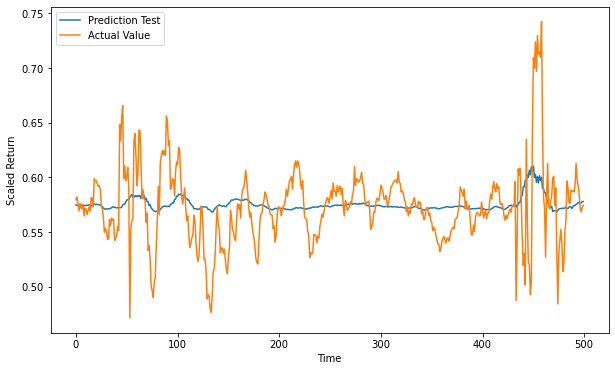


Results for $U3BH :
Train Error: 0.03721073677036995 Test Error: 0.03842223385160939


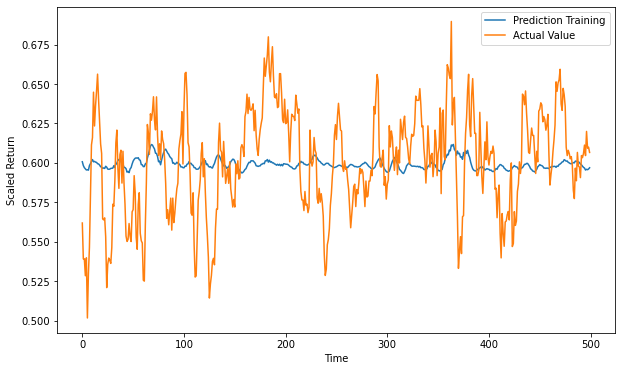

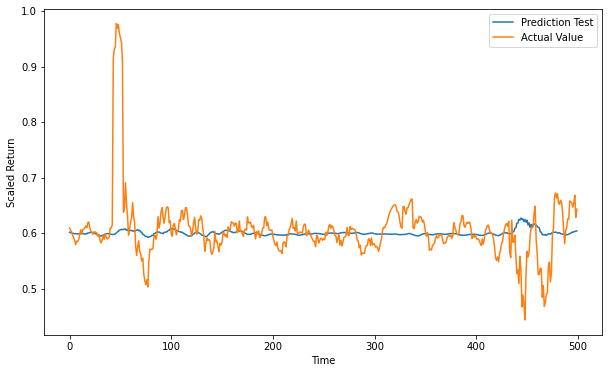


Results for $U4BB :
Train Error: 0.03603918567472284 Test Error: 0.040305676025330944


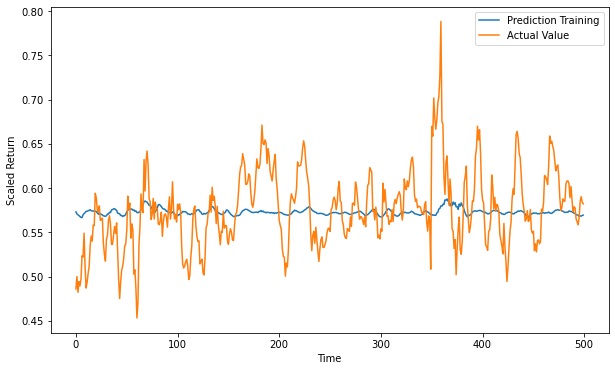

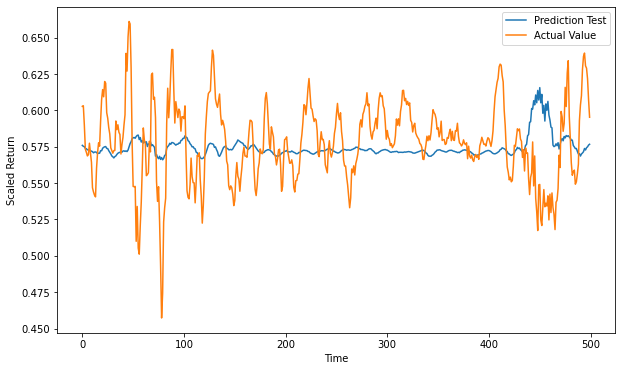


Results for $U4BD :
Train Error: 0.02955401556708711 Test Error: 0.02921386909061817


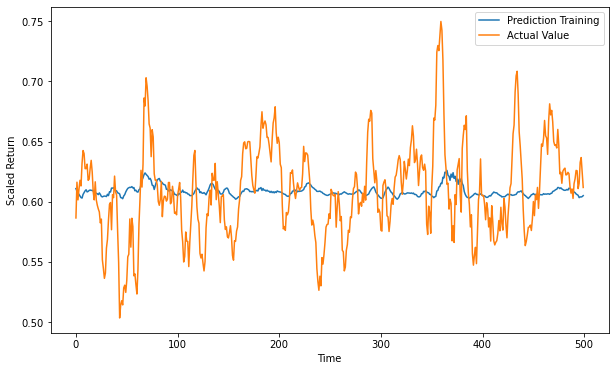

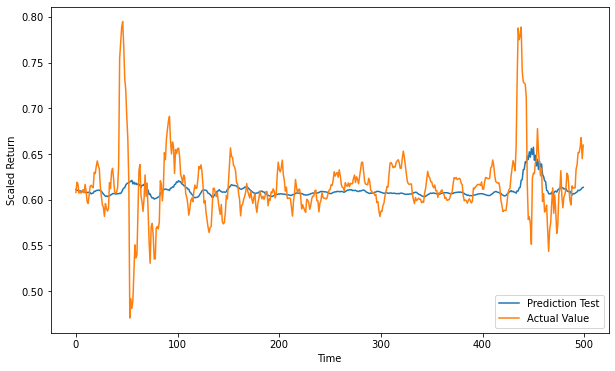


Results for $U4BF :
Train Error: 0.024057946435439213 Test Error: 0.02873068680022554

Results for $U4BH :
Train Error: 0.03235473631117226 Test Error: 0.03200089153931358

Results for $U4BJ :
Train Error: 0.028393385263831533 Test Error: 0.029884151032403827

Results for $U4BL :
Train Error: 0.032817249370242274 Test Error: 0.03356989672747764

Results for $U4BN :
Train Error: 0.03400652720048075 Test Error: 0.03299201063807763

Results for $U4DB :
Train Error: 0.03702293055213655 Test Error: 0.044738200264915734

Results for $U4DD :
Train Error: 0.028684196349857992 Test Error: 0.03344251083760124

Results for $U4FB :
Train Error: 0.01647583536042408 Test Error: 0.015179862506723561

Results for $U4FD :
Train Error: 0.030574190228009716 Test Error: 0.03844245157615387

Results for $U4FH :
Train Error: 0.029824359517119193 Test Error: 0.03015235986594952

Results for $U5BB :
Train Error: 0.035857239585270005 Test Error: 0.03533260078214626

Results for $U5BD :
Train Error: 0.02886962

In [57]:
# make predictions and evaluate model 
rmse_train_DilCNN, rmse_test_DilCNN, rmse_max_DilCNN = pred_eval(model_DilCNN, 'DilCNN')

In [58]:
# manually check for number of parameters and epochs needed 
no_params_DilCNN = 42510
epochs_DilCNN = 113 #manually 

# display results 
DilCNN_results = np.array(['{:}'.format(no_params_DilCNN), '{:}'.format(epochs_DilCNN), round(time_needed_DilCNN/60,2), 
                        '{:.3e}'.format(rmse_train_DilCNN), '{:.3e}'.format(rmse_test_DilCNN), 
                        '{:.3e}'.format(rmse_max_DilCNN)])
DilCNN_results = DilCNN_results.reshape((1,6))
table_DilCNN = pd.DataFrame(DilCNN_results,index=['CNN+Dilation'],
                         columns=['No. Parameters','No. Epochs','Time [m]','RMSE Train','RMSE Test','RMSE Max'])
table_DilCNN

,No. Parameters,No. Epochs,Time [m],RMSE Train,RMSE Test,RMSE Max
CNN+Dilation,42510,113,17.6,2.749e-02,3.076e-02,6.792e-02


## Transformer

In [61]:
# build model 
model_Transformer = Transformer()

# reduce max_epochs because of complexity of training 
max_epochs = 50

# increase batch size to allow for more updates
batch_size = 64 

# adapt early stopping for more complex model 
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=25, min_delta=5e-7, restore_best_weights=True)

# fit model 
time_needed_Transformer, history_Transformer = train_model(model_Transformer,'Transformer')

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 30, 158)]    0           []                               
                                                                                                  
 time2_vector_2 (Time2Vector)   (None, 30, 2)        120         ['input_3[0][0]']                
                                                                                                  
 concatenate_2 (Concatenate)    (None, 30, 160)      0           ['input_3[0][0]',                
                                                                  'time2_vector_2[0][0]']         
                                                                                                  
 layer_normalization_16 (LayerN  (None, 30, 160)     320         ['concatenate_2[0][0]']    

Epoch 1/50
1043/1043 [==============================] - ETA: 0s - loss: 0.0080
Epoch 00001: val_loss improved from inf to 0.00088, saving model to best_model_Transformer.h5
1043/1043 [==============================] - 2088s 2s/step - loss: 0.0080 - val_loss: 8.8322e-04
Epoch 2/50
1043/1043 [==============================] - ETA: 0s - loss: 0.0017
Epoch 00002: val_loss improved from 0.00088 to 0.00068, saving model to best_model_Transformer.h5
1043/1043 [==============================] - 2053s 2s/step - loss: 0.0017 - val_loss: 6.7812e-04
Epoch 3/50
1043/1043 [==============================] - ETA: 0s - loss: 0.0013
Epoch 00003: val_loss did not improve from 0.00068
1043/1043 [==============================] - 2050s 2s/step - loss: 0.0013 - val_loss: 7.0231e-04
Epoch 4/50
1043/1043 [==============================] - ETA: 0s - loss: 0.0011
Epoch 00004: val_loss did not improve from 0.00068
1043/1043 [==============================] - 2052s 2s/step - loss: 0.0011 - val_loss: 6.8702e-04
Ep

Epoch 34/50
1043/1043 [==============================] - ETA: 0s - loss: 8.4322e-04
Epoch 00034: val_loss did not improve from 0.00050
1043/1043 [==============================] - 2155s 2s/step - loss: 8.4322e-04 - val_loss: 7.4684e-04
Epoch 35/50
1043/1043 [==============================] - ETA: 0s - loss: 8.4322e-04
Epoch 00035: val_loss did not improve from 0.00050
1043/1043 [==============================] - 2010s 2s/step - loss: 8.4322e-04 - val_loss: 7.4684e-04
Epoch 36/50
1043/1043 [==============================] - ETA: 0s - loss: 8.4322e-04
Epoch 00036: val_loss did not improve from 0.00050
1043/1043 [==============================] - 2049s 2s/step - loss: 8.4322e-04 - val_loss: 7.4684e-04
Epoch 37/50
1043/1043 [==============================] - ETA: 0s - loss: 8.4322e-04
Epoch 00037: val_loss did not improve from 0.00050
1043/1043 [==============================] - 2024s 2s/step - loss: 8.4322e-04 - val_loss: 7.4684e-04
Epoch 38/50
1043/1043 [==============================] -

459/459 [==============================] - 150s 327ms/step

Results for AAPL :
Train Error: 0.024398905935752294 Test Error: 0.03162832717437958


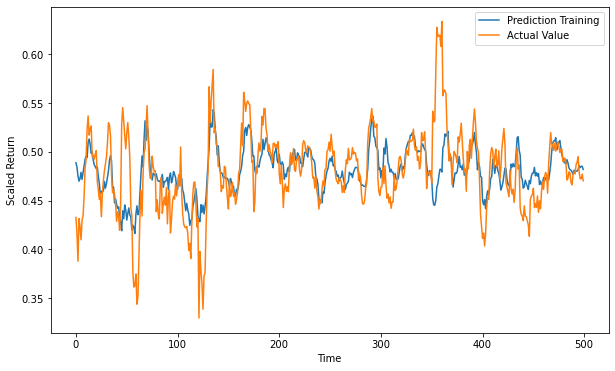

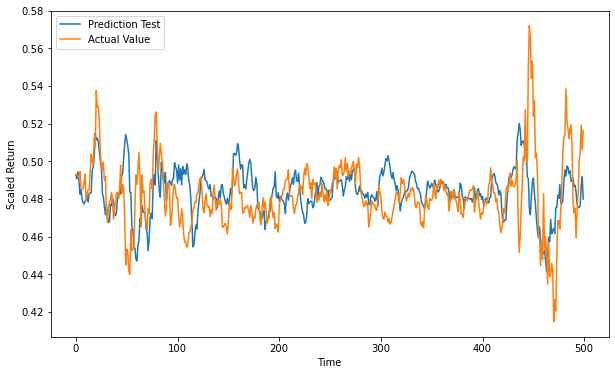


Results for ADBE :
Train Error: 0.01866830577273448 Test Error: 0.04006871598963339


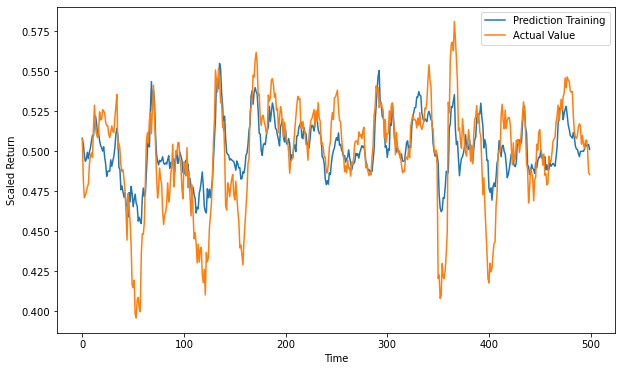

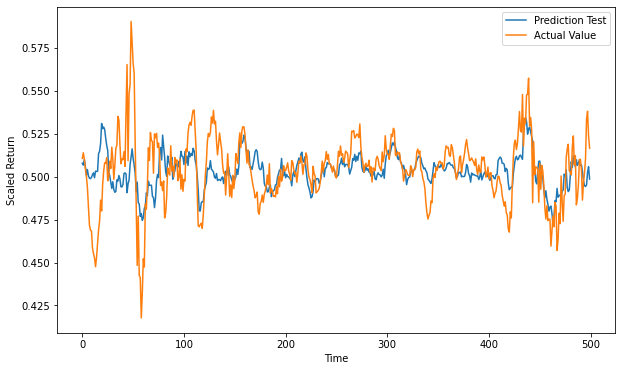


Results for ADI :
Train Error: 0.026778429444595443 Test Error: 0.027314749839855736


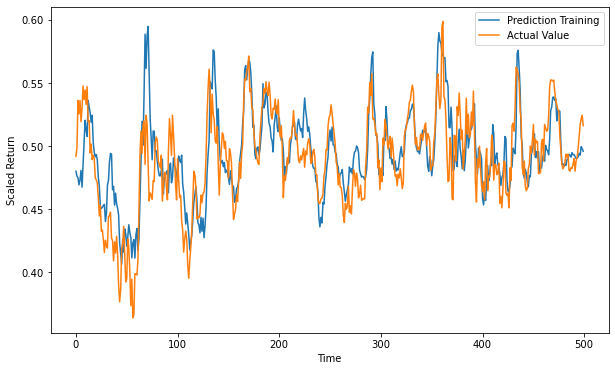

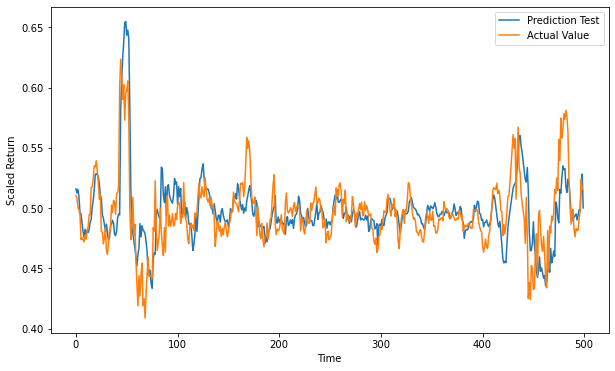


Results for ADP :
Train Error: 0.02278982047885732 Test Error: 0.02408729395854757


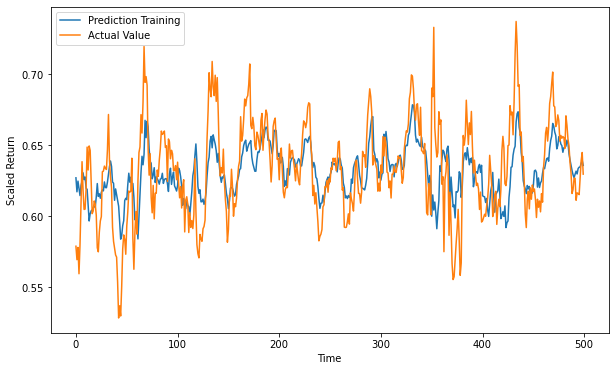

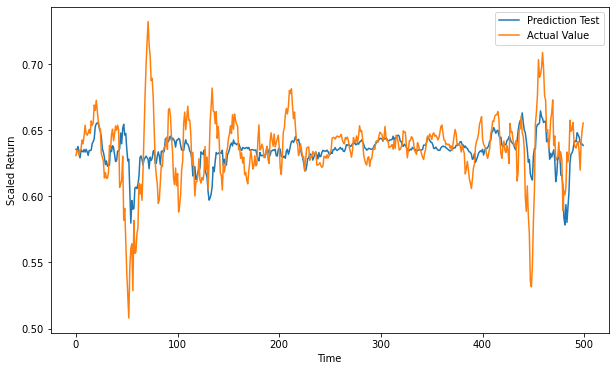


Results for ADSK :
Train Error: 0.016925233935519535 Test Error: 0.03445659952601958


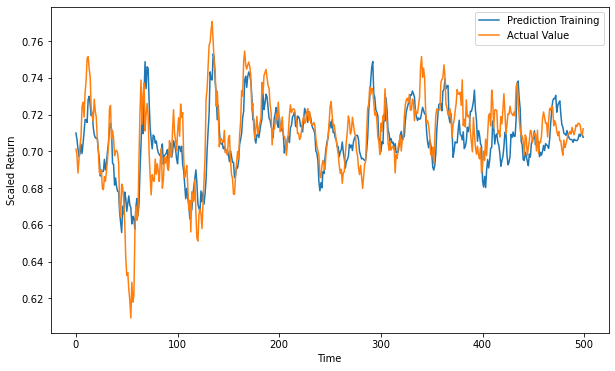

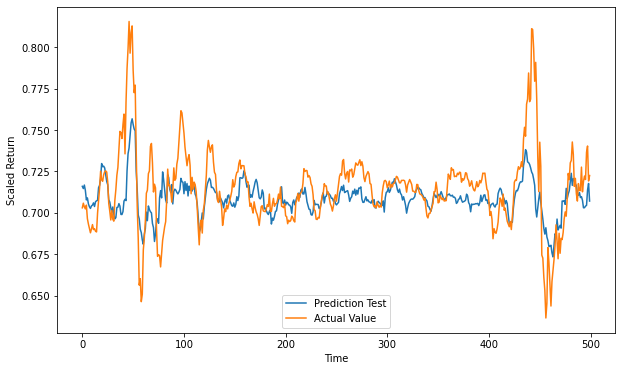


Results for AEP :
Train Error: 0.025553844461571086 Test Error: 0.023563587301830554


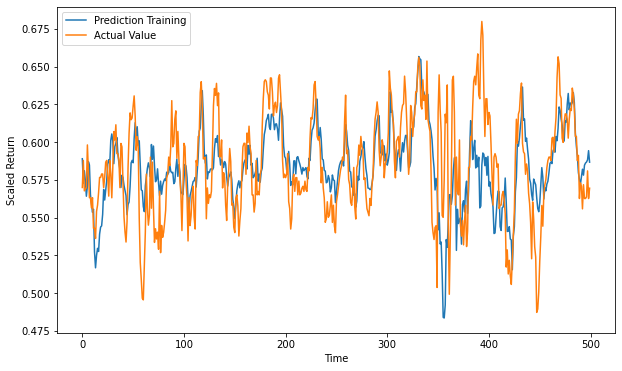

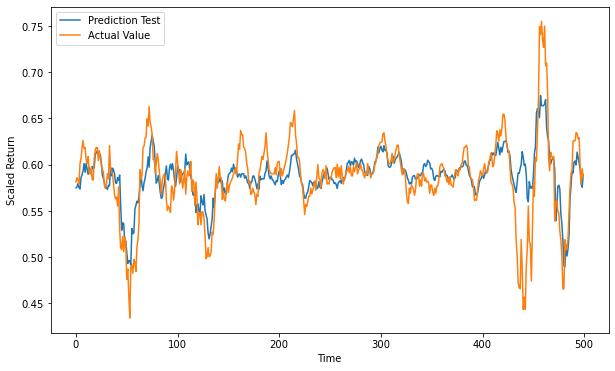


Results for ALGN :
Train Error: 0.01706670981794127 Test Error: 0.015470651657696463


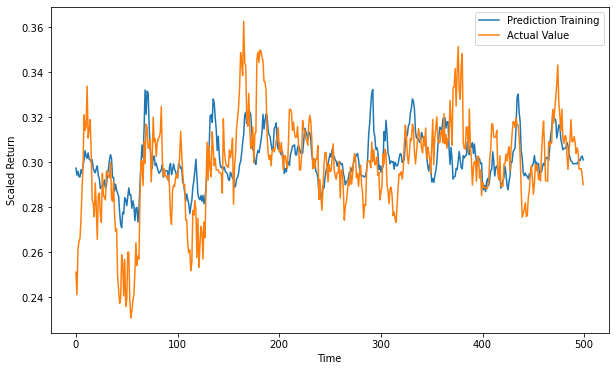

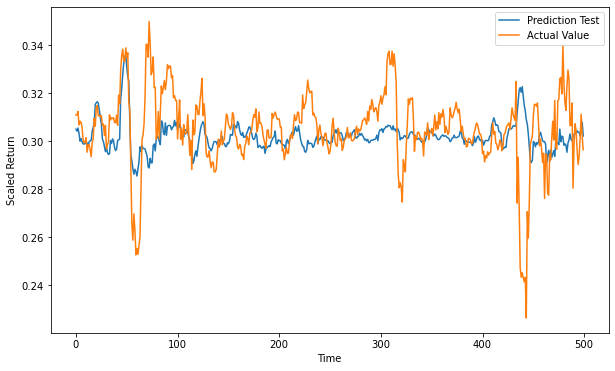


Results for AMAT :
Train Error: 0.01961301772339835 Test Error: 0.01974833019001713


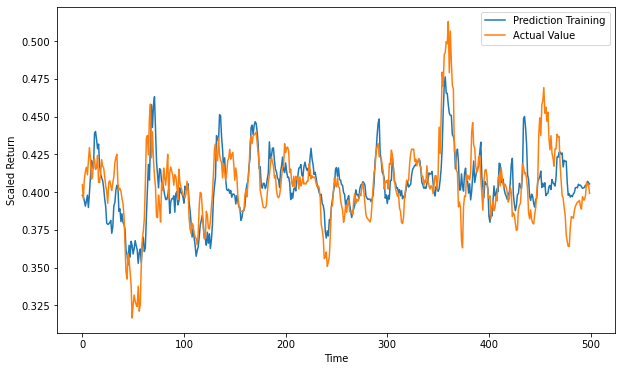

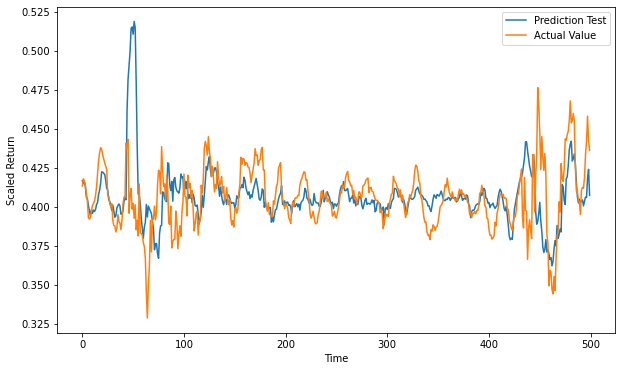


Results for AMD :
Train Error: 0.02226820898221859 Test Error: 0.030302964118850344


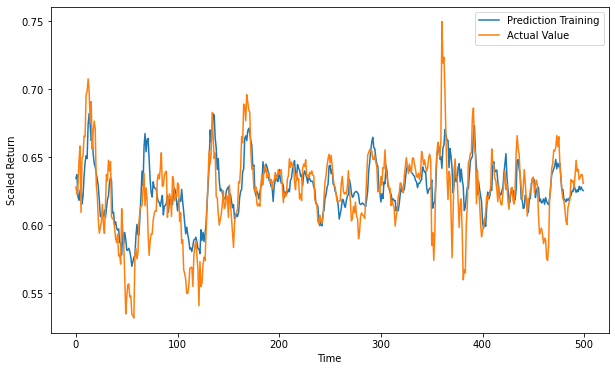

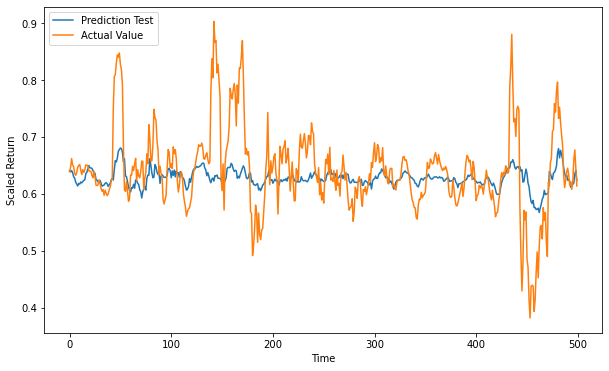


Results for AMGN :
Train Error: 0.013222126839340891 Test Error: 0.013941905008966225


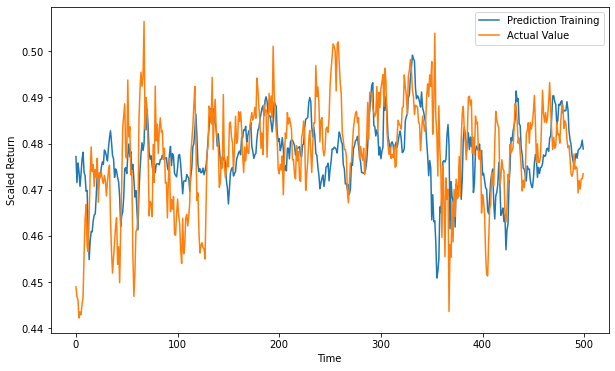

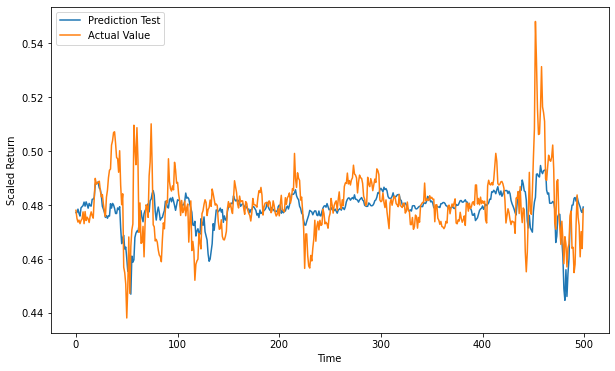


Results for AMZN :
Train Error: 0.018208421981321717 Test Error: 0.01995831406169982

Results for ANSS :
Train Error: 0.019041389505566608 Test Error: 0.02000951287343962

Results for ASML :
Train Error: 0.023594031329913123 Test Error: 0.02522498928814719

Results for ATVI :
Train Error: 0.011988158863564968 Test Error: 0.011675227488773908

Results for AVGO :
Train Error: 0.025726800497405236 Test Error: 0.03784869963146851

Results for BIDU :
Train Error: 0.026821420244434166 Test Error: 0.023242240657849033

Results for BIIB :
Train Error: 0.010089042186832214 Test Error: 0.006812056336721002

Results for BKNG :
Train Error: 0.027547003486124894 Test Error: 0.03815336133910177

Results for CDNS :
Train Error: 0.018245337096055986 Test Error: 0.020191212318436454

Results for CDW :
Train Error: 0.018875211005077663 Test Error: 0.01910304709763127

Results for CERN :
Train Error: 0.018269369234895815 Test Error: 0.03858265311606058

Results for CHKP :
Train Error: 0.0176544532065422

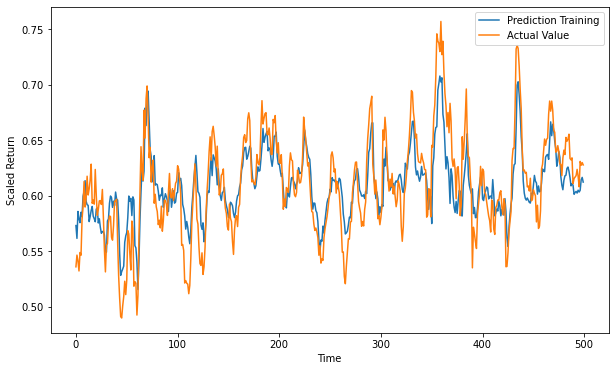

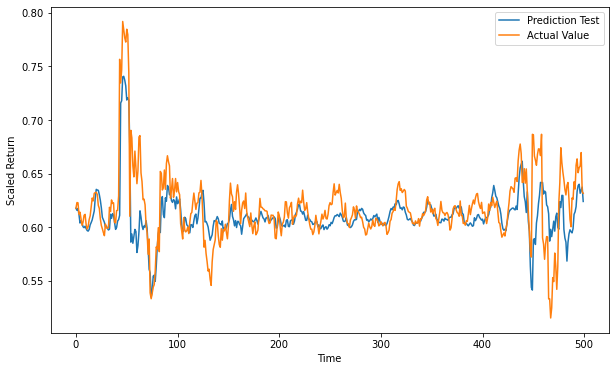


Results for $U0BB :
Train Error: 0.01967502991624969 Test Error: 0.0228744321740802


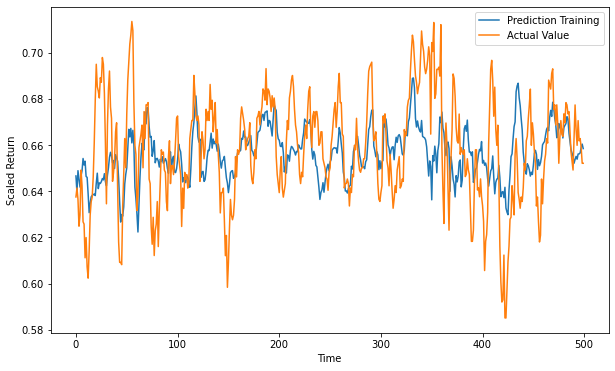

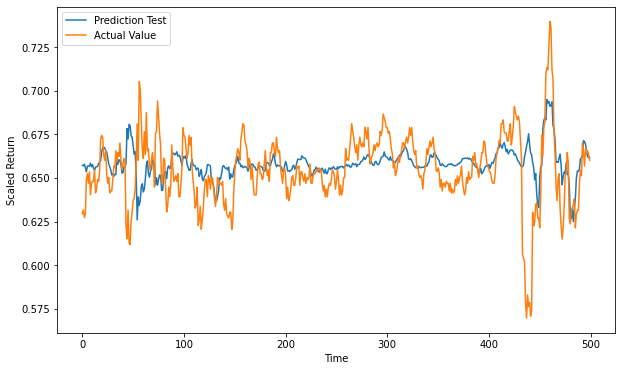


Results for $U0BD :
Train Error: 0.018657543047100017 Test Error: 0.019537060469398845


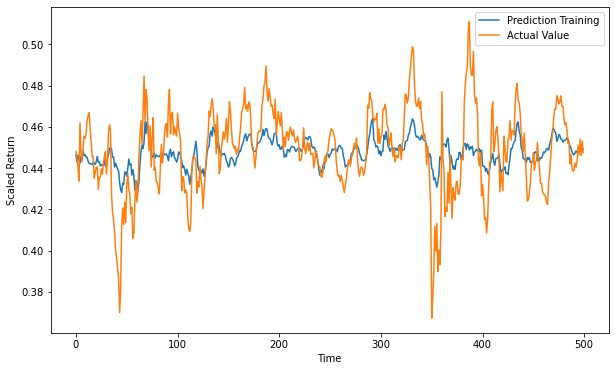

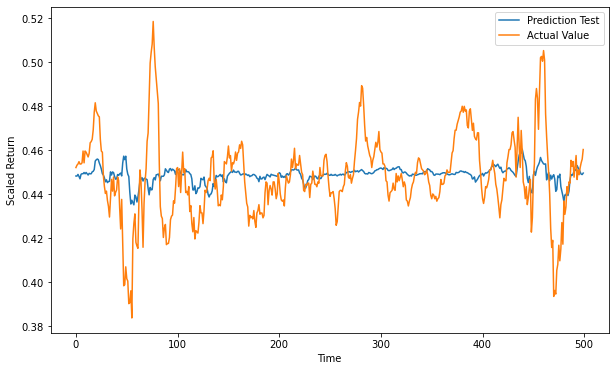


Results for $U2BB :
Train Error: 0.03445170443003069 Test Error: 0.03776955164705989


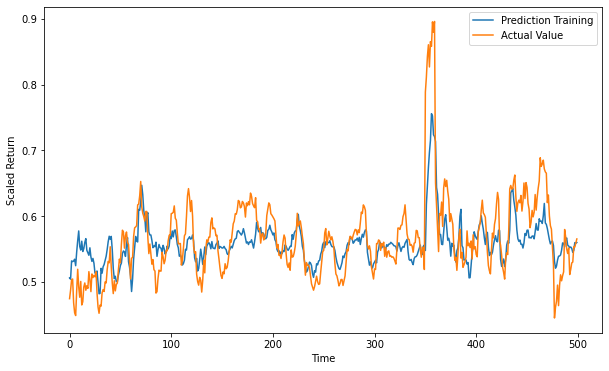

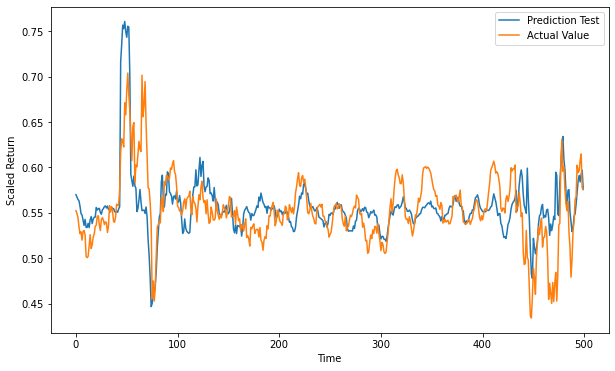


Results for $U2BD :
Train Error: 0.034679031640039173 Test Error: 0.03713062820153103


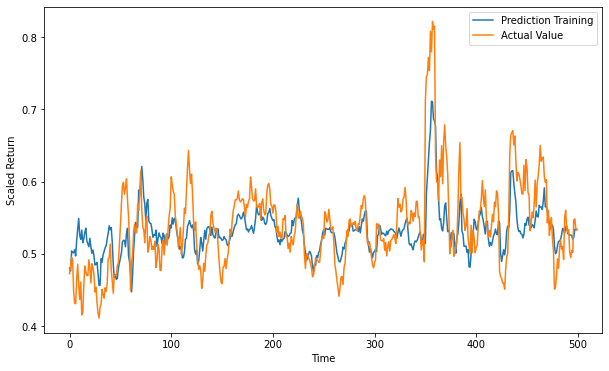

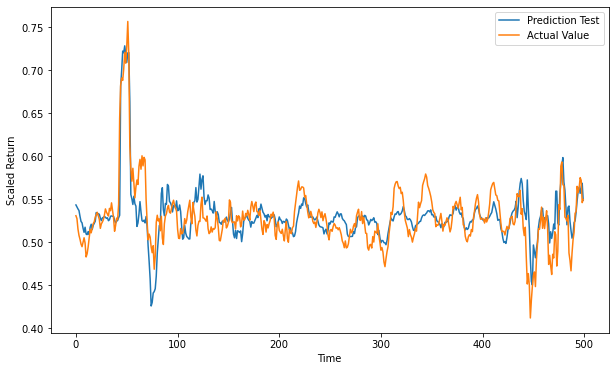


Results for $U3BD :
Train Error: 0.018869596493558717 Test Error: 0.019137344573454007


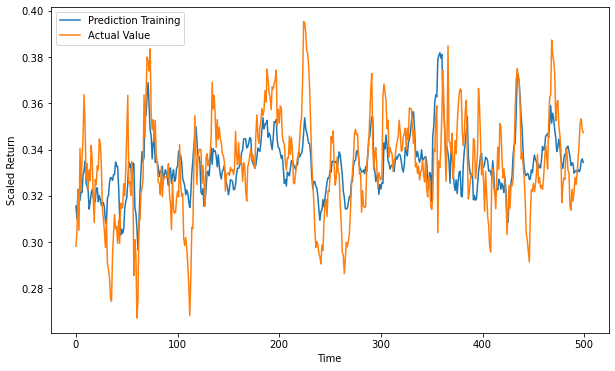

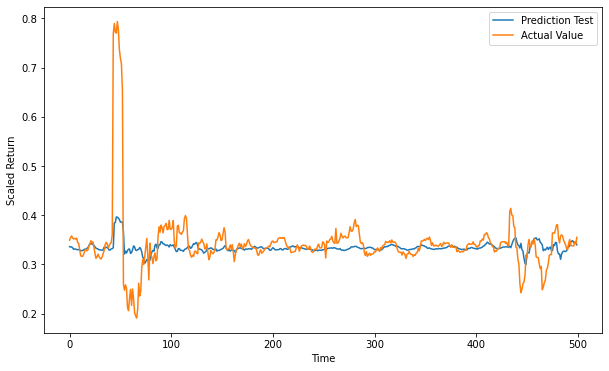


Results for $U3BF :
Train Error: 0.031013161238777974 Test Error: 0.030803930619862273


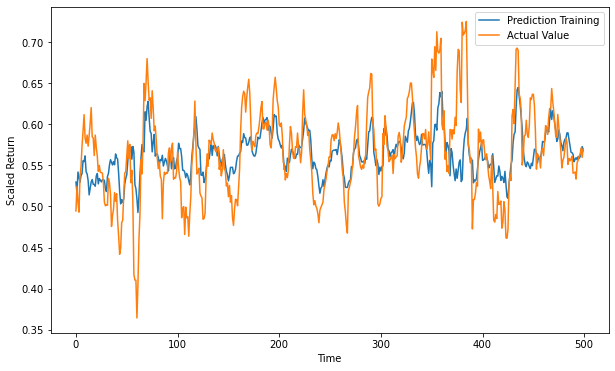

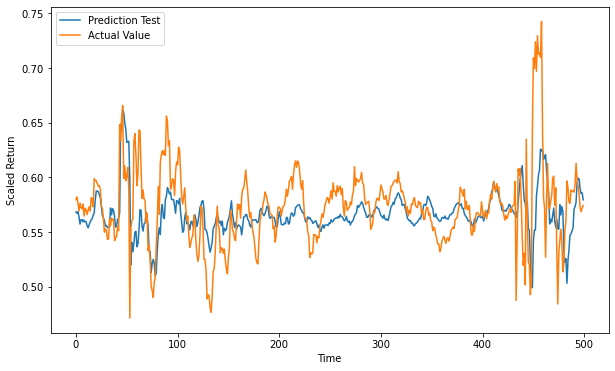


Results for $U3BH :
Train Error: 0.030352643615228554 Test Error: 0.032063878779505145


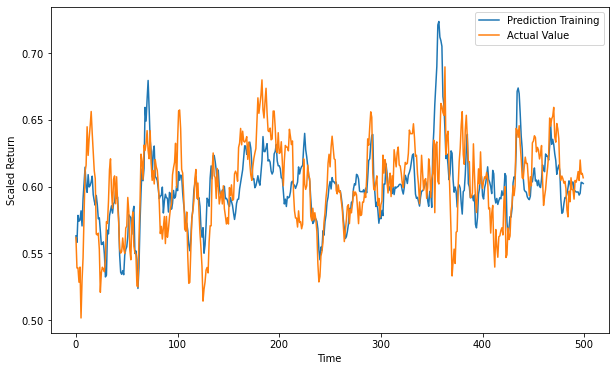

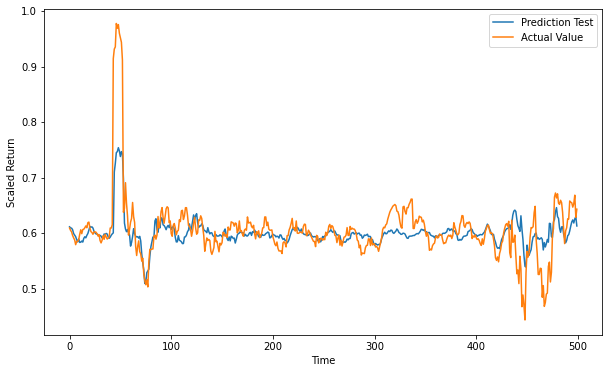


Results for $U4BB :
Train Error: 0.02605955831856212 Test Error: 0.030357104135761915


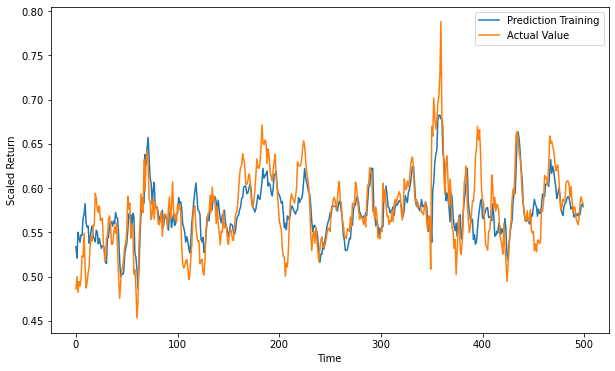

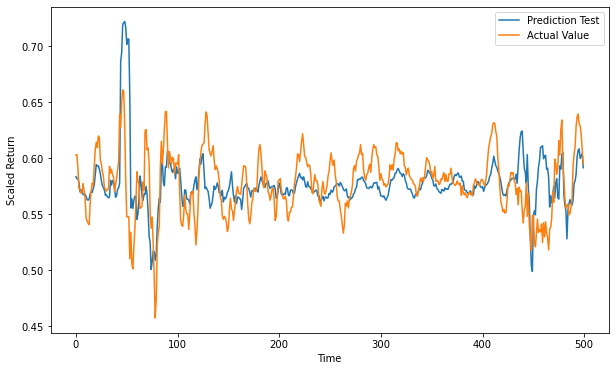


Results for $U4BD :
Train Error: 0.02174657304912383 Test Error: 0.022109605673445675


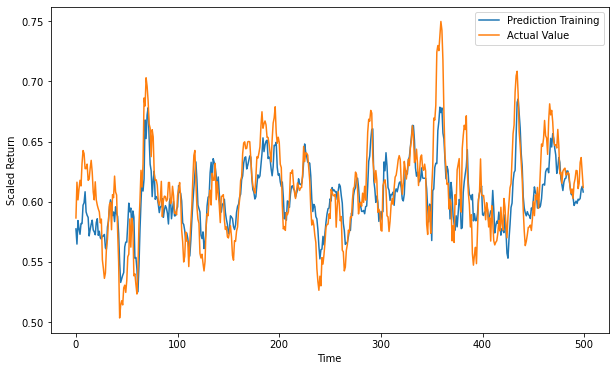

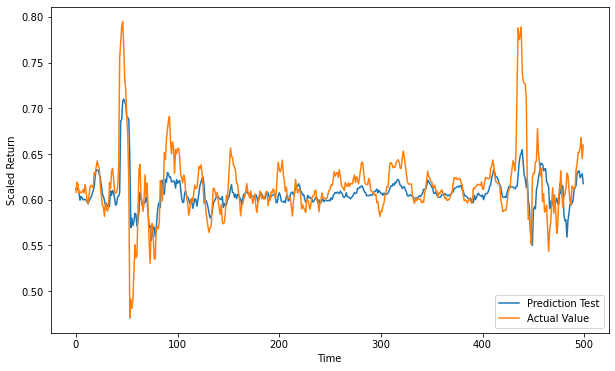


Results for $U4BF :
Train Error: 0.021821692489870603 Test Error: 0.02505648753855641

Results for $U4BH :
Train Error: 0.02349701145661835 Test Error: 0.023087289181057007

Results for $U4BJ :
Train Error: 0.021346220967426412 Test Error: 0.022426123820011256

Results for $U4BL :
Train Error: 0.021725412397834022 Test Error: 0.022887466693431252

Results for $U4BN :
Train Error: 0.02554666546391618 Test Error: 0.023901880663060104

Results for $U4DB :
Train Error: 0.027108717663362522 Test Error: 0.03243597384874156

Results for $U4DD :
Train Error: 0.022090832603923402 Test Error: 0.02463568111137264

Results for $U4FB :
Train Error: 0.015043036314514244 Test Error: 0.013964452100852958

Results for $U4FD :
Train Error: 0.025220035772131437 Test Error: 0.031986751481473404

Results for $U4FH :
Train Error: 0.023852626463680863 Test Error: 0.02237110345607425

Results for $U5BB :
Train Error: 0.027776449057865416 Test Error: 0.028001664348223862

Results for $U5BD :
Train Error: 0.02

In [62]:
# make predictions and evaluate model 
rmse_train_Transformer, rmse_test_Transformer, rmse_max_Transformer = pred_eval(model_Transformer, 'Transformer')

In [64]:
# manually check for number of parameters and epochs needed 
no_params_Transformer = 5300902
epochs_Transformer = 44 #manually 

# display results 
Transformer_results = np.array(['{:}'.format(no_params_Transformer), '{:}'.format(epochs_Transformer), 
                                round(time_needed_Transformer/60,2), '{:.3e}'.format(rmse_train_Transformer), 
                                '{:.3e}'.format(rmse_test_Transformer), '{:.3e}'.format(rmse_max_Transformer)])
Transformer_results = Transformer_results.reshape((1,6))
table_Transformer = pd.DataFrame(Transformer_results,index=['Transformer'],
                         columns=['No. Parameters','No. Epochs','Time [m]','RMSE Train','RMSE Test','RMSE Max'])
table_Transformer

,No. Parameters,No. Epochs,Time [m],RMSE Train,RMSE Test,RMSE Max
Transformer,5300902,44,1510.36,2.240e-02,2.573e-02,6.658e-02


## Results - Overview

In [65]:
table_res = pd.concat((table_FFNN, table_RNN, table_aRNN,
                       table_atRNN, table_LSTM, table_GRU,
                       table_CNN, table_DilCNN, table_Transformer),
                      axis=0) 

table_res

,No. Parameters,No. Epochs,Time [m],RMSE Train,RMSE Test,RMSE Max
FFNN,150848,125,5.83,2.755e-02,3.087e-02,6.799e-02
RNN,8538,605,83.45,2.244e-02,2.599e-02,6.646e-02
Alpha RNN,18509,915,95.5,1.621e-02,1.901e-02,5.750e-02
Alpha-t RNN,29058,766,146.41,1.704e-02,2.026e-02,6.034e-02
LSTM,24198,699,206.97,2.210e-02,2.602e-02,6.597e-02
GRU,19158,172,48.59,2.533e-02,2.810e-02,6.799e-02
CNN,43790,186,26.5,2.531e-02,2.822e-02,6.853e-02
CNN+Dilation,42510,113,17.6,2.749e-02,3.076e-02,6.792e-02
Transformer,5300902,44,1510.36,2.240e-02,2.573e-02,6.658e-02


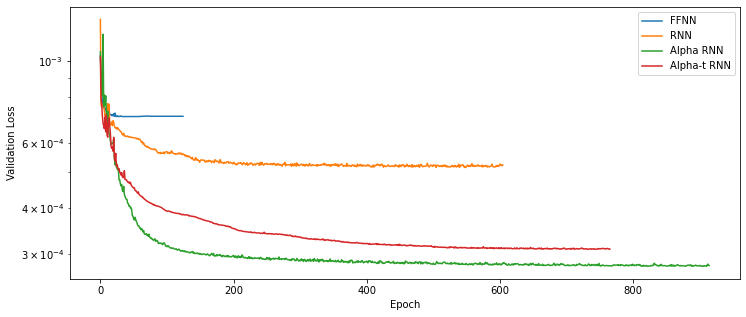

In [73]:
# plot histories and compare
fig = plt.figure(figsize=(12,5))
plt.plot(history.history['val_loss'],label='FFNN')
plt.plot(history_RNN,label='RNN')
plt.plot(history_aRNN,label='Alpha RNN')
plt.plot(history_atRNN,label='Alpha-t RNN')
plt.legend()
plt.xlabel('Epoch')
plt.ylabel('Validation Loss')
plt.yscale('log')
             
string = 'C:/Users/morit/Documents/Studium/Master-Arbeit 2021/Master Thesis TeX/figures/Comp_Hist1.pdf'
plt.savefig(string)
plt.show()

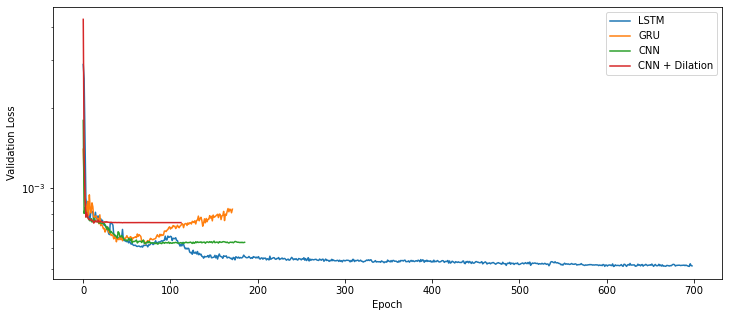

In [74]:
# plot histories and compare
fig = plt.figure(figsize=(12,5))
plt.plot(history_LSTM,label='LSTM')
plt.plot(history_GRU,label='GRU')
plt.plot(history_CNN,label='CNN')
plt.plot(history_DilCNN,label='CNN + Dilation')
plt.legend()
plt.xlabel('Epoch')
plt.ylabel('Validation Loss')
plt.yscale('log')
             
string = 'C:/Users/morit/Documents/Studium/Master-Arbeit 2021/Master Thesis TeX/figures/Comp_Hist2.pdf'
plt.savefig(string)
plt.show()

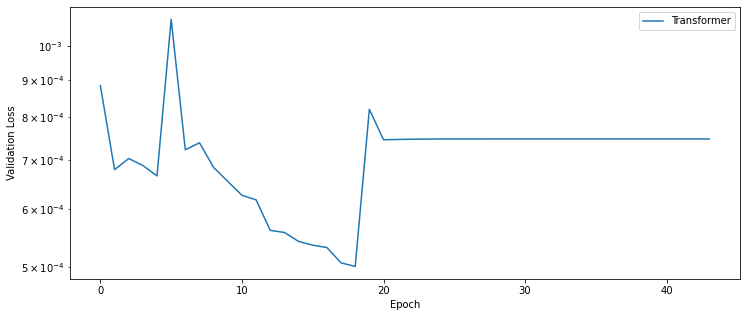

In [75]:
# plot histories and compare
fig = plt.figure(figsize=(12,5))
plt.plot(history_Transformer,label='Transformer')
plt.legend()
plt.xlabel('Epoch')
plt.ylabel('Validation Loss')
plt.yscale('log')
             
string = 'C:/Users/morit/Documents/Studium/Master-Arbeit 2021/Master Thesis TeX/figures/Comp_Hist3.pdf'
plt.savefig(string)
plt.show()